In [ ]:
concept_paths_file = '../logs/mnist_activation/Seed1/vanilla_sae/concept_path_results.pkl'


In [12]:
[round(val, 6) for val in np.logspace(-5, 1, num=30)]

[1e-05,
 1.6e-05,
 2.6e-05,
 4.2e-05,
 6.7e-05,
 0.000108,
 0.000174,
 0.000281,
 0.000452,
 0.000728,
 0.001172,
 0.001887,
 0.003039,
 0.004894,
 0.00788,
 0.01269,
 0.020434,
 0.032903,
 0.052983,
 0.085317,
 0.137382,
 0.221222,
 0.356225,
 0.573615,
 0.923671,
 1.487352,
 2.395027,
 3.85662,
 6.210169,
 10.0]

Loaded concept paths for 120 SAEs

reanim_vanilla_sae_256_10_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_27_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_21_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_512_6_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_256_19_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_12_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_256_11_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_512_19_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_256_29_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_4_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold

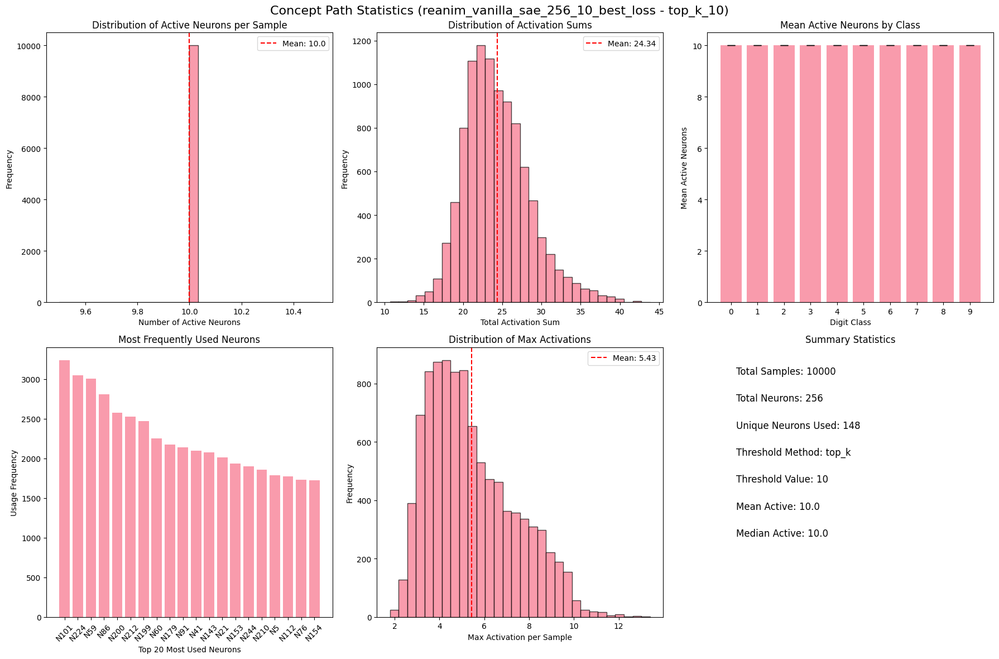

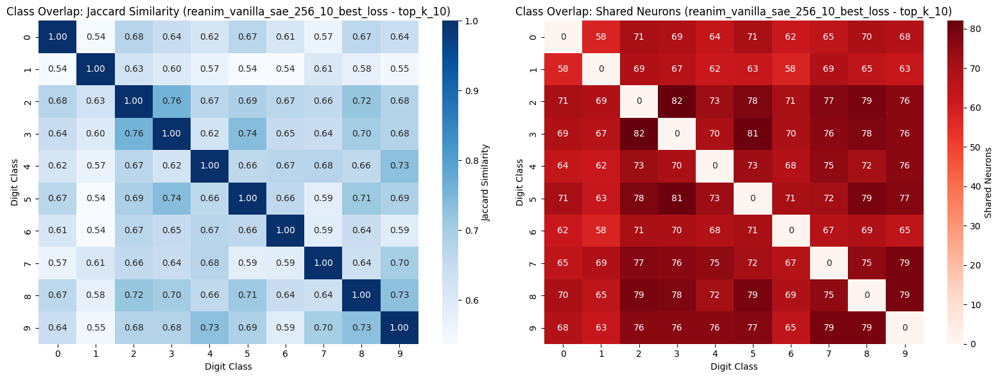

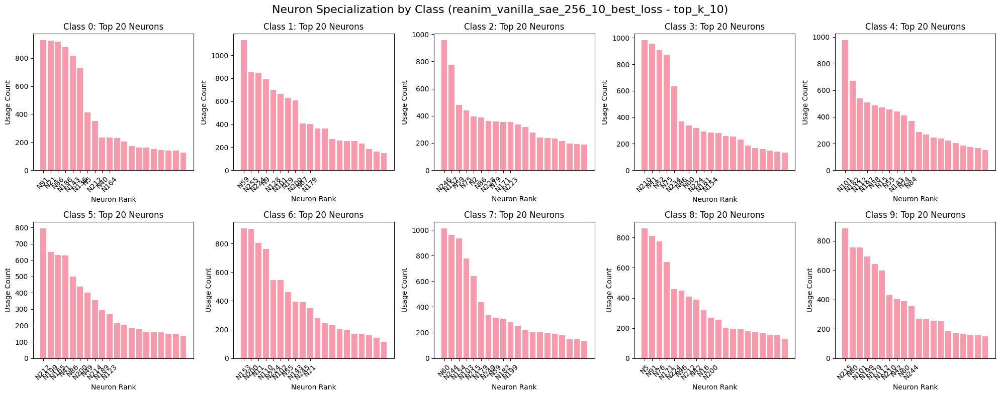


--- Analyzing config: top_k_20 ---


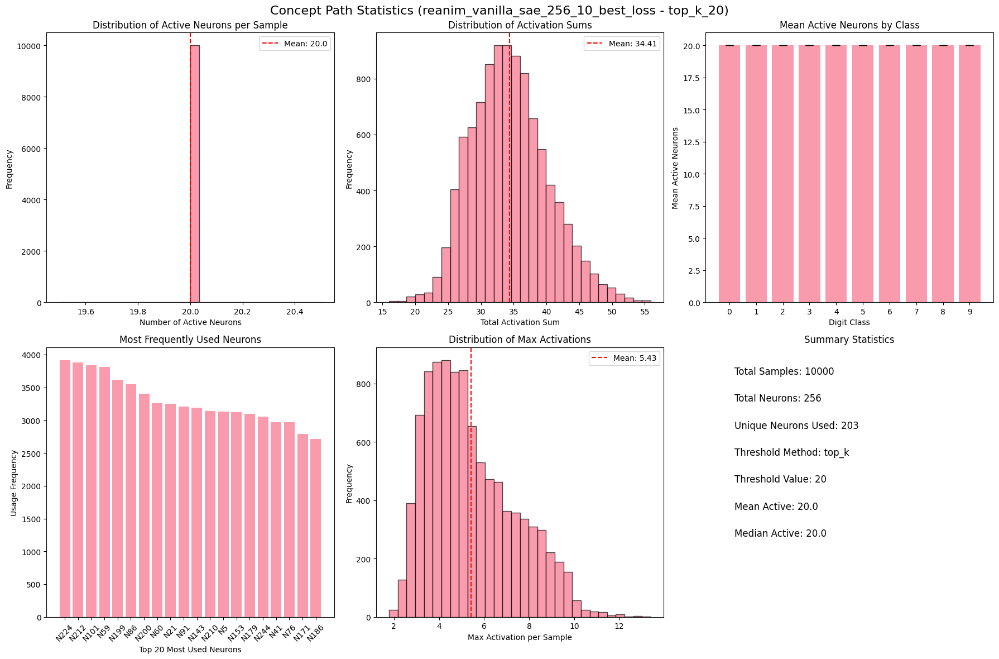

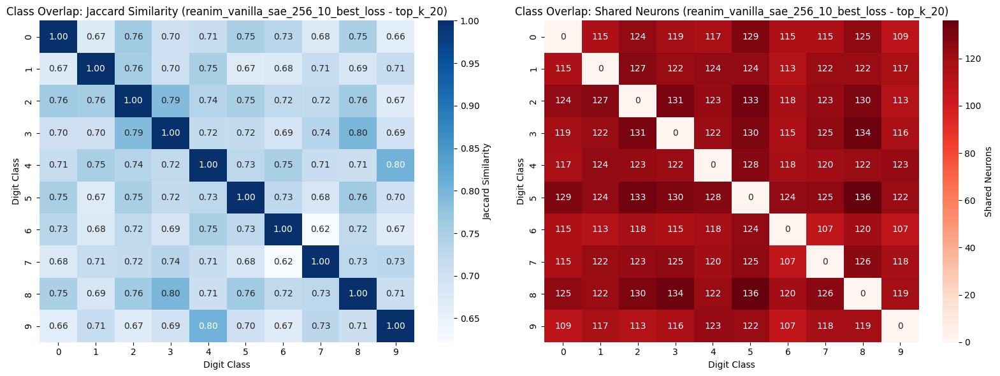

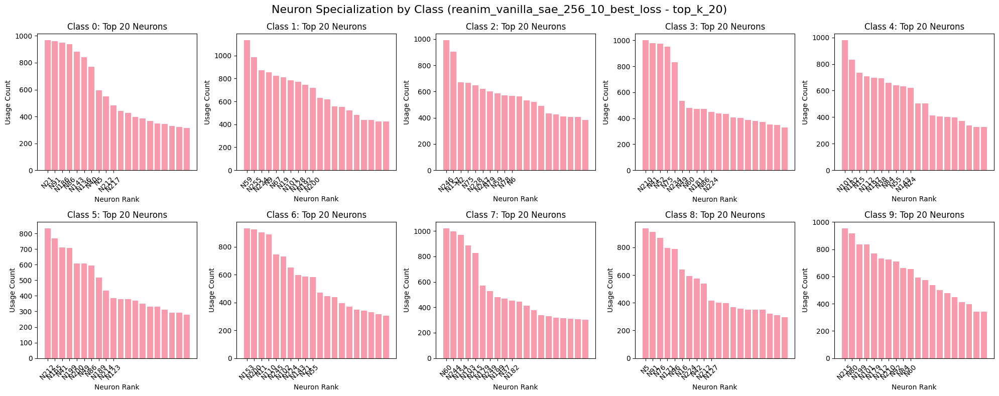


--- Analyzing config: percentile_90 ---


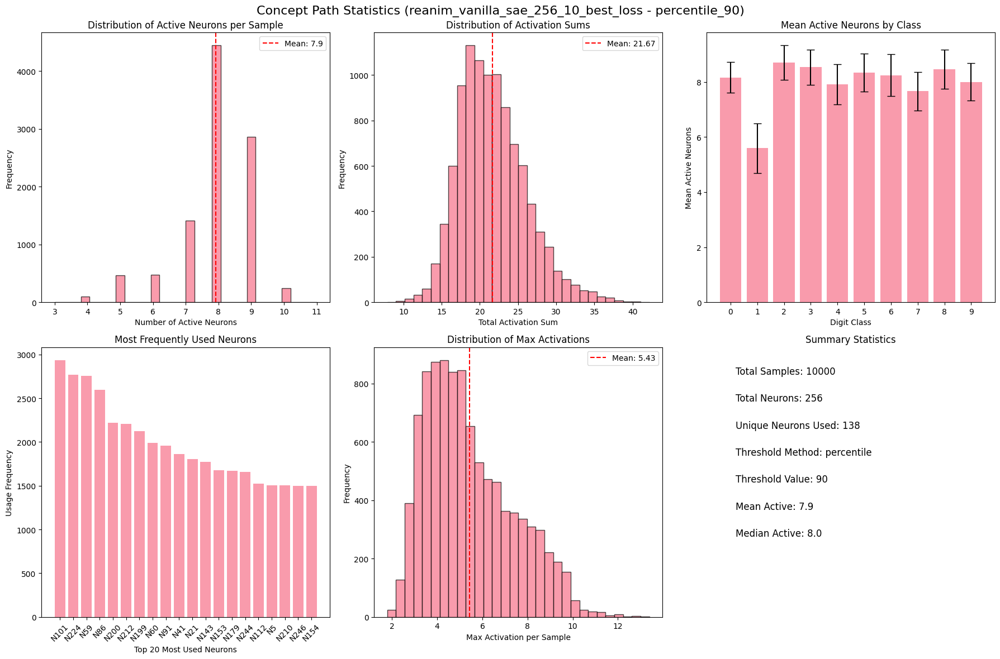

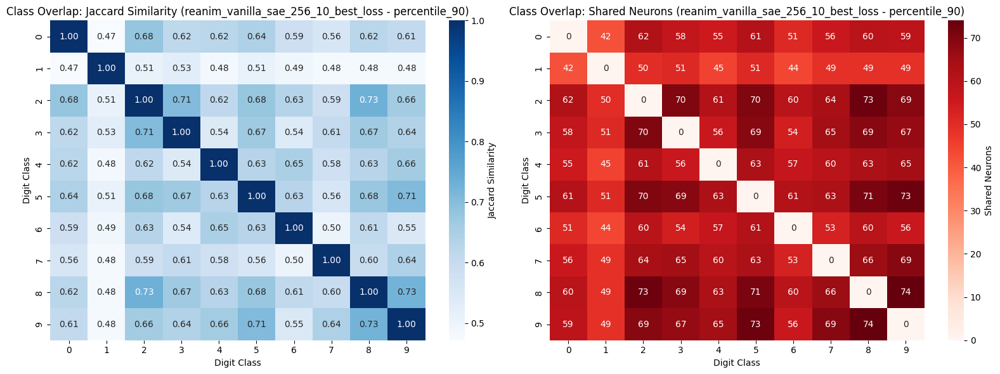

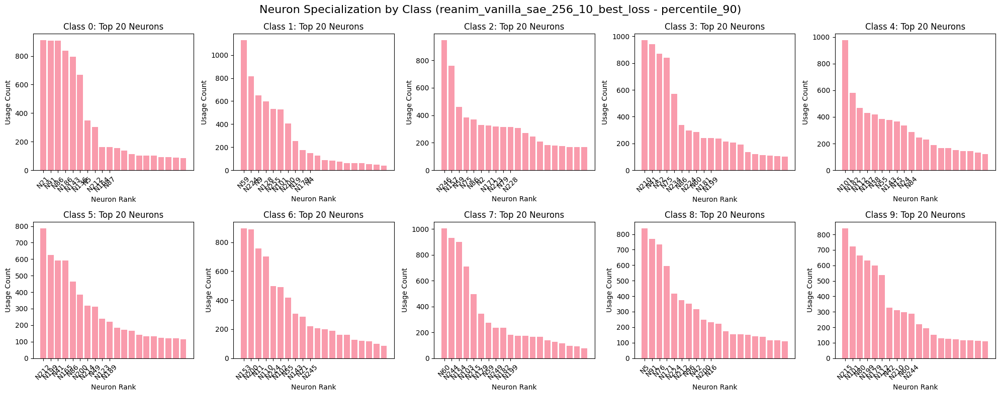


--- Analyzing config: std_threshold_1.5 ---


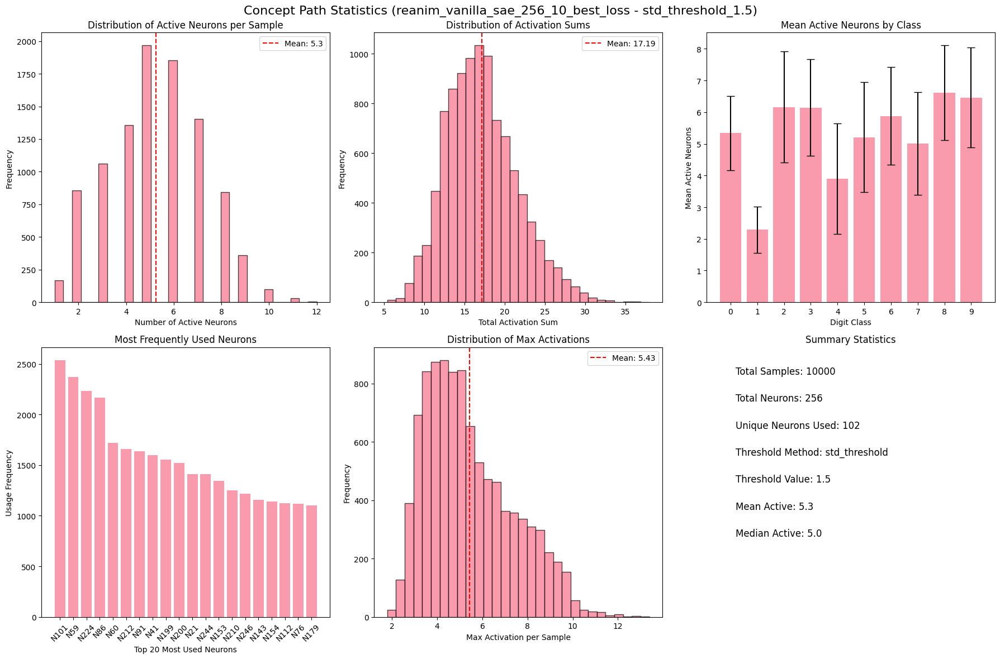

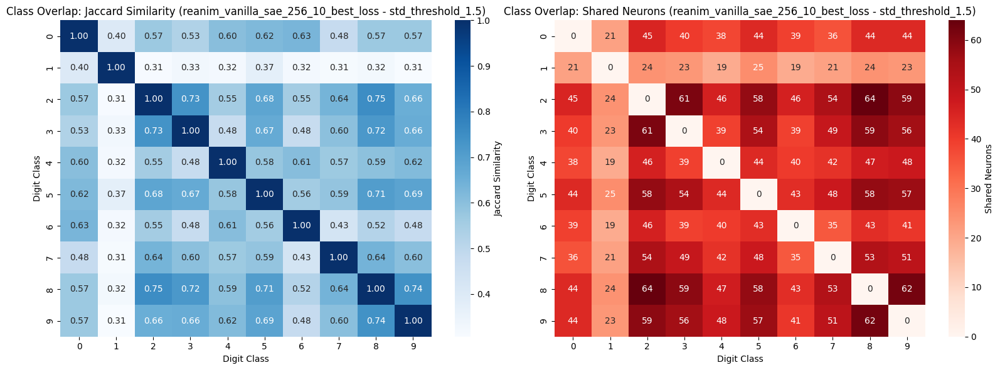

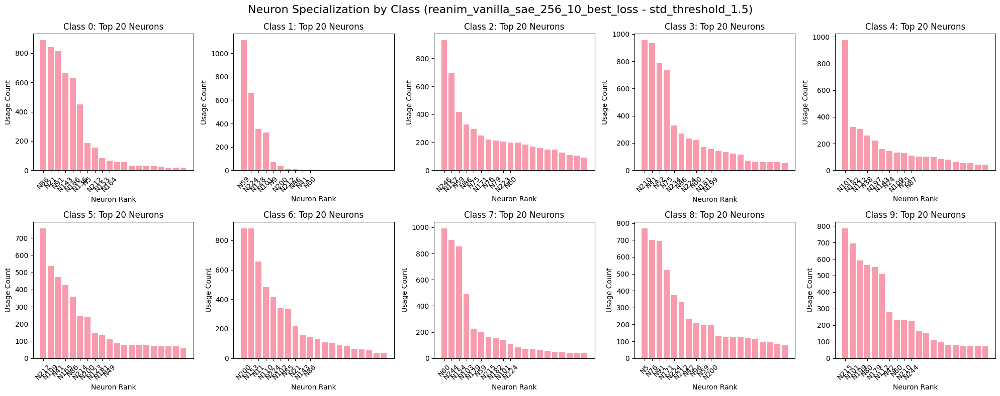


--- Comparing extraction methods for reanim_vanilla_sae_256_10_best_loss ---


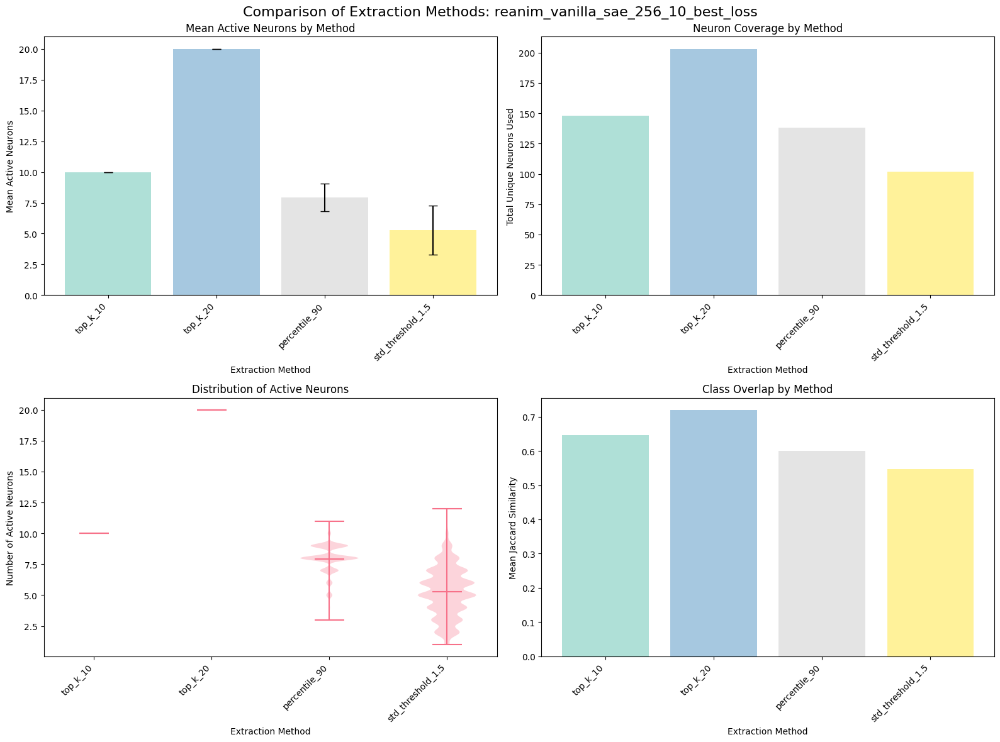


--- Summary across all SAEs ---


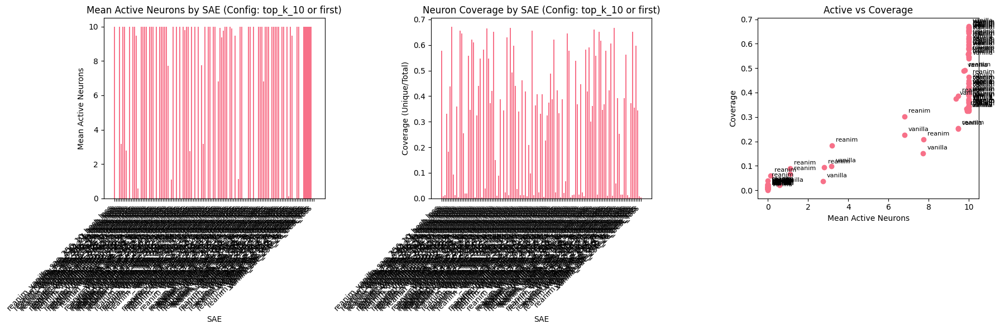


Summary Table (Config: top_k_10 or first):
                                     SAE    Config  Mean_Active  \
0    reanim_vanilla_sae_256_10_best_loss  top_k_10       10.000   
1           vanilla_sae_512_27_best_loss  top_k_10        0.000   
2           vanilla_sae_512_21_best_loss  top_k_10        0.001   
3     reanim_vanilla_sae_512_6_best_loss  top_k_10       10.000   
4    reanim_vanilla_sae_256_19_best_loss  top_k_10        3.176   
..                                   ...       ...          ...   
115          vanilla_sae_512_9_best_loss  top_k_10       10.000   
116          vanilla_sae_256_6_best_loss  top_k_10       10.000   
117   reanim_vanilla_sae_512_7_best_loss  top_k_10       10.000   
118         vanilla_sae_256_26_best_loss  top_k_10        0.000   
119         vanilla_sae_256_28_best_loss  top_k_10        0.000   

     Unique_Neurons  Total_Neurons  Coverage  
0               148            256     0.578  
1                 4            512     0.008  
2         

In [8]:
# ===== CONCEPT PATHS VISUALIZATION =====
# Run this cell to visualize concept paths from your SAE analysis

import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import defaultdict, Counter
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import networkx as nx

# Set plotting style
plt.style.use('default')
sns.set_palette("husl")


concept_paths_file = '../logs/mnist_activation/Seed1/vanilla_sae/concept_path_results.pkl'


try:
    with open(concept_paths_file, 'rb') as f:
        all_concept_paths = pickle.load(f)
    print(f"Loaded concept paths for {len(all_concept_paths)} SAEs")
    
    # Display available SAEs and configs
    for sae_name, configs in all_concept_paths.items():
        print(f"\n{sae_name}: {list(configs.keys())}")
        
except FileNotFoundError:
    print(f"File not found: {concept_paths_file}")
    print("Please update the concept_paths_file path above")
    # Create dummy data for demonstration
    all_concept_paths = {}

# ===== HELPER FUNCTIONS =====

def plot_concept_path_statistics(concept_paths_data, title_suffix=""):
    """Plot basic statistics about concept paths."""
    
    concept_paths = concept_paths_data['concept_paths']
    summary = concept_paths_data['summary']
    
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    fig.suptitle(f'Concept Path Statistics {title_suffix}', fontsize=16)
    
    num_active = [path['num_active'] for path in concept_paths]
    axes[0, 0].hist(num_active, bins=30, alpha=0.7, edgecolor='black')
    axes[0, 0].axvline(np.mean(num_active), color='red', linestyle='--', 
                       label=f'Mean: {np.mean(num_active):.1f}')
    axes[0, 0].set_xlabel('Number of Active Neurons')
    axes[0, 0].set_ylabel('Frequency')
    axes[0, 0].set_title('Distribution of Active Neurons per Sample')
    axes[0, 0].legend()
    
    # 2. Distribution of activation sums
    activation_sums = [path['activation_sum'] for path in concept_paths]
    axes[0, 1].hist(activation_sums, bins=30, alpha=0.7, edgecolor='black')
    axes[0, 1].axvline(np.mean(activation_sums), color='red', linestyle='--',
                       label=f'Mean: {np.mean(activation_sums):.2f}')
    axes[0, 1].set_xlabel('Total Activation Sum')
    axes[0, 1].set_ylabel('Frequency')
    axes[0, 1].set_title('Distribution of Activation Sums')
    axes[0, 1].legend()
    
    # 3. Per-class statistics (if labels available)
    if 'class_statistics' in summary:
        class_stats = summary['class_statistics']
        classes = sorted(class_stats.keys())
        
        class_means = [class_stats[c]['mean_active_neurons'] for c in classes]
        class_stds = [class_stats[c]['std_active_neurons'] for c in classes]
        
        axes[0, 2].bar(classes, class_means, yerr=class_stds, capsize=5, alpha=0.7)
        axes[0, 2].set_xlabel('Digit Class')
        axes[0, 2].set_ylabel('Mean Active Neurons')
        axes[0, 2].set_title('Mean Active Neurons by Class')
        axes[0, 2].set_xticks(classes)
    
    # 4. Neuron usage frequency
    all_neurons = []
    for path in concept_paths:
        all_neurons.extend(path['active_neurons'])
    
    neuron_counts = Counter(all_neurons)
    top_neurons = dict(sorted(neuron_counts.items(), key=lambda x: x[1], reverse=True)[:20])
    
    axes[1, 0].bar(range(len(top_neurons)), list(top_neurons.values()), alpha=0.7)
    axes[1, 0].set_xlabel('Top 20 Most Used Neurons')
    axes[1, 0].set_ylabel('Usage Frequency')
    axes[1, 0].set_title('Most Frequently Used Neurons')
    axes[1, 0].set_xticks(range(len(top_neurons)))
    axes[1, 0].set_xticklabels([f'N{k}' for k in top_neurons.keys()], rotation=45)
    
    # 5. Max activation distribution
    max_activations = [path['max_activation'] for path in concept_paths]
    axes[1, 1].hist(max_activations, bins=30, alpha=0.7, edgecolor='black')
    axes[1, 1].axvline(np.mean(max_activations), color='red', linestyle='--',
                       label=f'Mean: {np.mean(max_activations):.2f}')
    axes[1, 1].set_xlabel('Max Activation per Sample')
    axes[1, 1].set_ylabel('Frequency')
    axes[1, 1].set_title('Distribution of Max Activations')
    axes[1, 1].legend()
    
    # 6. Summary text
    axes[1, 2].text(0.1, 0.9, f"Total Samples: {summary['n_samples']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.8, f"Total Neurons: {summary['n_neurons']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.7, f"Unique Neurons Used: {summary['total_unique_neurons_used']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.6, f"Threshold Method: {summary['threshold_method']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.5, f"Threshold Value: {summary['threshold_value']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.4, f"Mean Active: {summary['mean_active_neurons']:.1f}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.3, f"Median Active: {summary['median_active_neurons']:.1f}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].set_xlim(0, 1)
    axes[1, 2].set_ylim(0, 1)
    axes[1, 2].set_title('Summary Statistics')
    axes[1, 2].axis('off')
    
    plt.tight_layout()
    plt.show()

def plot_class_overlap_heatmap(concept_paths_data, title_suffix=""):
    """Plot heatmap of class overlaps."""
    
    if 'overlap_analysis' not in concept_paths_data:
        print("No overlap analysis found in concept paths data")
        return
    
    overlap_data = concept_paths_data['overlap_analysis']['overlap_analysis']
    
    # Extract classes from overlap keys
    classes = set()
    for key in overlap_data.keys():
        parts = key.split('_')
        classes.add(int(parts[1]))
        classes.add(int(parts[3]))
    classes = sorted(classes)
    
    # Create matrices for different overlap metrics
    jaccard_matrix = np.zeros((len(classes), len(classes)))
    shared_neurons_matrix = np.zeros((len(classes), len(classes)))
    
    for key, data in overlap_data.items():
        parts = key.split('_')
        i, j = int(parts[1]), int(parts[3])
        i_idx, j_idx = classes.index(i), classes.index(j)
        
        jaccard_matrix[i_idx, j_idx] = data['jaccard_similarity']
        jaccard_matrix[j_idx, i_idx] = data['jaccard_similarity']  # Symmetric
        
        shared_neurons_matrix[i_idx, j_idx] = data['shared_neurons']
        shared_neurons_matrix[j_idx, i_idx] = data['shared_neurons']
    
    # Set diagonal to 1 for Jaccard (self-similarity)
    np.fill_diagonal(jaccard_matrix, 1.0)
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))
    
    # Jaccard similarity heatmap
    sns.heatmap(jaccard_matrix, 
                xticklabels=classes, yticklabels=classes,
                annot=True, fmt='.2f', cmap='Blues',
                ax=ax1, cbar_kws={'label': 'Jaccard Similarity'})
    ax1.set_title(f'Class Overlap: Jaccard Similarity {title_suffix}')
    ax1.set_xlabel('Digit Class')
    ax1.set_ylabel('Digit Class')
    
    # Shared neurons heatmap
    sns.heatmap(shared_neurons_matrix,
                xticklabels=classes, yticklabels=classes,
                annot=True, fmt='.0f', cmap='Reds',
                ax=ax2, cbar_kws={'label': 'Shared Neurons'})
    ax2.set_title(f'Class Overlap: Shared Neurons {title_suffix}')
    ax2.set_xlabel('Digit Class')
    ax2.set_ylabel('Digit Class')
    
    plt.tight_layout()
    plt.show()

def plot_neuron_class_specialization(concept_paths_data, top_n=20, title_suffix=""):
    """Plot which neurons are most specialized for each class."""
    
    concept_paths = concept_paths_data['concept_paths']
    summary = concept_paths_data['summary']
    
    if 'class_statistics' not in summary:
        print("No class statistics available")
        return
    
    # Count neuron usage per class
    class_neuron_usage = defaultdict(lambda: defaultdict(int))
    
    for path in concept_paths:
        if 'label' in path:
            label = path['label']
            for neuron_idx in path['active_neurons']:
                class_neuron_usage[label][neuron_idx] += 1
    
    # Find most specialized neurons for each class
    classes = sorted(class_neuron_usage.keys())
    n_classes = len(classes)
    
    fig, axes = plt.subplots(2, 5, figsize=(20, 8))
    axes = axes.flatten()
    
    for i, class_label in enumerate(classes):
        if i >= len(axes):
            break
            
        neuron_counts = class_neuron_usage[class_label]
        
        # Get top neurons for this class
        top_neurons = sorted(neuron_counts.items(), key=lambda x: x[1], reverse=True)[:top_n]
        
        if not top_neurons:
            continue
            
        neurons, counts = zip(*top_neurons)
        
        axes[i].bar(range(len(neurons)), counts, alpha=0.7)
        axes[i].set_title(f'Class {class_label}: Top {top_n} Neurons')
        axes[i].set_xlabel('Neuron Rank')
        axes[i].set_ylabel('Usage Count')
        axes[i].set_xticks(range(min(10, len(neurons))))
        axes[i].set_xticklabels([f'N{n}' for n in neurons[:10]], rotation=45)
    
    # Hide unused subplots
    for j in range(i+1, len(axes)):
        axes[j].set_visible(False)
    
    fig.suptitle(f'Neuron Specialization by Class {title_suffix}', fontsize=16)
    plt.tight_layout()
    plt.show()

def compare_extraction_methods(sae_concept_paths, sae_name):
    """Compare different concept path extraction methods for the same SAE."""
    
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    fig.suptitle(f'Comparison of Extraction Methods: {sae_name}', fontsize=16)
    
    methods = list(sae_concept_paths.keys())
    colors = plt.cm.Set3(np.linspace(0, 1, len(methods)))
    
    # 1. Mean active neurons comparison
    method_names = []
    mean_active = []
    std_active = []
    
    for method in methods:
        data = sae_concept_paths[method]
        method_names.append(method)
        mean_active.append(data['summary']['mean_active_neurons'])
        std_active.append(data['summary']['std_active_neurons'])
    
    bars = axes[0, 0].bar(range(len(method_names)), mean_active, 
                           yerr=std_active, capsize=5, alpha=0.7, color=colors)
    axes[0, 0].set_xlabel('Extraction Method')
    axes[0, 0].set_ylabel('Mean Active Neurons')
    axes[0, 0].set_title('Mean Active Neurons by Method')
    axes[0, 0].set_xticks(range(len(method_names)))
    axes[0, 0].set_xticklabels(method_names, rotation=45, ha='right')
    
    # 2. Total unique neurons used
    unique_neurons = [sae_concept_paths[method]['summary']['total_unique_neurons_used'] 
                       for method in methods]
    
    axes[0, 1].bar(range(len(method_names)), unique_neurons, alpha=0.7, color=colors)
    axes[0, 1].set_xlabel('Extraction Method')
    axes[0, 1].set_ylabel('Total Unique Neurons Used')
    axes[0, 1].set_title('Neuron Coverage by Method')
    axes[0, 1].set_xticks(range(len(method_names)))
    axes[0, 1].set_xticklabels(method_names, rotation=45, ha='right')
    
    # 3. Distribution of active neurons (violin plot)
    all_num_active = []
    method_labels = []
    
    for method in methods:
        concept_paths = sae_concept_paths[method]['concept_paths']
        num_active = [path['num_active'] for path in concept_paths]
        all_num_active.extend(num_active)
        method_labels.extend([method] * len(num_active))
    
    # Create dataframe for seaborn
    df = pd.DataFrame({'Method': method_labels, 'Active_Neurons': all_num_active})
    
    # Use matplotlib for violin plot instead of seaborn to avoid dependency issues
    method_data = [df[df['Method'] == method]['Active_Neurons'].values for method in methods]
    
    parts = axes[1, 0].violinplot(method_data, positions=range(len(methods)), showmeans=True)
    axes[1, 0].set_xlabel('Extraction Method')
    axes[1, 0].set_ylabel('Number of Active Neurons')
    axes[1, 0].set_title('Distribution of Active Neurons')
    axes[1, 0].set_xticks(range(len(method_names)))
    axes[1, 0].set_xticklabels(method_names, rotation=45, ha='right')
    
    # 4. Mean overlap between classes (if available)
    mean_overlaps = []
    for method in methods:
        if 'overlap_analysis' in sae_concept_paths[method]:
            overlap_data = sae_concept_paths[method]['overlap_analysis']
            if 'summary' in overlap_data:
                mean_overlaps.append(overlap_data['summary']['mean_jaccard'])
            else:
                mean_overlaps.append(0)
        else:
            mean_overlaps.append(0)
    
    if any(overlap > 0 for overlap in mean_overlaps):
        axes[1, 1].bar(range(len(method_names)), mean_overlaps, alpha=0.7, color=colors)
        axes[1, 1].set_xlabel('Extraction Method')
        axes[1, 1].set_ylabel('Mean Jaccard Similarity')
        axes[1, 1].set_title('Class Overlap by Method')
        axes[1, 1].set_xticks(range(len(method_names)))
        axes[1, 1].set_xticklabels(method_names, rotation=45, ha='right')
    else:
        axes[1, 1].text(0.5, 0.5, 'No overlap data available', 
                          ha='center', va='center', transform=axes[1, 1].transAxes)
        axes[1, 1].set_title('Class Overlap by Method')
    
    plt.tight_layout()
    plt.show()

# ===== MAIN VISUALIZATION CODE =====

if all_concept_paths:
    print("=== CONCEPT PATHS VISUALIZATION ===\n")
    
    # Select which SAE and config to visualize
    sae_names = list(all_concept_paths.keys())
    print("Available SAEs:")
    for i, name in enumerate(sae_names):
        print(f"{i}: {name}")
    
    # Visualize the first SAE (change index as needed)
    selected_sae_idx = 0
    selected_sae = sae_names[selected_sae_idx]
    
    print(f"\nVisualizing: {selected_sae}")
    
    # Get available configs for this SAE
    configs = list(all_concept_paths[selected_sae].keys())
    print(f"Available configs: {configs}")
    
    # Visualize each config
    for config in configs: # <-- This was configs.keys()
        print(f"\n--- Analyzing config: {config} ---")
        concept_paths_data = all_concept_paths[selected_sae][config]
        
        # Basic statistics
        plot_concept_path_statistics(concept_paths_data, f"({selected_sae} - {config})")
        
        # Class overlap heatmap
        plot_class_overlap_heatmap(concept_paths_data, f"({selected_sae} - {config})")
        
        # Neuron specialization
        plot_neuron_class_specialization(concept_paths_data, title_suffix=f"({selected_sae} - {config})")
    
    # Compare different extraction methods for the same SAE
    print(f"\n--- Comparing extraction methods for {selected_sae} ---")
    compare_extraction_methods(all_concept_paths[selected_sae], selected_sae)
    
    # Summary comparison across all SAEs (first config only)
    print("\n--- Summary across all SAEs ---")
    
    summary_data = []
    for sae_name, configs in all_concept_paths.items():
        # Try to get a consistent config, e.g., 'top_k_10', fallback to first
        config_to_use = None
        if 'top_k_10' in configs:
            config_to_use = 'top_k_10'
        elif configs:
            config_to_use = list(configs.keys())[0]

        if config_to_use:
            summary = configs[config_to_use]['summary']
            summary_data.append({
                'SAE': sae_name,
                'Config': config_to_use,
                'Mean_Active': summary['mean_active_neurons'],
                'Unique_Neurons': summary['total_unique_neurons_used'],
                'Total_Neurons': summary['n_neurons'],
                'Coverage': summary['total_unique_neurons_used'] / summary['n_neurons']
            })
    
    if summary_data:
        summary_df = pd.DataFrame(summary_data)
        
        # Plot summary comparison
        fig, axes = plt.subplots(1, 3, figsize=(18, 6))
        
        axes[0].bar(range(len(summary_df)), summary_df['Mean_Active'])
        axes[0].set_title('Mean Active Neurons by SAE (Config: top_k_10 or first)')
        axes[0].set_xlabel('SAE')
        axes[0].set_ylabel('Mean Active Neurons')
        axes[0].set_xticks(range(len(summary_df)))
        axes[0].set_xticklabels(summary_df['SAE'], rotation=45, ha='right')
        
        axes[1].bar(range(len(summary_df)), summary_df['Coverage'])
        axes[1].set_title('Neuron Coverage by SAE (Config: top_k_10 or first)')
        axes[1].set_xlabel('SAE')
        axes[1].set_ylabel('Coverage (Unique/Total)')
        axes[1].set_xticks(range(len(summary_df)))
        axes[1].set_xticklabels(summary_df['SAE'], rotation=45, ha='right')
        
        axes[2].scatter(summary_df['Mean_Active'], summary_df['Coverage'])
        axes[2].set_xlabel('Mean Active Neurons')
        axes[2].set_ylabel('Coverage')
        axes[2].set_title('Active vs Coverage')
        
        # Add SAE names as labels
        for i, sae in enumerate(summary_df['SAE']):
            axes[2].annotate(sae.split('_')[0], 
                               (summary_df['Mean_Active'].iloc[i], summary_df['Coverage'].iloc[i]),
                               xytext=(5, 5), textcoords='offset points', fontsize=8)
        
        plt.tight_layout()
        plt.show()
        
        print("\nSummary Table (Config: top_k_10 or first):")
        print(summary_df.round(3))
    else:
        print("No summary data to plot.")

else:
    print("No concept paths data loaded. Please check the file path and run the cell again.")



Loaded concept paths for 120 SAEs

reanim_vanilla_sae_256_10_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_27_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_21_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_512_6_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_256_19_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_12_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_256_11_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_512_19_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_256_29_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_4_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold

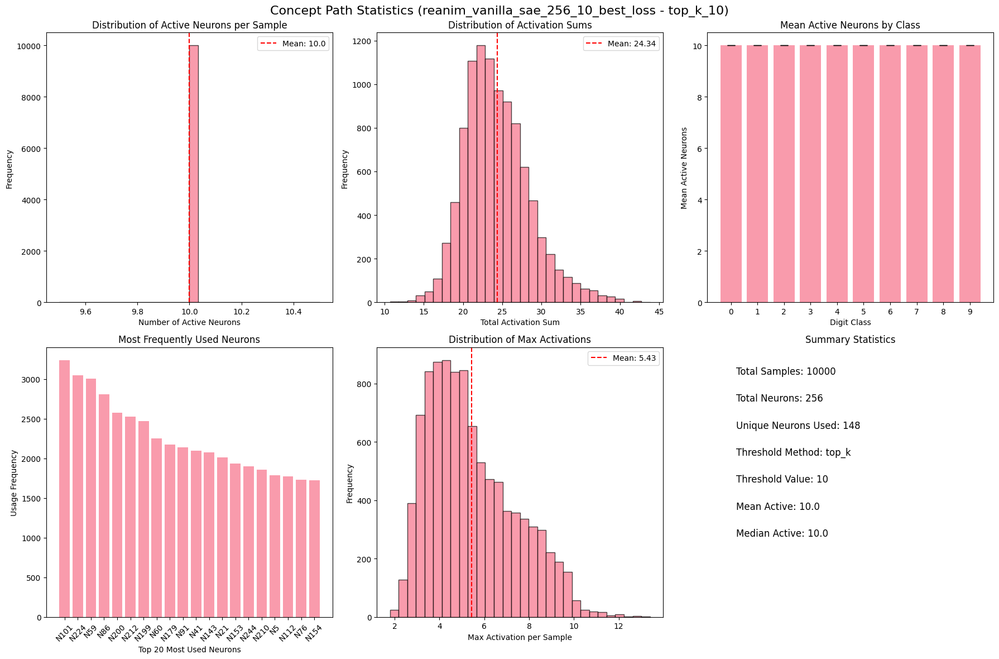

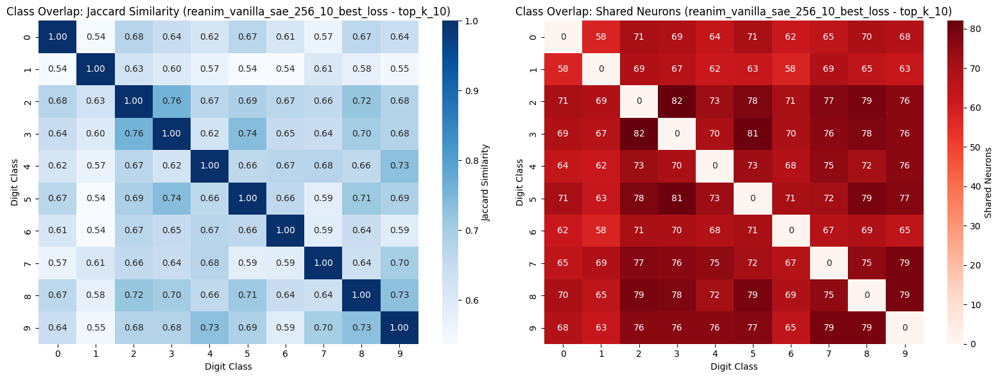

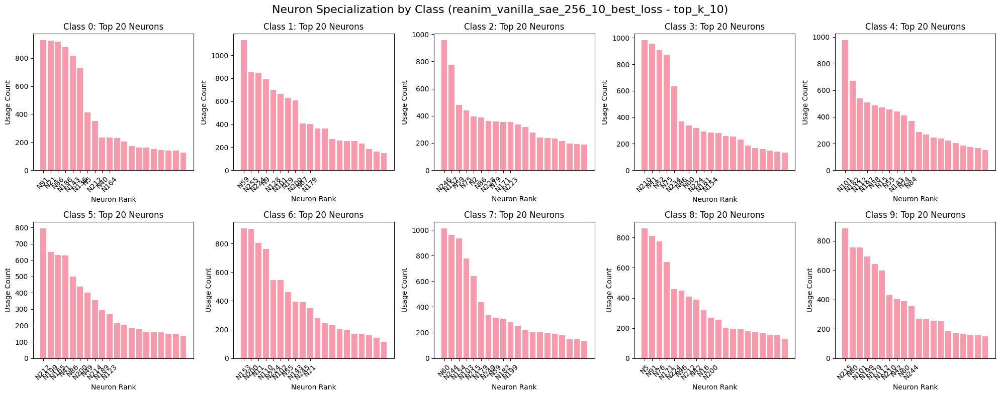


--- Analyzing config: top_k_20 ---


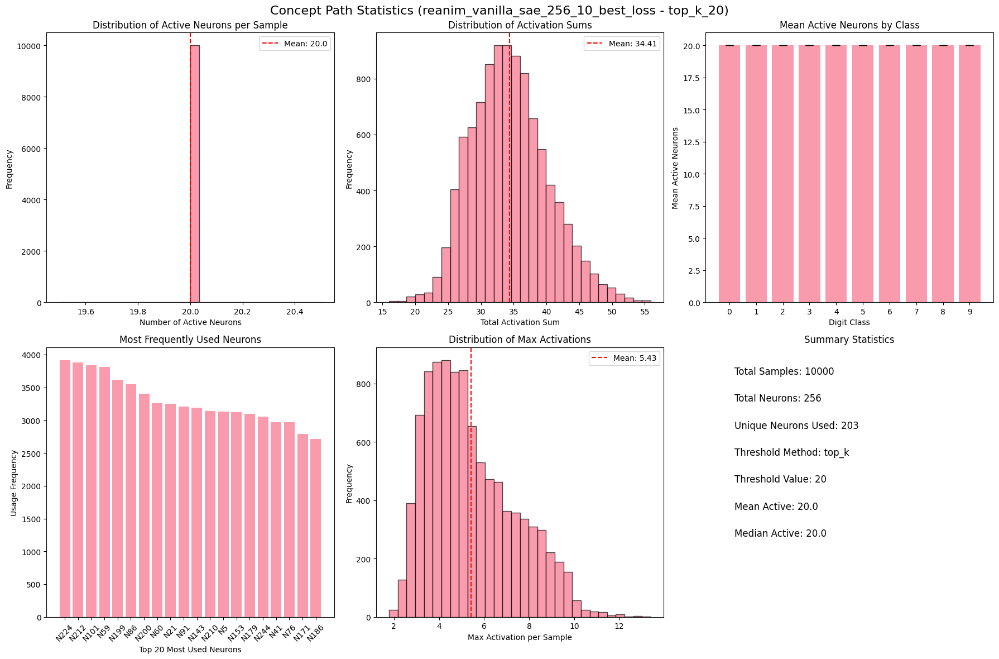

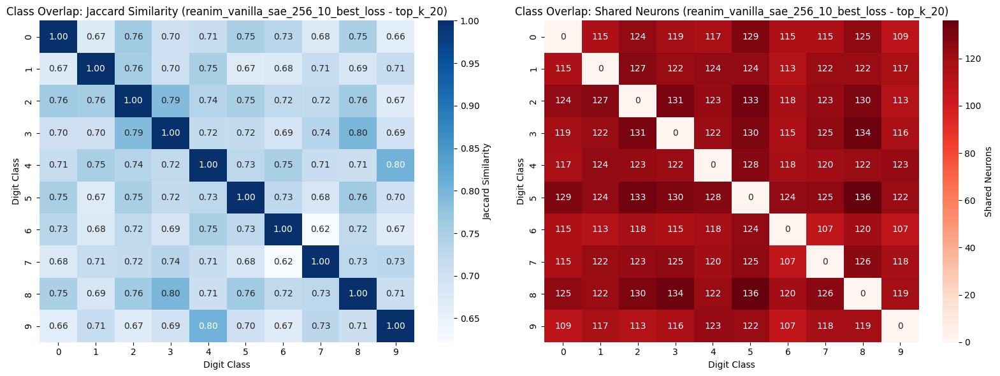

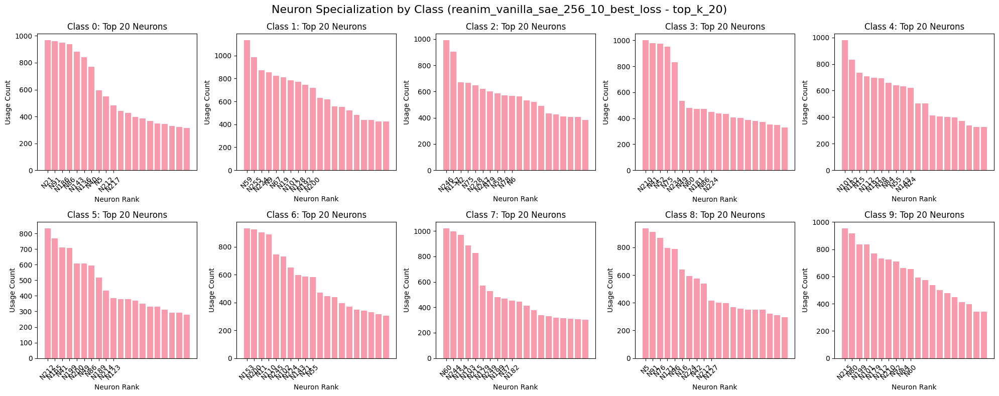


--- Analyzing config: percentile_90 ---


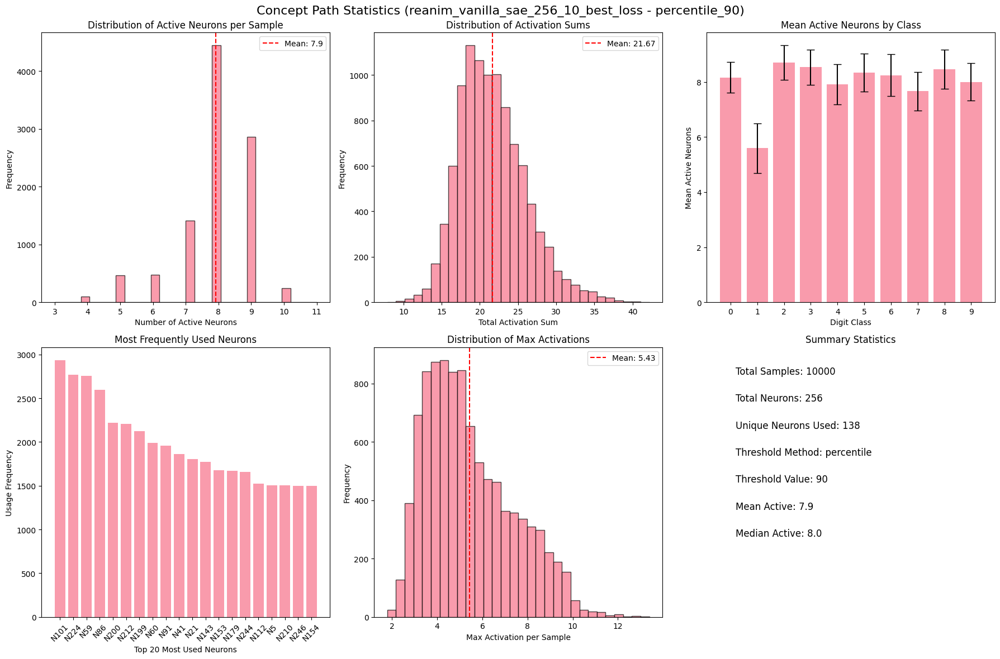

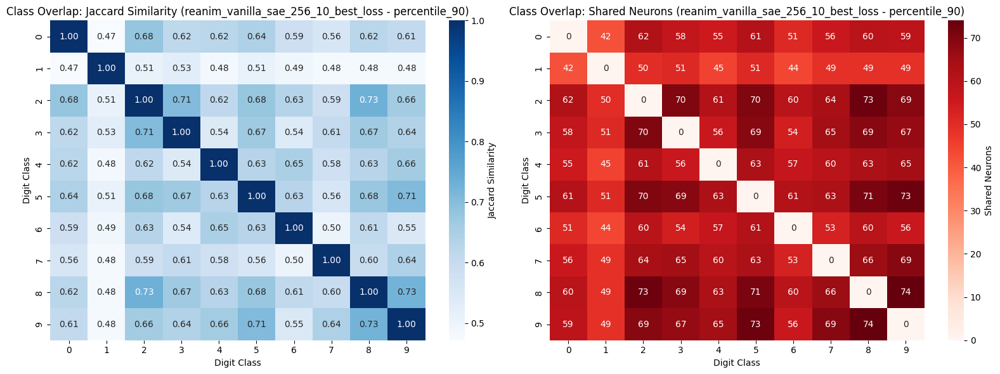

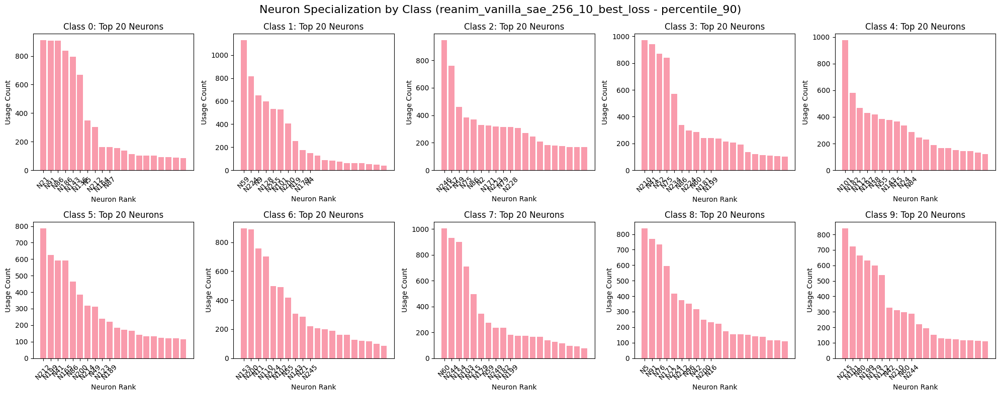


--- Analyzing config: std_threshold_1.5 ---


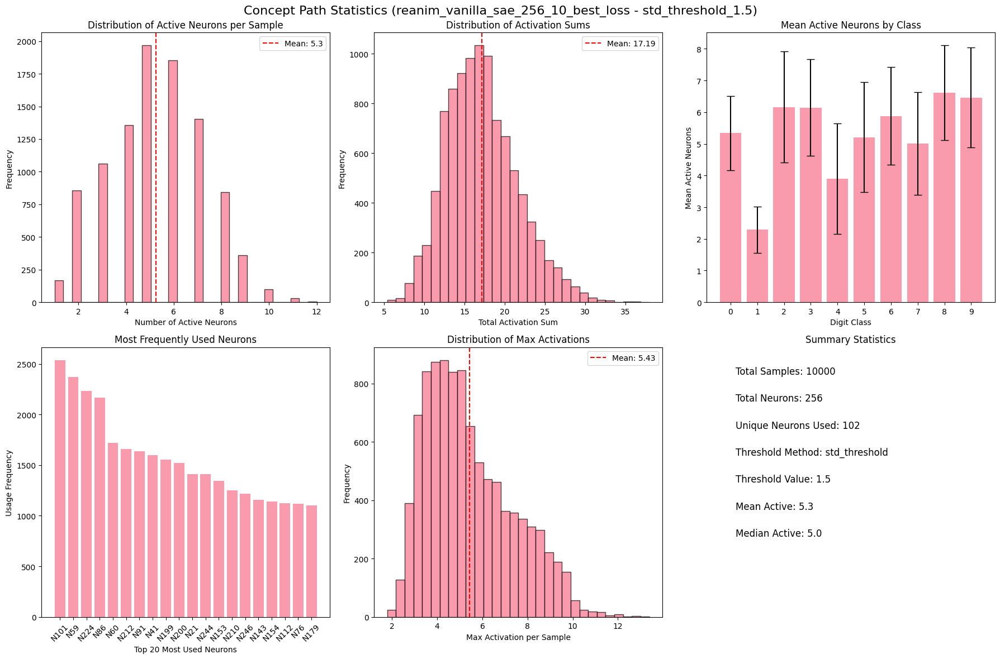

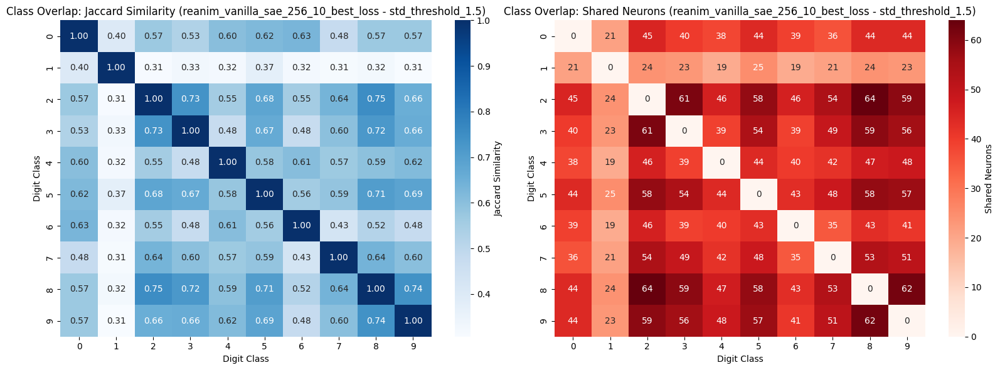

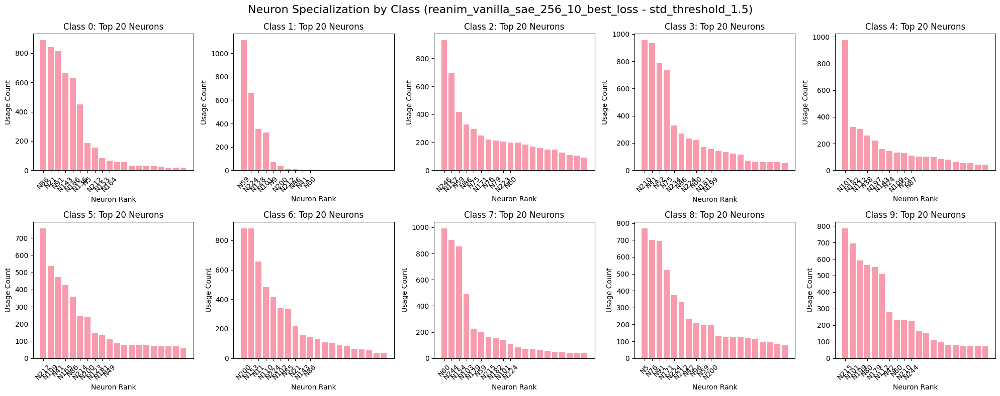


--- Comparing extraction methods for reanim_vanilla_sae_256_10_best_loss ---


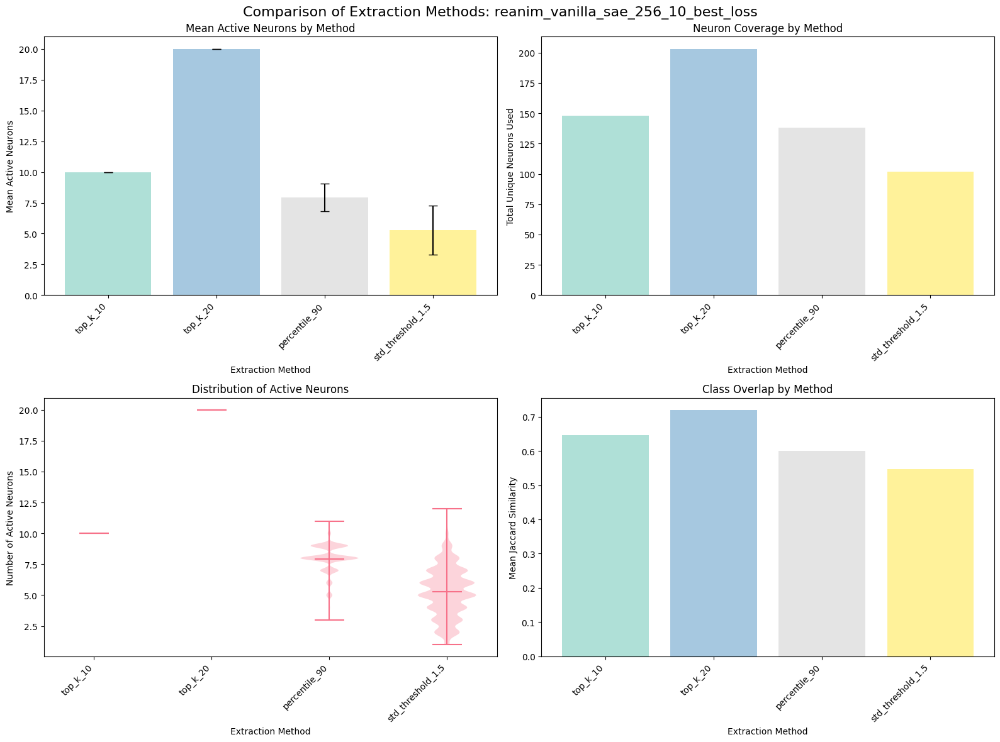


--- Summary across all SAEs (parsing parameters) ---

--- Parsed Summary DataFrame Head ---
                                   SAE    Config Training_Type  Dict_Size  \
12  reanim_vanilla_sae_256_0_best_loss  top_k_10        reanim        256   
11  reanim_vanilla_sae_256_1_best_loss  top_k_10        reanim        256   
39  reanim_vanilla_sae_256_2_best_loss  top_k_10        reanim        256   
95  reanim_vanilla_sae_256_3_best_loss  top_k_10        reanim        256   
94  reanim_vanilla_sae_256_4_best_loss  top_k_10        reanim        256   

    Penalty  Mean_Active  Unique_Neurons  Total_Neurons  Coverage  
12        0         10.0             165            256  0.644531  
11        1         10.0             168            256  0.656250  
39        2         10.0             161            256  0.628906  
95        3         10.0             158            256  0.617188  
94        4         10.0             167            256  0.652344  

Plotting Mean Active Neurons vs. Pe

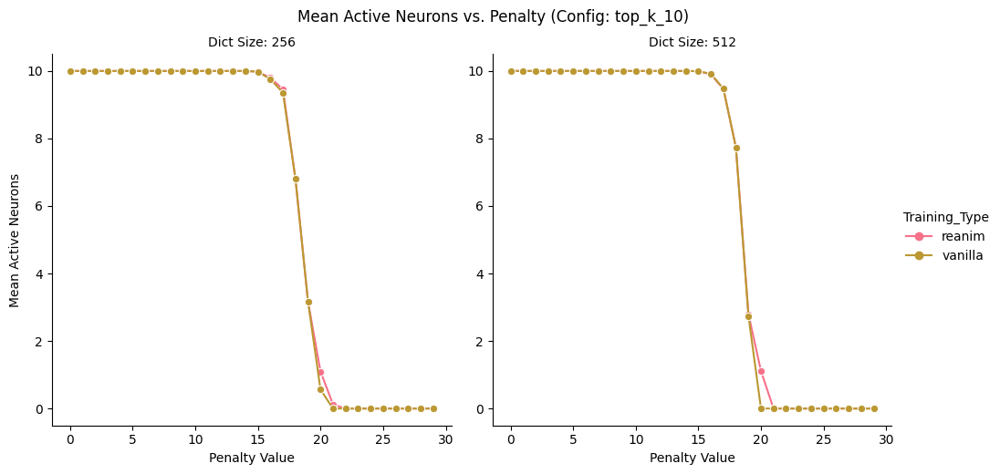


Plotting Neuron Coverage vs. Penalty...


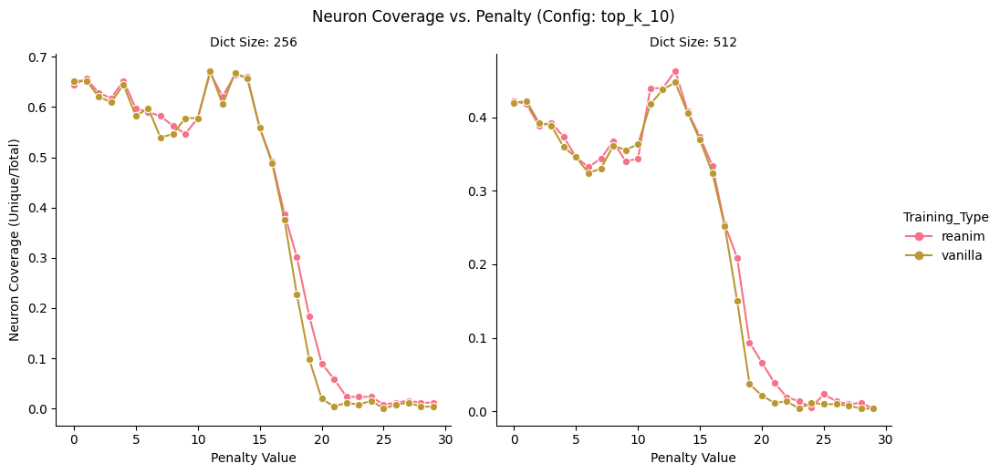


Summary Table (Config: top_k_10):
                                    SAE    Config Training_Type  Dict_Size  \
12   reanim_vanilla_sae_256_0_best_loss  top_k_10        reanim        256   
11   reanim_vanilla_sae_256_1_best_loss  top_k_10        reanim        256   
39   reanim_vanilla_sae_256_2_best_loss  top_k_10        reanim        256   
95   reanim_vanilla_sae_256_3_best_loss  top_k_10        reanim        256   
94   reanim_vanilla_sae_256_4_best_loss  top_k_10        reanim        256   
..                                  ...       ...           ...        ...   
99         vanilla_sae_512_25_best_loss  top_k_10       vanilla        512   
33         vanilla_sae_512_26_best_loss  top_k_10       vanilla        512   
1          vanilla_sae_512_27_best_loss  top_k_10       vanilla        512   
112        vanilla_sae_512_28_best_loss  top_k_10       vanilla        512   
10         vanilla_sae_512_29_best_loss  top_k_10       vanilla        512   

     Penalty  Mean_Active  U

In [10]:
# ===== CONCEPT PATHS VISUALIZATION =====
# Run this cell to visualize concept paths from your SAE analysis

import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import defaultdict, Counter
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import networkx as nx

# Set plotting style
plt.style.use('default')
sns.set_palette("husl")

concept_paths_file = '../logs/mnist_activation/Seed1/vanilla_sae/concept_path_results.pkl'

try:
    with open(concept_paths_file, 'rb') as f:
        all_concept_paths = pickle.load(f)
    print(f"Loaded concept paths for {len(all_concept_paths)} SAEs")
    
    # Display available SAEs and configs
    for sae_name, configs in all_concept_paths.items():
        print(f"\n{sae_name}: {list(configs.keys())}")
        
except FileNotFoundError:
    print(f"File not found: {concept_paths_file}")
    print("Please update the concept_paths_file path above")
    # Create dummy data for demonstration
    all_concept_paths = {}

# ===== HELPER FUNCTIONS =====

def plot_concept_path_statistics(concept_paths_data, title_suffix=""):
    """Plot basic statistics about concept paths."""
    
    concept_paths = concept_paths_data['concept_paths']
    summary = concept_paths_data['summary']
    
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    fig.suptitle(f'Concept Path Statistics {title_suffix}', fontsize=16)
    
    num_active = [path['num_active'] for path in concept_paths]
    axes[0, 0].hist(num_active, bins=30, alpha=0.7, edgecolor='black')
    axes[0, 0].axvline(np.mean(num_active), color='red', linestyle='--', 
                       label=f'Mean: {np.mean(num_active):.1f}')
    axes[0, 0].set_xlabel('Number of Active Neurons')
    axes[0, 0].set_ylabel('Frequency')
    axes[0, 0].set_title('Distribution of Active Neurons per Sample')
    axes[0, 0].legend()
    
    # 2. Distribution of activation sums
    activation_sums = [path['activation_sum'] for path in concept_paths]
    axes[0, 1].hist(activation_sums, bins=30, alpha=0.7, edgecolor='black')
    axes[0, 1].axvline(np.mean(activation_sums), color='red', linestyle='--',
                       label=f'Mean: {np.mean(activation_sums):.2f}')
    axes[0, 1].set_xlabel('Total Activation Sum')
    axes[0, 1].set_ylabel('Frequency')
    axes[0, 1].set_title('Distribution of Activation Sums')
    axes[0, 1].legend()
    
    # 3. Per-class statistics (if labels available)
    if 'class_statistics' in summary:
        class_stats = summary['class_statistics']
        classes = sorted(class_stats.keys())
        
        class_means = [class_stats[c]['mean_active_neurons'] for c in classes]
        class_stds = [class_stats[c]['std_active_neurons'] for c in classes]
        
        axes[0, 2].bar(classes, class_means, yerr=class_stds, capsize=5, alpha=0.7)
        axes[0, 2].set_xlabel('Digit Class')
        axes[0, 2].set_ylabel('Mean Active Neurons')
        axes[0, 2].set_title('Mean Active Neurons by Class')
        axes[0, 2].set_xticks(classes)
    
    # 4. Neuron usage frequency
    all_neurons = []
    for path in concept_paths:
        all_neurons.extend(path['active_neurons'])
    
    neuron_counts = Counter(all_neurons)
    top_neurons = dict(sorted(neuron_counts.items(), key=lambda x: x[1], reverse=True)[:20])
    
    axes[1, 0].bar(range(len(top_neurons)), list(top_neurons.values()), alpha=0.7)
    axes[1, 0].set_xlabel('Top 20 Most Used Neurons')
    axes[1, 0].set_ylabel('Usage Frequency')
    axes[1, 0].set_title('Most Frequently Used Neurons')
    axes[1, 0].set_xticks(range(len(top_neurons)))
    axes[1, 0].set_xticklabels([f'N{k}' for k in top_neurons.keys()], rotation=45)
    
    # 5. Max activation distribution
    max_activations = [path['max_activation'] for path in concept_paths]
    axes[1, 1].hist(max_activations, bins=30, alpha=0.7, edgecolor='black')
    axes[1, 1].axvline(np.mean(max_activations), color='red', linestyle='--',
                       label=f'Mean: {np.mean(max_activations):.2f}')
    axes[1, 1].set_xlabel('Max Activation per Sample')
    axes[1, 1].set_ylabel('Frequency')
    axes[1, 1].set_title('Distribution of Max Activations')
    axes[1, 1].legend()
    
    # 6. Summary text
    axes[1, 2].text(0.1, 0.9, f"Total Samples: {summary['n_samples']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.8, f"Total Neurons: {summary['n_neurons']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.7, f"Unique Neurons Used: {summary['total_unique_neurons_used']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.6, f"Threshold Method: {summary['threshold_method']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.5, f"Threshold Value: {summary['threshold_value']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.4, f"Mean Active: {summary['mean_active_neurons']:.1f}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.3, f"Median Active: {summary['median_active_neurons']:.1f}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].set_xlim(0, 1)
    axes[1, 2].set_ylim(0, 1)
    axes[1, 2].set_title('Summary Statistics')
    axes[1, 2].axis('off')
    
    plt.tight_layout()
    plt.show()

def plot_class_overlap_heatmap(concept_paths_data, title_suffix=""):
    """Plot heatmap of class overlaps."""
    
    if 'overlap_analysis' not in concept_paths_data:
        print("No overlap analysis found in concept paths data")
        return
    
    overlap_data = concept_paths_data['overlap_analysis']['overlap_analysis']
    
    # Extract classes from overlap keys
    classes = set()
    for key in overlap_data.keys():
        parts = key.split('_')
        try:
            classes.add(int(parts[1]))
            classes.add(int(parts[3]))
        except (IndexError, ValueError):
            print(f"Warning: Could not parse class from overlap key: {key}")
            continue
    classes = sorted(classes)
    if not classes:
        print("Warning: No valid classes found for overlap heatmap.")
        return

    # Create matrices for different overlap metrics
    jaccard_matrix = np.zeros((len(classes), len(classes)))
    shared_neurons_matrix = np.zeros((len(classes), len(classes)))
    
    for key, data in overlap_data.items():
        parts = key.split('_')
        try:
            i, j = int(parts[1]), int(parts[3])
            i_idx, j_idx = classes.index(i), classes.index(j)
            
            jaccard_matrix[i_idx, j_idx] = data['jaccard_similarity']
            jaccard_matrix[j_idx, i_idx] = data['jaccard_similarity']  # Symmetric
            
            shared_neurons_matrix[i_idx, j_idx] = data['shared_neurons']
            shared_neurons_matrix[j_idx, i_idx] = data['shared_neurons']
        except (IndexError, ValueError, KeyError):
            continue # Skip if key is malformed or data is missing
    
    # Set diagonal to 1 for Jaccard (self-similarity)
    np.fill_diagonal(jaccard_matrix, 1.0)
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))
    
    # Jaccard similarity heatmap
    sns.heatmap(jaccard_matrix, 
                xticklabels=classes, yticklabels=classes,
                annot=True, fmt='.2f', cmap='Blues',
                ax=ax1, cbar_kws={'label': 'Jaccard Similarity'})
    ax1.set_title(f'Class Overlap: Jaccard Similarity {title_suffix}')
    ax1.set_xlabel('Digit Class')
    ax1.set_ylabel('Digit Class')
    
    # Shared neurons heatmap
    sns.heatmap(shared_neurons_matrix,
                xticklabels=classes, yticklabels=classes,
                annot=True, fmt='.0f', cmap='Reds',
                ax=ax2, cbar_kws={'label': 'Shared Neurons'})
    ax2.set_title(f'Class Overlap: Shared Neurons {title_suffix}')
    ax2.set_xlabel('Digit Class')
    ax2.set_ylabel('Digit Class')
    
    plt.tight_layout()
    plt.show()

def plot_neuron_class_specialization(concept_paths_data, top_n=20, title_suffix=""):
    """Plot which neurons are most specialized for each class."""
    
    concept_paths = concept_paths_data['concept_paths']
    summary = concept_paths_data['summary']
    
    if 'class_statistics' not in summary:
        print("No class statistics available")
        return
    
    # Count neuron usage per class
    class_neuron_usage = defaultdict(lambda: defaultdict(int))
    
    for path in concept_paths:
        if 'label' in path:
            label = path['label']
            for neuron_idx in path['active_neurons']:
                class_neuron_usage[label][neuron_idx] += 1
    
    # Find most specialized neurons for each class
    classes = sorted(class_neuron_usage.keys())
    n_classes = len(classes)
    
    # Adjust subplot grid if there are fewer than 10 classes (e.g., MNIST)
    n_cols = 5
    n_rows = int(np.ceil(n_classes / n_cols))
    if n_rows == 0: n_rows = 1
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 4 * n_rows))
    axes = axes.flatten()
    
    for i, class_label in enumerate(classes):
        if i >= len(axes):
            break
            
        neuron_counts = class_neuron_usage[class_label]
        
        # Get top neurons for this class
        top_neurons = sorted(neuron_counts.items(), key=lambda x: x[1], reverse=True)[:top_n]
        
        if not top_neurons:
            axes[i].text(0.5, 0.5, 'No active neurons', ha='center', va='center', transform=axes[i].transAxes)
            axes[i].set_title(f'Class {class_label}: Top {top_n} Neurons')
            continue
            
        neurons, counts = zip(*top_neurons)
        
        axes[i].bar(range(len(neurons)), counts, alpha=0.7)
        axes[i].set_title(f'Class {class_label}: Top {top_n} Neurons')
        axes[i].set_xlabel('Neuron Rank')
        axes[i].set_ylabel('Usage Count')
        axes[i].set_xticks(range(min(10, len(neurons))))
        axes[i].set_xticklabels([f'N{n}' for n in neurons[:10]], rotation=45)
    
    # Hide unused subplots
    for j in range(i + 1, len(axes)):
        axes[j].set_visible(False)
    
    fig.suptitle(f'Neuron Specialization by Class {title_suffix}', fontsize=16)
    plt.tight_layout()
    plt.show()

def compare_extraction_methods(sae_concept_paths, sae_name):
    """Compare different concept path extraction methods for the same SAE."""
    
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    fig.suptitle(f'Comparison of Extraction Methods: {sae_name}', fontsize=16)
    
    methods = list(sae_concept_paths.keys())
    if not methods:
        print("No extraction methods to compare.")
        plt.close(fig)
        return
        
    colors = plt.cm.Set3(np.linspace(0, 1, len(methods)))
    
    # 1. Mean active neurons comparison
    method_names = []
    mean_active = []
    std_active = []
    
    for method in methods:
        data = sae_concept_paths.get(method, {})
        if 'summary' not in data: continue
        summary = data['summary']
        method_names.append(method)
        mean_active.append(summary.get('mean_active_neurons', np.nan))
        std_active.append(summary.get('std_active_neurons', np.nan))
    
    if not method_names:
         print("No valid summary data for method comparison.")
         plt.close(fig)
         return

    bars = axes[0, 0].bar(range(len(method_names)), mean_active, 
                           yerr=std_active, capsize=5, alpha=0.7, color=colors)
    axes[0, 0].set_xlabel('Extraction Method')
    axes[0, 0].set_ylabel('Mean Active Neurons')
    axes[0, 0].set_title('Mean Active Neurons by Method')
    axes[0, 0].set_xticks(range(len(method_names)))
    axes[0, 0].set_xticklabels(method_names, rotation=45, ha='right')
    
    # 2. Total unique neurons used
    unique_neurons = [sae_concept_paths[method]['summary'].get('total_unique_neurons_used', np.nan)
                       for method in method_names]
    
    axes[0, 1].bar(range(len(method_names)), unique_neurons, alpha=0.7, color=colors)
    axes[0, 1].set_xlabel('Extraction Method')
    axes[0, 1].set_ylabel('Total Unique Neurons Used')
    axes[0, 1].set_title('Neuron Coverage by Method')
    axes[0, 1].set_xticks(range(len(method_names)))
    axes[0, 1].set_xticklabels(method_names, rotation=45, ha='right')
    
    # 3. Distribution of active neurons (violin plot)
    all_num_active = []
    method_labels = []
    
    for method in method_names:
        concept_paths = sae_concept_paths[method].get('concept_paths', [])
        num_active = [path['num_active'] for path in concept_paths]
        all_num_active.extend(num_active)
        method_labels.extend([method] * len(num_active))
    
    if all_num_active:
        # Create dataframe for seaborn
        df = pd.DataFrame({'Method': method_labels, 'Active_Neurons': all_num_active})
        
        # Use matplotlib for violin plot
        method_data = [df[df['Method'] == method]['Active_Neurons'].values for method in method_names]
        
        parts = axes[1, 0].violinplot(method_data, positions=range(len(method_names)), showmeans=True)
        axes[1, 0].set_xlabel('Extraction Method')
        axes[1, 0].set_ylabel('Number of Active Neurons')
        axes[1, 0].set_title('Distribution of Active Neurons')
        axes[1, 0].set_xticks(range(len(method_names)))
        axes[1, 0].set_xticklabels(method_names, rotation=45, ha='right')
    else:
        axes[1, 0].text(0.5, 0.5, 'No activation data available', 
                          ha='center', va='center', transform=axes[1, 0].transAxes)
        axes[1, 0].set_title('Distribution of Active Neurons')

    
    # 4. Mean overlap between classes (if available)
    mean_overlaps = []
    for method in method_names:
        overlap_data = sae_concept_paths[method].get('overlap_analysis', {})
        summary = overlap_data.get('summary', {})
        mean_overlaps.append(summary.get('mean_jaccard', 0))
    
    if any(overlap > 0 for overlap in mean_overlaps):
        axes[1, 1].bar(range(len(method_names)), mean_overlaps, alpha=0.7, color=colors)
        axes[1, 1].set_xlabel('Extraction Method')
        axes[1, 1].set_ylabel('Mean Jaccard Similarity')
        axes[1, 1].set_title('Class Overlap by Method')
        axes[1, 1].set_xticks(range(len(method_names)))
        axes[1, 1].set_xticklabels(method_names, rotation=45, ha='right')
    else:
        axes[1, 1].text(0.5, 0.5, 'No overlap data available', 
                          ha='center', va='center', transform=axes[1, 1].transAxes)
        axes[1, 1].set_title('Class Overlap by Method')
    
    plt.tight_layout()
    plt.show()

# ===== MAIN VISUALIZATION CODE =====

if all_concept_paths:
    print("=== CONCEPT PATHS VISUALIZATION ===\n")
    
    # Select which SAE and config to visualize
    sae_names = list(all_concept_paths.keys())
    print("Available SAEs:")
    for i, name in enumerate(sae_names):
        print(f"{i}: {name}")
    
    # Visualize the first SAE (change index as needed)
    selected_sae_idx = 0
    if sae_names:
        selected_sae = sae_names[selected_sae_idx]
        
        print(f"\nVisualizing: {selected_sae}")
        
        # Get available configs for this SAE
        configs = list(all_concept_paths[selected_sae].keys())
        print(f"Available configs: {configs}")
        
        # Visualize each config
        for config in configs: 
            print(f"\n--- Analyzing config: {config} ---")
            concept_paths_data = all_concept_paths[selected_sae].get(config)
            if not concept_paths_data:
                print(f"No data for config {config}, skipping.")
                continue
            
            # Basic statistics
            plot_concept_path_statistics(concept_paths_data, f"({selected_sae} - {config})")
            
            # Class overlap heatmap
            plot_class_overlap_heatmap(concept_paths_data, f"({selected_sae} - {config})")
            
            # Neuron specialization
            plot_neuron_class_specialization(concept_paths_data, title_suffix=f"({selected_sae} - {config})")
        
        # Compare different extraction methods for the same SAE
        print(f"\n--- Comparing extraction methods for {selected_sae} ---")
        compare_extraction_methods(all_concept_paths[selected_sae], selected_sae)
    else:
        print("No SAEs found in the data.")

    # ===== NEW SUMMARY SECTION =====
    print("\n--- Summary across all SAEs (parsing parameters) ---")
    
    summary_data = []
    config_to_use = 'top_k_10' # Default config to use for comparison
    
    for sae_name, configs in all_concept_paths.items():
        # Try to get a consistent config, e.g., 'top_k_10', fallback to first
        current_config_to_use = None
        if config_to_use in configs:
            current_config_to_use = config_to_use
        elif configs:
            current_config_to_use = list(configs.keys())[0]
            if sae_name == sae_names[0]: # Set config_to_use based on first SAE if default not found
                config_to_use = current_config_to_use
        
        if not current_config_to_use:
            print(f"Warning: No configs found for {sae_name}. Skipping.")
            continue

        if current_config_to_use != config_to_use:
             print(f"Warning: Config '{config_to_use}' not found for {sae_name}. Using '{current_config_to_use}' instead.")
            
        summary = configs[current_config_to_use].get('summary')
        if not summary:
            print(f"Warning: No summary found for {sae_name} config {current_config_to_use}. Skipping.")
            continue

        # Parse parameters from sae_name
        training_type = None
        dict_size = None
        penalty = None
        parts = sae_name.split('_')

        try:
            if sae_name.startswith('reanim_vanilla_sae_'):
                # e.g., reanim_vanilla_sae_256_10_best_loss
                training_type = 'reanim'
                dict_size = int(parts[3])
                penalty = int(parts[4])
            elif sae_name.startswith('vanilla_sae_'):
                # e.g., vanilla_sae_512_27_best_loss
                training_type = 'vanilla'
                dict_size = int(parts[2])
                penalty = int(parts[3])
            else:
                print(f"Warning: Unrecognized SAE name format: {sae_name}. Skipping.")
                continue
        except (IndexError, ValueError) as e:
            print(f"Warning: Could not parse {sae_name}: {e}. Skipping.")
            continue

        summary_data.append({
            'SAE': sae_name,
            'Config': current_config_to_use,
            'Training_Type': training_type,
            'Dict_Size': dict_size,
            'Penalty': penalty,
            'Mean_Active': summary.get('mean_active_neurons', np.nan),
            'Unique_Neurons': summary.get('total_unique_neurons_used', np.nan),
            'Total_Neurons': summary.get('n_neurons', np.nan),
            'Coverage': (summary.get('total_unique_neurons_used', np.nan) / 
                         summary.get('n_neurons', np.nan))
        })
    
    if summary_data:
        summary_df = pd.DataFrame(summary_data)
        summary_df = summary_df.dropna(subset=['Training_Type', 'Dict_Size', 'Penalty', 'Mean_Active', 'Coverage'])
        summary_df = summary_df.sort_values(by=['Training_Type', 'Dict_Size', 'Penalty'])
        
        print("\n--- Parsed Summary DataFrame Head ---")
        print(summary_df.head())
        
        # Determine the config name to display in titles
        config_title_name = config_to_use if all(summary_df['Config'] == config_to_use) else "top_k_10 or first available"


        # Plot 1: Mean Active Neurons vs. Penalty
        print("\nPlotting Mean Active Neurons vs. Penalty...")
        g1 = sns.relplot(
            data=summary_df,
            x='Penalty',
            y='Mean_Active',
            hue='Training_Type',
            col='Dict_Size',
            kind='line',
            marker='o',
            facet_kws={'sharey': False}
        )
        g1.fig.suptitle(f'Mean Active Neurons vs. Penalty (Config: {config_title_name})', y=1.03)
        g1.set_axis_labels("Penalty Value", "Mean Active Neurons")
        g1.set_titles("Dict Size: {col_name}")
        plt.show()

        # Plot 2: Neuron Coverage vs. Penalty
        print("\nPlotting Neuron Coverage vs. Penalty...")
        g2 = sns.relplot(
            data=summary_df,
            x='Penalty',
            y='Coverage',
            hue='Training_Type',
            col='Dict_Size',
            kind='line',
            marker='o',
            facet_kws={'sharey': False}
        )
        g2.fig.suptitle(f'Neuron Coverage vs. Penalty (Config: {config_title_name})', y=1.03)
        g2.set_axis_labels("Penalty Value", "Neuron Coverage (Unique/Total)")
        g2.set_titles("Dict Size: {col_name}")
        plt.show()
        
        print(f"\nSummary Table (Config: {config_title_name}):")
        print(summary_df.round(3))
    else:
        print("No summary data to plot after parsing.")

else:
    print("No concept paths data loaded. Please check the file path and run the cell again.")



Loaded concept paths for 120 SAEs

reanim_vanilla_sae_256_10_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_27_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_21_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_512_6_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_256_19_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_12_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_256_11_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_512_19_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_256_29_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_4_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold

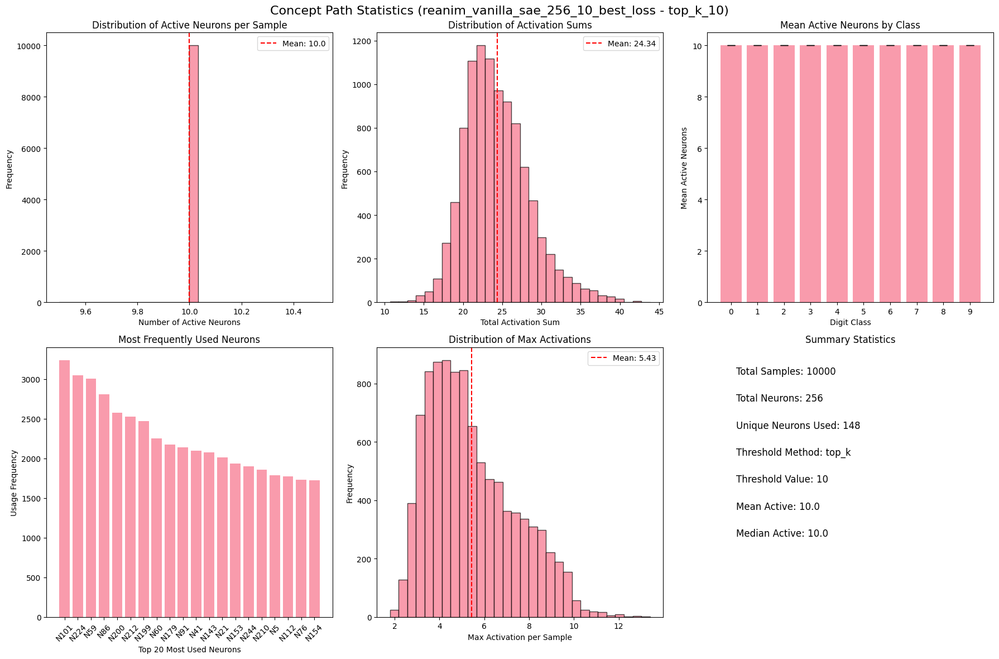

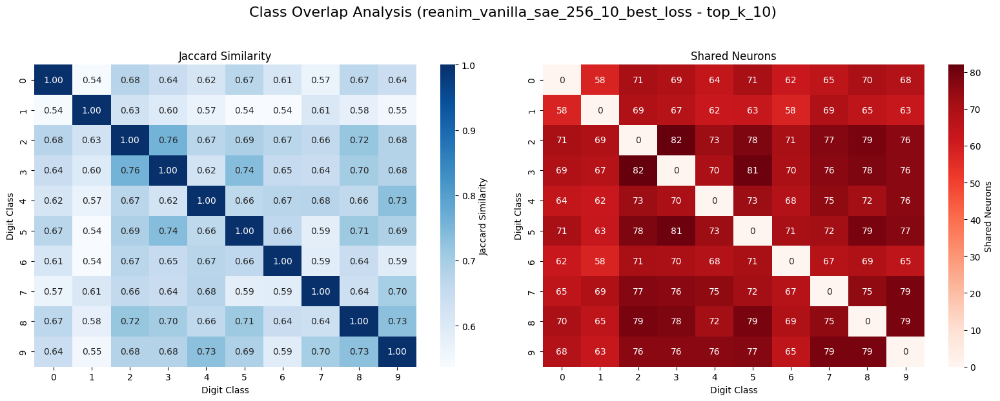

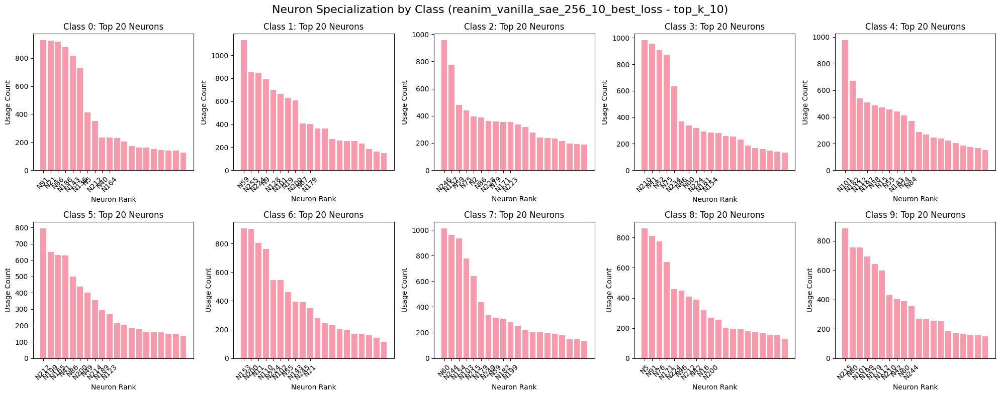


--- Analyzing config: top_k_20 ---


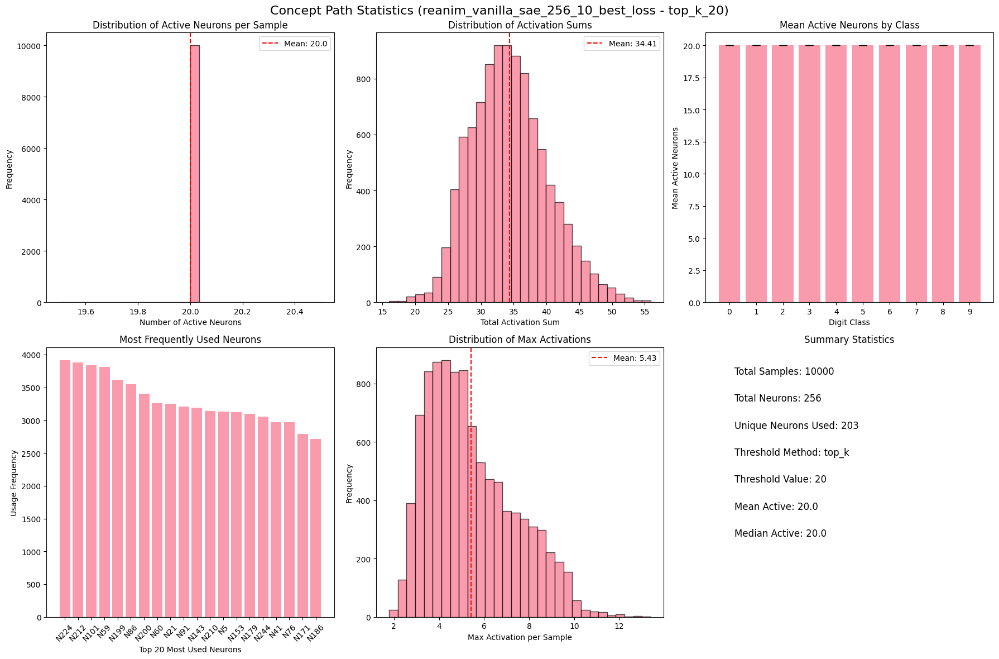

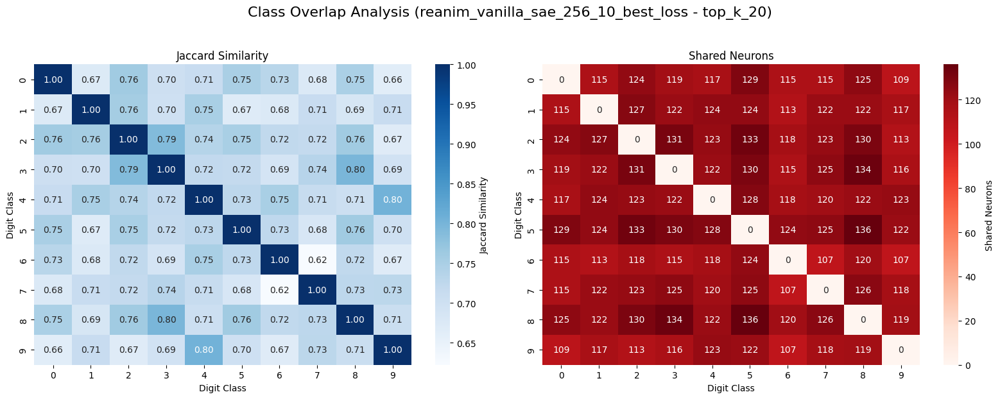

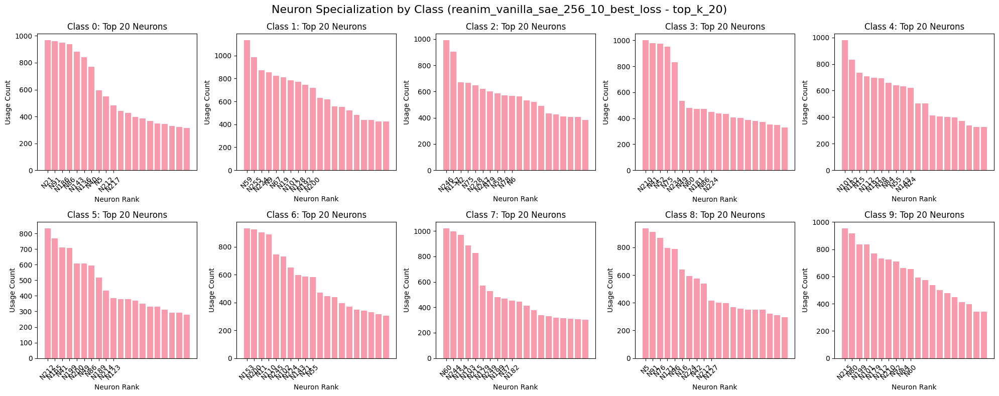


--- Analyzing config: percentile_90 ---


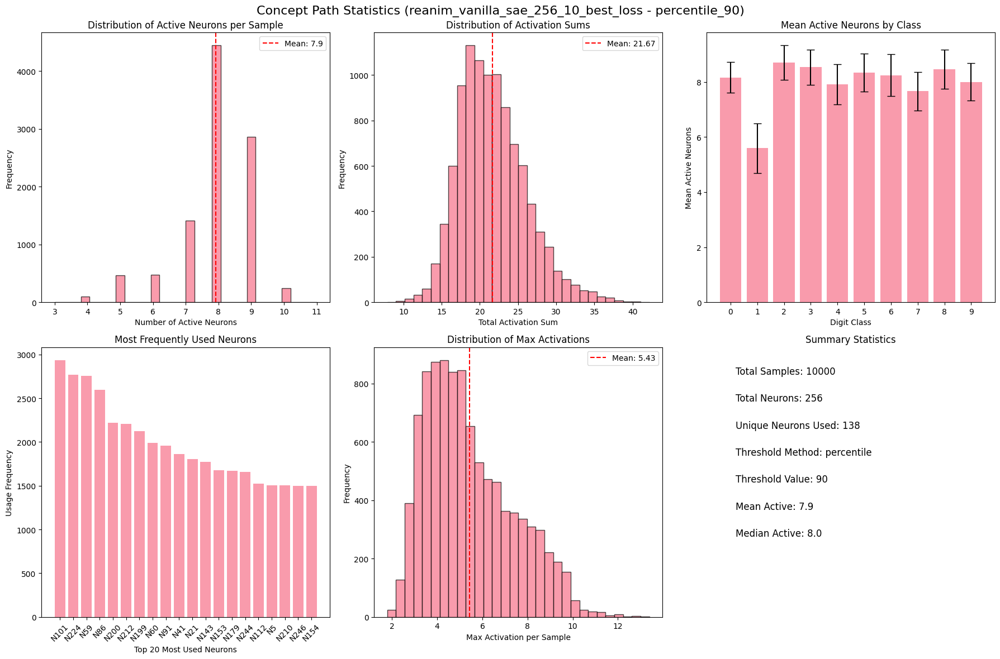

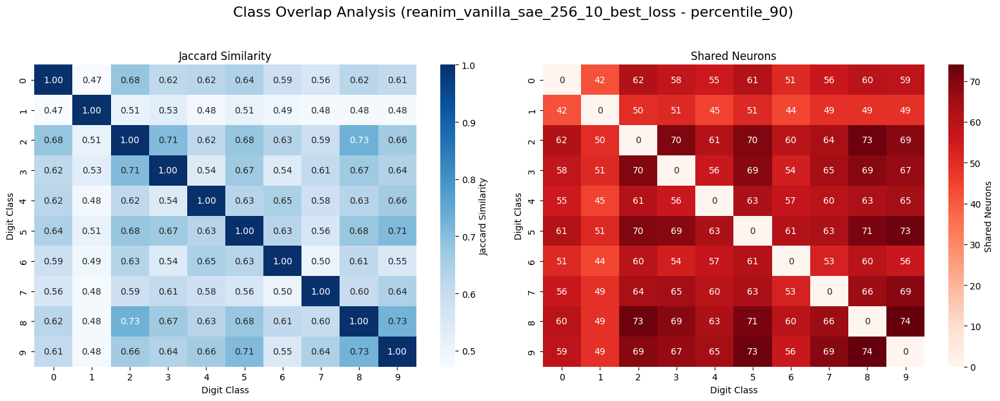

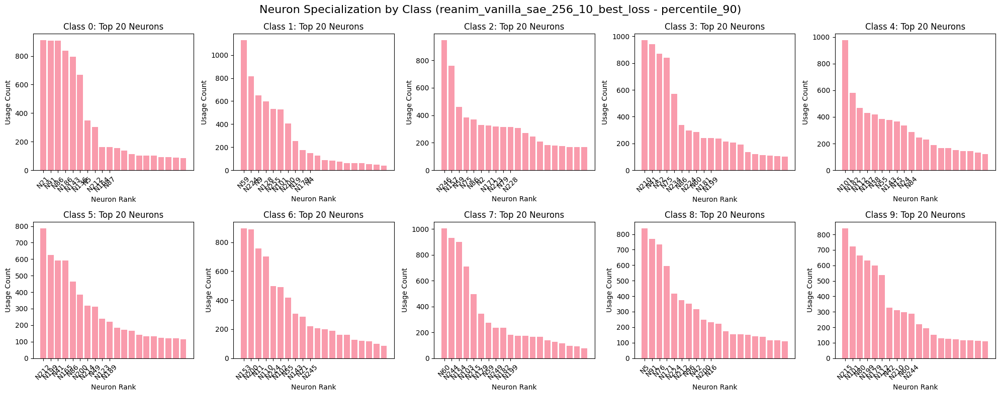


--- Analyzing config: std_threshold_1.5 ---


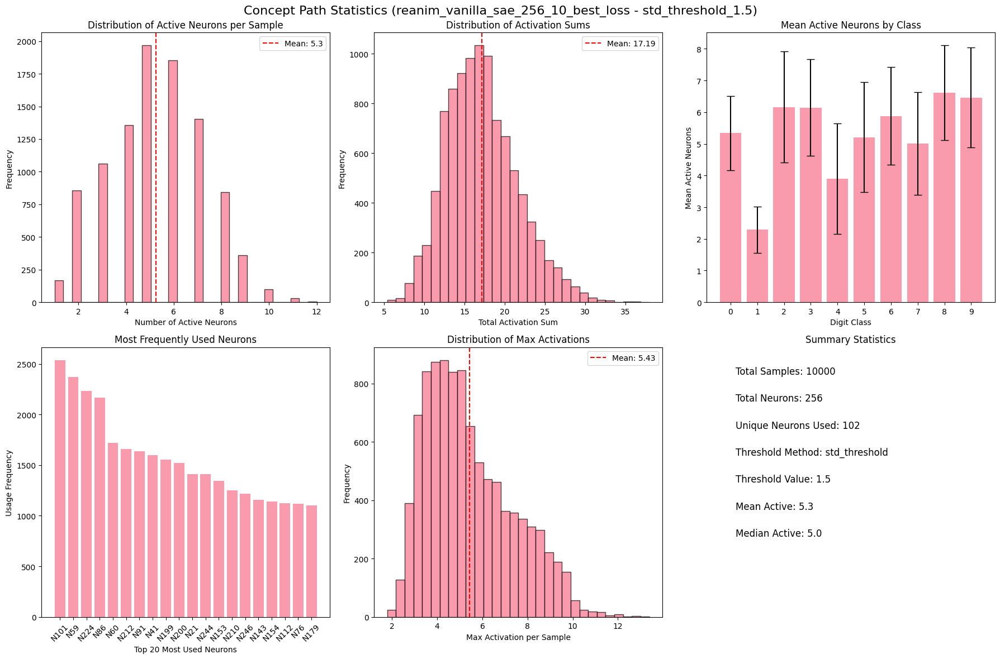

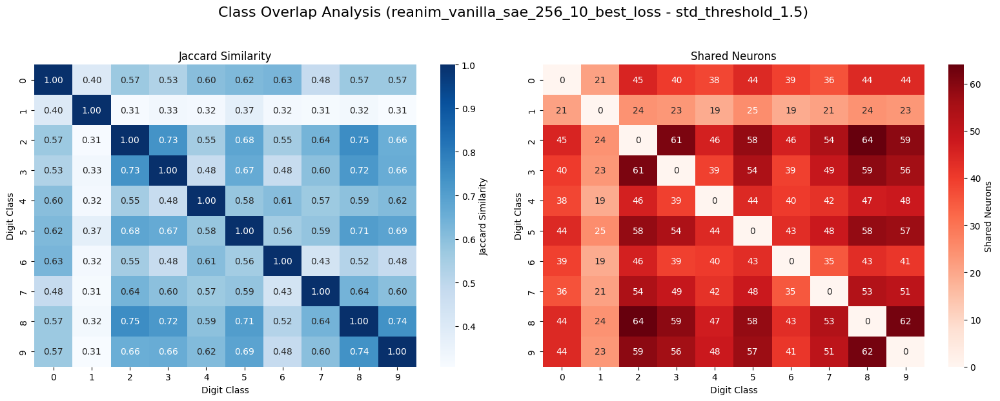

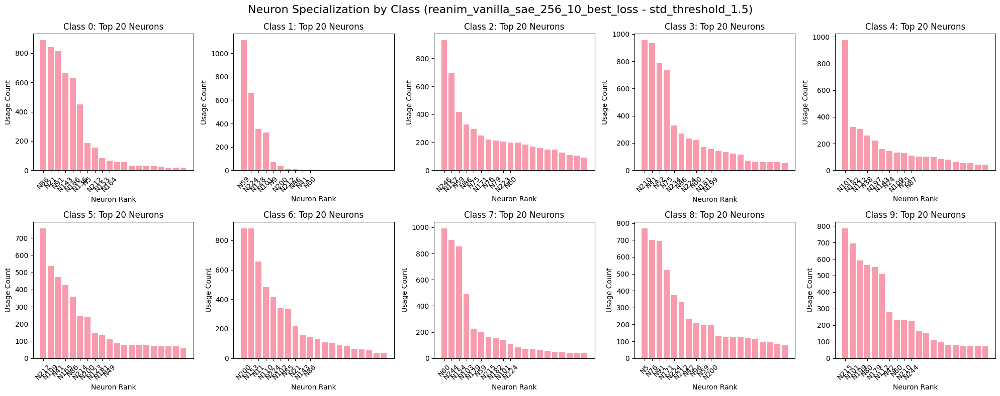


--- Comparing extraction methods for reanim_vanilla_sae_256_10_best_loss ---


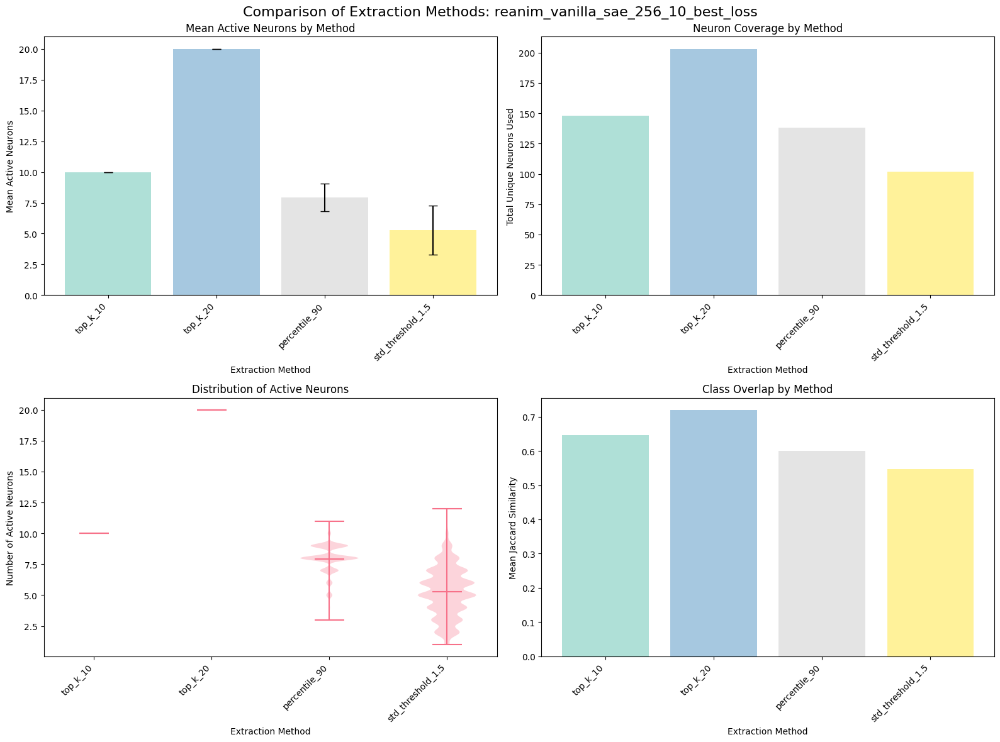


--- Summary across all SAEs (parsing parameters) ---

--- Parsed Summary DataFrame Head ---
                                   SAE    Config Training_Type  Dict_Size  \
12  reanim_vanilla_sae_256_0_best_loss  top_k_20        reanim        256   
11  reanim_vanilla_sae_256_1_best_loss  top_k_20        reanim        256   
39  reanim_vanilla_sae_256_2_best_loss  top_k_20        reanim        256   
95  reanim_vanilla_sae_256_3_best_loss  top_k_20        reanim        256   
94  reanim_vanilla_sae_256_4_best_loss  top_k_20        reanim        256   

    Penalty  Mean_Active  Unique_Neurons  Total_Neurons  Coverage  \
12        0         20.0             187            256  0.730469   
11        1         20.0             189            256  0.738281   
39        2         20.0             184            256  0.718750   
95        3         20.0             183            256  0.714844   
94        4         20.0             189            256  0.738281   

    Mean_Shared_Neurons  Mean

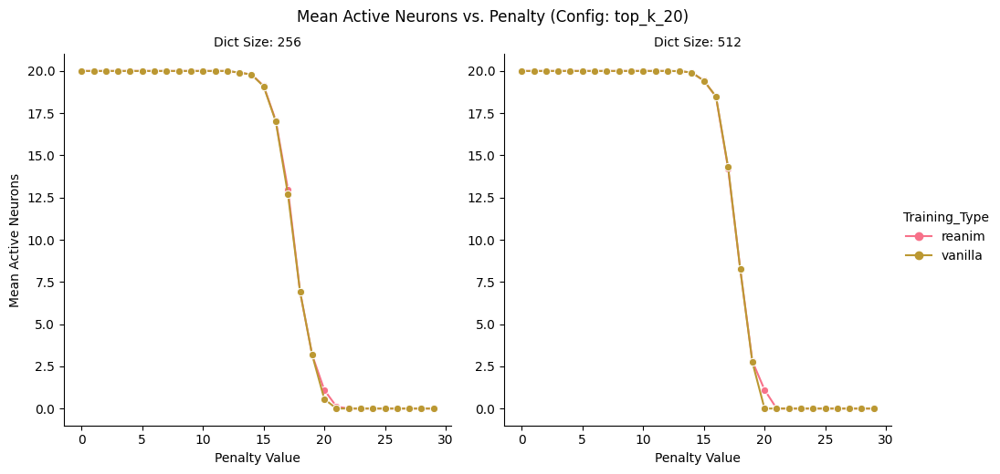


Plotting Neuron Coverage vs. Penalty...


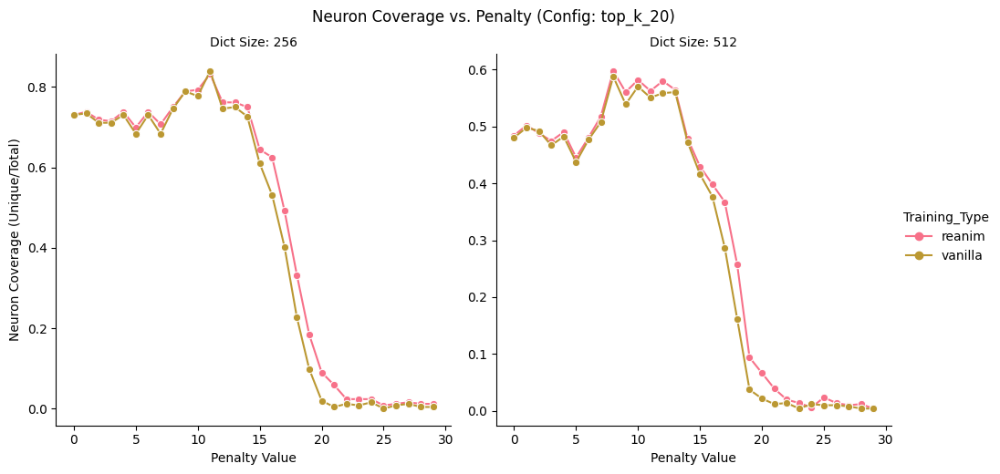


Plotting Mean Shared Neurons vs. Penalty...


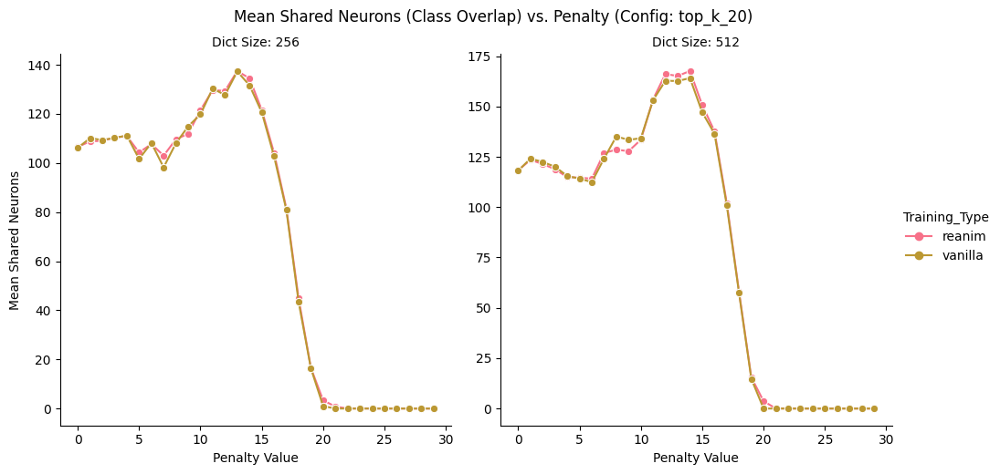


--- Class Overlap Heatmap Evolution vs. Penalty ---
Generating heatmaps for: Training=vanilla, Dict Size=512, Config=top_k_20
Found 30 SAEs. Plotting heatmaps...

Plotting for: vanilla_sae_512_0_best_loss (Penalty: 0)


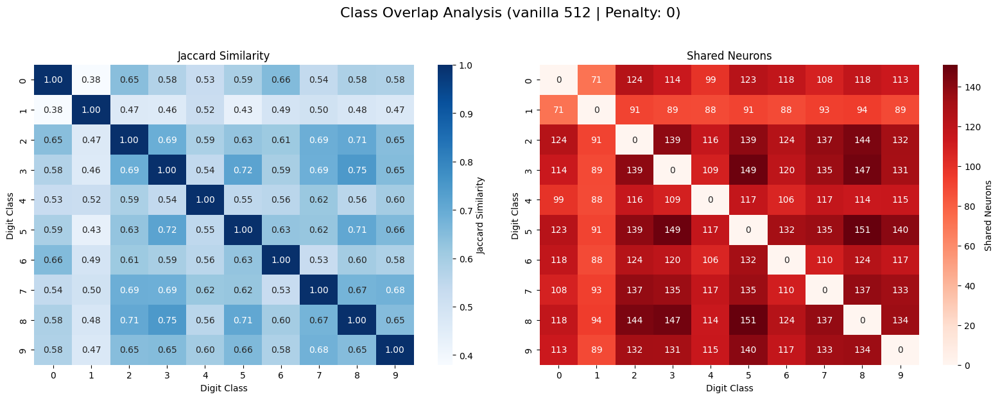


Plotting for: vanilla_sae_512_1_best_loss (Penalty: 1)


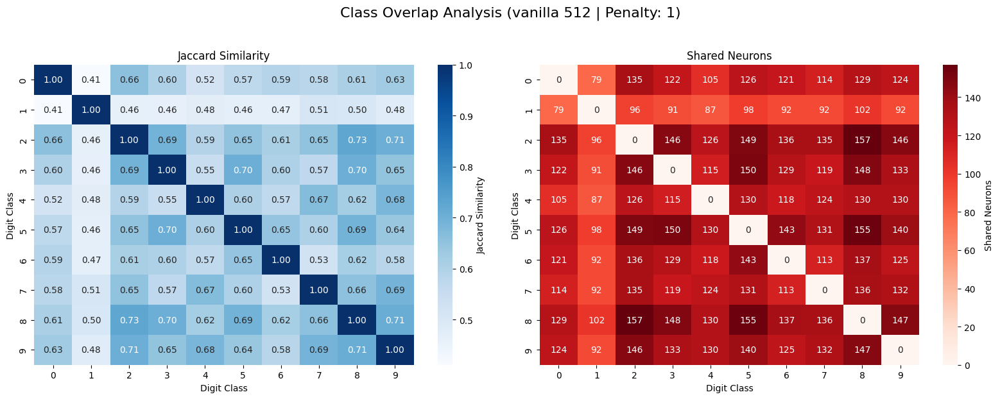


Plotting for: vanilla_sae_512_2_best_loss (Penalty: 2)


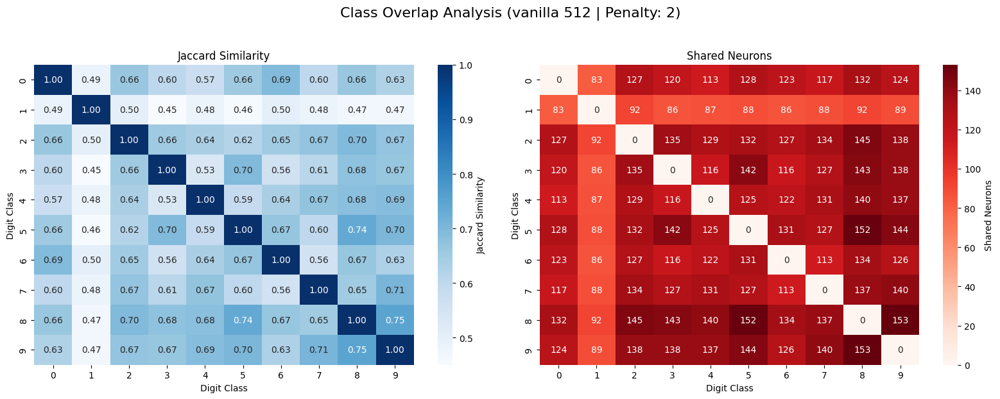


Plotting for: vanilla_sae_512_3_best_loss (Penalty: 3)


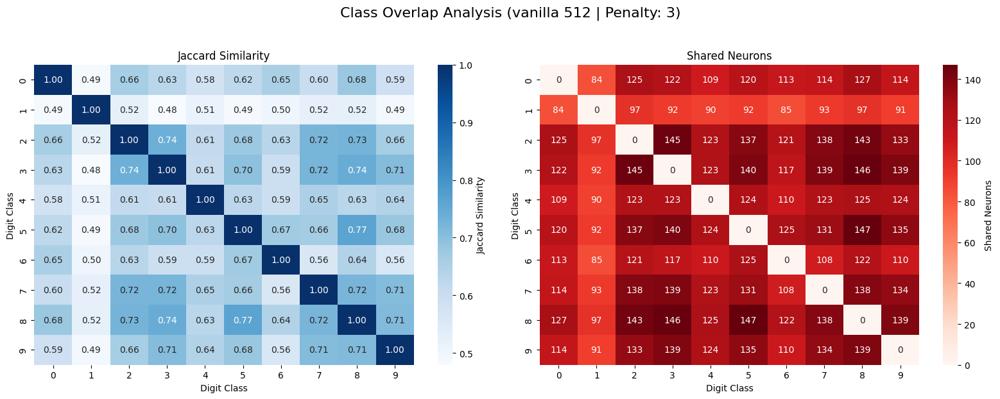


Plotting for: vanilla_sae_512_4_best_loss (Penalty: 4)


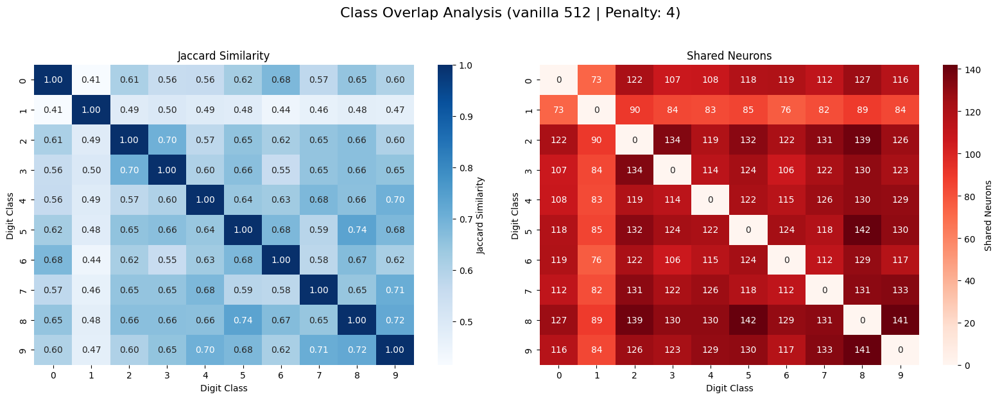


Plotting for: vanilla_sae_512_5_best_loss (Penalty: 5)


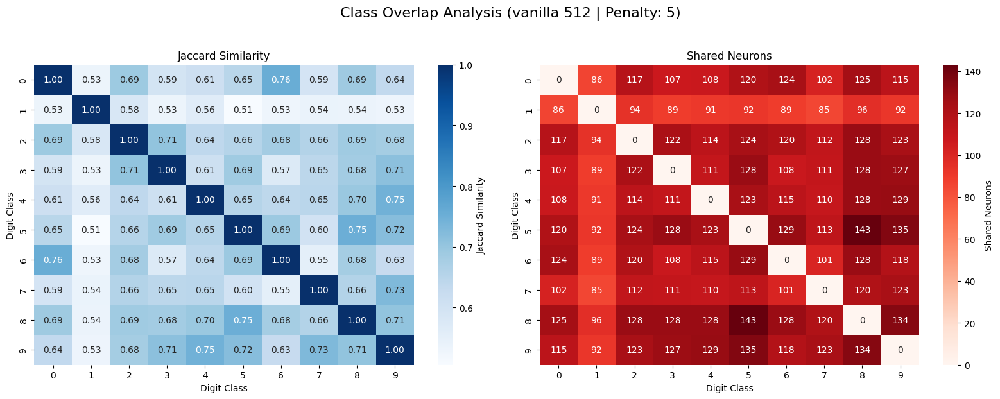


Plotting for: vanilla_sae_512_6_best_loss (Penalty: 6)


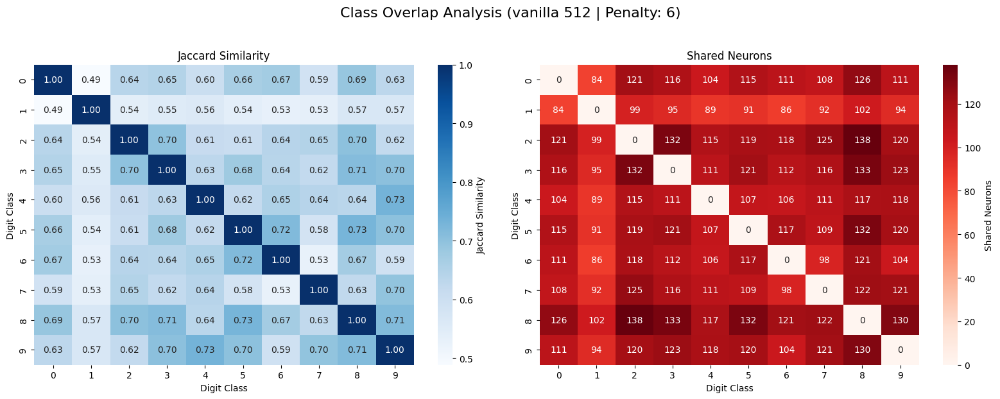


Plotting for: vanilla_sae_512_7_best_loss (Penalty: 7)


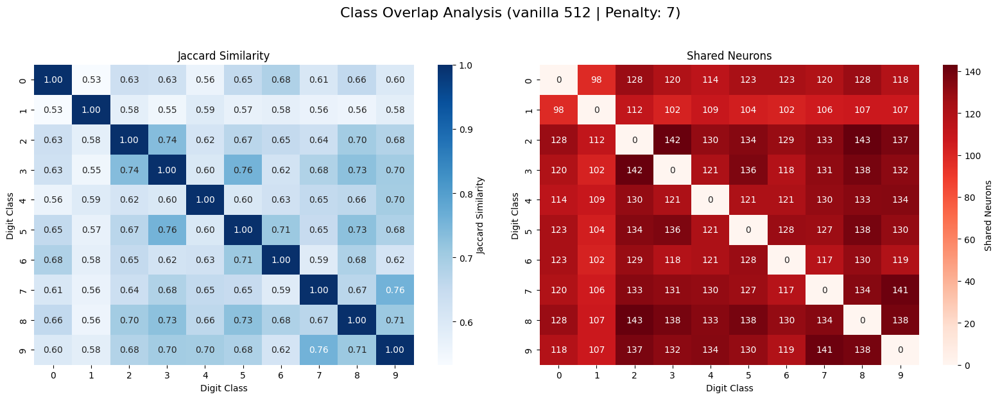


Plotting for: vanilla_sae_512_8_best_loss (Penalty: 8)


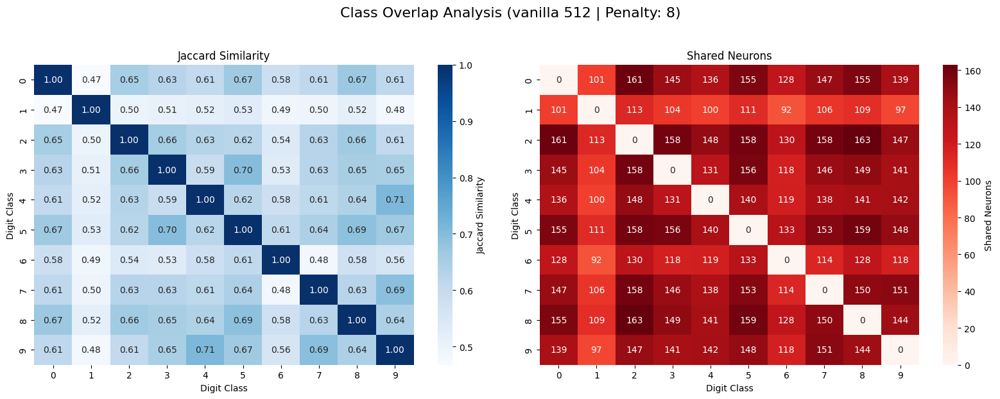


Plotting for: vanilla_sae_512_9_best_loss (Penalty: 9)


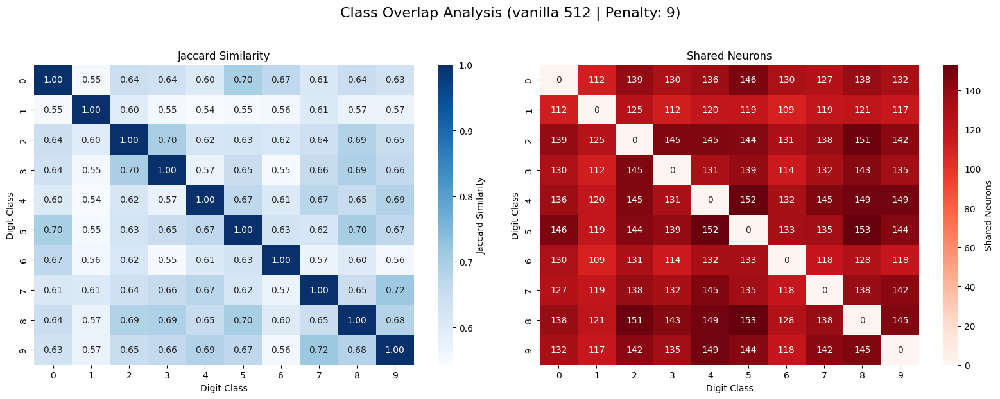


Plotting for: vanilla_sae_512_10_best_loss (Penalty: 10)


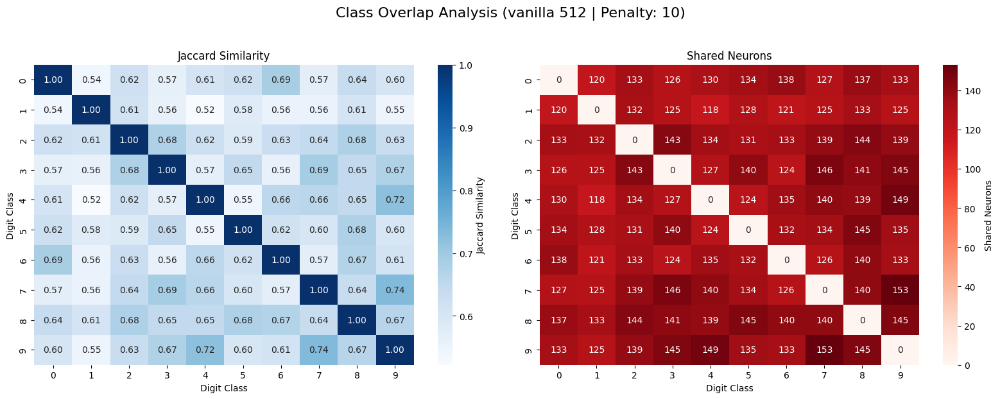


Plotting for: vanilla_sae_512_11_best_loss (Penalty: 11)


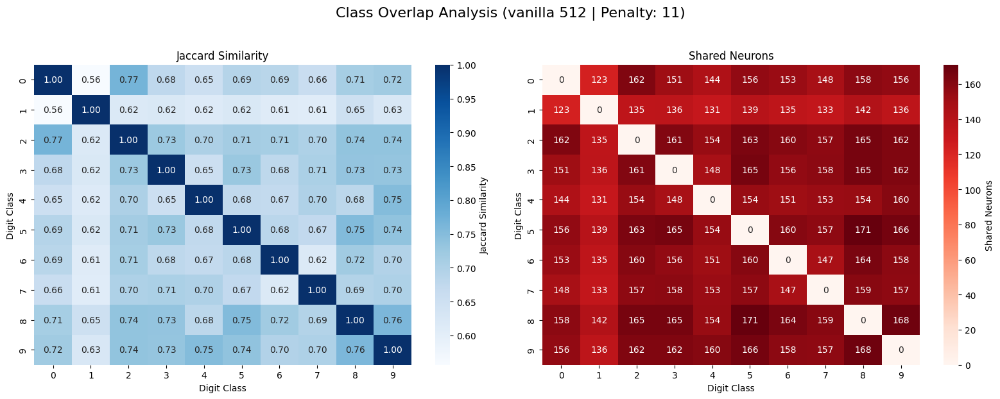


Plotting for: vanilla_sae_512_12_best_loss (Penalty: 12)


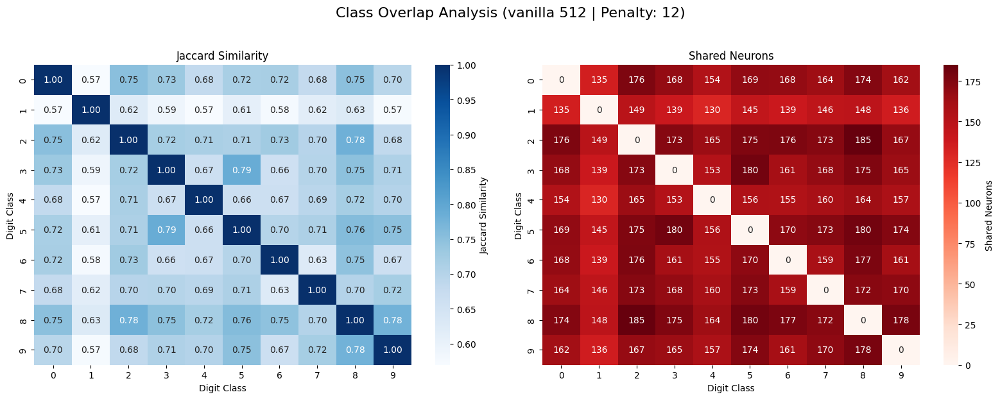


Plotting for: vanilla_sae_512_13_best_loss (Penalty: 13)


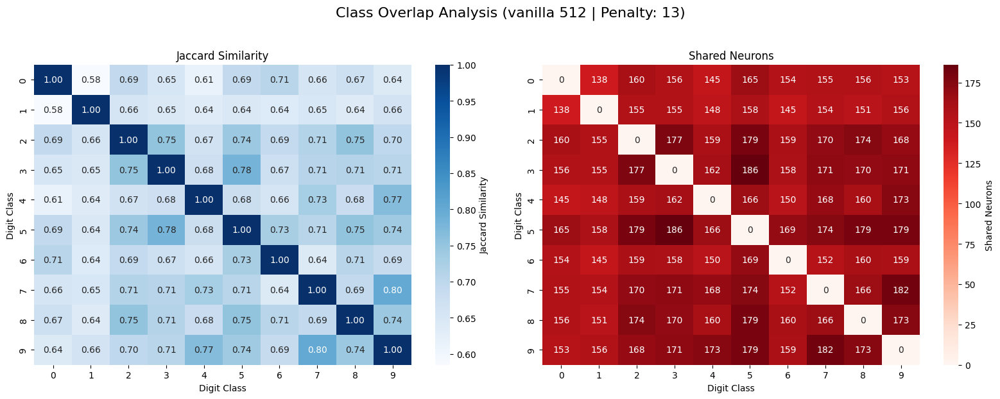


Plotting for: vanilla_sae_512_14_best_loss (Penalty: 14)


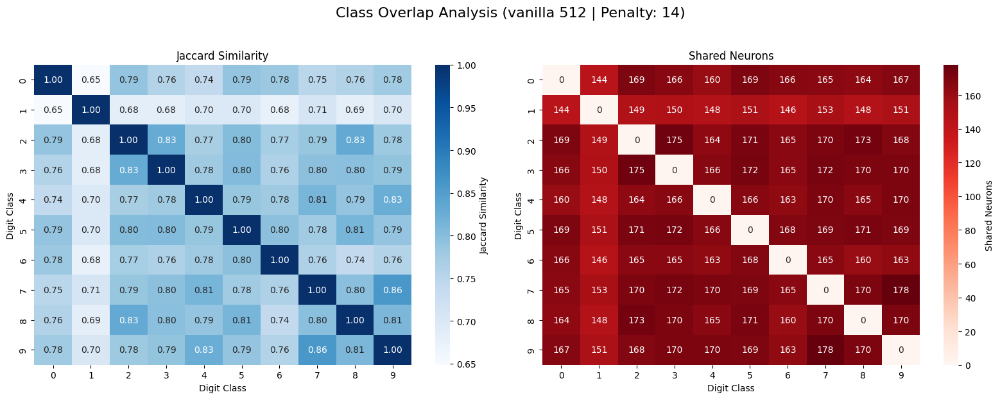


Plotting for: vanilla_sae_512_15_best_loss (Penalty: 15)


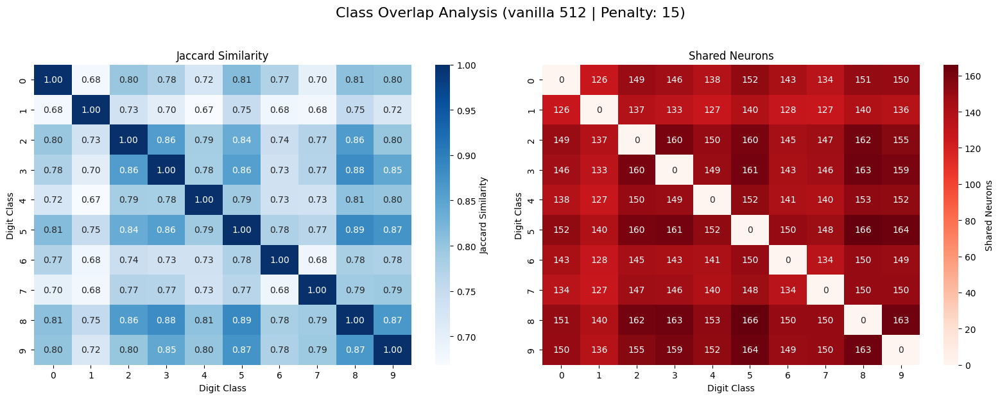


Plotting for: vanilla_sae_512_16_best_loss (Penalty: 16)


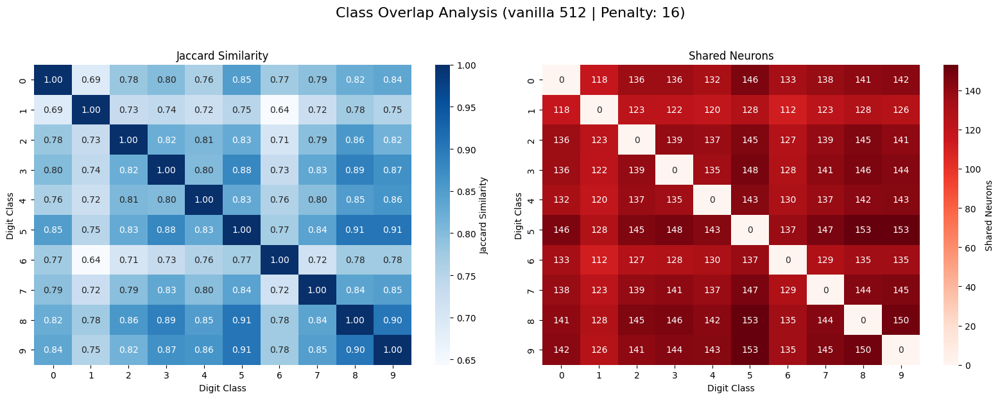


Plotting for: vanilla_sae_512_17_best_loss (Penalty: 17)


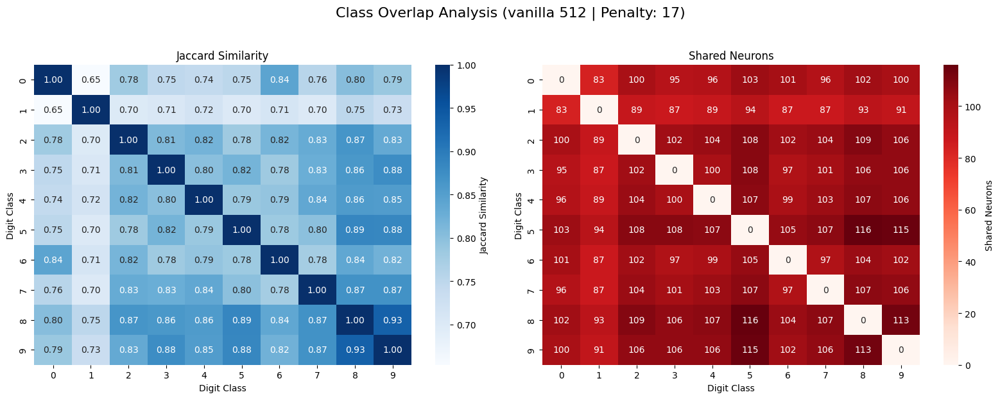


Plotting for: vanilla_sae_512_18_best_loss (Penalty: 18)


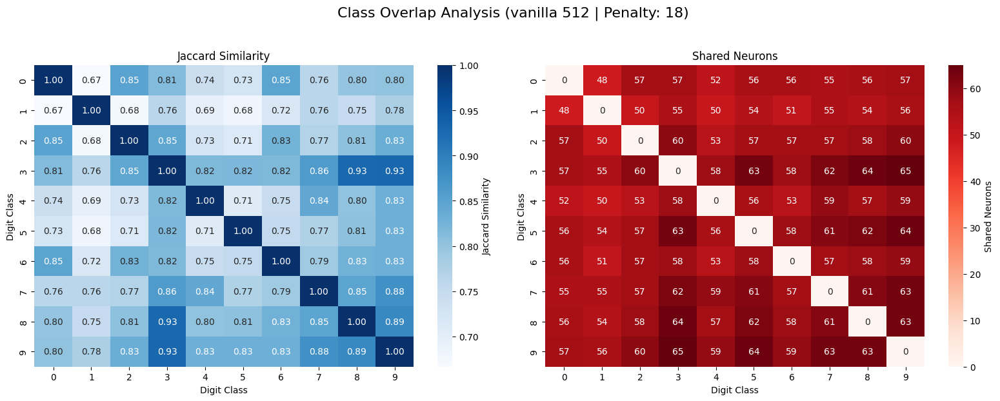


Plotting for: vanilla_sae_512_19_best_loss (Penalty: 19)


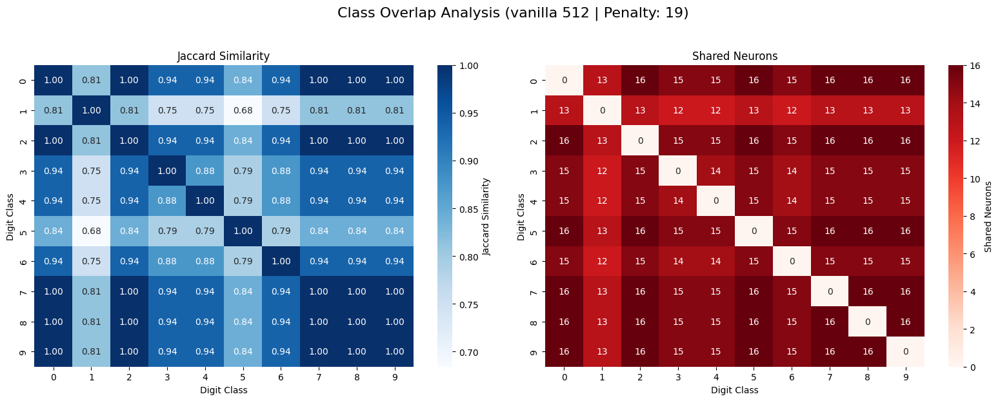


Plotting for: vanilla_sae_512_20_best_loss (Penalty: 20)


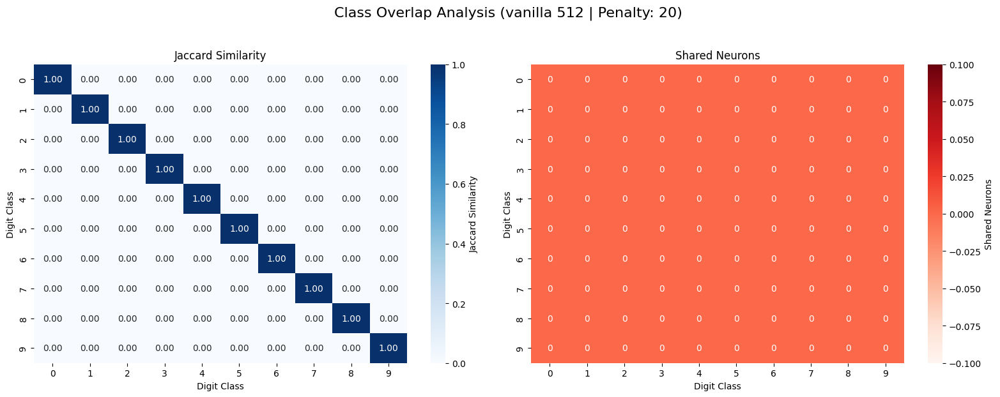


Plotting for: vanilla_sae_512_21_best_loss (Penalty: 21)


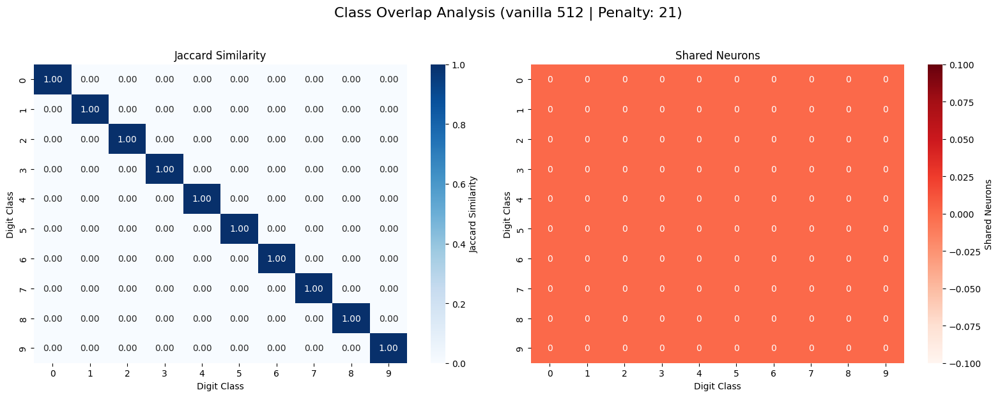


Plotting for: vanilla_sae_512_22_best_loss (Penalty: 22)


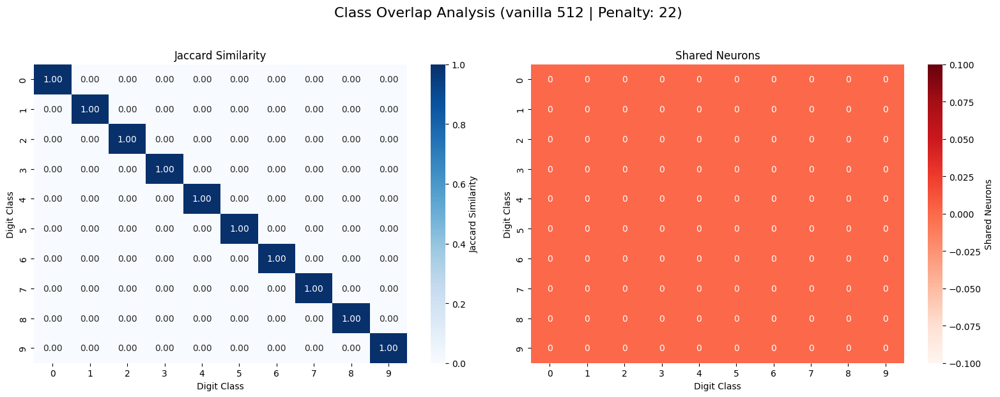


Plotting for: vanilla_sae_512_23_best_loss (Penalty: 23)


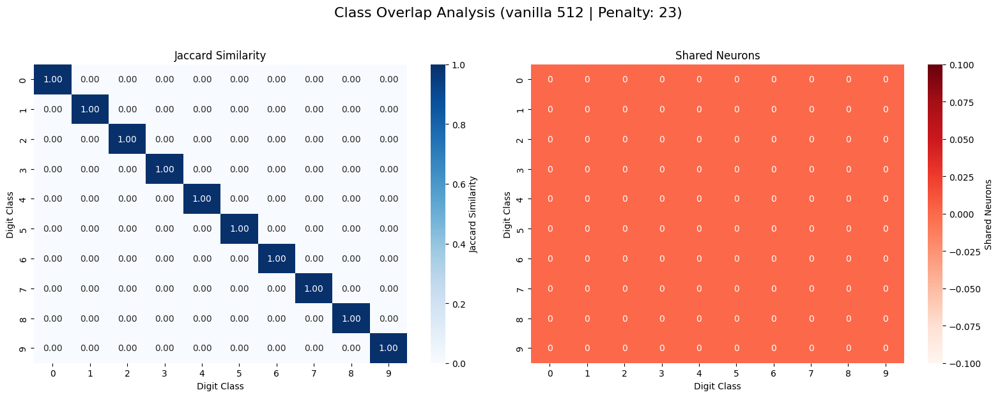


Plotting for: vanilla_sae_512_24_best_loss (Penalty: 24)


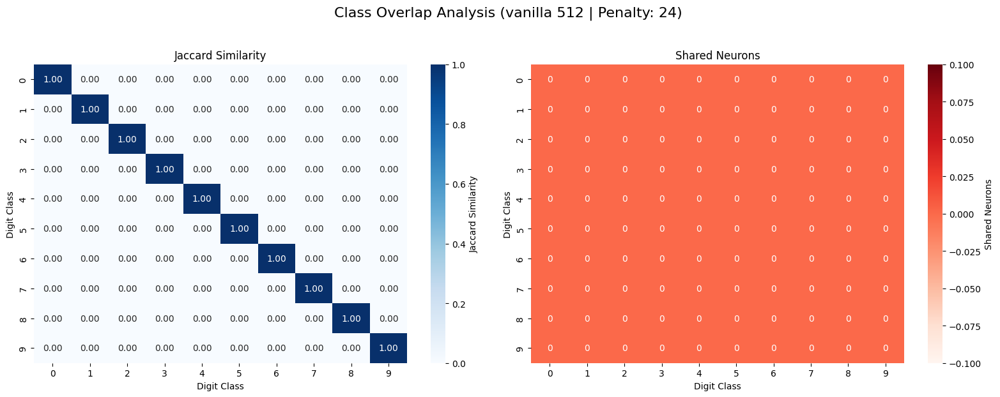


Plotting for: vanilla_sae_512_25_best_loss (Penalty: 25)


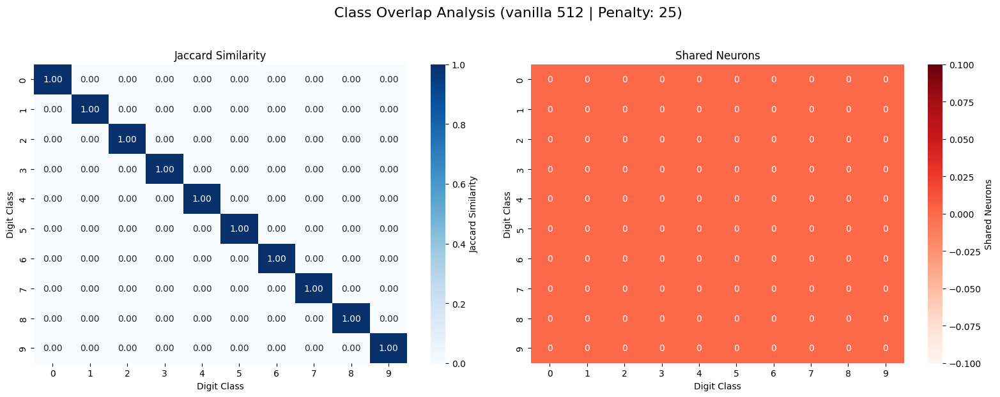


Plotting for: vanilla_sae_512_26_best_loss (Penalty: 26)


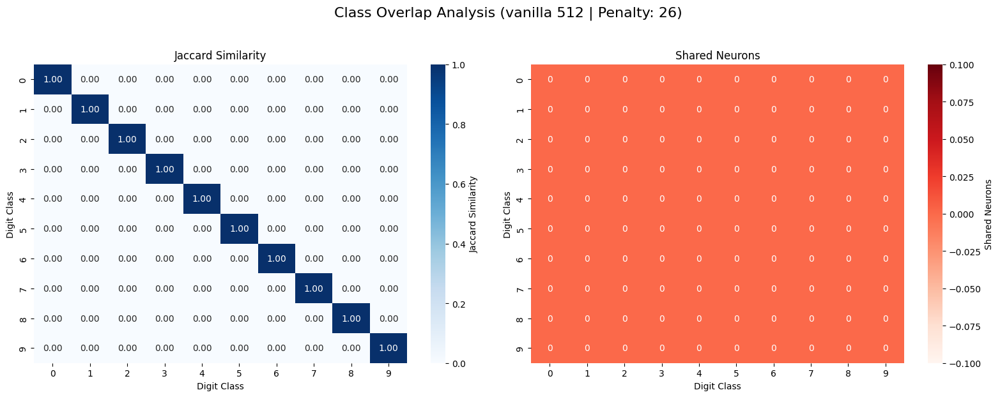


Plotting for: vanilla_sae_512_27_best_loss (Penalty: 27)


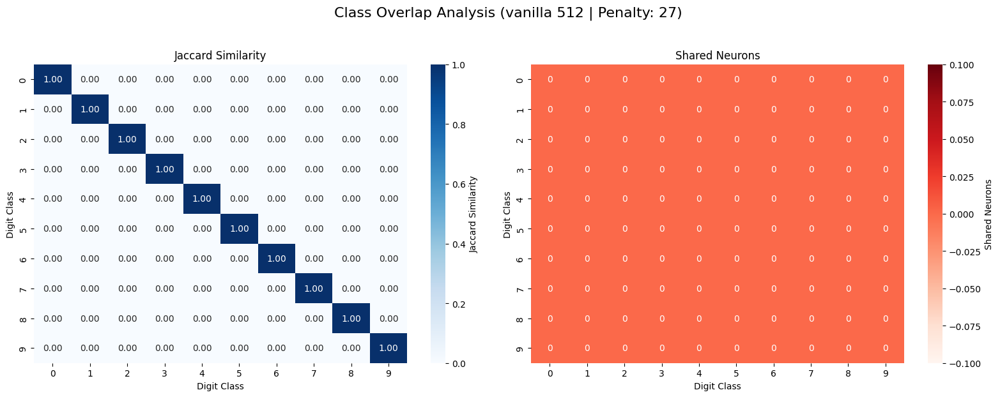


Plotting for: vanilla_sae_512_28_best_loss (Penalty: 28)


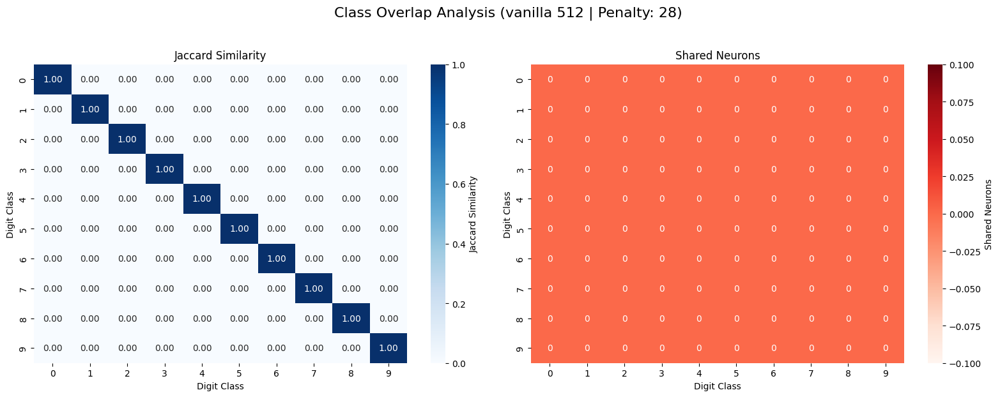


Plotting for: vanilla_sae_512_29_best_loss (Penalty: 29)


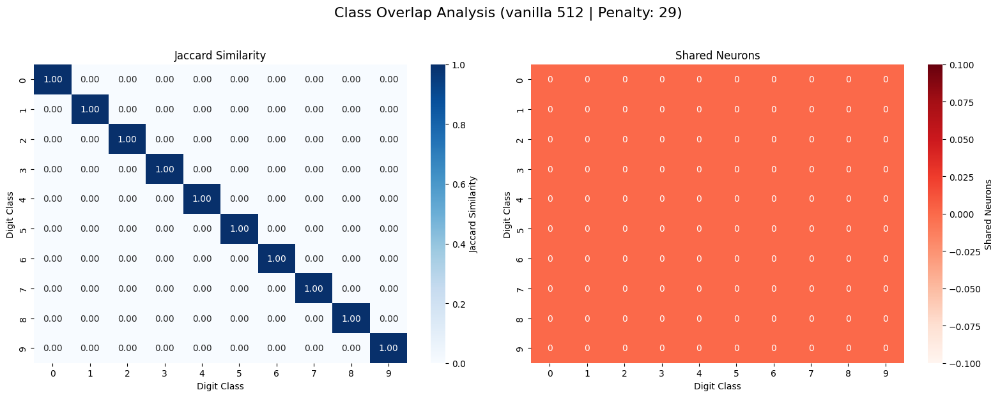


Summary Table (Config: top_k_20):
                                    SAE    Config Training_Type  Dict_Size  \
12   reanim_vanilla_sae_256_0_best_loss  top_k_20        reanim        256   
11   reanim_vanilla_sae_256_1_best_loss  top_k_20        reanim        256   
39   reanim_vanilla_sae_256_2_best_loss  top_k_20        reanim        256   
95   reanim_vanilla_sae_256_3_best_loss  top_k_20        reanim        256   
94   reanim_vanilla_sae_256_4_best_loss  top_k_20        reanim        256   
..                                  ...       ...           ...        ...   
99         vanilla_sae_512_25_best_loss  top_k_20       vanilla        512   
33         vanilla_sae_512_26_best_loss  top_k_20       vanilla        512   
1          vanilla_sae_512_27_best_loss  top_k_20       vanilla        512   
112        vanilla_sae_512_28_best_loss  top_k_20       vanilla        512   
10         vanilla_sae_512_29_best_loss  top_k_20       vanilla        512   

     Penalty  Mean_Active  U

In [13]:
# ===== CONCEPT PATHS VISUALIZATION =====
# Run this cell to visualize concept paths from your SAE analysis

import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import defaultdict, Counter
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import networkx as nx

# Set plotting style
plt.style.use('default')
sns.set_palette("husl")

concept_paths_file = '../logs/mnist_activation/Seed1/vanilla_sae/concept_path_results.pkl'

try:
    with open(concept_paths_file, 'rb') as f:
        all_concept_paths = pickle.load(f)
    print(f"Loaded concept paths for {len(all_concept_paths)} SAEs")
    
    # Display available SAEs and configs
    for sae_name, configs in all_concept_paths.items():
        print(f"\n{sae_name}: {list(configs.keys())}")
        
except FileNotFoundError:
    print(f"File not found: {concept_paths_file}")
    print("Please update the concept_paths_file path above")
    # Create dummy data for demonstration
    all_concept_paths = {}

# ===== HELPER FUNCTIONS =====

def plot_concept_path_statistics(concept_paths_data, title_suffix=""):
    """Plot basic statistics about concept paths."""
    
    concept_paths = concept_paths_data['concept_paths']
    summary = concept_paths_data['summary']
    
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    fig.suptitle(f'Concept Path Statistics {title_suffix}', fontsize=16)
    
    num_active = [path['num_active'] for path in concept_paths]
    axes[0, 0].hist(num_active, bins=30, alpha=0.7, edgecolor='black')
    axes[0, 0].axvline(np.mean(num_active), color='red', linestyle='--', 
                       label=f'Mean: {np.mean(num_active):.1f}')
    axes[0, 0].set_xlabel('Number of Active Neurons')
    axes[0, 0].set_ylabel('Frequency')
    axes[0, 0].set_title('Distribution of Active Neurons per Sample')
    axes[0, 0].legend()
    
    # 2. Distribution of activation sums
    activation_sums = [path['activation_sum'] for path in concept_paths]
    axes[0, 1].hist(activation_sums, bins=30, alpha=0.7, edgecolor='black')
    axes[0, 1].axvline(np.mean(activation_sums), color='red', linestyle='--',
                       label=f'Mean: {np.mean(activation_sums):.2f}')
    axes[0, 1].set_xlabel('Total Activation Sum')
    axes[0, 1].set_ylabel('Frequency')
    axes[0, 1].set_title('Distribution of Activation Sums')
    axes[0, 1].legend()
    
    # 3. Per-class statistics (if labels available)
    if 'class_statistics' in summary:
        class_stats = summary['class_statistics']
        classes = sorted(class_stats.keys())
        
        class_means = [class_stats[c]['mean_active_neurons'] for c in classes]
        class_stds = [class_stats[c]['std_active_neurons'] for c in classes]
        
        axes[0, 2].bar(classes, class_means, yerr=class_stds, capsize=5, alpha=0.7)
        axes[0, 2].set_xlabel('Digit Class')
        axes[0, 2].set_ylabel('Mean Active Neurons')
        axes[0, 2].set_title('Mean Active Neurons by Class')
        axes[0, 2].set_xticks(classes)
    
    # 4. Neuron usage frequency
    all_neurons = []
    for path in concept_paths:
        all_neurons.extend(path['active_neurons'])
    
    neuron_counts = Counter(all_neurons)
    top_neurons = dict(sorted(neuron_counts.items(), key=lambda x: x[1], reverse=True)[:20])
    
    axes[1, 0].bar(range(len(top_neurons)), list(top_neurons.values()), alpha=0.7)
    axes[1, 0].set_xlabel('Top 20 Most Used Neurons')
    axes[1, 0].set_ylabel('Usage Frequency')
    axes[1, 0].set_title('Most Frequently Used Neurons')
    axes[1, 0].set_xticks(range(len(top_neurons)))
    axes[1, 0].set_xticklabels([f'N{k}' for k in top_neurons.keys()], rotation=45)
    
    # 5. Max activation distribution
    max_activations = [path['max_activation'] for path in concept_paths]
    axes[1, 1].hist(max_activations, bins=30, alpha=0.7, edgecolor='black')
    axes[1, 1].axvline(np.mean(max_activations), color='red', linestyle='--',
                       label=f'Mean: {np.mean(max_activations):.2f}')
    axes[1, 1].set_xlabel('Max Activation per Sample')
    axes[1, 1].set_ylabel('Frequency')
    axes[1, 1].set_title('Distribution of Max Activations')
    axes[1, 1].legend()
    
    # 6. Summary text
    axes[1, 2].text(0.1, 0.9, f"Total Samples: {summary['n_samples']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.8, f"Total Neurons: {summary['n_neurons']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.7, f"Unique Neurons Used: {summary['total_unique_neurons_used']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.6, f"Threshold Method: {summary['threshold_method']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.5, f"Threshold Value: {summary['threshold_value']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.4, f"Mean Active: {summary['mean_active_neurons']:.1f}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.3, f"Median Active: {summary['median_active_neurons']:.1f}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].set_xlim(0, 1)
    axes[1, 2].set_ylim(0, 1)
    axes[1, 2].set_title('Summary Statistics')
    axes[1, 2].axis('off')
    
    plt.tight_layout()
    plt.show()

def plot_class_overlap_heatmap(concept_paths_data, title_suffix=""):
    """Plot heatmap of class overlaps."""
    
    if 'overlap_analysis' not in concept_paths_data:
        print(f"No overlap analysis found in concept paths data for {title_suffix}")
        return
    
    overlap_data = concept_paths_data['overlap_analysis'].get('overlap_analysis')
    if not overlap_data:
        print(f"No 'overlap_analysis' sub-key found for {title_suffix}")
        return
    
    # Extract classes from overlap keys
    classes = set()
    for key in overlap_data.keys():
        parts = key.split('_')
        try:
            classes.add(int(parts[1]))
            classes.add(int(parts[3]))
        except (IndexError, ValueError):
            print(f"Warning: Could not parse class from overlap key: {key}")
            continue
    classes = sorted(classes)
    if not classes:
        print("Warning: No valid classes found for overlap heatmap.")
        return

    # Create matrices for different overlap metrics
    jaccard_matrix = np.zeros((len(classes), len(classes)))
    shared_neurons_matrix = np.zeros((len(classes), len(classes)))
    
    for key, data in overlap_data.items():
        parts = key.split('_')
        try:
            i, j = int(parts[1]), int(parts[3])
            i_idx, j_idx = classes.index(i), classes.index(j)
            
            jaccard_matrix[i_idx, j_idx] = data['jaccard_similarity']
            jaccard_matrix[j_idx, i_idx] = data['jaccard_similarity']  # Symmetric
            
            shared_neurons_matrix[i_idx, j_idx] = data['shared_neurons']
            shared_neurons_matrix[j_idx, i_idx] = data['shared_neurons']
        except (IndexError, ValueError, KeyError):
            continue # Skip if key is malformed or data is missing
    
    # Set diagonal to 1 for Jaccard (self-similarity)
    np.fill_diagonal(jaccard_matrix, 1.0)
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))
    fig.suptitle(f'Class Overlap Analysis {title_suffix}', fontsize=16, y=1.03)
    
    # Jaccard similarity heatmap
    sns.heatmap(jaccard_matrix, 
                xticklabels=classes, yticklabels=classes,
                annot=True, fmt='.2f', cmap='Blues',
                ax=ax1, cbar_kws={'label': 'Jaccard Similarity'})
    ax1.set_title(f'Jaccard Similarity')
    ax1.set_xlabel('Digit Class')
    ax1.set_ylabel('Digit Class')
    
    # Shared neurons heatmap
    sns.heatmap(shared_neurons_matrix,
                xticklabels=classes, yticklabels=classes,
                annot=True, fmt='.0f', cmap='Reds',
                ax=ax2, cbar_kws={'label': 'Shared Neurons'})
    ax2.set_title(f'Shared Neurons')
    ax2.set_xlabel('Digit Class')
    ax2.set_ylabel('Digit Class')
    
    plt.tight_layout()
    plt.show()

def plot_neuron_class_specialization(concept_paths_data, top_n=20, title_suffix=""):
    """Plot which neurons are most specialized for each class."""
    
    concept_paths = concept_paths_data['concept_paths']
    summary = concept_paths_data['summary']
    
    if 'class_statistics' not in summary:
        print("No class statistics available")
        return
    
    # Count neuron usage per class
    class_neuron_usage = defaultdict(lambda: defaultdict(int))
    
    for path in concept_paths:
        if 'label' in path:
            label = path['label']
            for neuron_idx in path['active_neurons']:
                class_neuron_usage[label][neuron_idx] += 1
    
    # Find most specialized neurons for each class
    classes = sorted(class_neuron_usage.keys())
    n_classes = len(classes)
    
    # Adjust subplot grid if there are fewer than 10 classes (e.g., MNIST)
    n_cols = 5
    n_rows = int(np.ceil(n_classes / n_cols))
    if n_rows == 0: n_rows = 1
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 4 * n_rows))
    axes = axes.flatten()
    
    for i, class_label in enumerate(classes):
        if i >= len(axes):
            break
            
        neuron_counts = class_neuron_usage[class_label]
        
        # Get top neurons for this class
        top_neurons = sorted(neuron_counts.items(), key=lambda x: x[1], reverse=True)[:top_n]
        
        if not top_neurons:
            axes[i].text(0.5, 0.5, 'No active neurons', ha='center', va='center', transform=axes[i].transAxes)
            axes[i].set_title(f'Class {class_label}: Top {top_n} Neurons')
            continue
            
        neurons, counts = zip(*top_neurons)
        
        axes[i].bar(range(len(neurons)), counts, alpha=0.7)
        axes[i].set_title(f'Class {class_label}: Top {top_n} Neurons')
        axes[i].set_xlabel('Neuron Rank')
        axes[i].set_ylabel('Usage Count')
        axes[i].set_xticks(range(min(10, len(neurons))))
        axes[i].set_xticklabels([f'N{n}' for n in neurons[:10]], rotation=45)
    
    # Hide unused subplots
    for j in range(i + 1, len(axes)):
        axes[j].set_visible(False)
    
    fig.suptitle(f'Neuron Specialization by Class {title_suffix}', fontsize=16)
    plt.tight_layout()
    plt.show()

def compare_extraction_methods(sae_concept_paths, sae_name):
    """Compare different concept path extraction methods for the same SAE."""
    
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    fig.suptitle(f'Comparison of Extraction Methods: {sae_name}', fontsize=16)
    
    methods = list(sae_concept_paths.keys())
    if not methods:
        print("No extraction methods to compare.")
        plt.close(fig)
        return
        
    colors = plt.cm.Set3(np.linspace(0, 1, len(methods)))
    
    # 1. Mean active neurons comparison
    method_names = []
    mean_active = []
    std_active = []
    
    for method in methods:
        data = sae_concept_paths.get(method, {})
        if 'summary' not in data: continue
        summary = data['summary']
        method_names.append(method)
        mean_active.append(summary.get('mean_active_neurons', np.nan))
        std_active.append(summary.get('std_active_neurons', np.nan))
    
    if not method_names:
         print("No valid summary data for method comparison.")
         plt.close(fig)
         return

    bars = axes[0, 0].bar(range(len(method_names)), mean_active, 
                           yerr=std_active, capsize=5, alpha=0.7, color=colors)
    axes[0, 0].set_xlabel('Extraction Method')
    axes[0, 0].set_ylabel('Mean Active Neurons')
    axes[0, 0].set_title('Mean Active Neurons by Method')
    axes[0, 0].set_xticks(range(len(method_names)))
    axes[0, 0].set_xticklabels(method_names, rotation=45, ha='right')
    
    # 2. Total unique neurons used
    unique_neurons = [sae_concept_paths[method]['summary'].get('total_unique_neurons_used', np.nan)
                       for method in method_names]
    
    axes[0, 1].bar(range(len(method_names)), unique_neurons, alpha=0.7, color=colors)
    axes[0, 1].set_xlabel('Extraction Method')
    axes[0, 1].set_ylabel('Total Unique Neurons Used')
    axes[0, 1].set_title('Neuron Coverage by Method')
    axes[0, 1].set_xticks(range(len(method_names)))
    axes[0, 1].set_xticklabels(method_names, rotation=45, ha='right')
    
    # 3. Distribution of active neurons (violin plot)
    all_num_active = []
    method_labels = []
    
    for method in method_names:
        concept_paths = sae_concept_paths[method].get('concept_paths', [])
        num_active = [path['num_active'] for path in concept_paths]
        all_num_active.extend(num_active)
        method_labels.extend([method] * len(num_active))
    
    if all_num_active:
        # Create dataframe for seaborn
        df = pd.DataFrame({'Method': method_labels, 'Active_Neurons': all_num_active})
        
        # Use matplotlib for violin plot
        method_data = [df[df['Method'] == method]['Active_Neurons'].values for method in method_names]
        
        parts = axes[1, 0].violinplot(method_data, positions=range(len(method_names)), showmeans=True)
        axes[1, 0].set_xlabel('Extraction Method')
        axes[1, 0].set_ylabel('Number of Active Neurons')
        axes[1, 0].set_title('Distribution of Active Neurons')
        axes[1, 0].set_xticks(range(len(method_names)))
        axes[1, 0].set_xticklabels(method_names, rotation=45, ha='right')
    else:
        axes[1, 0].text(0.5, 0.5, 'No activation data available', 
                          ha='center', va='center', transform=axes[1, 0].transAxes)
        axes[1, 0].set_title('Distribution of Active Neurons')

    
    # 4. Mean overlap between classes (if available)
    mean_overlaps = []
    for method in method_names:
        overlap_data = sae_concept_paths[method].get('overlap_analysis', {})
        summary = overlap_data.get('summary', {})
        mean_overlaps.append(summary.get('mean_jaccard', 0))
    
    if any(overlap > 0 for overlap in mean_overlaps):
        axes[1, 1].bar(range(len(method_names)), mean_overlaps, alpha=0.7, color=colors)
        axes[1, 1].set_xlabel('Extraction Method')
        axes[1, 1].set_ylabel('Mean Jaccard Similarity')
        axes[1, 1].set_title('Class Overlap by Method')
        axes[1, 1].set_xticks(range(len(method_names)))
        axes[1, 1].set_xticklabels(method_names, rotation=45, ha='right')
    else:
        axes[1, 1].text(0.5, 0.5, 'No overlap data available', 
                          ha='center', va='center', transform=axes[1, 1].transAxes)
        axes[1, 1].set_title('Class Overlap by Method')
    
    plt.tight_layout()
    plt.show()

# ===== MAIN VISUALIZATION CODE =====

if all_concept_paths:
    print("=== CONCEPT PATHS VISUALIZATION ===\n")
    
    # Select which SAE and config to visualize
    sae_names = list(all_concept_paths.keys())
    print("Available SAEs:")
    for i, name in enumerate(sae_names):
        print(f"{i}: {name}")
    
    # Visualize the first SAE (change index as needed)
    selected_sae_idx = 0
    if sae_names:
        selected_sae = sae_names[selected_sae_idx]
        
        print(f"\nVisualizing: {selected_sae}")
        
        # Get available configs for this SAE
        configs = list(all_concept_paths[selected_sae].keys())
        print(f"Available configs: {configs}")
        
        # Visualize each config
        for config in configs: 
            print(f"\n--- Analyzing config: {config} ---")
            concept_paths_data = all_concept_paths[selected_sae].get(config)
            if not concept_paths_data:
                print(f"No data for config {config}, skipping.")
                continue
            
            # Basic statistics
            plot_concept_path_statistics(concept_paths_data, f"({selected_sae} - {config})")
            
            # Class overlap heatmap
            plot_class_overlap_heatmap(concept_paths_data, f"({selected_sae} - {config})")
            
            # Neuron specialization
            plot_neuron_class_specialization(concept_paths_data, title_suffix=f"({selected_sae} - {config})")
        
        # Compare different extraction methods for the same SAE
        print(f"\n--- Comparing extraction methods for {selected_sae} ---")
        compare_extraction_methods(all_concept_paths[selected_sae], selected_sae)
    else:
        print("No SAEs found in the data.")

    # ===== NEW SUMMARY SECTION =====
    print("\n--- Summary across all SAEs (parsing parameters) ---")
    
    summary_data = []
    config_to_use = 'top_k_20' # Default config to use for comparison
    
    for sae_name, configs in all_concept_paths.items():
        # Try to get a consistent config, e.g., 'top_k_10', fallback to first
        current_config_to_use = None
        if config_to_use in configs:
            current_config_to_use = config_to_use
        elif configs:
            current_config_to_use = list(configs.keys())[0]
            if sae_name == sae_names[0]: # Set config_to_use based on first SAE if default not found
                config_to_use = current_config_to_use
        
        if not current_config_to_use:
            print(f"Warning: No configs found for {sae_name}. Skipping.")
            continue

        if current_config_to_use != config_to_use:
             print(f"Warning: Config '{config_to_use}' not found for {sae_name}. Using '{current_config_to_use}' instead.")
            
        summary = configs[current_config_to_use].get('summary')
        if not summary:
            print(f"Warning: No summary found for {sae_name} config {current_config_to_use}. Skipping.")
            continue
            
        # Get overlap summary if it exists
        overlap_summary = configs[current_config_to_use].get('overlap_analysis', {}).get('summary', {})
        mean_shared_neurons = overlap_summary.get('mean_shared_neurons', np.nan)
        mean_jaccard = overlap_summary.get('mean_jaccard', np.nan)


        # Parse parameters from sae_name
        training_type = None
        dict_size = None
        penalty = None
        parts = sae_name.split('_')

        try:
            if sae_name.startswith('reanim_vanilla_sae_'):
                # e.g., reanim_vanilla_sae_256_10_best_loss
                training_type = 'reanim'
                dict_size = int(parts[3])
                penalty = int(parts[4])
            elif sae_name.startswith('vanilla_sae_'):
                # e.g., vanilla_sae_512_27_best_loss
                training_type = 'vanilla'
                dict_size = int(parts[2])
                penalty = int(parts[3])
            else:
                print(f"Warning: Unrecognized SAE name format: {sae_name}. Skipping.")
                continue
        except (IndexError, ValueError) as e:
            print(f"Warning: Could not parse {sae_name}: {e}. Skipping.")
            continue

        summary_data.append({
            'SAE': sae_name,
            'Config': current_config_to_use,
            'Training_Type': training_type,
            'Dict_Size': dict_size,
            'Penalty': penalty,
            'Mean_Active': summary.get('mean_active_neurons', np.nan),
            'Unique_Neurons': summary.get('total_unique_neurons_used', np.nan),
            'Total_Neurons': summary.get('n_neurons', np.nan),
            'Coverage': (summary.get('total_unique_neurons_used', np.nan) / 
                         summary.get('n_neurons', 1)), # Avoid divide by zero
            'Mean_Shared_Neurons': mean_shared_neurons,
            'Mean_Jaccard': mean_jaccard
        })
    
    if summary_data:
        summary_df = pd.DataFrame(summary_data)
        summary_df = summary_df.dropna(subset=['Training_Type', 'Dict_Size', 'Penalty', 'Mean_Active', 'Coverage'])
        summary_df = summary_df.sort_values(by=['Training_Type', 'Dict_Size', 'Penalty'])
        
        print("\n--- Parsed Summary DataFrame Head ---")
        print(summary_df.head())
        
        # Determine the config name to display in titles
        config_title_name = config_to_use if all(summary_df['Config'] == config_to_use) else "top_k_10 or first available"


        # Plot 1: Mean Active Neurons vs. Penalty
        print("\nPlotting Mean Active Neurons vs. Penalty...")
        g1 = sns.relplot(
            data=summary_df,
            x='Penalty',
            y='Mean_Active',
            hue='Training_Type',
            col='Dict_Size',
            kind='line',
            marker='o',
            facet_kws={'sharey': False}
        )
        g1.fig.suptitle(f'Mean Active Neurons vs. Penalty (Config: {config_title_name})', y=1.03)
        g1.set_axis_labels("Penalty Value", "Mean Active Neurons")
        g1.set_titles("Dict Size: {col_name}")
        plt.show()

        # Plot 2: Neuron Coverage vs. Penalty
        print("\nPlotting Neuron Coverage vs. Penalty...")
        g2 = sns.relplot(
            data=summary_df,
            x='Penalty',
            y='Coverage',
            hue='Training_Type',
            col='Dict_Size',
            kind='line',
            marker='o',
            facet_kws={'sharey': False}
        )
        g2.fig.suptitle(f'Neuron Coverage vs. Penalty (Config: {config_title_name})', y=1.03)
        g2.set_axis_labels("Penalty Value", "Neuron Coverage (Unique/Total)")
        g2.set_titles("Dict Size: {col_name}")
        plt.show()
        
        # Plot 3: Mean Shared Neurons vs. Penalty
        if 'Mean_Shared_Neurons' in summary_df.columns and not summary_df['Mean_Shared_Neurons'].isnull().all():
            print("\nPlotting Mean Shared Neurons vs. Penalty...")
            g3 = sns.relplot(
                data=summary_df,
                x='Penalty',
                y='Mean_Shared_Neurons',
                hue='Training_Type',
                col='Dict_Size',
                kind='line',
                marker='o',
                facet_kws={'sharey': False}
            )
            g3.fig.suptitle(f'Mean Shared Neurons (Class Overlap) vs. Penalty (Config: {config_title_name})', y=1.03)
            g3.set_axis_labels("Penalty Value", "Mean Shared Neurons")
            g3.set_titles("Dict Size: {col_name}")
            plt.show()
        else:
            print("\nSkipping 'Mean Shared Neurons' plot as no data was found.")

        # ===== NEW SECTION: HEATMAP EVOLUTION =====
        print("\n--- Class Overlap Heatmap Evolution vs. Penalty ---")
        
        # --- (You can change these values) ---
        target_training = 'vanilla'
        target_dict_size = 512
        # -----------------------------------

        print(f"Generating heatmaps for: Training={target_training}, Dict Size={target_dict_size}, Config={config_title_name}")

        # Filter the DataFrame
        df_filtered = summary_df[
            (summary_df['Training_Type'] == target_training) &
            (summary_df['Dict_Size'] == target_dict_size)
        ].sort_values('Penalty')

        if df_filtered.empty:
            print("No SAEs found for this configuration.")
        else:
            print(f"Found {len(df_filtered)} SAEs. Plotting heatmaps...")
            
            for index, row in df_filtered.iterrows():
                sae_name = row['SAE']
                penalty = row['Penalty']
                target_config = row['Config'] # Get the specific config used for this row
                
                print(f"\nPlotting for: {sae_name} (Penalty: {penalty})")
                
                # Get the data for this specific SAE and config
                concept_paths_data = all_concept_paths.get(sae_name, {}).get(target_config)
                
                if not concept_paths_data:
                    print(f"No concept_paths_data found for {sae_name} with config {target_config}. Skipping.")
                    continue
                    
                # Call the existing plotting function
                # This will create a new figure and plt.show() it
                plot_class_overlap_heatmap(
                    concept_paths_data, 
                    title_suffix=f"({target_training} {target_dict_size} | Penalty: {penalty})"
                )
        
        print(f"\nSummary Table (Config: {config_title_name}):")
        print(summary_df.round(3))
    else:
        print("No summary data to plot after parsing.")

else:
    print("No concept paths data loaded. Please check the file path and run the cell again.")



Loaded concept paths for 120 SAEs

reanim_vanilla_sae_256_10_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_27_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_21_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_512_6_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_256_19_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_12_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_256_11_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_512_19_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_256_29_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_4_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold

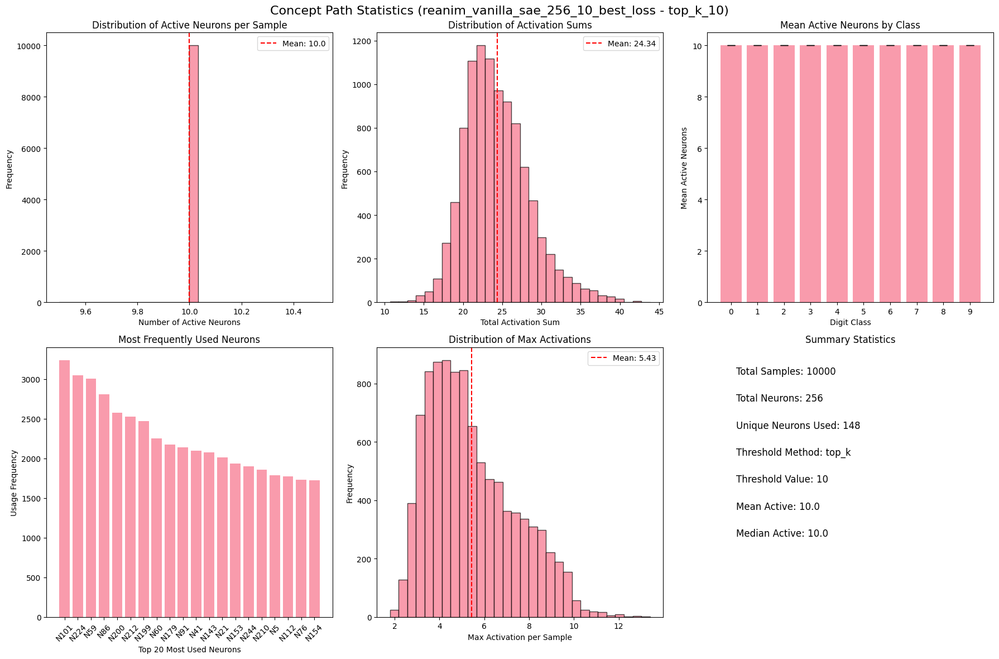

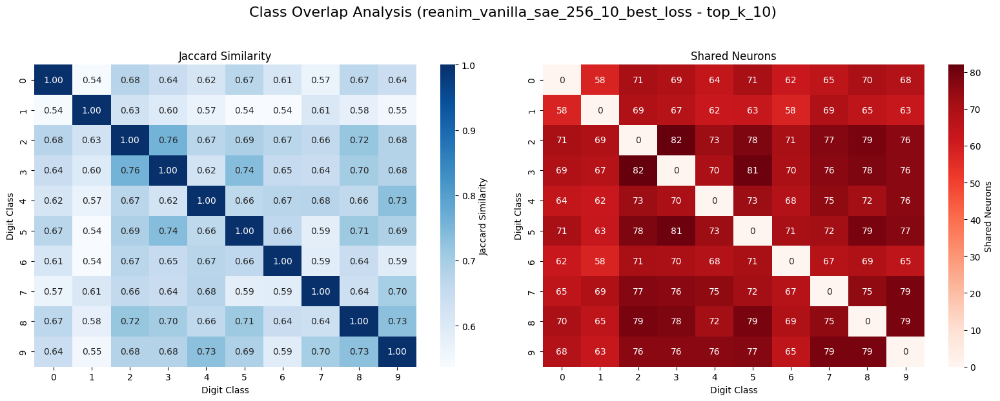

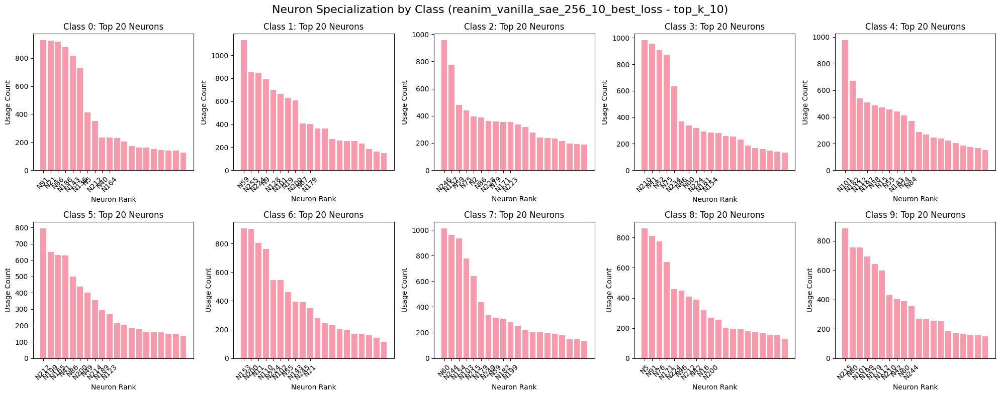


--- Analyzing config: top_k_20 ---


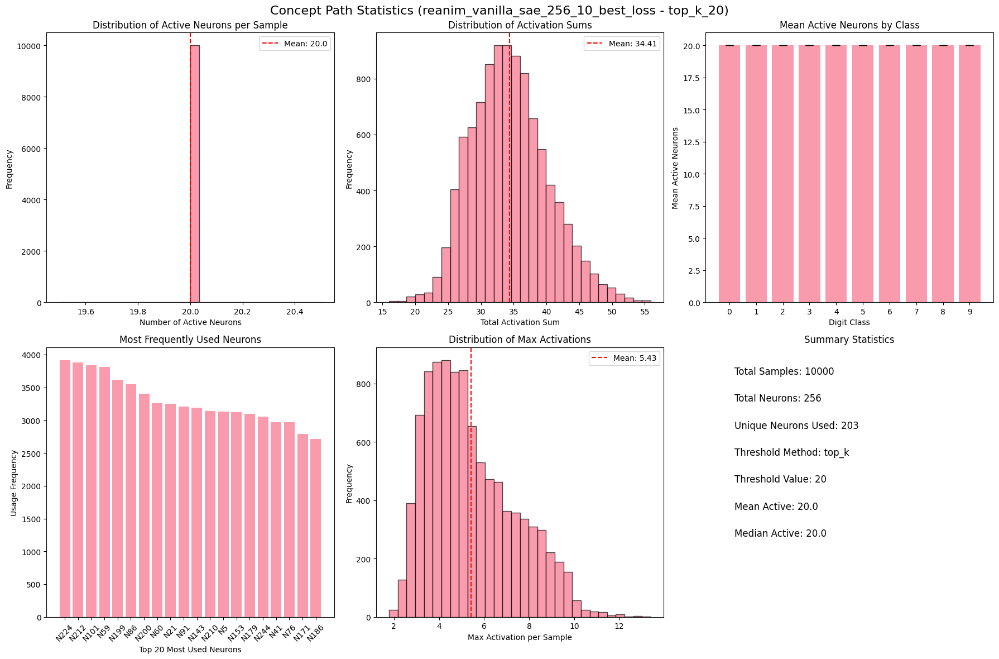

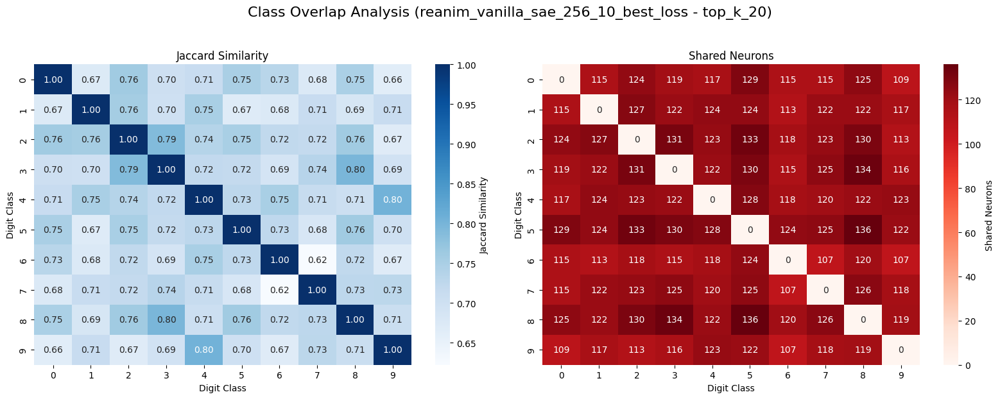

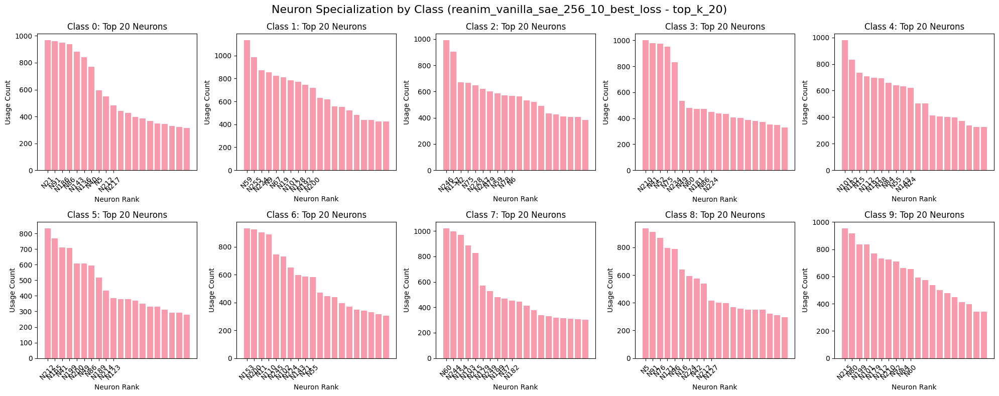


--- Analyzing config: percentile_90 ---


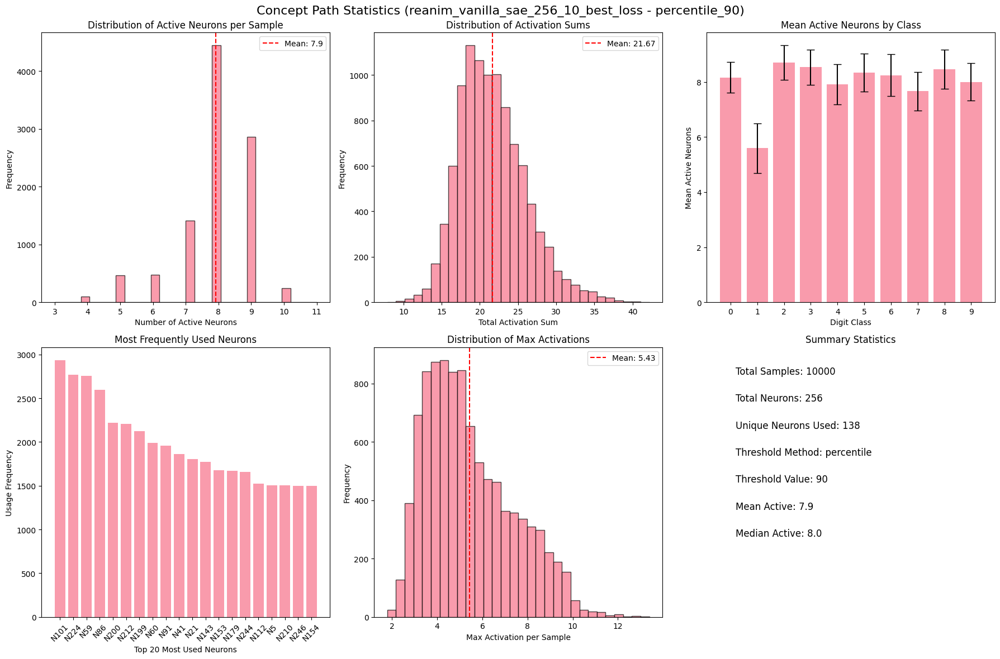

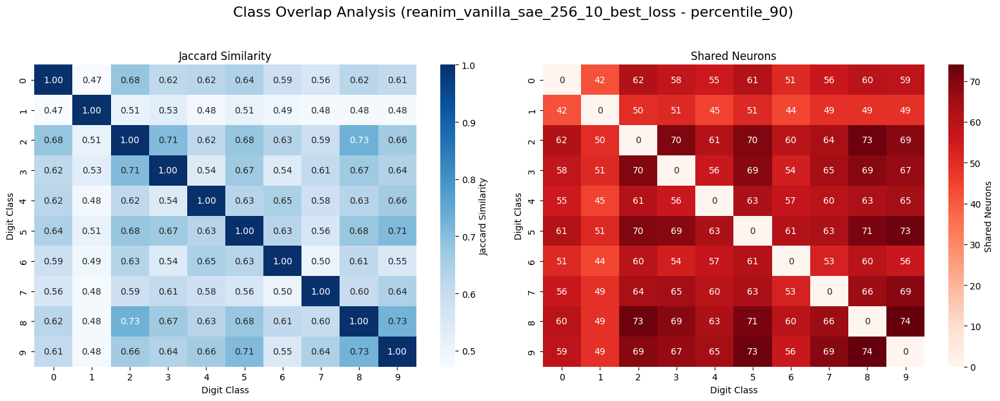

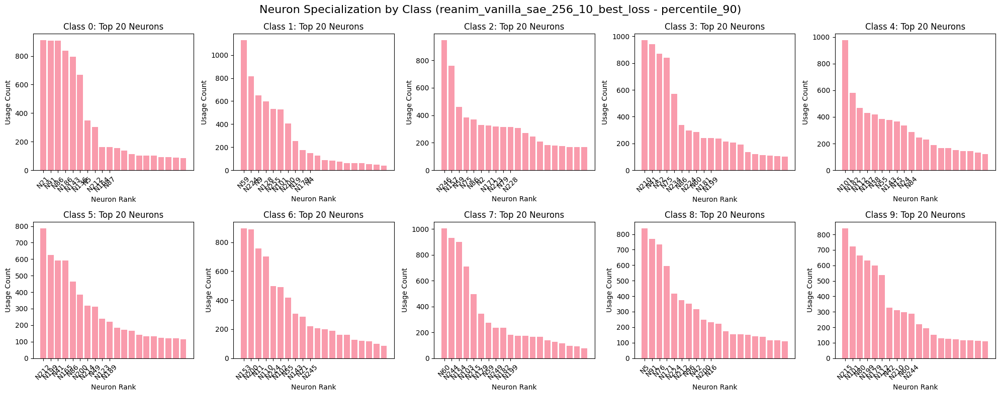


--- Analyzing config: std_threshold_1.5 ---


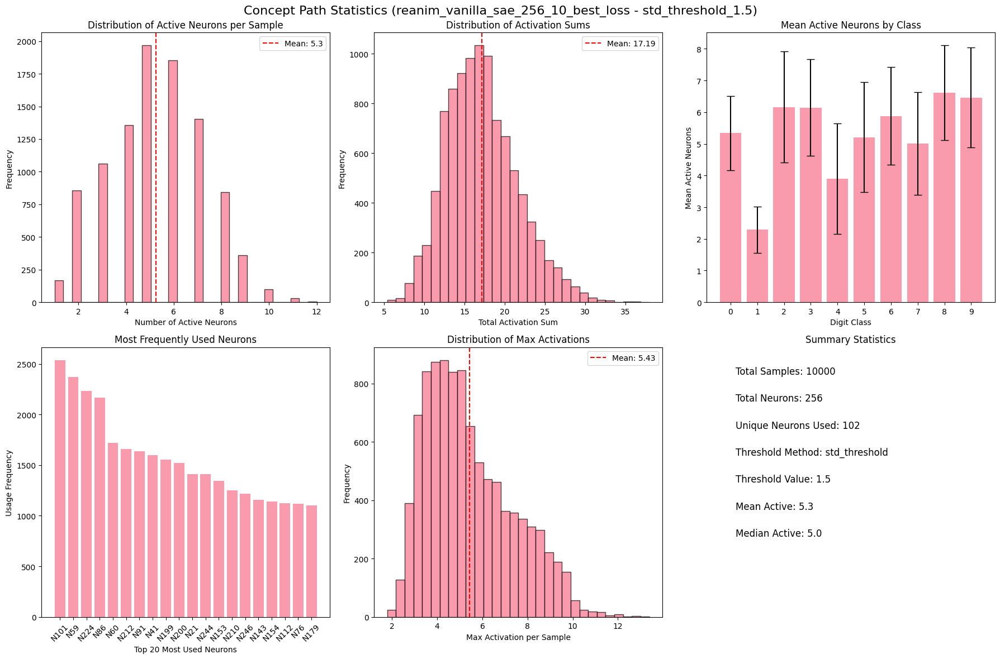

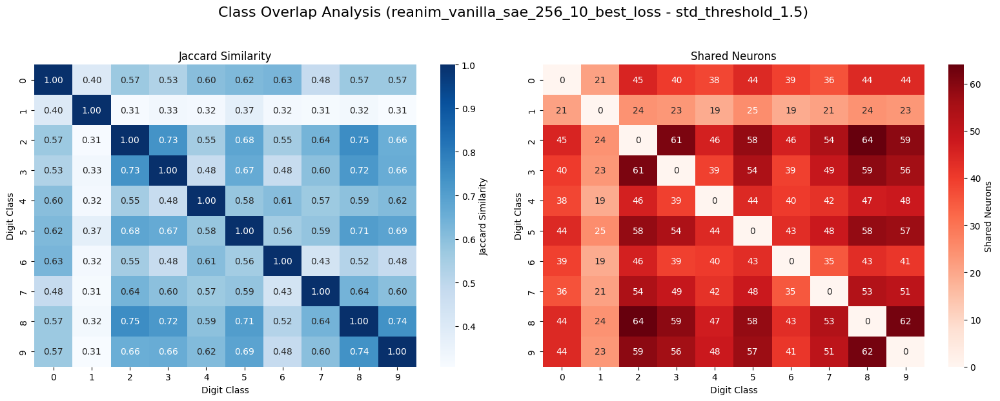

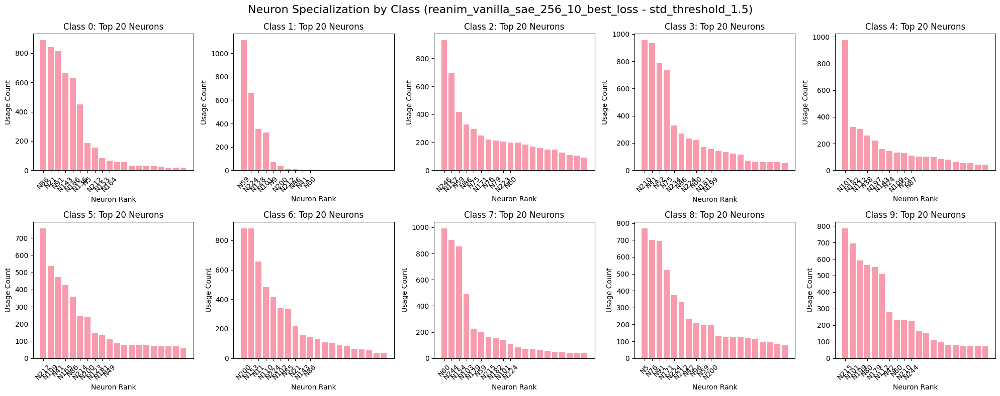


--- Comparing extraction methods for reanim_vanilla_sae_256_10_best_loss ---


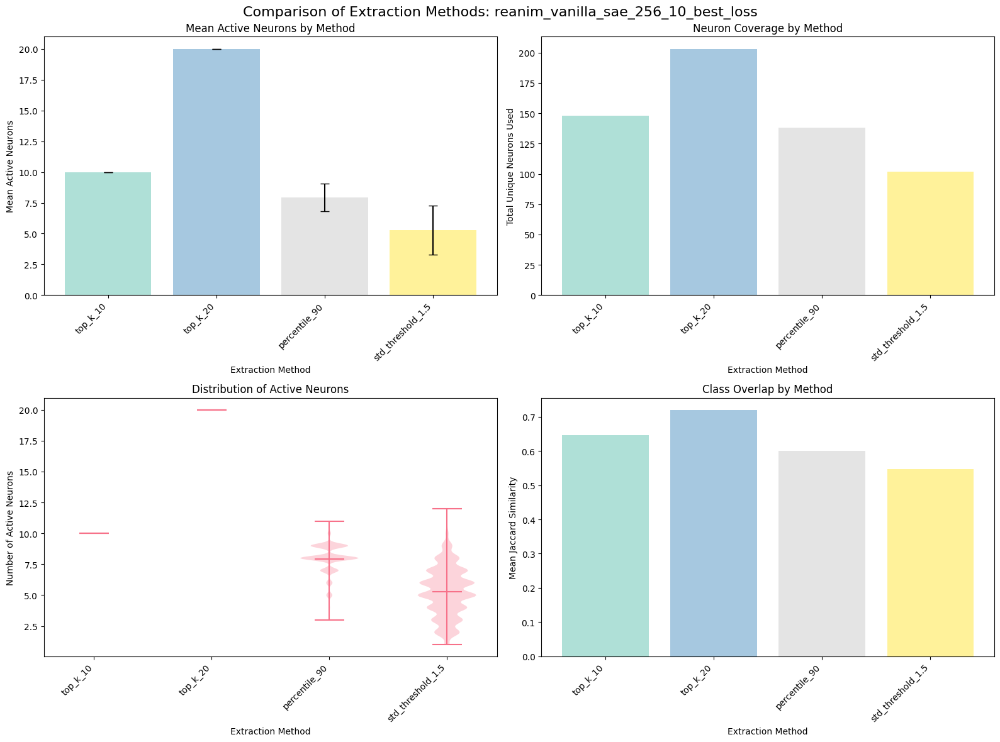


--- Summary across all SAEs (parsing parameters) ---

--- Parsed Summary DataFrame Head ---
                                   SAE    Config Training_Type  Dict_Size  \
12  reanim_vanilla_sae_256_0_best_loss  top_k_10        reanim        256   
11  reanim_vanilla_sae_256_1_best_loss  top_k_10        reanim        256   
39  reanim_vanilla_sae_256_2_best_loss  top_k_10        reanim        256   
95  reanim_vanilla_sae_256_3_best_loss  top_k_10        reanim        256   
94  reanim_vanilla_sae_256_4_best_loss  top_k_10        reanim        256   

    Penalty  Mean_Active  Unique_Neurons  Total_Neurons  Coverage  \
12        0         10.0             165            256  0.644531   
11        1         10.0             168            256  0.656250   
39        2         10.0             161            256  0.628906   
95        3         10.0             158            256  0.617188   
94        4         10.0             167            256  0.652344   

    Mean_Shared_Neurons  Mean

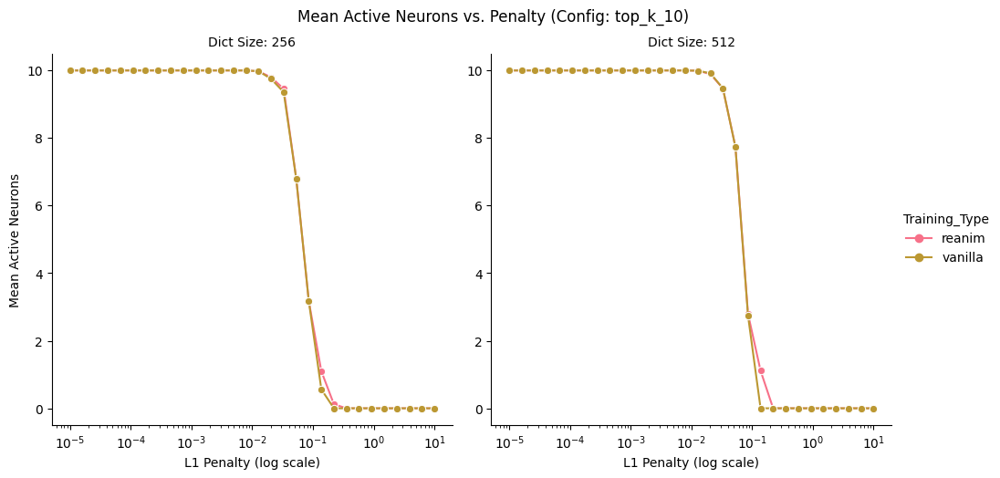


Plotting Neuron Coverage vs. Penalty...


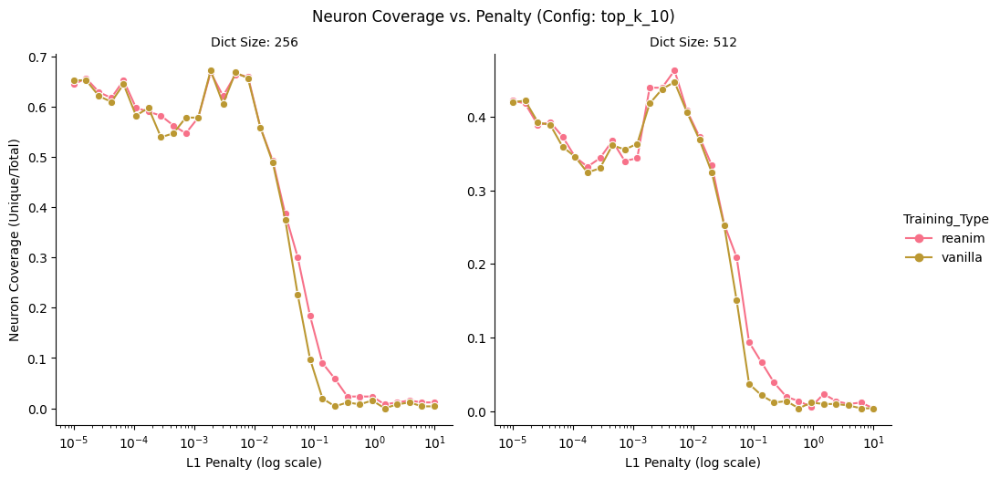


Plotting Mean Shared Neurons vs. Penalty...


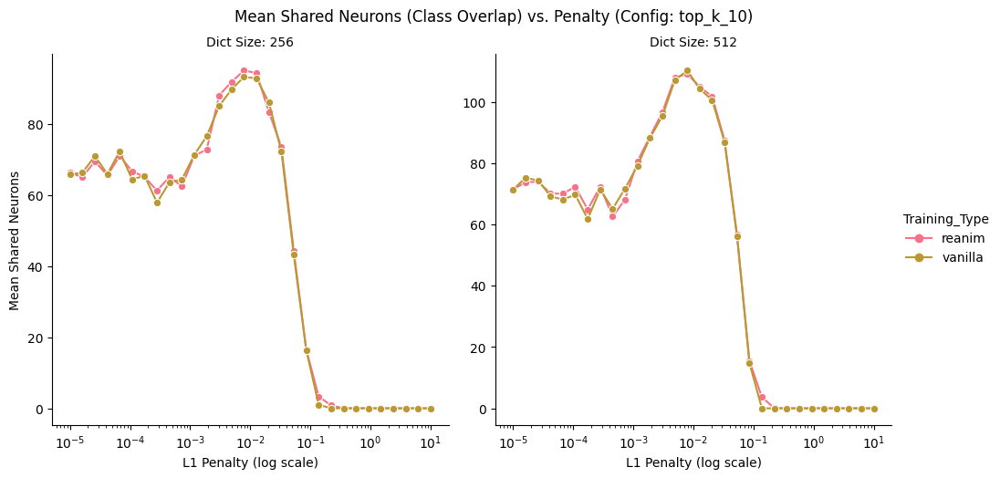


--- Class Overlap Heatmap Evolution vs. Penalty ---
Generating heatmaps for: Training=vanilla, Dict Size=512, Config=top_k_10
Found 30 SAEs. Plotting heatmaps...

Plotting for: vanilla_sae_512_0_best_loss (Penalty Index: 0, L1: 1e-05)


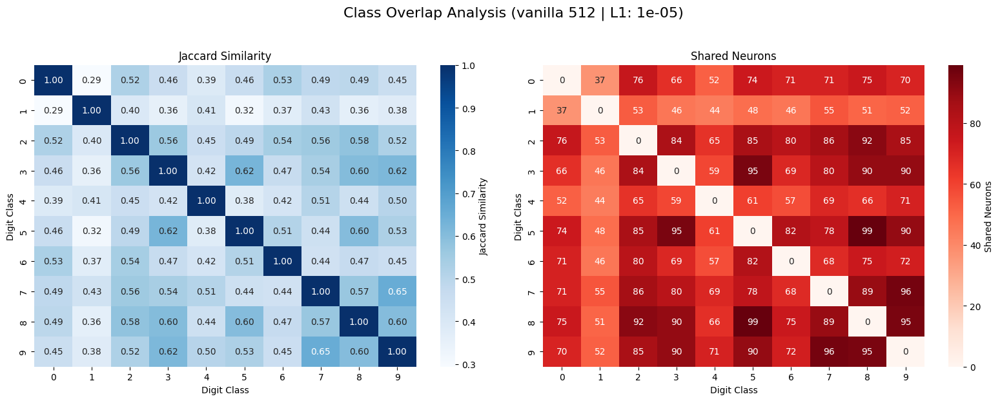


Plotting for: vanilla_sae_512_1_best_loss (Penalty Index: 1, L1: 1.6e-05)


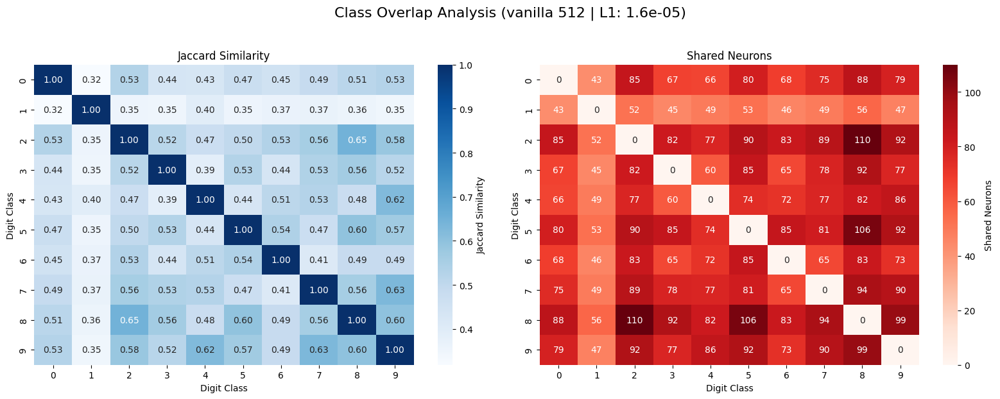


Plotting for: vanilla_sae_512_2_best_loss (Penalty Index: 2, L1: 2.6e-05)


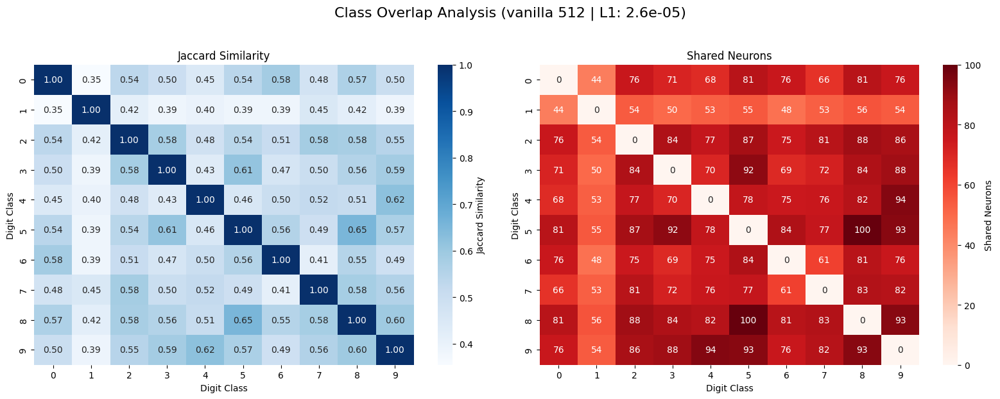


Plotting for: vanilla_sae_512_3_best_loss (Penalty Index: 3, L1: 4.2e-05)


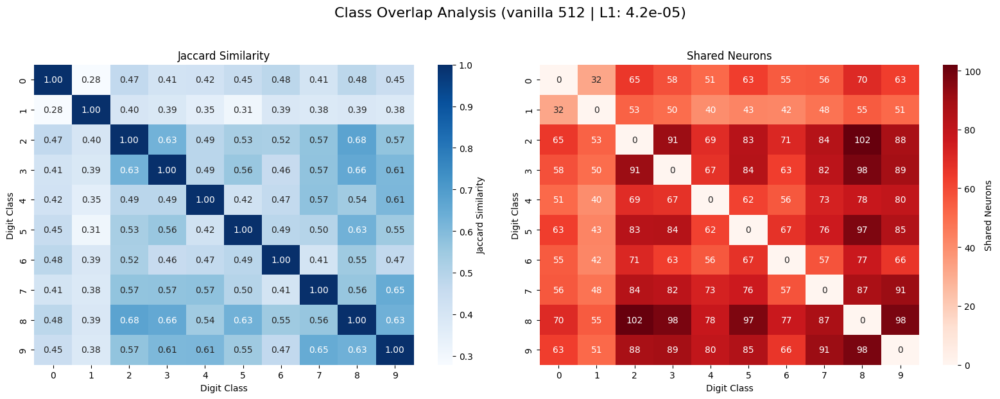


Plotting for: vanilla_sae_512_4_best_loss (Penalty Index: 4, L1: 6.7e-05)


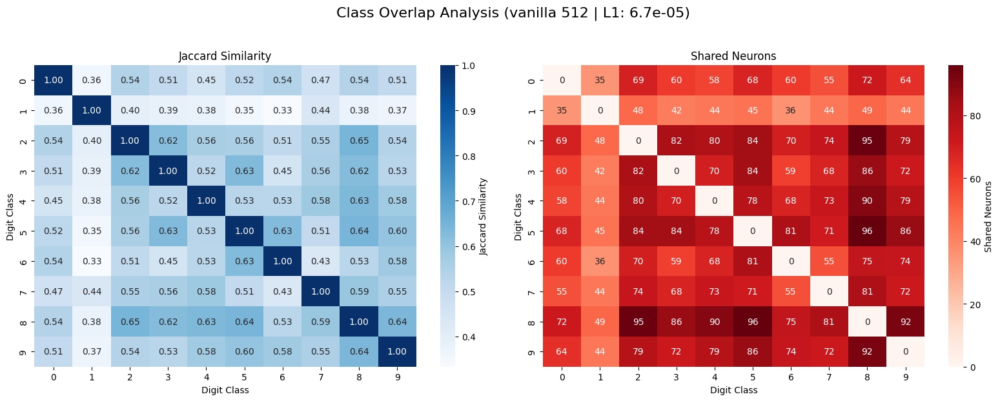


Plotting for: vanilla_sae_512_5_best_loss (Penalty Index: 5, L1: 0.000108)


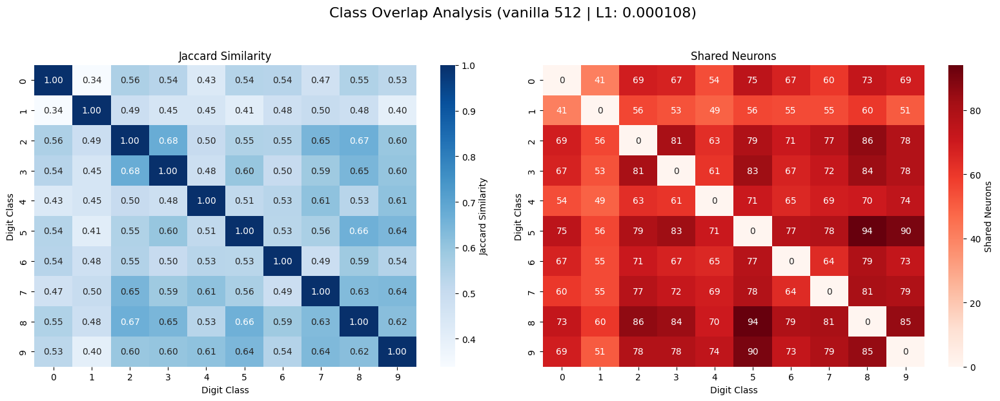


Plotting for: vanilla_sae_512_6_best_loss (Penalty Index: 6, L1: 0.000174)


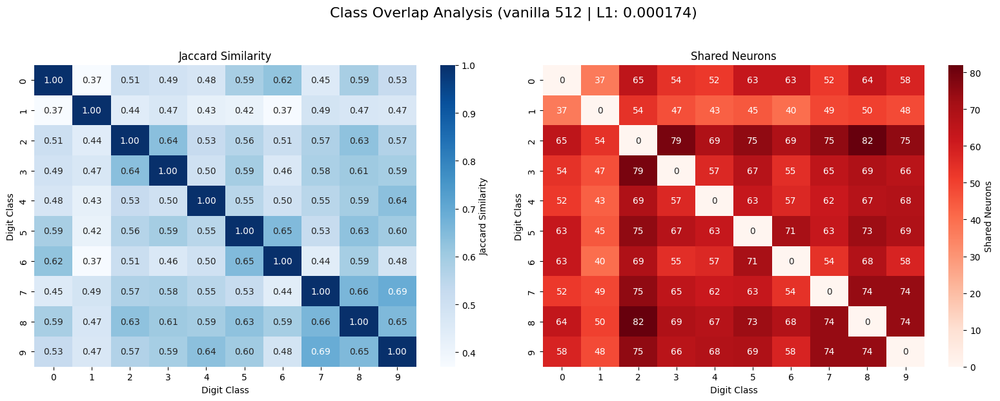


Plotting for: vanilla_sae_512_7_best_loss (Penalty Index: 7, L1: 0.000281)


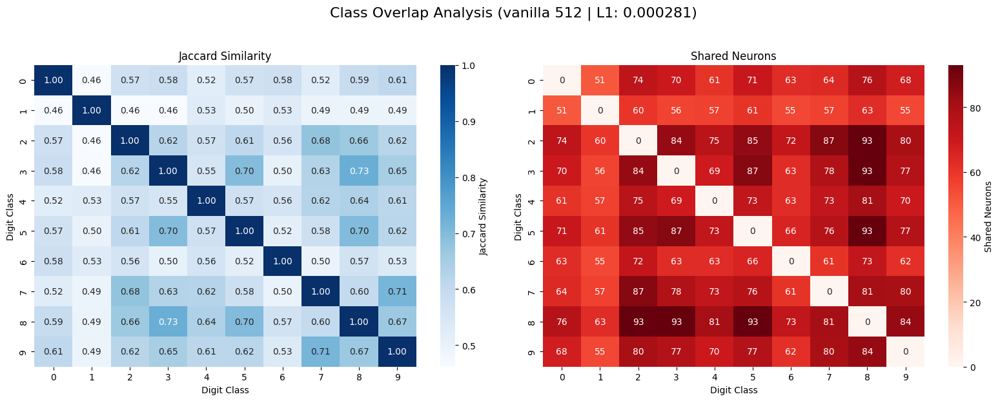


Plotting for: vanilla_sae_512_8_best_loss (Penalty Index: 8, L1: 0.000452)


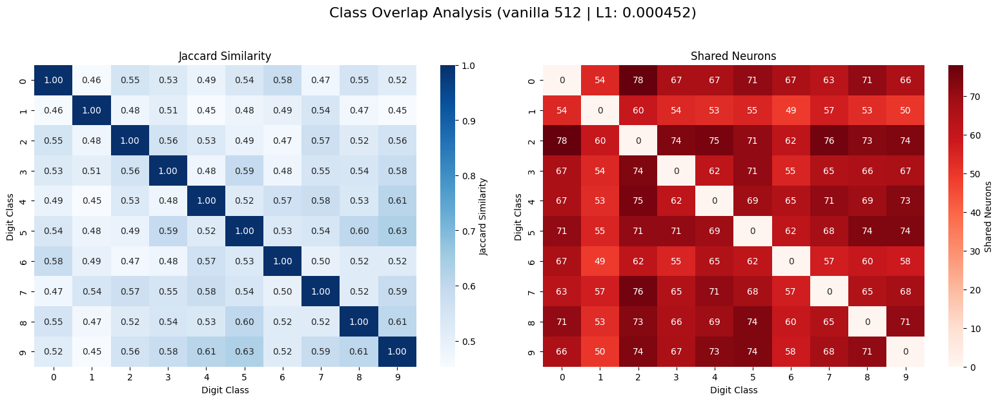


Plotting for: vanilla_sae_512_9_best_loss (Penalty Index: 9, L1: 0.000728)


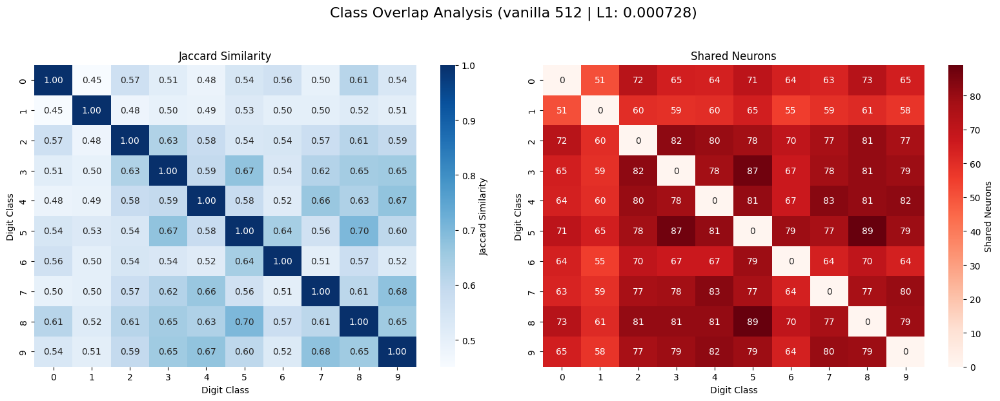


Plotting for: vanilla_sae_512_10_best_loss (Penalty Index: 10, L1: 0.001172)


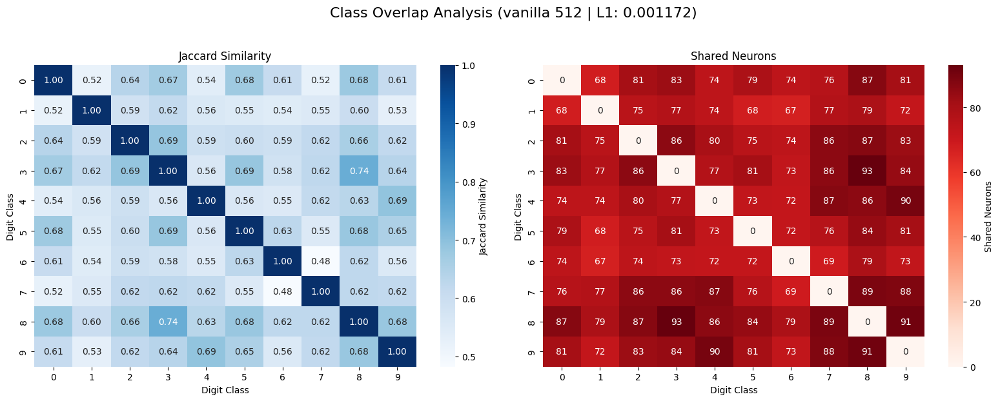


Plotting for: vanilla_sae_512_11_best_loss (Penalty Index: 11, L1: 0.001887)


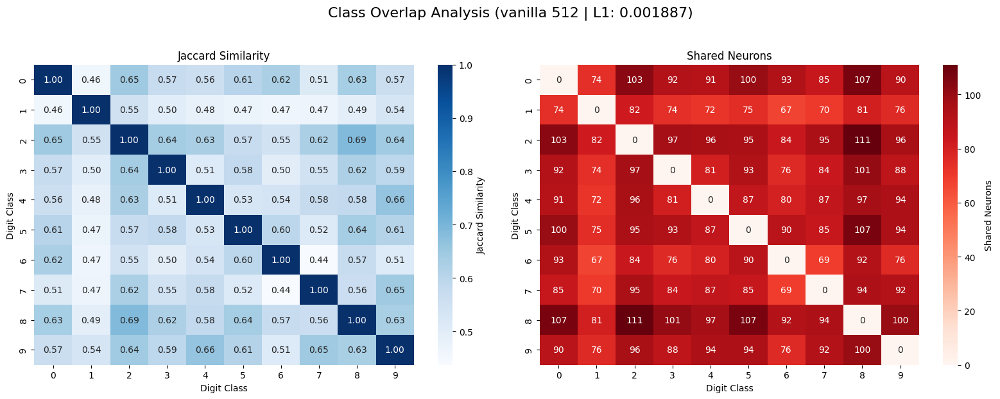


Plotting for: vanilla_sae_512_12_best_loss (Penalty Index: 12, L1: 0.003039)


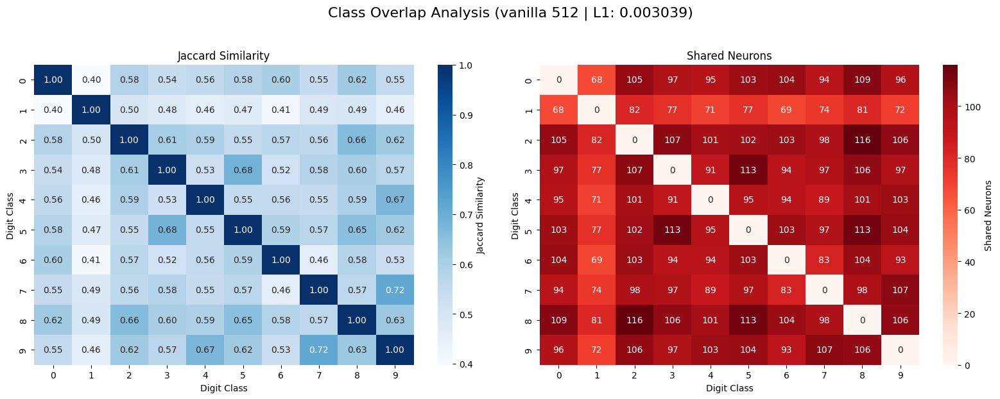


Plotting for: vanilla_sae_512_13_best_loss (Penalty Index: 13, L1: 0.004894)


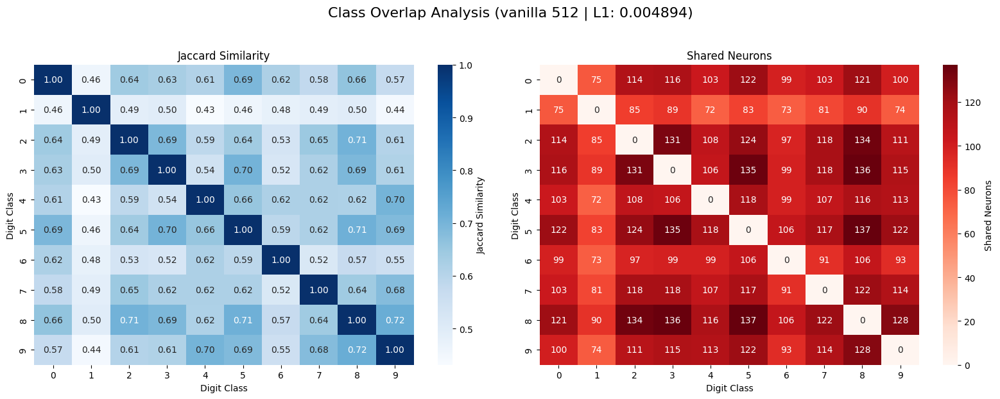


Plotting for: vanilla_sae_512_14_best_loss (Penalty Index: 14, L1: 0.00788)


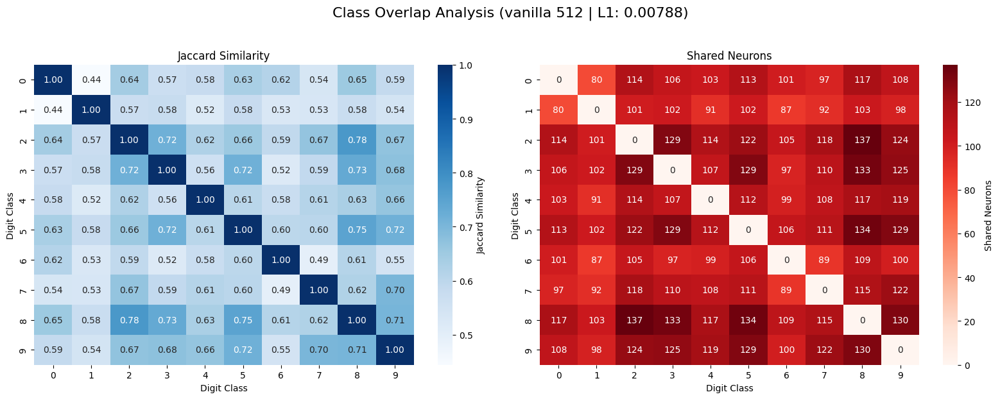


Plotting for: vanilla_sae_512_15_best_loss (Penalty Index: 15, L1: 0.01269)


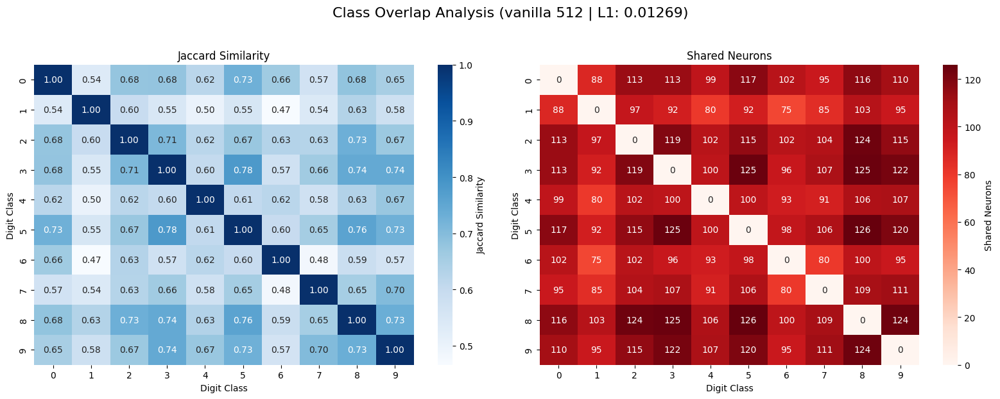


Plotting for: vanilla_sae_512_16_best_loss (Penalty Index: 16, L1: 0.020434)


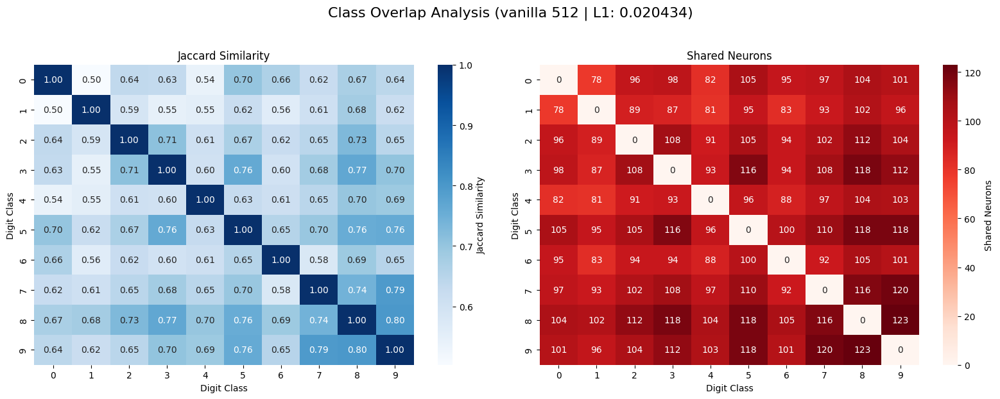


Plotting for: vanilla_sae_512_17_best_loss (Penalty Index: 17, L1: 0.032903)


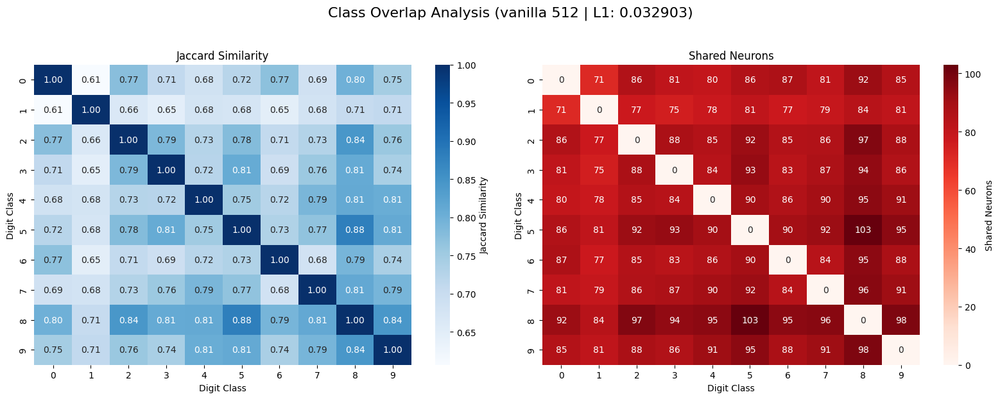


Plotting for: vanilla_sae_512_18_best_loss (Penalty Index: 18, L1: 0.052983)


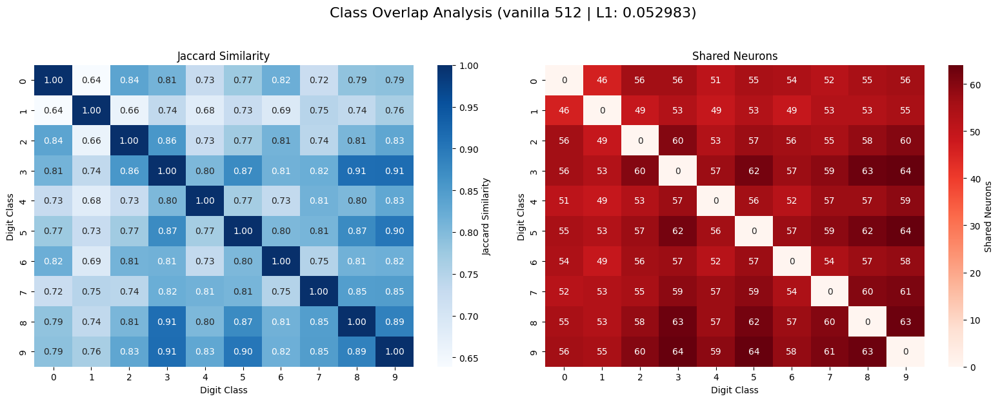


Plotting for: vanilla_sae_512_19_best_loss (Penalty Index: 19, L1: 0.085317)


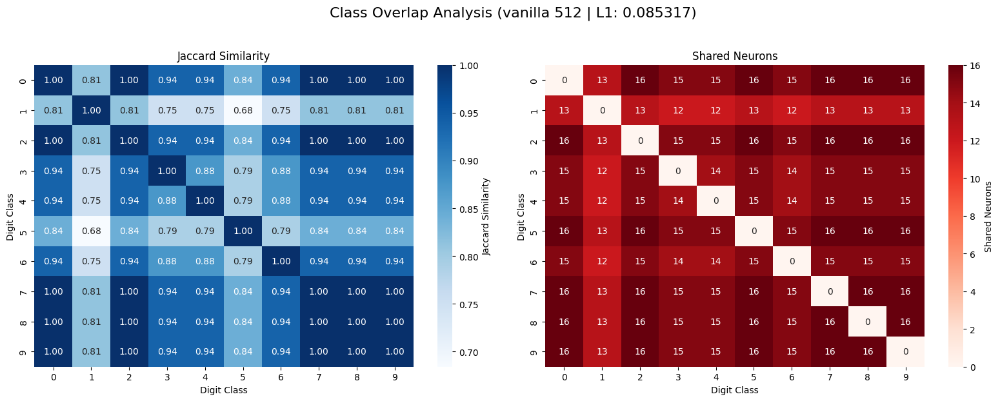


Plotting for: vanilla_sae_512_20_best_loss (Penalty Index: 20, L1: 0.137382)


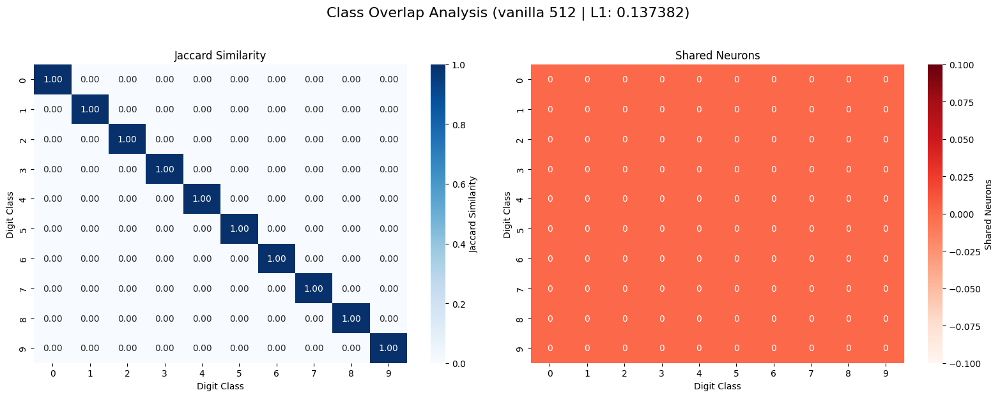


Plotting for: vanilla_sae_512_21_best_loss (Penalty Index: 21, L1: 0.221222)


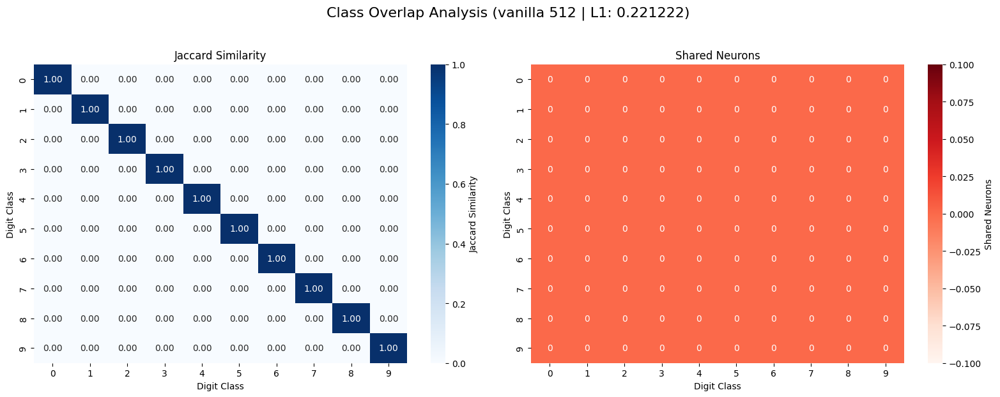


Plotting for: vanilla_sae_512_22_best_loss (Penalty Index: 22, L1: 0.356225)


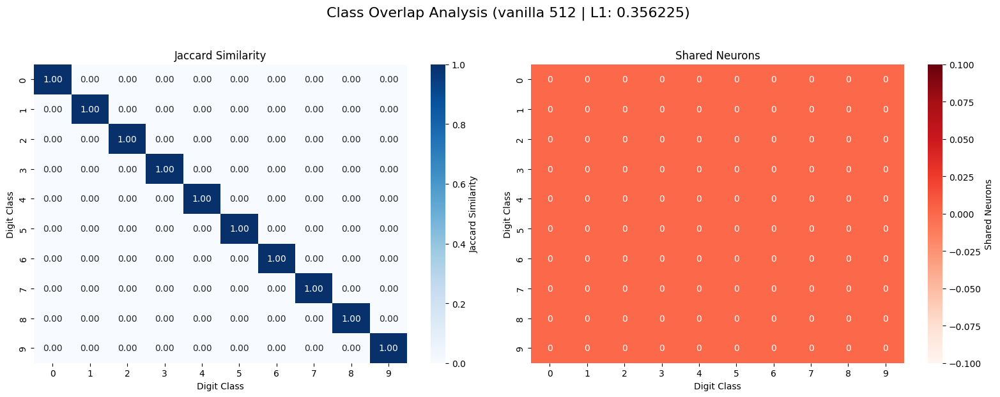


Plotting for: vanilla_sae_512_23_best_loss (Penalty Index: 23, L1: 0.573615)


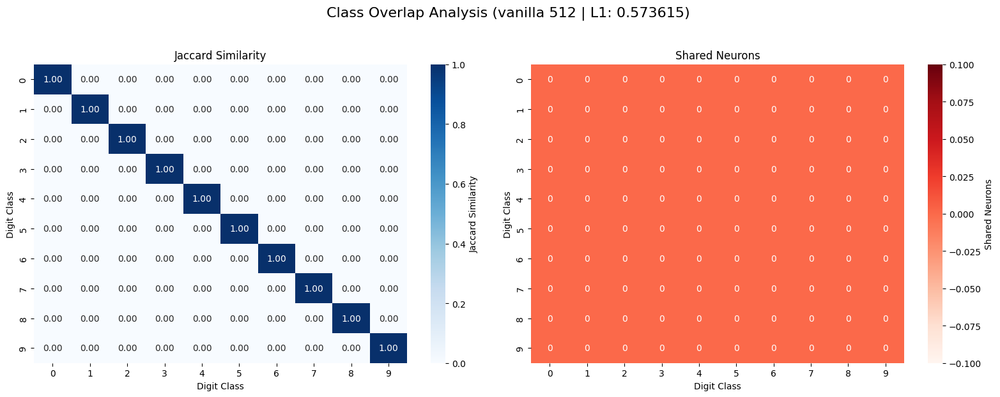


Plotting for: vanilla_sae_512_24_best_loss (Penalty Index: 24, L1: 0.923671)


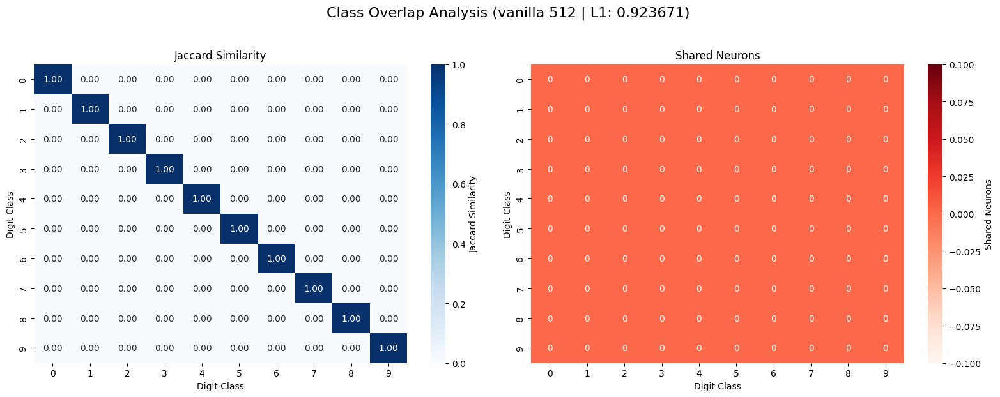


Plotting for: vanilla_sae_512_25_best_loss (Penalty Index: 25, L1: 1.487352)


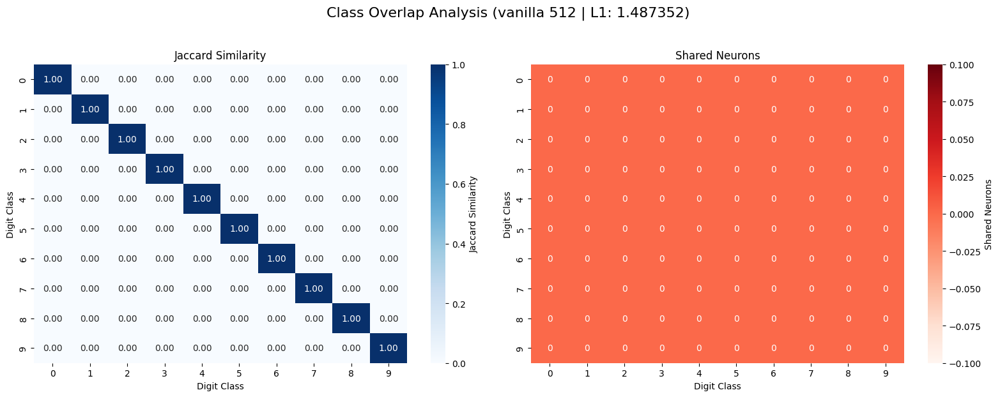


Plotting for: vanilla_sae_512_26_best_loss (Penalty Index: 26, L1: 2.395027)


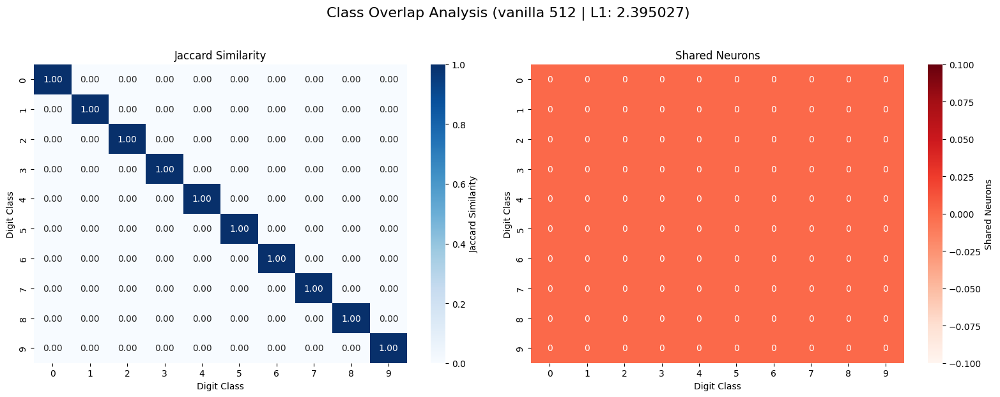


Plotting for: vanilla_sae_512_27_best_loss (Penalty Index: 27, L1: 3.85662)


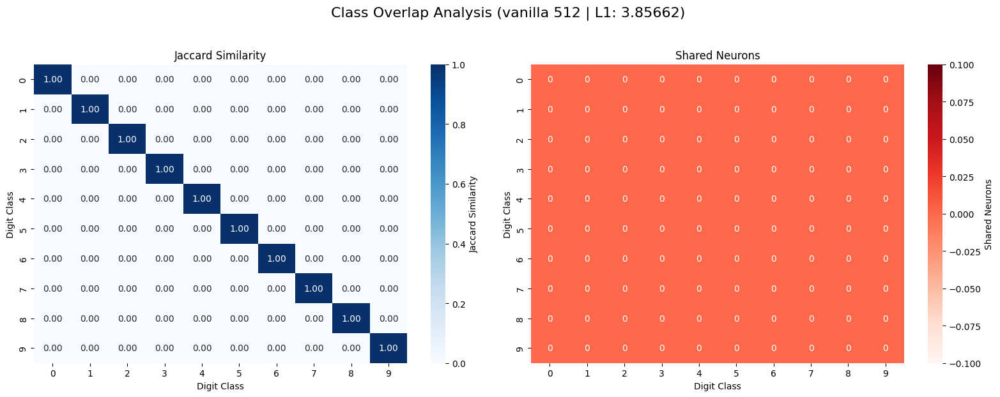


Plotting for: vanilla_sae_512_28_best_loss (Penalty Index: 28, L1: 6.210169)


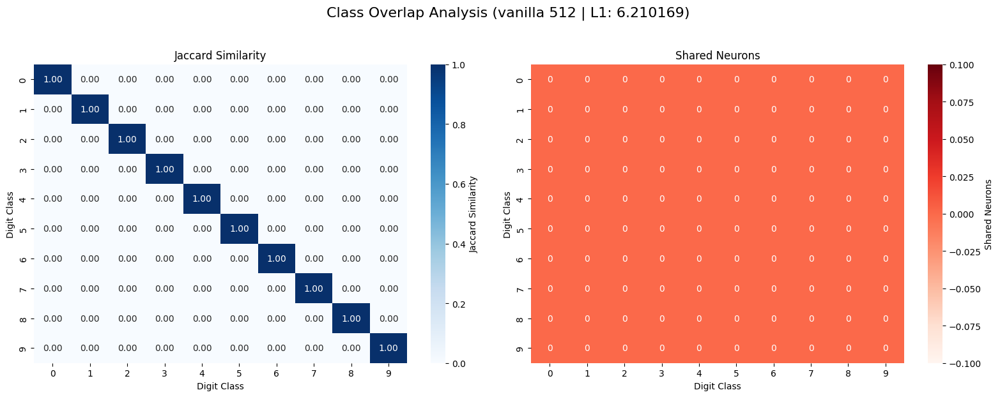


Plotting for: vanilla_sae_512_29_best_loss (Penalty Index: 29, L1: 10.0)


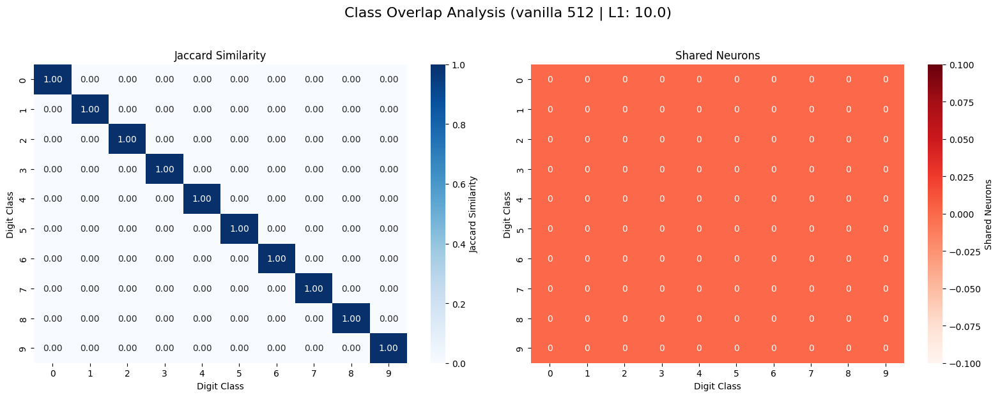


Summary Table (Config: top_k_10):
                                    SAE    Config Training_Type  Dict_Size  \
12   reanim_vanilla_sae_256_0_best_loss  top_k_10        reanim        256   
11   reanim_vanilla_sae_256_1_best_loss  top_k_10        reanim        256   
39   reanim_vanilla_sae_256_2_best_loss  top_k_10        reanim        256   
95   reanim_vanilla_sae_256_3_best_loss  top_k_10        reanim        256   
94   reanim_vanilla_sae_256_4_best_loss  top_k_10        reanim        256   
..                                  ...       ...           ...        ...   
99         vanilla_sae_512_25_best_loss  top_k_10       vanilla        512   
33         vanilla_sae_512_26_best_loss  top_k_10       vanilla        512   
1          vanilla_sae_512_27_best_loss  top_k_10       vanilla        512   
112        vanilla_sae_512_28_best_loss  top_k_10       vanilla        512   
10         vanilla_sae_512_29_best_loss  top_k_10       vanilla        512   

     Penalty  Mean_Active  U

In [15]:
# ===== CONCEPT PATHS VISUALIZATION =====
# Run this cell to visualize concept paths from your SAE analysis

import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import defaultdict, Counter
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import networkx as nx

# Set plotting style
plt.style.use('default')
sns.set_palette("husl")

concept_paths_file = '../logs/mnist_activation/Seed1/vanilla_sae/concept_path_results.pkl'


try:
    with open(concept_paths_file, 'rb') as f:
        all_concept_paths = pickle.load(f)
    print(f"Loaded concept paths for {len(all_concept_paths)} SAEs")
    
    # Display available SAEs and configs
    for sae_name, configs in all_concept_paths.items():
        print(f"\n{sae_name}: {list(configs.keys())}")
        
except FileNotFoundError:
    print(f"File not found: {concept_paths_file}")
    print("Please update the concept_paths_file path above")
    # Create dummy data for demonstration
    all_concept_paths = {}

# ===== HELPER FUNCTIONS =====

def plot_concept_path_statistics(concept_paths_data, title_suffix=""):
    """Plot basic statistics about concept paths."""
    
    concept_paths = concept_paths_data['concept_paths']
    summary = concept_paths_data['summary']
    
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    fig.suptitle(f'Concept Path Statistics {title_suffix}', fontsize=16)
    
    num_active = [path['num_active'] for path in concept_paths]
    axes[0, 0].hist(num_active, bins=30, alpha=0.7, edgecolor='black')
    axes[0, 0].axvline(np.mean(num_active), color='red', linestyle='--', 
                       label=f'Mean: {np.mean(num_active):.1f}')
    axes[0, 0].set_xlabel('Number of Active Neurons')
    axes[0, 0].set_ylabel('Frequency')
    axes[0, 0].set_title('Distribution of Active Neurons per Sample')
    axes[0, 0].legend()
    
    # 2. Distribution of activation sums
    activation_sums = [path['activation_sum'] for path in concept_paths]
    axes[0, 1].hist(activation_sums, bins=30, alpha=0.7, edgecolor='black')
    axes[0, 1].axvline(np.mean(activation_sums), color='red', linestyle='--',
                       label=f'Mean: {np.mean(activation_sums):.2f}')
    axes[0, 1].set_xlabel('Total Activation Sum')
    axes[0, 1].set_ylabel('Frequency')
    axes[0, 1].set_title('Distribution of Activation Sums')
    axes[0, 1].legend()
    
    # 3. Per-class statistics (if labels available)
    if 'class_statistics' in summary:
        class_stats = summary['class_statistics']
        classes = sorted(class_stats.keys())
        
        class_means = [class_stats[c]['mean_active_neurons'] for c in classes]
        class_stds = [class_stats[c]['std_active_neurons'] for c in classes]
        
        axes[0, 2].bar(classes, class_means, yerr=class_stds, capsize=5, alpha=0.7)
        axes[0, 2].set_xlabel('Digit Class')
        axes[0, 2].set_ylabel('Mean Active Neurons')
        axes[0, 2].set_title('Mean Active Neurons by Class')
        axes[0, 2].set_xticks(classes)
    
    # 4. Neuron usage frequency
    all_neurons = []
    for path in concept_paths:
        all_neurons.extend(path['active_neurons'])
    
    neuron_counts = Counter(all_neurons)
    top_neurons = dict(sorted(neuron_counts.items(), key=lambda x: x[1], reverse=True)[:20])
    
    axes[1, 0].bar(range(len(top_neurons)), list(top_neurons.values()), alpha=0.7)
    axes[1, 0].set_xlabel('Top 20 Most Used Neurons')
    axes[1, 0].set_ylabel('Usage Frequency')
    axes[1, 0].set_title('Most Frequently Used Neurons')
    axes[1, 0].set_xticks(range(len(top_neurons)))
    axes[1, 0].set_xticklabels([f'N{k}' for k in top_neurons.keys()], rotation=45)
    
    # 5. Max activation distribution
    max_activations = [path['max_activation'] for path in concept_paths]
    axes[1, 1].hist(max_activations, bins=30, alpha=0.7, edgecolor='black')
    axes[1, 1].axvline(np.mean(max_activations), color='red', linestyle='--',
                       label=f'Mean: {np.mean(max_activations):.2f}')
    axes[1, 1].set_xlabel('Max Activation per Sample')
    axes[1, 1].set_ylabel('Frequency')
    axes[1, 1].set_title('Distribution of Max Activations')
    axes[1, 1].legend()
    
    # 6. Summary text
    axes[1, 2].text(0.1, 0.9, f"Total Samples: {summary['n_samples']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.8, f"Total Neurons: {summary['n_neurons']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.7, f"Unique Neurons Used: {summary['total_unique_neurons_used']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.6, f"Threshold Method: {summary['threshold_method']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.5, f"Threshold Value: {summary['threshold_value']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.4, f"Mean Active: {summary['mean_active_neurons']:.1f}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.3, f"Median Active: {summary['median_active_neurons']:.1f}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].set_xlim(0, 1)
    axes[1, 2].set_ylim(0, 1)
    axes[1, 2].set_title('Summary Statistics')
    axes[1, 2].axis('off')
    
    plt.tight_layout()
    plt.show()

def plot_class_overlap_heatmap(concept_paths_data, title_suffix=""):
    """Plot heatmap of class overlaps."""
    
    if 'overlap_analysis' not in concept_paths_data:
        print(f"No overlap analysis found in concept paths data for {title_suffix}")
        return
    
    overlap_data = concept_paths_data['overlap_analysis'].get('overlap_analysis')
    if not overlap_data:
        print(f"No 'overlap_analysis' sub-key found for {title_suffix}")
        return
    
    # Extract classes from overlap keys
    classes = set()
    for key in overlap_data.keys():
        parts = key.split('_')
        try:
            classes.add(int(parts[1]))
            classes.add(int(parts[3]))
        except (IndexError, ValueError):
            print(f"Warning: Could not parse class from overlap key: {key}")
            continue
    classes = sorted(classes)
    if not classes:
        print("Warning: No valid classes found for overlap heatmap.")
        return

    # Create matrices for different overlap metrics
    jaccard_matrix = np.zeros((len(classes), len(classes)))
    shared_neurons_matrix = np.zeros((len(classes), len(classes)))
    
    for key, data in overlap_data.items():
        parts = key.split('_')
        try:
            i, j = int(parts[1]), int(parts[3])
            i_idx, j_idx = classes.index(i), classes.index(j)
            
            jaccard_matrix[i_idx, j_idx] = data['jaccard_similarity']
            jaccard_matrix[j_idx, i_idx] = data['jaccard_similarity']  # Symmetric
            
            shared_neurons_matrix[i_idx, j_idx] = data['shared_neurons']
            shared_neurons_matrix[j_idx, i_idx] = data['shared_neurons']
        except (IndexError, ValueError, KeyError):
            continue # Skip if key is malformed or data is missing
    
    # Set diagonal to 1 for Jaccard (self-similarity)
    np.fill_diagonal(jaccard_matrix, 1.0)
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))
    fig.suptitle(f'Class Overlap Analysis {title_suffix}', fontsize=16, y=1.03)
    
    # Jaccard similarity heatmap
    sns.heatmap(jaccard_matrix, 
                xticklabels=classes, yticklabels=classes,
                annot=True, fmt='.2f', cmap='Blues',
                ax=ax1, cbar_kws={'label': 'Jaccard Similarity'})
    ax1.set_title(f'Jaccard Similarity')
    ax1.set_xlabel('Digit Class')
    ax1.set_ylabel('Digit Class')
    
    # Shared neurons heatmap
    sns.heatmap(shared_neurons_matrix,
                xticklabels=classes, yticklabels=classes,
                annot=True, fmt='.0f', cmap='Reds',
                ax=ax2, cbar_kws={'label': 'Shared Neurons'})
    ax2.set_title(f'Shared Neurons')
    ax2.set_xlabel('Digit Class')
    ax2.set_ylabel('Digit Class')
    
    plt.tight_layout()
    plt.show()

def plot_neuron_class_specialization(concept_paths_data, top_n=20, title_suffix=""):
    """Plot which neurons are most specialized for each class."""
    
    concept_paths = concept_paths_data['concept_paths']
    summary = concept_paths_data['summary']
    
    if 'class_statistics' not in summary:
        print("No class statistics available")
        return
    
    # Count neuron usage per class
    class_neuron_usage = defaultdict(lambda: defaultdict(int))
    
    for path in concept_paths:
        if 'label' in path:
            label = path['label']
            for neuron_idx in path['active_neurons']:
                class_neuron_usage[label][neuron_idx] += 1
    
    # Find most specialized neurons for each class
    classes = sorted(class_neuron_usage.keys())
    n_classes = len(classes)
    
    # Adjust subplot grid if there are fewer than 10 classes (e.g., MNIST)
    n_cols = 5
    n_rows = int(np.ceil(n_classes / n_cols))
    if n_rows == 0: n_rows = 1
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 4 * n_rows))
    axes = axes.flatten()
    
    for i, class_label in enumerate(classes):
        if i >= len(axes):
            break
            
        neuron_counts = class_neuron_usage[class_label]
        
        # Get top neurons for this class
        top_neurons = sorted(neuron_counts.items(), key=lambda x: x[1], reverse=True)[:top_n]
        
        if not top_neurons:
            axes[i].text(0.5, 0.5, 'No active neurons', ha='center', va='center', transform=axes[i].transAxes)
            axes[i].set_title(f'Class {class_label}: Top {top_n} Neurons')
            continue
            
        neurons, counts = zip(*top_neurons)
        
        axes[i].bar(range(len(neurons)), counts, alpha=0.7)
        axes[i].set_title(f'Class {class_label}: Top {top_n} Neurons')
        axes[i].set_xlabel('Neuron Rank')
        axes[i].set_ylabel('Usage Count')
        axes[i].set_xticks(range(min(10, len(neurons))))
        axes[i].set_xticklabels([f'N{n}' for n in neurons[:10]], rotation=45)
    
    # Hide unused subplots
    for j in range(i + 1, len(axes)):
        axes[j].set_visible(False)
    
    fig.suptitle(f'Neuron Specialization by Class {title_suffix}', fontsize=16)
    plt.tight_layout()
    plt.show()

def compare_extraction_methods(sae_concept_paths, sae_name):
    """Compare different concept path extraction methods for the same SAE."""
    
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    fig.suptitle(f'Comparison of Extraction Methods: {sae_name}', fontsize=16)
    
    methods = list(sae_concept_paths.keys())
    if not methods:
        print("No extraction methods to compare.")
        plt.close(fig)
        return
        
    colors = plt.cm.Set3(np.linspace(0, 1, len(methods)))
    
    # 1. Mean active neurons comparison
    method_names = []
    mean_active = []
    std_active = []
    
    for method in methods:
        data = sae_concept_paths.get(method, {})
        if 'summary' not in data: continue
        summary = data['summary']
        method_names.append(method)
        mean_active.append(summary.get('mean_active_neurons', np.nan))
        std_active.append(summary.get('std_active_neurons', np.nan))
    
    if not method_names:
         print("No valid summary data for method comparison.")
         plt.close(fig)
         return

    bars = axes[0, 0].bar(range(len(method_names)), mean_active, 
                           yerr=std_active, capsize=5, alpha=0.7, color=colors)
    axes[0, 0].set_xlabel('Extraction Method')
    axes[0, 0].set_ylabel('Mean Active Neurons')
    axes[0, 0].set_title('Mean Active Neurons by Method')
    axes[0, 0].set_xticks(range(len(method_names)))
    axes[0, 0].set_xticklabels(method_names, rotation=45, ha='right')
    
    # 2. Total unique neurons used
    unique_neurons = [sae_concept_paths[method]['summary'].get('total_unique_neurons_used', np.nan)
                       for method in method_names]
    
    axes[0, 1].bar(range(len(method_names)), unique_neurons, alpha=0.7, color=colors)
    axes[0, 1].set_xlabel('Extraction Method')
    axes[0, 1].set_ylabel('Total Unique Neurons Used')
    axes[0, 1].set_title('Neuron Coverage by Method')
    axes[0, 1].set_xticks(range(len(method_names)))
    axes[0, 1].set_xticklabels(method_names, rotation=45, ha='right')
    
    # 3. Distribution of active neurons (violin plot)
    all_num_active = []
    method_labels = []
    
    for method in method_names:
        concept_paths = sae_concept_paths[method].get('concept_paths', [])
        num_active = [path['num_active'] for path in concept_paths]
        all_num_active.extend(num_active)
        method_labels.extend([method] * len(num_active))
    
    if all_num_active:
        # Create dataframe for seaborn
        df = pd.DataFrame({'Method': method_labels, 'Active_Neurons': all_num_active})
        
        # Use matplotlib for violin plot
        method_data = [df[df['Method'] == method]['Active_Neurons'].values for method in method_names]
        
        parts = axes[1, 0].violinplot(method_data, positions=range(len(method_names)), showmeans=True)
        axes[1, 0].set_xlabel('Extraction Method')
        axes[1, 0].set_ylabel('Number of Active Neurons')
        axes[1, 0].set_title('Distribution of Active Neurons')
        axes[1, 0].set_xticks(range(len(method_names)))
        axes[1, 0].set_xticklabels(method_names, rotation=45, ha='right')
    else:
        axes[1, 0].text(0.5, 0.5, 'No activation data available', 
                          ha='center', va='center', transform=axes[1, 0].transAxes)
        axes[1, 0].set_title('Distribution of Active Neurons')

    
    # 4. Mean overlap between classes (if available)
    mean_overlaps = []
    for method in method_names:
        overlap_data = sae_concept_paths[method].get('overlap_analysis', {})
        summary = overlap_data.get('summary', {})
        mean_overlaps.append(summary.get('mean_jaccard', 0))
    
    if any(overlap > 0 for overlap in mean_overlaps):
        axes[1, 1].bar(range(len(method_names)), mean_overlaps, alpha=0.7, color=colors)
        axes[1, 1].set_xlabel('Extraction Method')
        axes[1, 1].set_ylabel('Mean Jaccard Similarity')
        axes[1, 1].set_title('Class Overlap by Method')
        axes[1, 1].set_xticks(range(len(method_names)))
        axes[1, 1].set_xticklabels(method_names, rotation=45, ha='right')
    else:
        axes[1, 1].text(0.5, 0.5, 'No overlap data available', 
                          ha='center', va='center', transform=axes[1, 1].transAxes)
        axes[1, 1].set_title('Class Overlap by Method')
    
    plt.tight_layout()
    plt.show()

# ===== MAIN VISUALIZATION CODE =====

if all_concept_paths:
    print("=== CONCEPT PATHS VISUALIZATION ===\n")
    
    # Select which SAE and config to visualize
    sae_names = list(all_concept_paths.keys())
    print("Available SAEs:")
    for i, name in enumerate(sae_names):
        print(f"{i}: {name}")
    
    # Visualize the first SAE (change index as needed)
    selected_sae_idx = 0
    if sae_names:
        selected_sae = sae_names[selected_sae_idx]
        
        print(f"\nVisualizing: {selected_sae}")
        
        # Get available configs for this SAE
        configs = list(all_concept_paths[selected_sae].keys())
        print(f"Available configs: {configs}")
        
        # Visualize each config
        for config in configs: 
            print(f"\n--- Analyzing config: {config} ---")
            concept_paths_data = all_concept_paths[selected_sae].get(config)
            if not concept_paths_data:
                print(f"No data for config {config}, skipping.")
                continue
            
            # Basic statistics
            plot_concept_path_statistics(concept_paths_data, f"({selected_sae} - {config})")
            
            # Class overlap heatmap
            plot_class_overlap_heatmap(concept_paths_data, f"({selected_sae} - {config})")
            
            # Neuron specialization
            plot_neuron_class_specialization(concept_paths_data, title_suffix=f"({selected_sae} - {config})")
        
        # Compare different extraction methods for the same SAE
        print(f"\n--- Comparing extraction methods for {selected_sae} ---")
        compare_extraction_methods(all_concept_paths[selected_sae], selected_sae)
    else:
        print("No SAEs found in the data.")

    # ===== NEW SUMMARY SECTION =====
    print("\n--- Summary across all SAEs (parsing parameters) ---")
    
    summary_data = []
    config_to_use = 'top_k_10' # Default config to use for comparison
    
    for sae_name, configs in all_concept_paths.items():
        # Try to get a consistent config, e.g., 'top_k_10', fallback to first
        current_config_to_use = None
        if config_to_use in configs:
            current_config_to_use = config_to_use
        elif configs:
            current_config_to_use = list(configs.keys())[0]
            if sae_name == sae_names[0]: # Set config_to_use based on first SAE if default not found
                config_to_use = current_config_to_use
        
        if not current_config_to_use:
            print(f"Warning: No configs found for {sae_name}. Skipping.")
            continue

        if current_config_to_use != config_to_use:
             print(f"Warning: Config '{config_to_use}' not found for {sae_name}. Using '{current_config_to_use}' instead.")
            
        summary = configs[current_config_to_use].get('summary')
        if not summary:
            print(f"Warning: No summary found for {sae_name} config {current_config_to_use}. Skipping.")
            continue
            
        # Get overlap summary if it exists
        overlap_summary = configs[current_config_to_use].get('overlap_analysis', {}).get('summary', {})
        mean_shared_neurons = overlap_summary.get('mean_shared_neurons', np.nan)
        mean_jaccard = overlap_summary.get('mean_jaccard', np.nan)


        # Parse parameters from sae_name
        training_type = None
        dict_size = None
        penalty = None
        parts = sae_name.split('_')

        try:
            if sae_name.startswith('reanim_vanilla_sae_'):
                # e.g., reanim_vanilla_sae_256_10_best_loss
                training_type = 'reanim'
                dict_size = int(parts[3])
                penalty = int(parts[4])
            elif sae_name.startswith('vanilla_sae_'):
                # e.g., vanilla_sae_512_27_best_loss
                training_type = 'vanilla'
                dict_size = int(parts[2])
                penalty = int(parts[3])
            else:
                print(f"Warning: Unrecognized SAE name format: {sae_name}. Skipping.")
                continue
        except (IndexError, ValueError) as e:
            print(f"Warning: Could not parse {sae_name}: {e}. Skipping.")
            continue

        summary_data.append({
            'SAE': sae_name,
            'Config': current_config_to_use,
            'Training_Type': training_type,
            'Dict_Size': dict_size,
            'Penalty': penalty,
            'Mean_Active': summary.get('mean_active_neurons', np.nan),
            'Unique_Neurons': summary.get('total_unique_neurons_used', np.nan),
            'Total_Neurons': summary.get('n_neurons', np.nan),
            'Coverage': (summary.get('total_unique_neurons_used', np.nan) / 
                         summary.get('n_neurons', 1)), # Avoid divide by zero
            'Mean_Shared_Neurons': mean_shared_neurons,
            'Mean_Jaccard': mean_jaccard
        })
    
    if summary_data:
        summary_df = pd.DataFrame(summary_data)
        summary_df = summary_df.dropna(subset=['Training_Type', 'Dict_Size', 'Penalty', 'Mean_Active', 'Coverage'])
        summary_df = summary_df.sort_values(by=['Training_Type', 'Dict_Size', 'Penalty'])
        
        # --- NEW: Map Penalty Index to L1 Logspace Value ---
        l1_pen_map = [round(val, 6) for val in np.logspace(-5, 1, num=30)]
        summary_df['L1_Penalty'] = summary_df['Penalty'].apply(lambda x: l1_pen_map[int(x)] if int(x) < len(l1_pen_map) else np.nan)
        # ---------------------------------------------------
        
        print("\n--- Parsed Summary DataFrame Head ---")
        print(summary_df.head())
        
        # Determine the config name to display in titles
        config_title_name = config_to_use if all(summary_df['Config'] == config_to_use) else "top_k_10 or first available"


        # Plot 1: Mean Active Neurons vs. Penalty
        print("\nPlotting Mean Active Neurons vs. Penalty...")
        g1 = sns.relplot(
            data=summary_df,
            x='L1_Penalty',
            y='Mean_Active',
            hue='Training_Type',
            col='Dict_Size',
            kind='line',
            marker='o',
            facet_kws={'sharey': False}
        )
        g1.fig.suptitle(f'Mean Active Neurons vs. Penalty (Config: {config_title_name})', y=1.03)
        g1.set_axis_labels("L1 Penalty (log scale)", "Mean Active Neurons")
        g1.set(xscale="log")
        g1.set_titles("Dict Size: {col_name}")
        plt.show()

        # Plot 2: Neuron Coverage vs. Penalty
        print("\nPlotting Neuron Coverage vs. Penalty...")
        g2 = sns.relplot(
            data=summary_df,
            x='L1_Penalty',
            y='Coverage',
            hue='Training_Type',
            col='Dict_Size',
            kind='line',
            marker='o',
            facet_kws={'sharey': False}
        )
        g2.fig.suptitle(f'Neuron Coverage vs. Penalty (Config: {config_title_name})', y=1.03)
        g2.set_axis_labels("L1 Penalty (log scale)", "Neuron Coverage (Unique/Total)")
        g2.set(xscale="log")
        g2.set_titles("Dict Size: {col_name}")
        plt.show()
        
        # Plot 3: Mean Shared Neurons vs. Penalty
        if 'Mean_Shared_Neurons' in summary_df.columns and not summary_df['Mean_Shared_Neurons'].isnull().all():
            print("\nPlotting Mean Shared Neurons vs. Penalty...")
            g3 = sns.relplot(
                data=summary_df,
                x='L1_Penalty',
                y='Mean_Shared_Neurons',
                hue='Training_Type',
                col='Dict_Size',
                kind='line',
                marker='o',
                facet_kws={'sharey': False}
            )
            g3.fig.suptitle(f'Mean Shared Neurons (Class Overlap) vs. Penalty (Config: {config_title_name})', y=1.03)
            g3.set_axis_labels("L1 Penalty (log scale)", "Mean Shared Neurons")
            g3.set(xscale="log")
            g3.set_titles("Dict Size: {col_name}")
            plt.show()
        else:
            print("\nSkipping 'Mean Shared Neurons' plot as no data was found.")

        # ===== NEW SECTION: HEATMAP EVOLUTION =====
        print("\n--- Class Overlap Heatmap Evolution vs. Penalty ---")
        
        # --- (You can change these values) ---
        target_training = 'vanilla'
        target_dict_size = 512
        # -----------------------------------

        print(f"Generating heatmaps for: Training={target_training}, Dict Size={target_dict_size}, Config={config_title_name}")

        # Filter the DataFrame
        df_filtered = summary_df[
            (summary_df['Training_Type'] == target_training) &
            (summary_df['Dict_Size'] == target_dict_size)
        ].sort_values('Penalty') # Sort by index is correct

        if df_filtered.empty:
            print("No SAEs found for this configuration.")
        else:
            print(f"Found {len(df_filtered)} SAEs. Plotting heatmaps...")
            
            for index, row in df_filtered.iterrows():
                sae_name = row['SAE']
                penalty_index = row['Penalty'] # Get index
                l1_value = row['L1_Penalty'] # Get mapped value
                target_config = row['Config'] # Get the specific config used for this row
                
                print(f"\nPlotting for: {sae_name} (Penalty Index: {penalty_index}, L1: {l1_value})")
                
                # Get the data for this specific SAE and config
                concept_paths_data = all_concept_paths.get(sae_name, {}).get(target_config)
                
                if not concept_paths_data:
                    print(f"No concept_paths_data found for {sae_name} with config {target_config}. Skipping.")
                    continue
                    
                # Call the existing plotting function
                # This will create a new figure and plt.show() it
                plot_class_overlap_heatmap(
                    concept_paths_data, 
                    title_suffix=f"({target_training} {target_dict_size} | L1: {l1_value})"
                )
        
        print(f"\nSummary Table (Config: {config_title_name}):")
        print(summary_df.round(3))
    else:
        print("No summary data to plot after parsing.")

else:
    print("No concept paths data loaded. Please check the file path and run the cell again.")



Loaded concept paths for 120 SAEs

reanim_vanilla_sae_256_10_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_27_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_21_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_512_6_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_256_19_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_12_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_256_11_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_512_19_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_256_29_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_4_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold

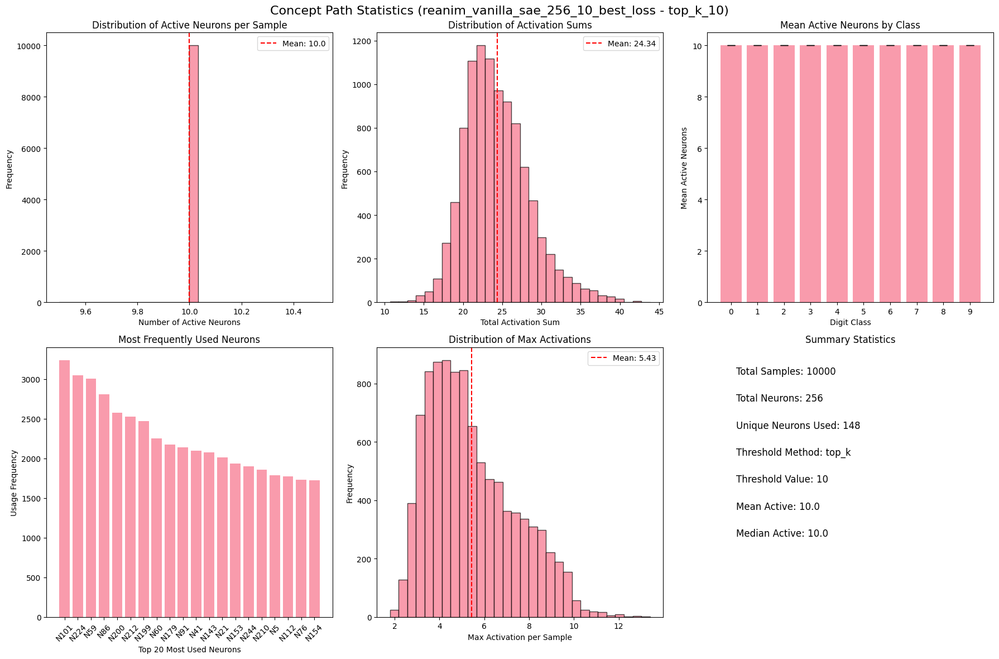

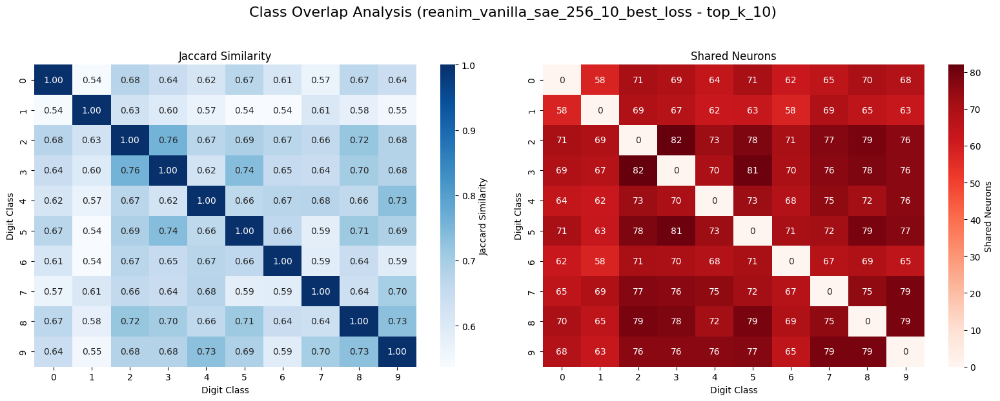

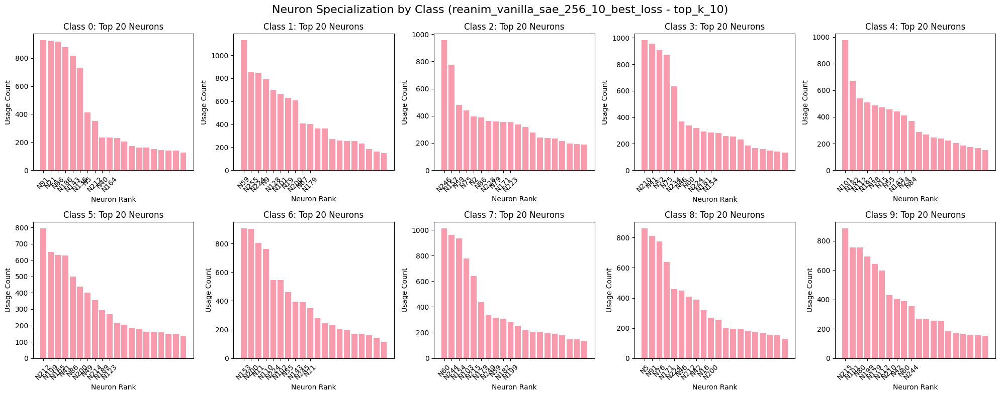


--- Analyzing config: top_k_20 ---


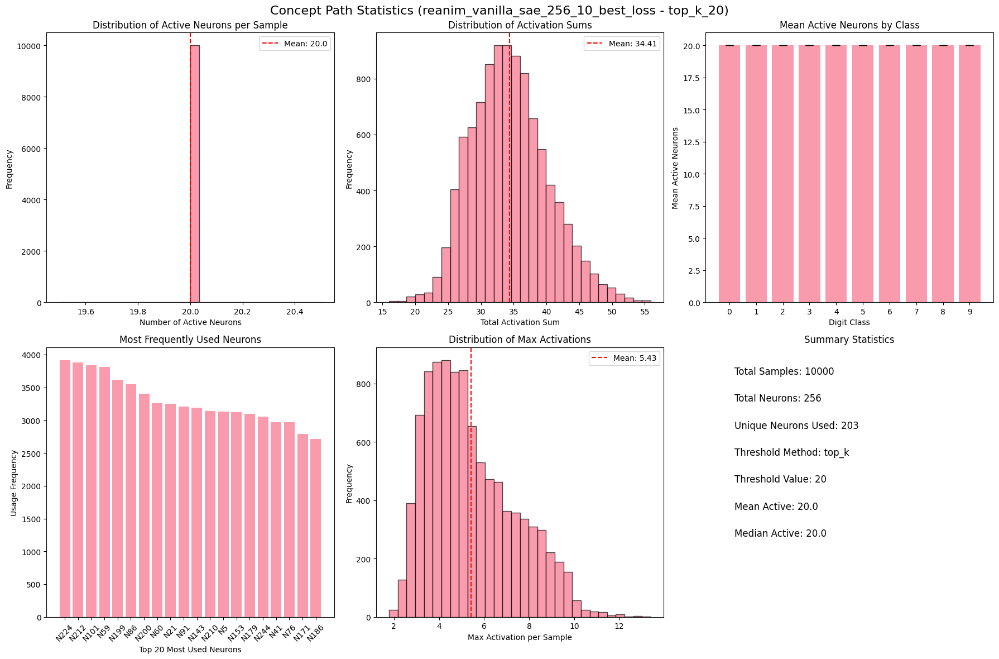

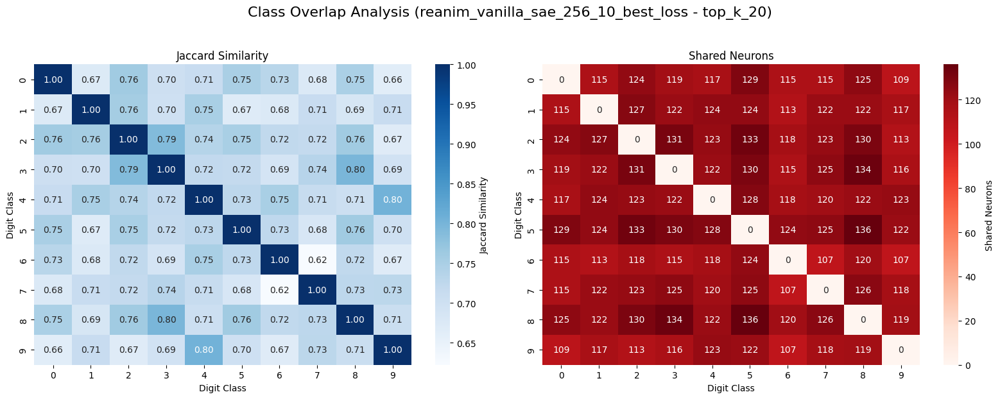

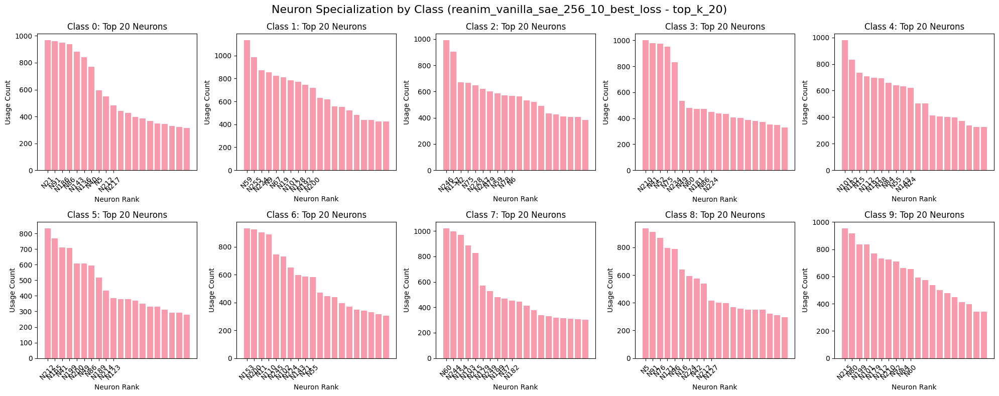


--- Analyzing config: percentile_90 ---


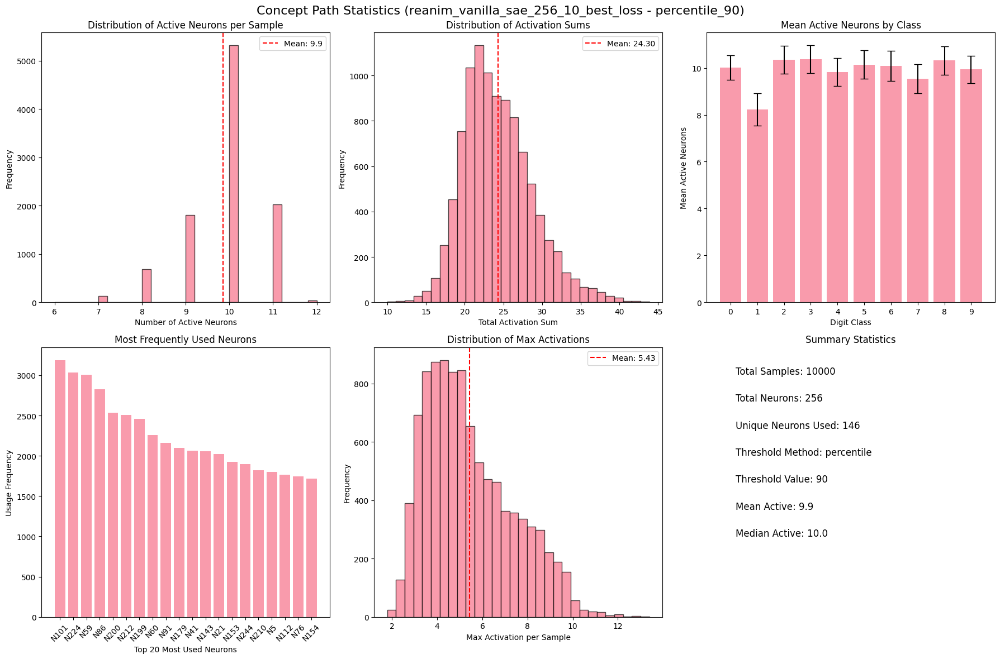

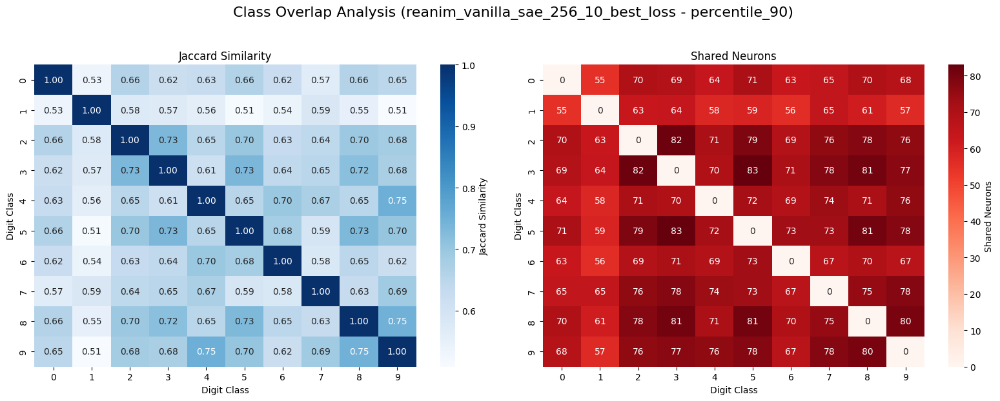

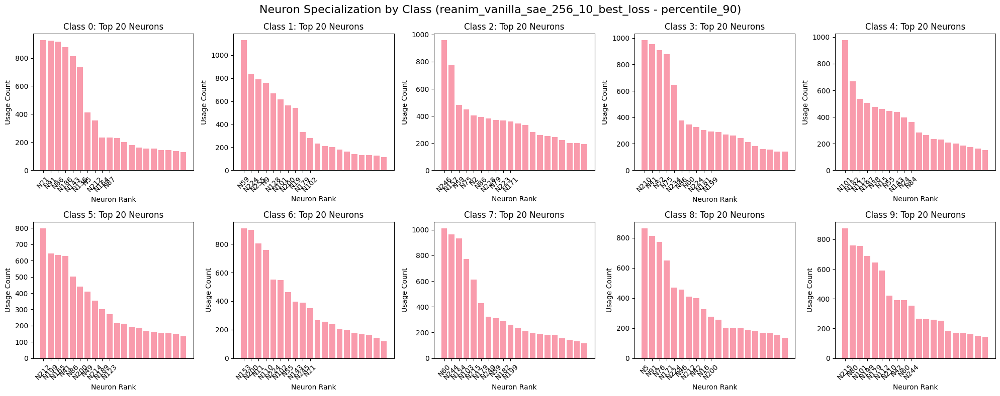


--- Analyzing config: std_threshold_1.5 ---


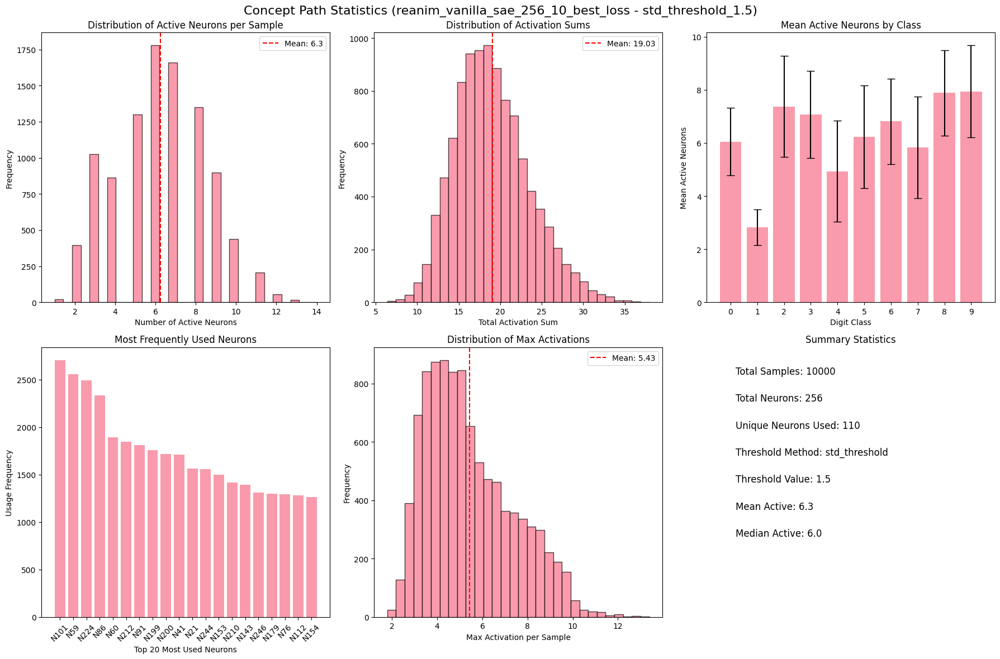

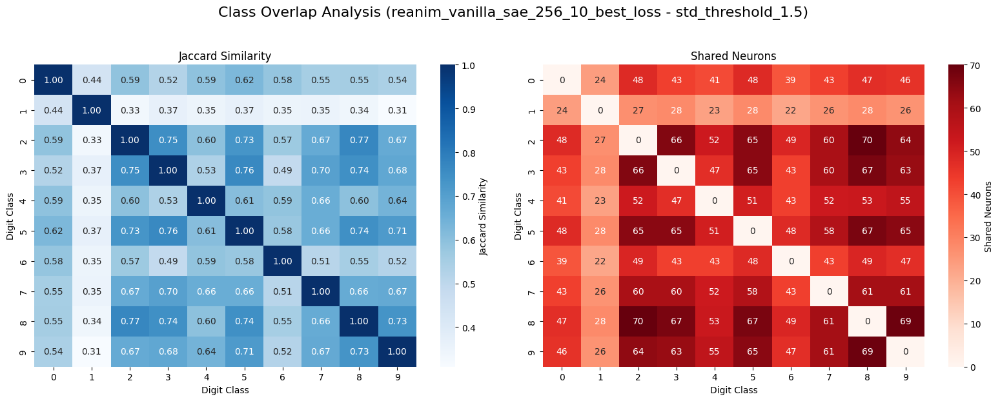

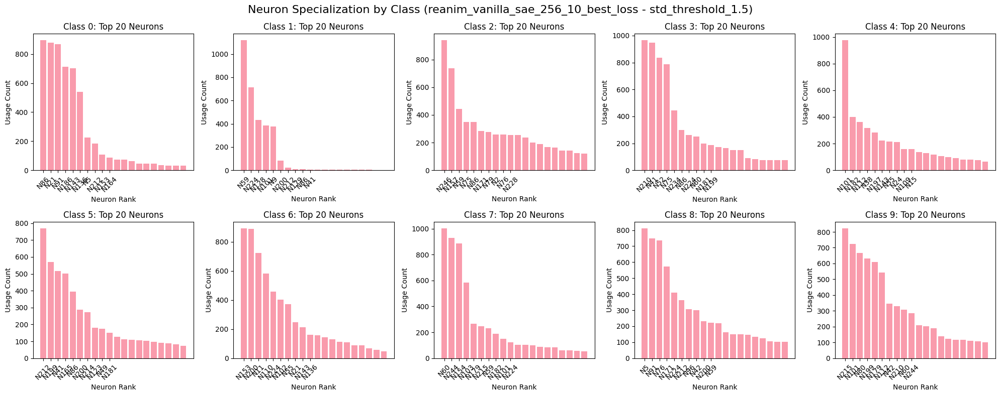


--- Comparing extraction methods for reanim_vanilla_sae_256_10_best_loss ---


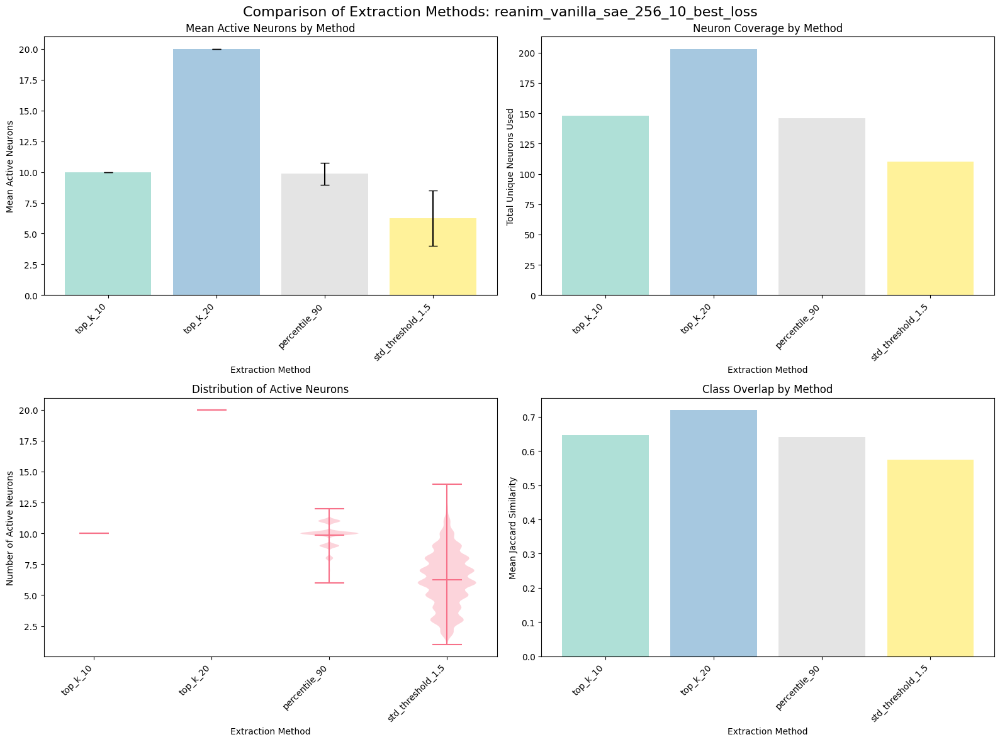


--- Summary across all SAEs (parsing parameters) ---

--- Parsed Summary DataFrame Head ---
                                   SAE    Config Training_Type  Dict_Size  \
12  reanim_vanilla_sae_256_0_best_loss  top_k_10        reanim        256   
11  reanim_vanilla_sae_256_1_best_loss  top_k_10        reanim        256   
39  reanim_vanilla_sae_256_2_best_loss  top_k_10        reanim        256   
95  reanim_vanilla_sae_256_3_best_loss  top_k_10        reanim        256   
94  reanim_vanilla_sae_256_4_best_loss  top_k_10        reanim        256   

    Penalty  Mean_Active  Unique_Neurons  Total_Neurons  Coverage  \
12        0         10.0             165            256  0.644531   
11        1         10.0             168            256  0.656250   
39        2         10.0             161            256  0.628906   
95        3         10.0             158            256  0.617188   
94        4         10.0             167            256  0.652344   

    Mean_Shared_Neurons  Mean

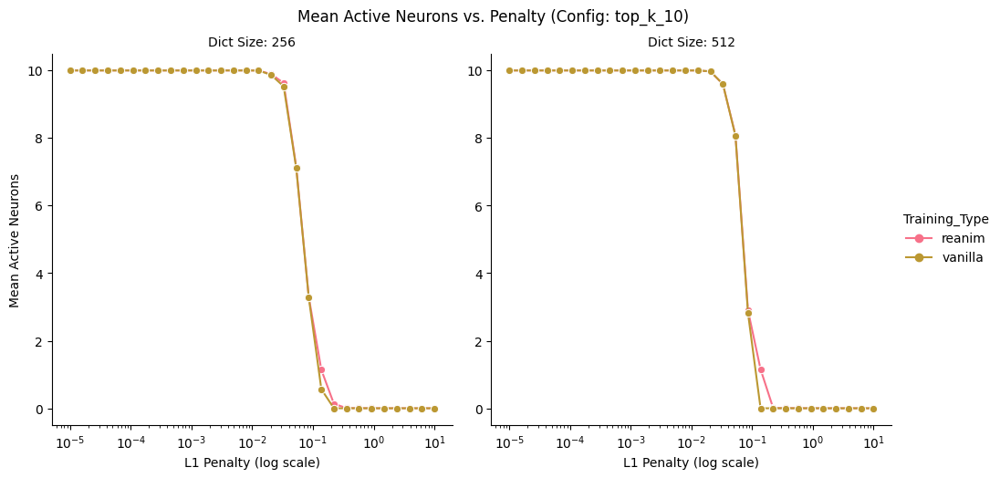


Plotting Neuron Coverage vs. Penalty...


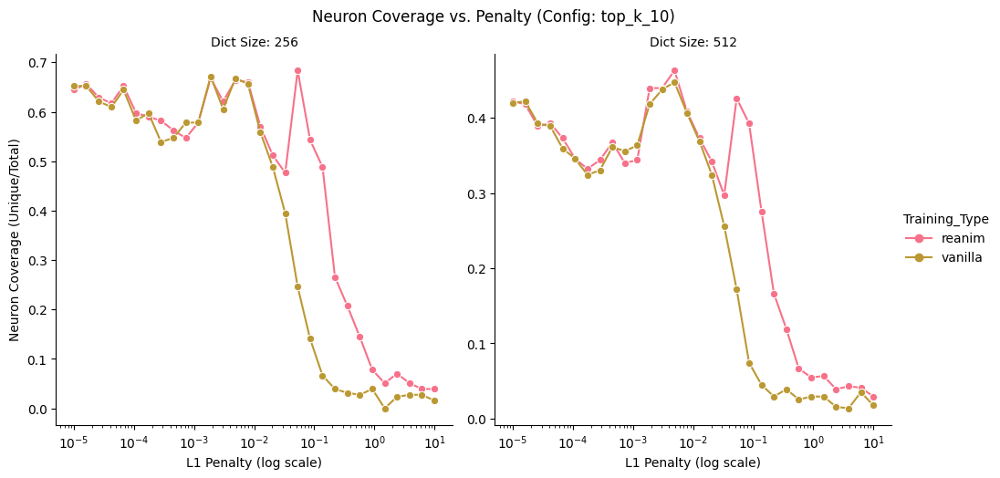


Plotting Mean Shared Neurons vs. Penalty...


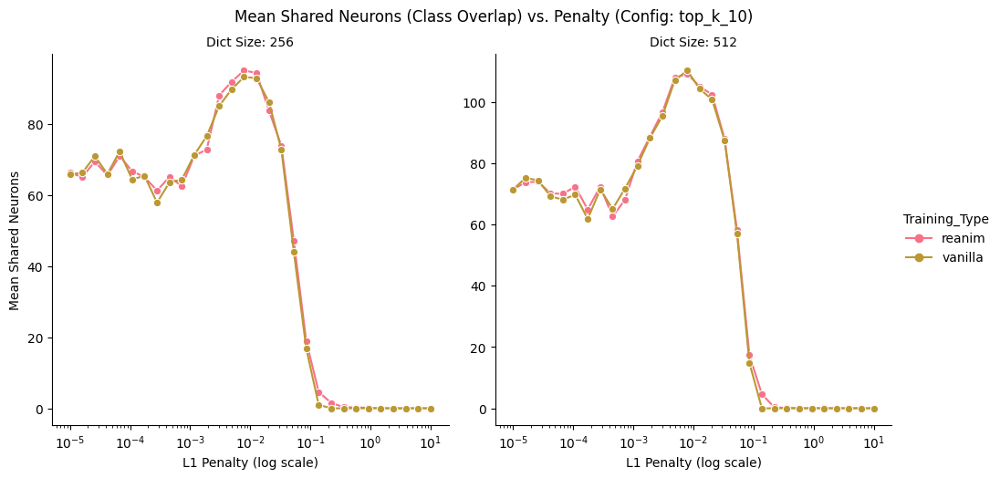


--- Class Overlap Heatmap Evolution vs. Penalty ---
Generating heatmaps for: Training=vanilla, Dict Size=512, Config=top_k_10
Found 30 SAEs. Plotting heatmaps...

Plotting for: vanilla_sae_512_0_best_loss (Penalty Index: 0, L1: 1e-05)


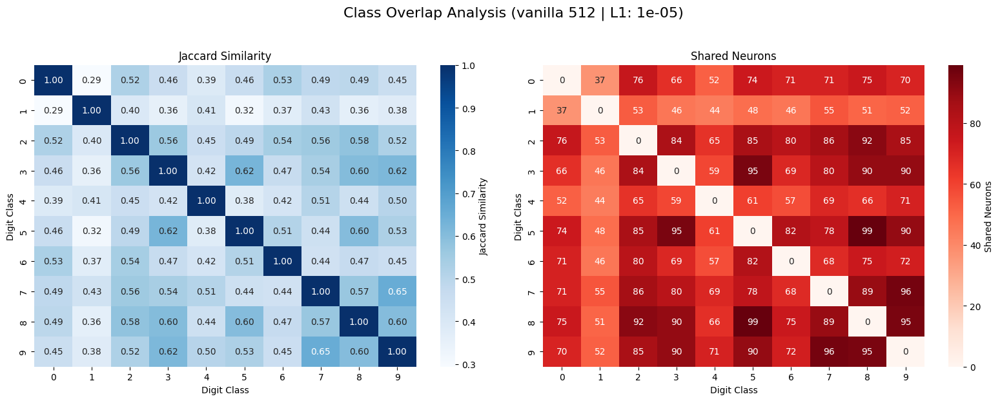


Plotting for: vanilla_sae_512_1_best_loss (Penalty Index: 1, L1: 1.6e-05)


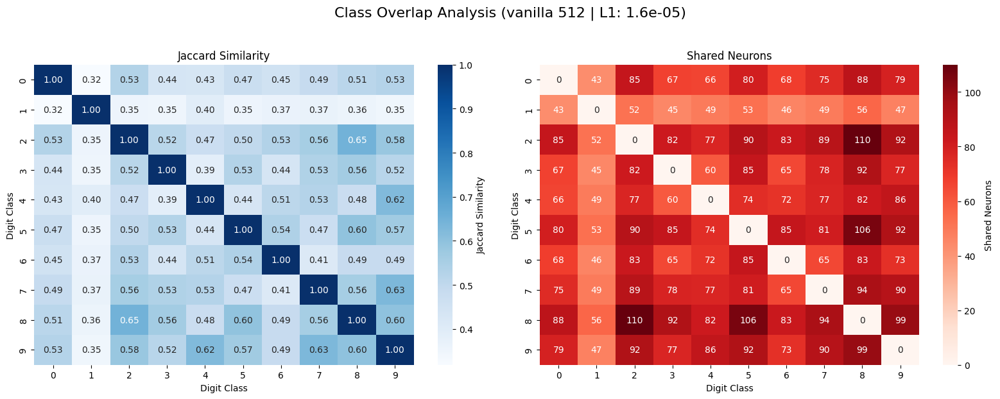


Plotting for: vanilla_sae_512_2_best_loss (Penalty Index: 2, L1: 2.6e-05)


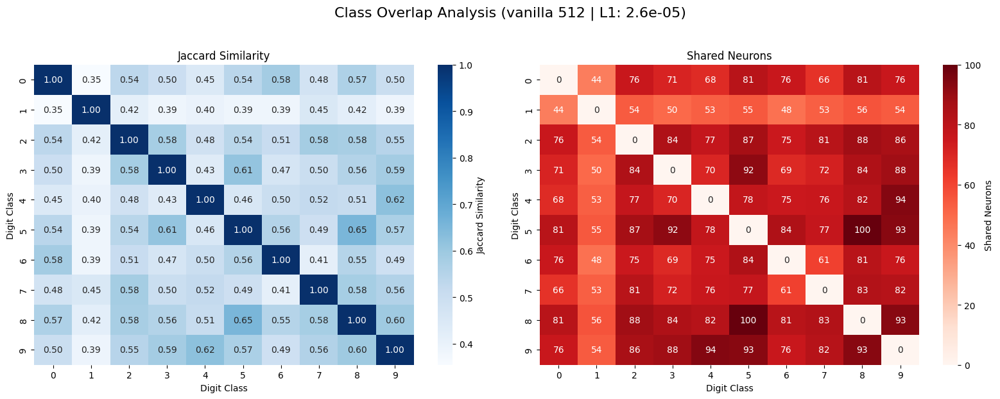


Plotting for: vanilla_sae_512_3_best_loss (Penalty Index: 3, L1: 4.2e-05)


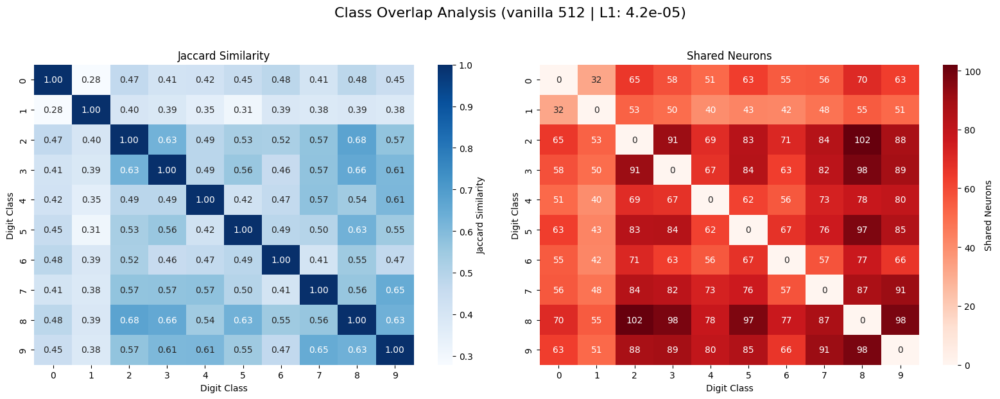


Plotting for: vanilla_sae_512_4_best_loss (Penalty Index: 4, L1: 6.7e-05)


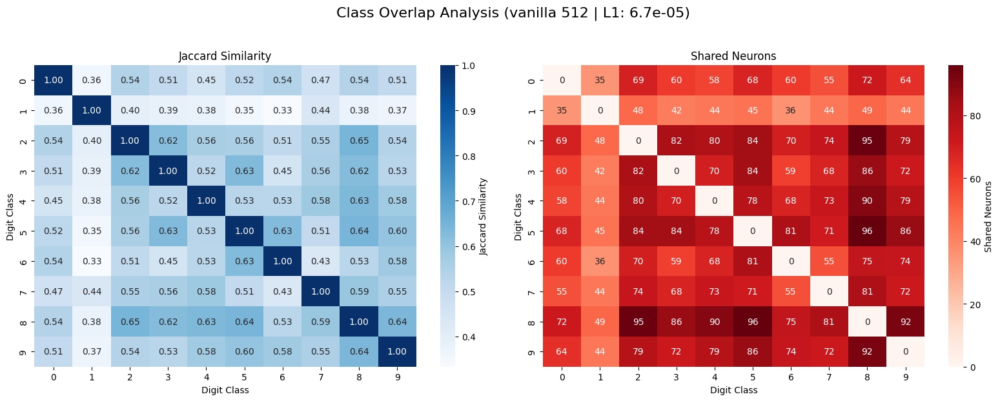


Plotting for: vanilla_sae_512_5_best_loss (Penalty Index: 5, L1: 0.000108)


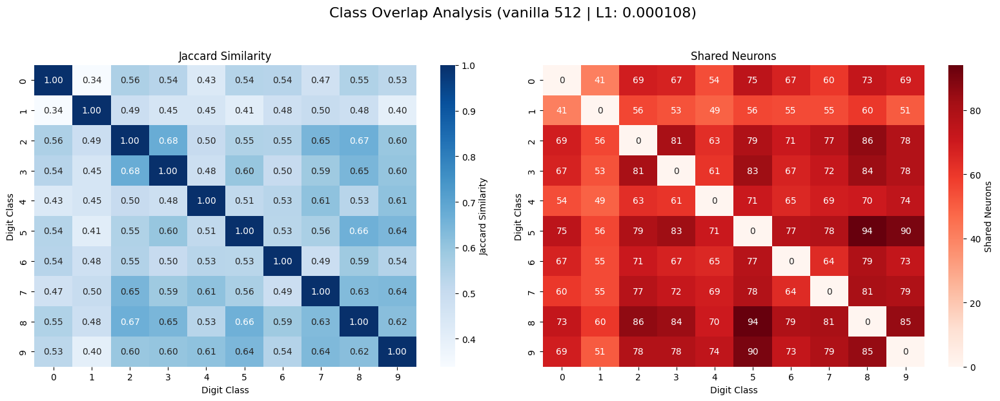


Plotting for: vanilla_sae_512_6_best_loss (Penalty Index: 6, L1: 0.000174)


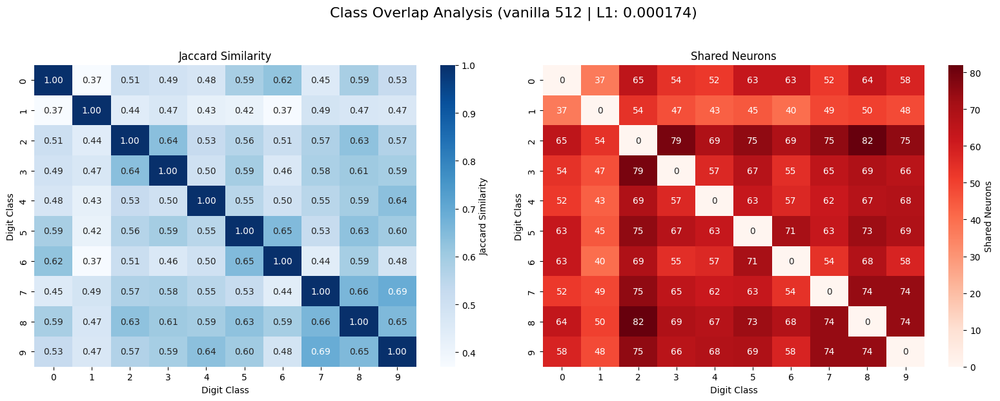


Plotting for: vanilla_sae_512_7_best_loss (Penalty Index: 7, L1: 0.000281)


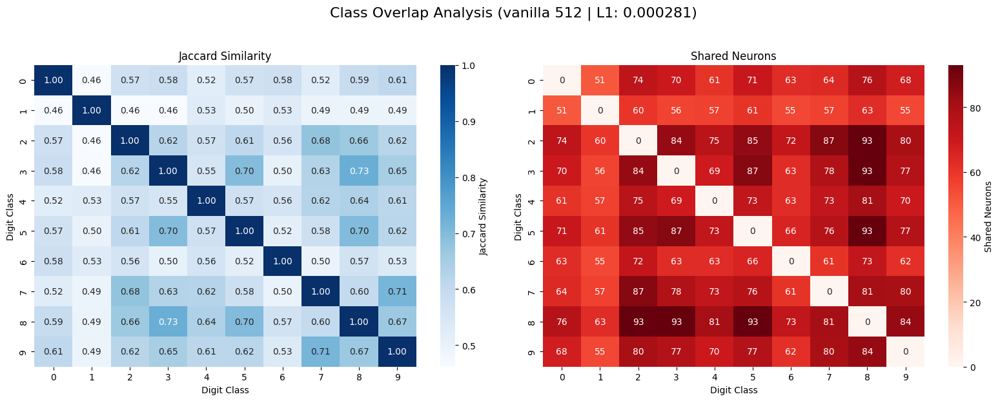


Plotting for: vanilla_sae_512_8_best_loss (Penalty Index: 8, L1: 0.000452)


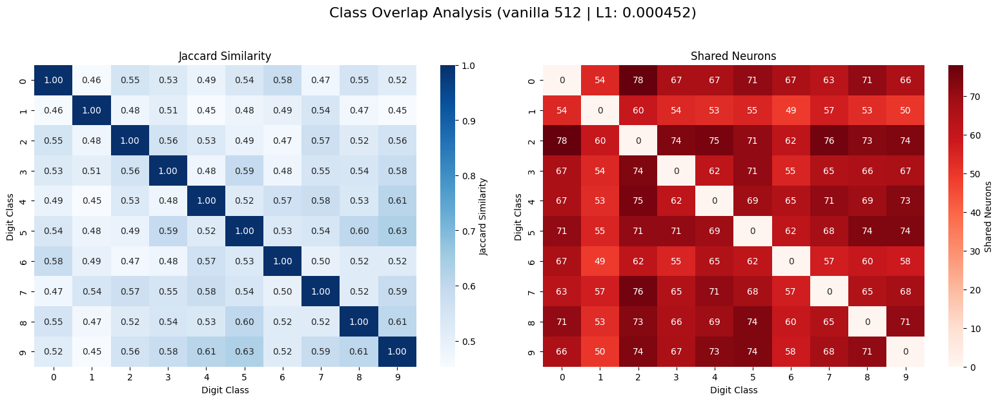


Plotting for: vanilla_sae_512_9_best_loss (Penalty Index: 9, L1: 0.000728)


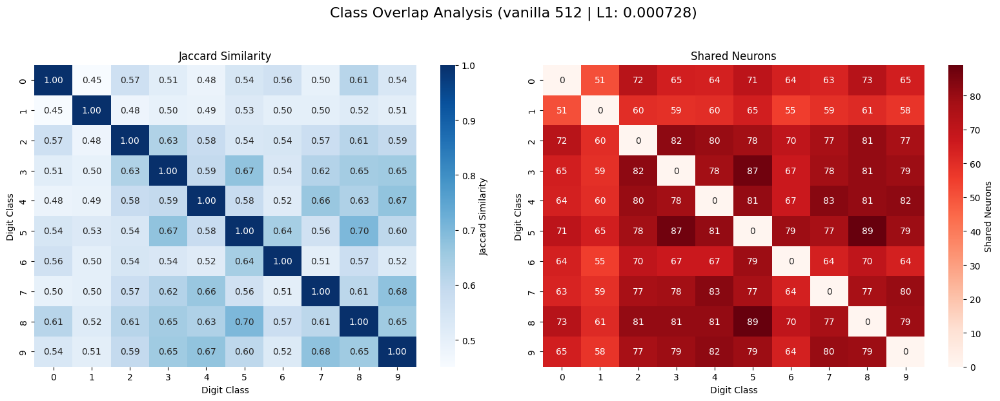


Plotting for: vanilla_sae_512_10_best_loss (Penalty Index: 10, L1: 0.001172)


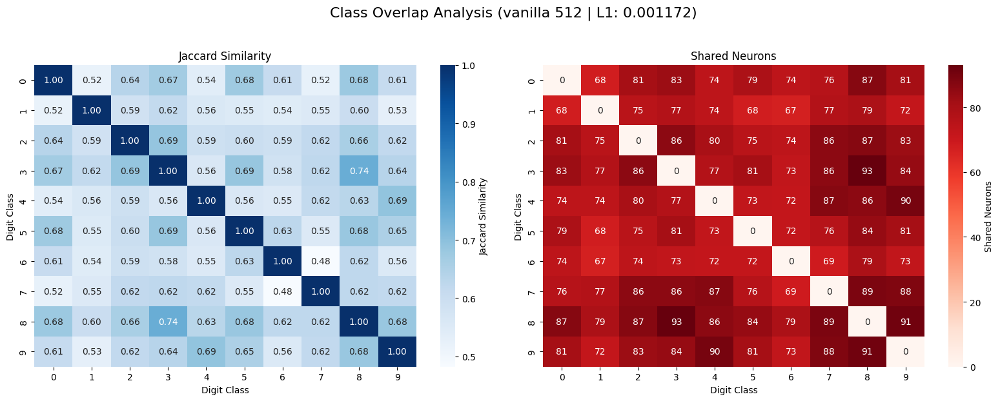


Plotting for: vanilla_sae_512_11_best_loss (Penalty Index: 11, L1: 0.001887)


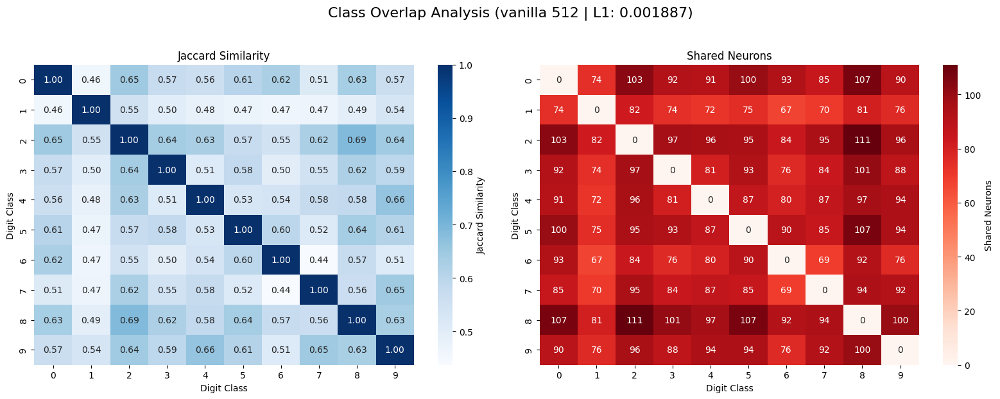


Plotting for: vanilla_sae_512_12_best_loss (Penalty Index: 12, L1: 0.003039)


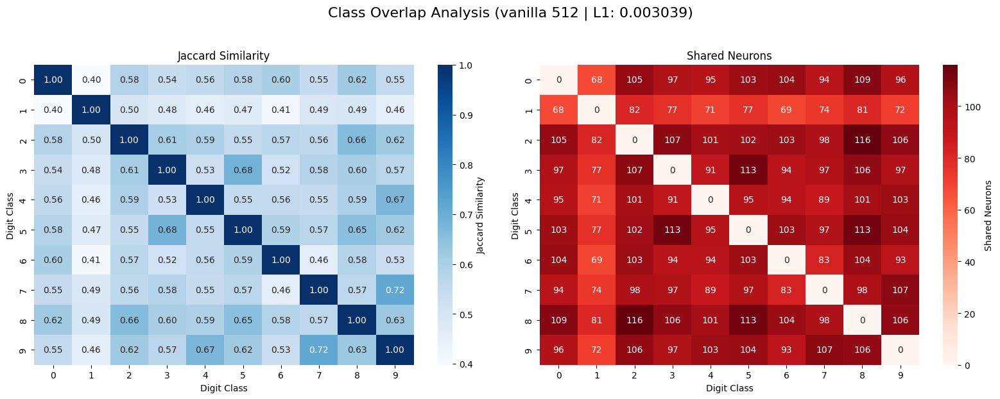


Plotting for: vanilla_sae_512_13_best_loss (Penalty Index: 13, L1: 0.004894)


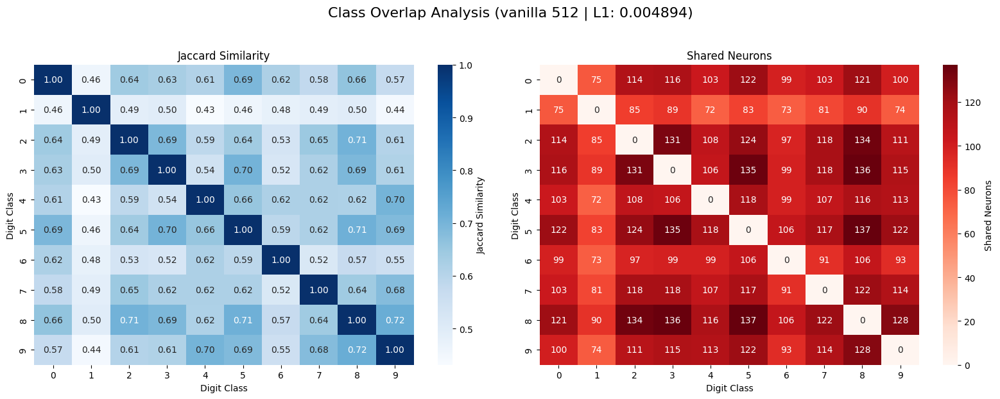


Plotting for: vanilla_sae_512_14_best_loss (Penalty Index: 14, L1: 0.00788)


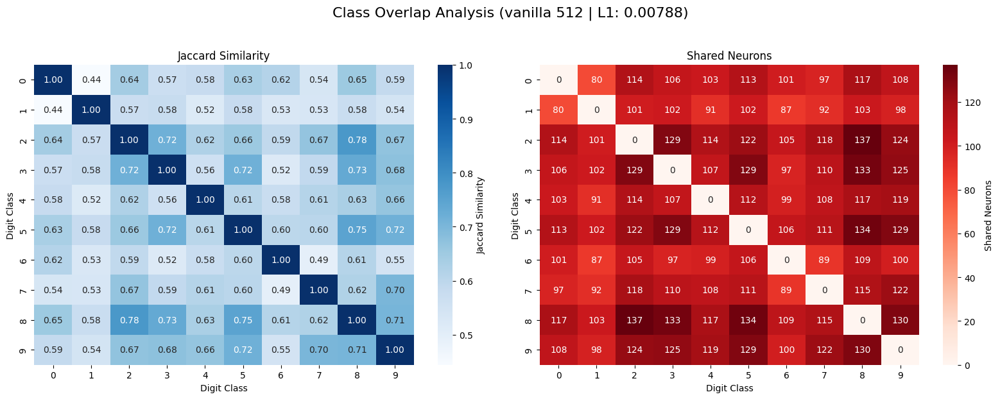


Plotting for: vanilla_sae_512_15_best_loss (Penalty Index: 15, L1: 0.01269)


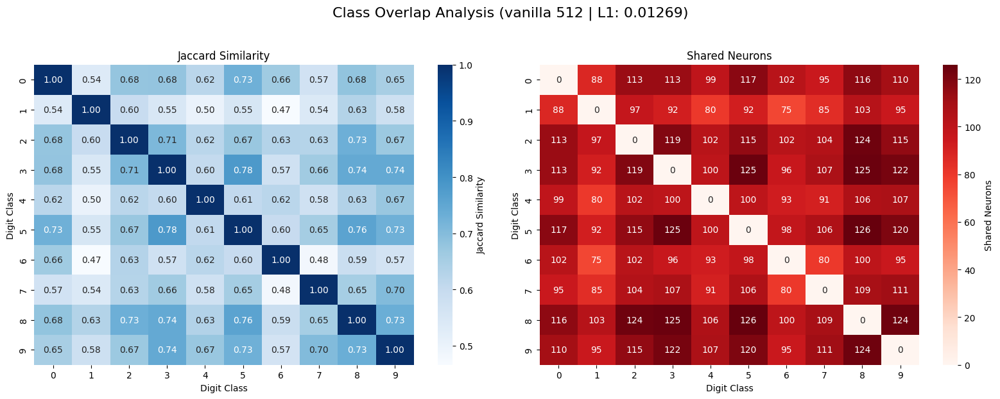


Plotting for: vanilla_sae_512_16_best_loss (Penalty Index: 16, L1: 0.020434)


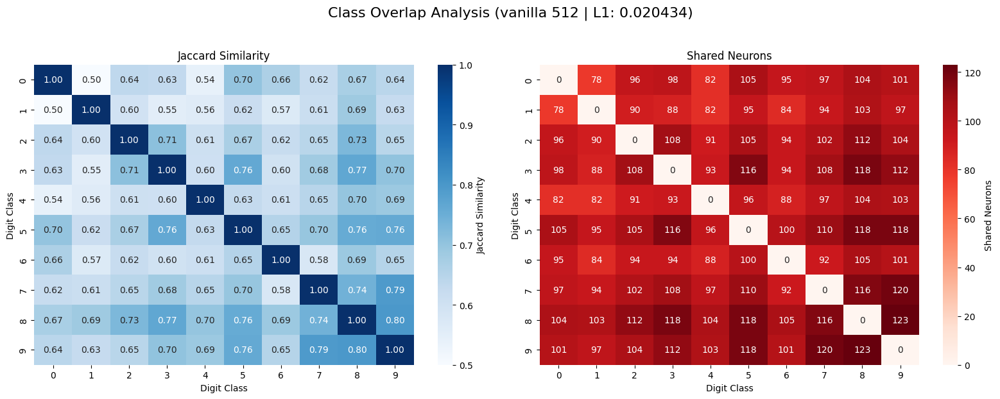


Plotting for: vanilla_sae_512_17_best_loss (Penalty Index: 17, L1: 0.032903)


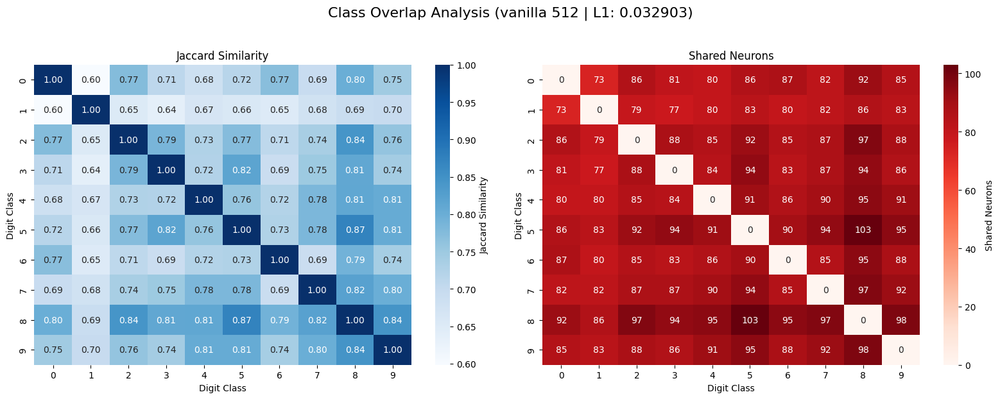


Plotting for: vanilla_sae_512_18_best_loss (Penalty Index: 18, L1: 0.052983)


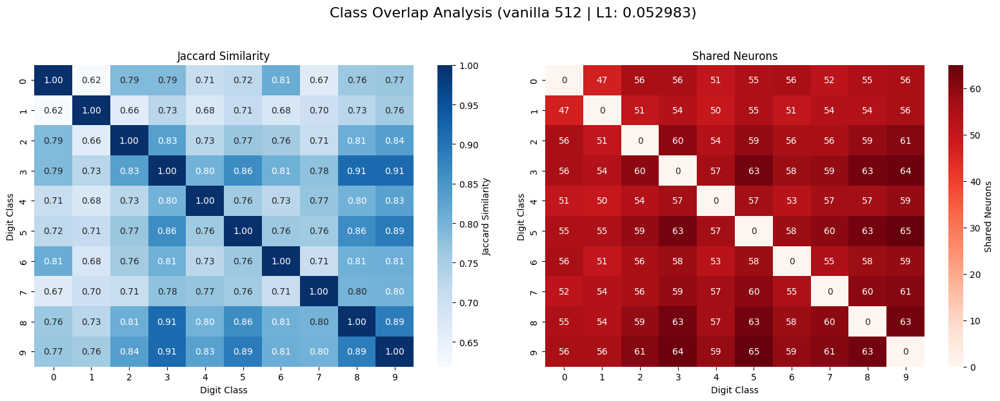


Plotting for: vanilla_sae_512_19_best_loss (Penalty Index: 19, L1: 0.085317)


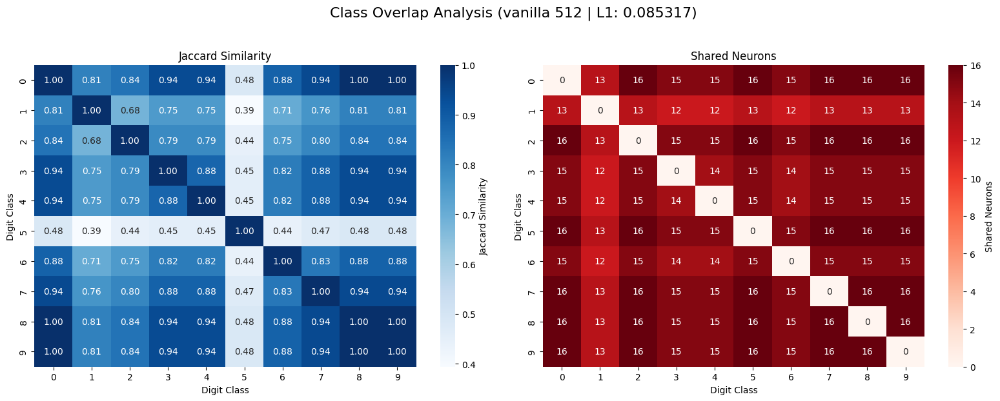


Plotting for: vanilla_sae_512_20_best_loss (Penalty Index: 20, L1: 0.137382)


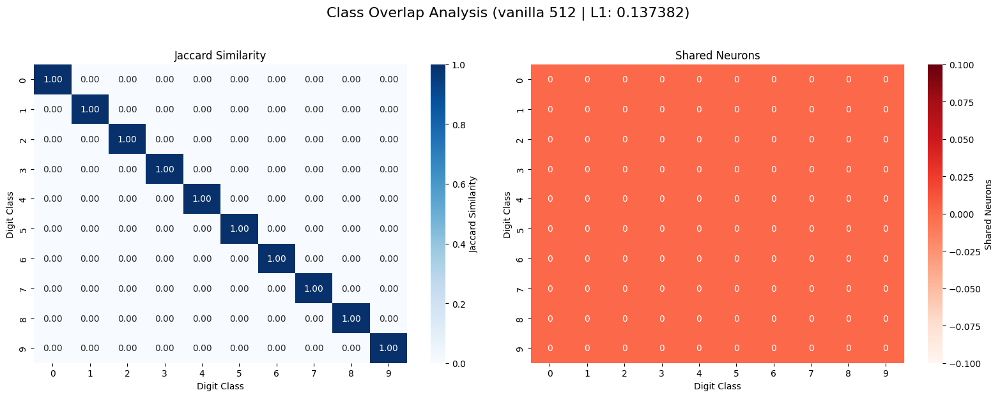


Plotting for: vanilla_sae_512_21_best_loss (Penalty Index: 21, L1: 0.221222)


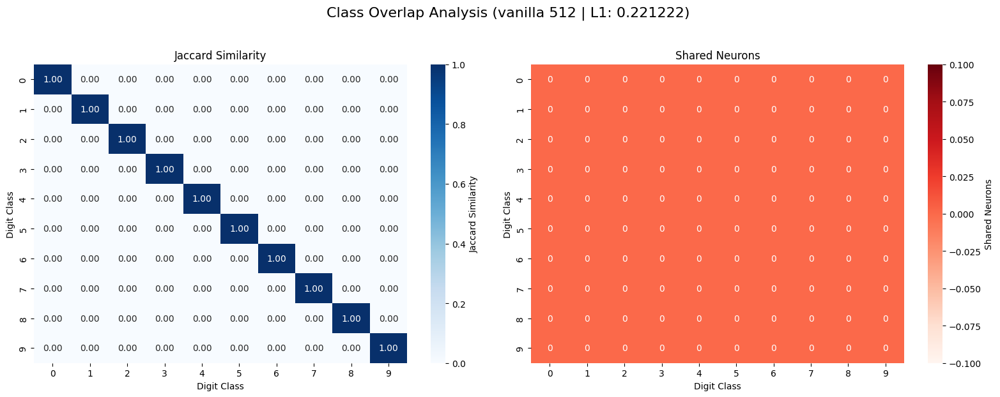


Plotting for: vanilla_sae_512_22_best_loss (Penalty Index: 22, L1: 0.356225)


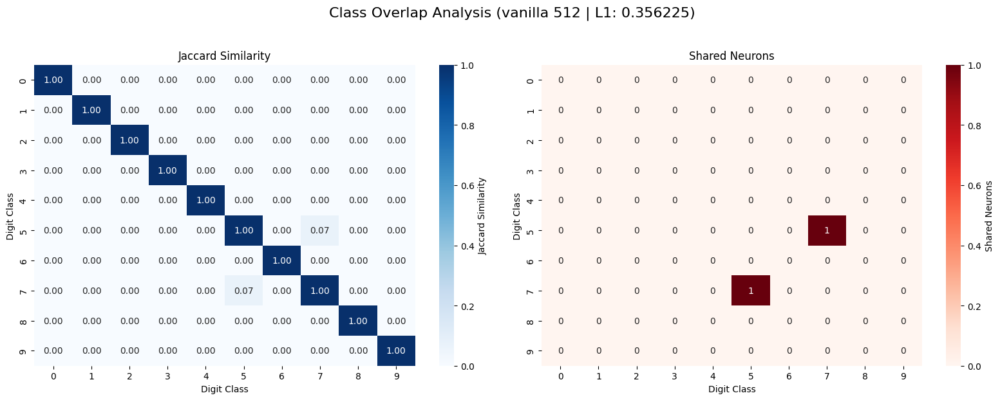


Plotting for: vanilla_sae_512_23_best_loss (Penalty Index: 23, L1: 0.573615)


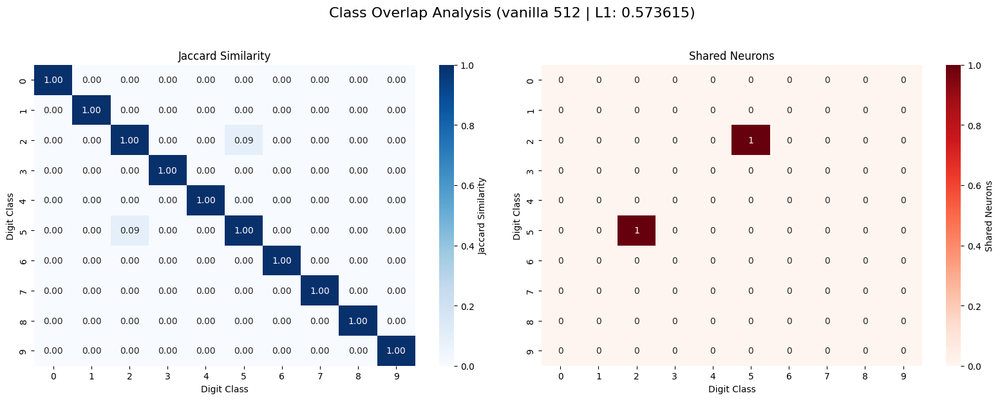


Plotting for: vanilla_sae_512_24_best_loss (Penalty Index: 24, L1: 0.923671)


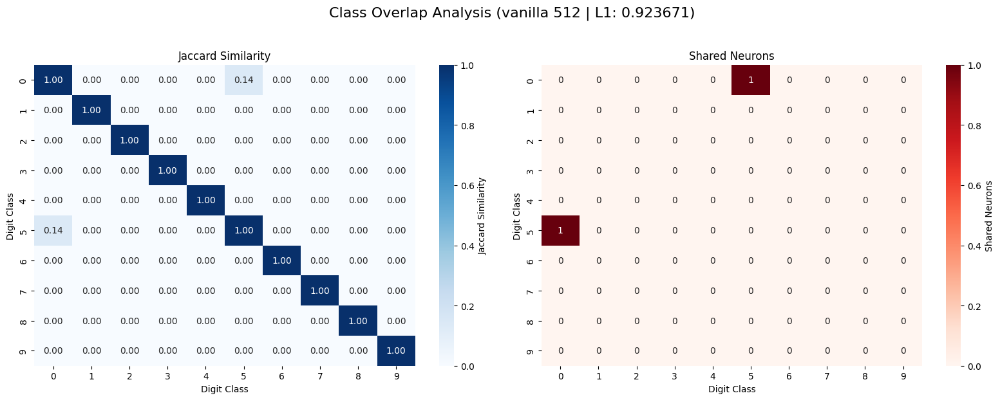


Plotting for: vanilla_sae_512_25_best_loss (Penalty Index: 25, L1: 1.487352)


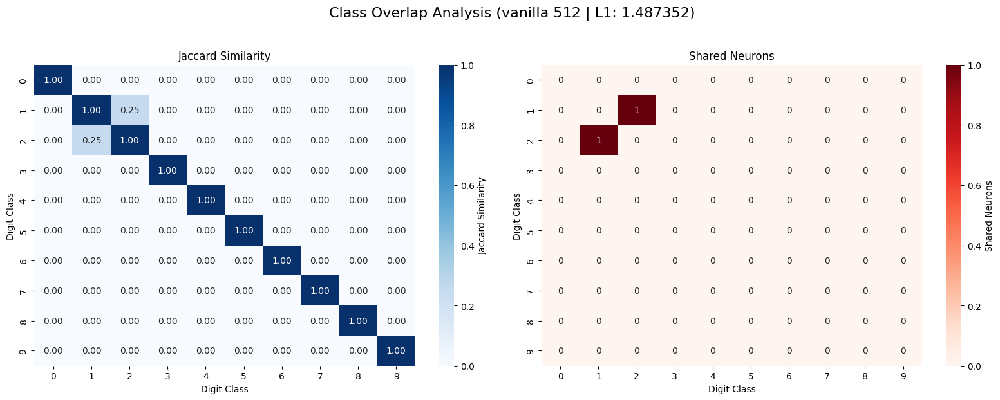


Plotting for: vanilla_sae_512_26_best_loss (Penalty Index: 26, L1: 2.395027)


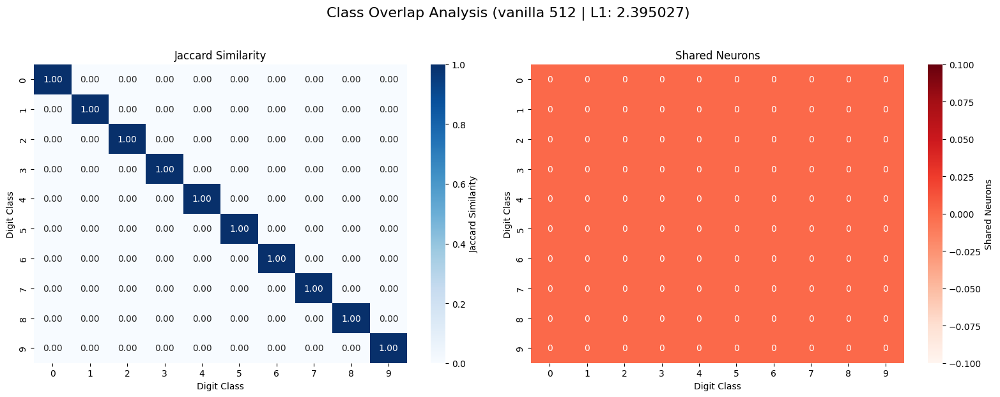


Plotting for: vanilla_sae_512_27_best_loss (Penalty Index: 27, L1: 3.85662)


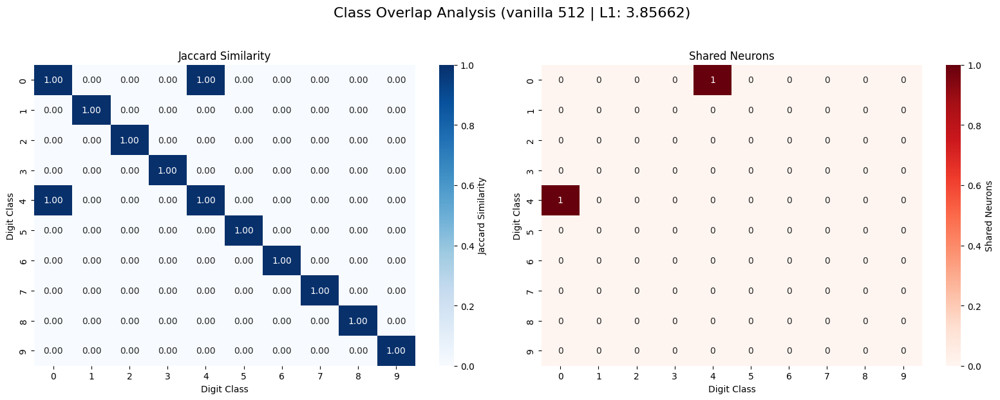


Plotting for: vanilla_sae_512_28_best_loss (Penalty Index: 28, L1: 6.210169)


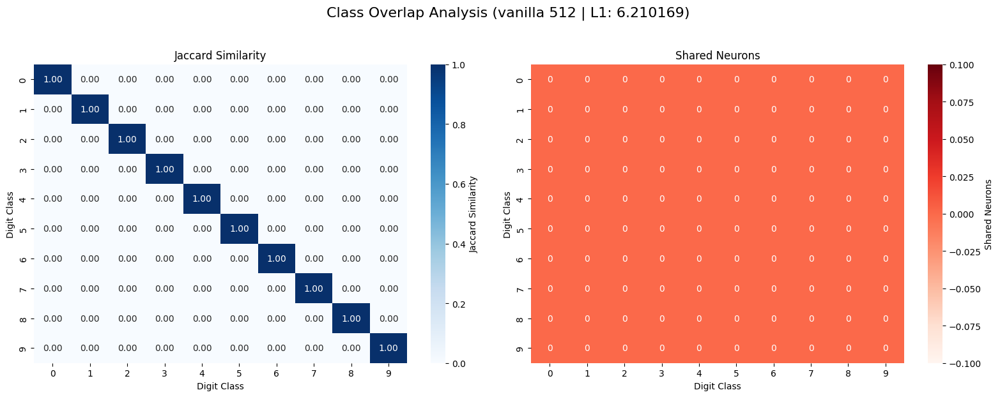


Plotting for: vanilla_sae_512_29_best_loss (Penalty Index: 29, L1: 10.0)


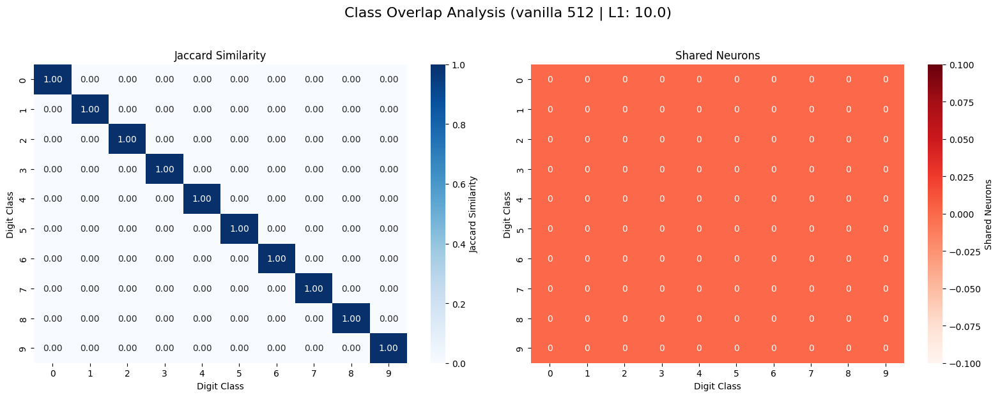


Summary Table (Config: top_k_10):
                                    SAE    Config Training_Type  Dict_Size  \
12   reanim_vanilla_sae_256_0_best_loss  top_k_10        reanim        256   
11   reanim_vanilla_sae_256_1_best_loss  top_k_10        reanim        256   
39   reanim_vanilla_sae_256_2_best_loss  top_k_10        reanim        256   
95   reanim_vanilla_sae_256_3_best_loss  top_k_10        reanim        256   
94   reanim_vanilla_sae_256_4_best_loss  top_k_10        reanim        256   
..                                  ...       ...           ...        ...   
99         vanilla_sae_512_25_best_loss  top_k_10       vanilla        512   
33         vanilla_sae_512_26_best_loss  top_k_10       vanilla        512   
1          vanilla_sae_512_27_best_loss  top_k_10       vanilla        512   
112        vanilla_sae_512_28_best_loss  top_k_10       vanilla        512   
10         vanilla_sae_512_29_best_loss  top_k_10       vanilla        512   

     Penalty  Mean_Active  U

In [17]:
# ===== CONCEPT PATHS VISUALIZATION =====
# Run this cell to visualize concept paths from your SAE analysis

import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import defaultdict, Counter
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import networkx as nx

# Set plotting style
plt.style.use('default')
sns.set_palette("husl")

concept_paths_file = '../logs/mnist_activation/Seed1/vanilla_sae/new_concept_path_results.pkl'


try:
    with open(concept_paths_file, 'rb') as f:
        all_concept_paths = pickle.load(f)
    print(f"Loaded concept paths for {len(all_concept_paths)} SAEs")
    
    # Display available SAEs and configs
    for sae_name, configs in all_concept_paths.items():
        print(f"\n{sae_name}: {list(configs.keys())}")
        
except FileNotFoundError:
    print(f"File not found: {concept_paths_file}")
    print("Please update the concept_paths_file path above")
    # Create dummy data for demonstration
    all_concept_paths = {}

# ===== HELPER FUNCTIONS =====

def plot_concept_path_statistics(concept_paths_data, title_suffix=""):
    """Plot basic statistics about concept paths."""
    
    concept_paths = concept_paths_data['concept_paths']
    summary = concept_paths_data['summary']
    
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    fig.suptitle(f'Concept Path Statistics {title_suffix}', fontsize=16)
    
    num_active = [path['num_active'] for path in concept_paths]
    axes[0, 0].hist(num_active, bins=30, alpha=0.7, edgecolor='black')
    axes[0, 0].axvline(np.mean(num_active), color='red', linestyle='--', 
                       label=f'Mean: {np.mean(num_active):.1f}')
    axes[0, 0].set_xlabel('Number of Active Neurons')
    axes[0, 0].set_ylabel('Frequency')
    axes[0, 0].set_title('Distribution of Active Neurons per Sample')
    axes[0, 0].legend()
    
    # 2. Distribution of activation sums
    activation_sums = [path['activation_sum'] for path in concept_paths]
    axes[0, 1].hist(activation_sums, bins=30, alpha=0.7, edgecolor='black')
    axes[0, 1].axvline(np.mean(activation_sums), color='red', linestyle='--',
                       label=f'Mean: {np.mean(activation_sums):.2f}')
    axes[0, 1].set_xlabel('Total Activation Sum')
    axes[0, 1].set_ylabel('Frequency')
    axes[0, 1].set_title('Distribution of Activation Sums')
    axes[0, 1].legend()
    
    # 3. Per-class statistics (if labels available)
    if 'class_statistics' in summary:
        class_stats = summary['class_statistics']
        classes = sorted(class_stats.keys())
        
        class_means = [class_stats[c]['mean_active_neurons'] for c in classes]
        class_stds = [class_stats[c]['std_active_neurons'] for c in classes]
        
        axes[0, 2].bar(classes, class_means, yerr=class_stds, capsize=5, alpha=0.7)
        axes[0, 2].set_xlabel('Digit Class')
        axes[0, 2].set_ylabel('Mean Active Neurons')
        axes[0, 2].set_title('Mean Active Neurons by Class')
        axes[0, 2].set_xticks(classes)
    
    # 4. Neuron usage frequency
    all_neurons = []
    for path in concept_paths:
        all_neurons.extend(path['active_neurons'])
    
    neuron_counts = Counter(all_neurons)
    top_neurons = dict(sorted(neuron_counts.items(), key=lambda x: x[1], reverse=True)[:20])
    
    axes[1, 0].bar(range(len(top_neurons)), list(top_neurons.values()), alpha=0.7)
    axes[1, 0].set_xlabel('Top 20 Most Used Neurons')
    axes[1, 0].set_ylabel('Usage Frequency')
    axes[1, 0].set_title('Most Frequently Used Neurons')
    axes[1, 0].set_xticks(range(len(top_neurons)))
    axes[1, 0].set_xticklabels([f'N{k}' for k in top_neurons.keys()], rotation=45)
    
    # 5. Max activation distribution
    max_activations = [path['max_activation'] for path in concept_paths]
    axes[1, 1].hist(max_activations, bins=30, alpha=0.7, edgecolor='black')
    axes[1, 1].axvline(np.mean(max_activations), color='red', linestyle='--',
                       label=f'Mean: {np.mean(max_activations):.2f}')
    axes[1, 1].set_xlabel('Max Activation per Sample')
    axes[1, 1].set_ylabel('Frequency')
    axes[1, 1].set_title('Distribution of Max Activations')
    axes[1, 1].legend()
    
    # 6. Summary text
    axes[1, 2].text(0.1, 0.9, f"Total Samples: {summary['n_samples']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.8, f"Total Neurons: {summary['n_neurons']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.7, f"Unique Neurons Used: {summary['total_unique_neurons_used']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.6, f"Threshold Method: {summary['threshold_method']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.5, f"Threshold Value: {summary['threshold_value']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.4, f"Mean Active: {summary['mean_active_neurons']:.1f}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.3, f"Median Active: {summary['median_active_neurons']:.1f}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].set_xlim(0, 1)
    axes[1, 2].set_ylim(0, 1)
    axes[1, 2].set_title('Summary Statistics')
    axes[1, 2].axis('off')
    
    plt.tight_layout()
    plt.show()

def plot_class_overlap_heatmap(concept_paths_data, title_suffix=""):
    """Plot heatmap of class overlaps."""
    
    if 'overlap_analysis' not in concept_paths_data:
        print(f"No overlap analysis found in concept paths data for {title_suffix}")
        return
    
    overlap_data = concept_paths_data['overlap_analysis'].get('overlap_analysis')
    if not overlap_data:
        print(f"No 'overlap_analysis' sub-key found for {title_suffix}")
        return
    
    # Extract classes from overlap keys
    classes = set()
    for key in overlap_data.keys():
        parts = key.split('_')
        try:
            classes.add(int(parts[1]))
            classes.add(int(parts[3]))
        except (IndexError, ValueError):
            print(f"Warning: Could not parse class from overlap key: {key}")
            continue
    classes = sorted(classes)
    if not classes:
        print("Warning: No valid classes found for overlap heatmap.")
        return

    # Create matrices for different overlap metrics
    jaccard_matrix = np.zeros((len(classes), len(classes)))
    shared_neurons_matrix = np.zeros((len(classes), len(classes)))
    
    for key, data in overlap_data.items():
        parts = key.split('_')
        try:
            i, j = int(parts[1]), int(parts[3])
            i_idx, j_idx = classes.index(i), classes.index(j)
            
            jaccard_matrix[i_idx, j_idx] = data['jaccard_similarity']
            jaccard_matrix[j_idx, i_idx] = data['jaccard_similarity']  # Symmetric
            
            shared_neurons_matrix[i_idx, j_idx] = data['shared_neurons']
            shared_neurons_matrix[j_idx, i_idx] = data['shared_neurons']
        except (IndexError, ValueError, KeyError):
            continue # Skip if key is malformed or data is missing
    
    # Set diagonal to 1 for Jaccard (self-similarity)
    np.fill_diagonal(jaccard_matrix, 1.0)
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))
    fig.suptitle(f'Class Overlap Analysis {title_suffix}', fontsize=16, y=1.03)
    
    # Jaccard similarity heatmap
    sns.heatmap(jaccard_matrix, 
                xticklabels=classes, yticklabels=classes,
                annot=True, fmt='.2f', cmap='Blues',
                ax=ax1, cbar_kws={'label': 'Jaccard Similarity'})
    ax1.set_title(f'Jaccard Similarity')
    ax1.set_xlabel('Digit Class')
    ax1.set_ylabel('Digit Class')
    
    # Shared neurons heatmap
    sns.heatmap(shared_neurons_matrix,
                xticklabels=classes, yticklabels=classes,
                annot=True, fmt='.0f', cmap='Reds',
                ax=ax2, cbar_kws={'label': 'Shared Neurons'})
    ax2.set_title(f'Shared Neurons')
    ax2.set_xlabel('Digit Class')
    ax2.set_ylabel('Digit Class')
    
    plt.tight_layout()
    plt.show()

def plot_neuron_class_specialization(concept_paths_data, top_n=20, title_suffix=""):
    """Plot which neurons are most specialized for each class."""
    
    concept_paths = concept_paths_data['concept_paths']
    summary = concept_paths_data['summary']
    
    if 'class_statistics' not in summary:
        print("No class statistics available")
        return
    
    # Count neuron usage per class
    class_neuron_usage = defaultdict(lambda: defaultdict(int))
    
    for path in concept_paths:
        if 'label' in path:
            label = path['label']
            for neuron_idx in path['active_neurons']:
                class_neuron_usage[label][neuron_idx] += 1
    
    # Find most specialized neurons for each class
    classes = sorted(class_neuron_usage.keys())
    n_classes = len(classes)
    
    # Adjust subplot grid if there are fewer than 10 classes (e.g., MNIST)
    n_cols = 5
    n_rows = int(np.ceil(n_classes / n_cols))
    if n_rows == 0: n_rows = 1
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 4 * n_rows))
    axes = axes.flatten()
    
    for i, class_label in enumerate(classes):
        if i >= len(axes):
            break
            
        neuron_counts = class_neuron_usage[class_label]
        
        # Get top neurons for this class
        top_neurons = sorted(neuron_counts.items(), key=lambda x: x[1], reverse=True)[:top_n]
        
        if not top_neurons:
            axes[i].text(0.5, 0.5, 'No active neurons', ha='center', va='center', transform=axes[i].transAxes)
            axes[i].set_title(f'Class {class_label}: Top {top_n} Neurons')
            continue
            
        neurons, counts = zip(*top_neurons)
        
        axes[i].bar(range(len(neurons)), counts, alpha=0.7)
        axes[i].set_title(f'Class {class_label}: Top {top_n} Neurons')
        axes[i].set_xlabel('Neuron Rank')
        axes[i].set_ylabel('Usage Count')
        axes[i].set_xticks(range(min(10, len(neurons))))
        axes[i].set_xticklabels([f'N{n}' for n in neurons[:10]], rotation=45)
    
    # Hide unused subplots
    for j in range(i + 1, len(axes)):
        axes[j].set_visible(False)
    
    fig.suptitle(f'Neuron Specialization by Class {title_suffix}', fontsize=16)
    plt.tight_layout()
    plt.show()

def compare_extraction_methods(sae_concept_paths, sae_name):
    """Compare different concept path extraction methods for the same SAE."""
    
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    fig.suptitle(f'Comparison of Extraction Methods: {sae_name}', fontsize=16)
    
    methods = list(sae_concept_paths.keys())
    if not methods:
        print("No extraction methods to compare.")
        plt.close(fig)
        return
        
    colors = plt.cm.Set3(np.linspace(0, 1, len(methods)))
    
    # 1. Mean active neurons comparison
    method_names = []
    mean_active = []
    std_active = []
    
    for method in methods:
        data = sae_concept_paths.get(method, {})
        if 'summary' not in data: continue
        summary = data['summary']
        method_names.append(method)
        mean_active.append(summary.get('mean_active_neurons', np.nan))
        std_active.append(summary.get('std_active_neurons', np.nan))
    
    if not method_names:
         print("No valid summary data for method comparison.")
         plt.close(fig)
         return

    bars = axes[0, 0].bar(range(len(method_names)), mean_active, 
                           yerr=std_active, capsize=5, alpha=0.7, color=colors)
    axes[0, 0].set_xlabel('Extraction Method')
    axes[0, 0].set_ylabel('Mean Active Neurons')
    axes[0, 0].set_title('Mean Active Neurons by Method')
    axes[0, 0].set_xticks(range(len(method_names)))
    axes[0, 0].set_xticklabels(method_names, rotation=45, ha='right')
    
    # 2. Total unique neurons used
    unique_neurons = [sae_concept_paths[method]['summary'].get('total_unique_neurons_used', np.nan)
                       for method in method_names]
    
    axes[0, 1].bar(range(len(method_names)), unique_neurons, alpha=0.7, color=colors)
    axes[0, 1].set_xlabel('Extraction Method')
    axes[0, 1].set_ylabel('Total Unique Neurons Used')
    axes[0, 1].set_title('Neuron Coverage by Method')
    axes[0, 1].set_xticks(range(len(method_names)))
    axes[0, 1].set_xticklabels(method_names, rotation=45, ha='right')
    
    # 3. Distribution of active neurons (violin plot)
    all_num_active = []
    method_labels = []
    
    for method in method_names:
        concept_paths = sae_concept_paths[method].get('concept_paths', [])
        num_active = [path['num_active'] for path in concept_paths]
        all_num_active.extend(num_active)
        method_labels.extend([method] * len(num_active))
    
    if all_num_active:
        # Create dataframe for seaborn
        df = pd.DataFrame({'Method': method_labels, 'Active_Neurons': all_num_active})
        
        # Use matplotlib for violin plot
        method_data = [df[df['Method'] == method]['Active_Neurons'].values for method in method_names]
        
        parts = axes[1, 0].violinplot(method_data, positions=range(len(method_names)), showmeans=True)
        axes[1, 0].set_xlabel('Extraction Method')
        axes[1, 0].set_ylabel('Number of Active Neurons')
        axes[1, 0].set_title('Distribution of Active Neurons')
        axes[1, 0].set_xticks(range(len(method_names)))
        axes[1, 0].set_xticklabels(method_names, rotation=45, ha='right')
    else:
        axes[1, 0].text(0.5, 0.5, 'No activation data available', 
                          ha='center', va='center', transform=axes[1, 0].transAxes)
        axes[1, 0].set_title('Distribution of Active Neurons')

    
    # 4. Mean overlap between classes (if available)
    mean_overlaps = []
    for method in method_names:
        overlap_data = sae_concept_paths[method].get('overlap_analysis', {})
        summary = overlap_data.get('summary', {})
        mean_overlaps.append(summary.get('mean_jaccard', 0))
    
    if any(overlap > 0 for overlap in mean_overlaps):
        axes[1, 1].bar(range(len(method_names)), mean_overlaps, alpha=0.7, color=colors)
        axes[1, 1].set_xlabel('Extraction Method')
        axes[1, 1].set_ylabel('Mean Jaccard Similarity')
        axes[1, 1].set_title('Class Overlap by Method')
        axes[1, 1].set_xticks(range(len(method_names)))
        axes[1, 1].set_xticklabels(method_names, rotation=45, ha='right')
    else:
        axes[1, 1].text(0.5, 0.5, 'No overlap data available', 
                          ha='center', va='center', transform=axes[1, 1].transAxes)
        axes[1, 1].set_title('Class Overlap by Method')
    
    plt.tight_layout()
    plt.show()

# ===== MAIN VISUALIZATION CODE =====

if all_concept_paths:
    print("=== CONCEPT PATHS VISUALIZATION ===\n")
    
    # Select which SAE and config to visualize
    sae_names = list(all_concept_paths.keys())
    print("Available SAEs:")
    for i, name in enumerate(sae_names):
        print(f"{i}: {name}")
    
    # Visualize the first SAE (change index as needed)
    selected_sae_idx = 0
    if sae_names:
        selected_sae = sae_names[selected_sae_idx]
        
        print(f"\nVisualizing: {selected_sae}")
        
        # Get available configs for this SAE
        configs = list(all_concept_paths[selected_sae].keys())
        print(f"Available configs: {configs}")
        
        # Visualize each config
        for config in configs: 
            print(f"\n--- Analyzing config: {config} ---")
            concept_paths_data = all_concept_paths[selected_sae].get(config)
            if not concept_paths_data:
                print(f"No data for config {config}, skipping.")
                continue
            
            # Basic statistics
            plot_concept_path_statistics(concept_paths_data, f"({selected_sae} - {config})")
            
            # Class overlap heatmap
            plot_class_overlap_heatmap(concept_paths_data, f"({selected_sae} - {config})")
            
            # Neuron specialization
            plot_neuron_class_specialization(concept_paths_data, title_suffix=f"({selected_sae} - {config})")
        
        # Compare different extraction methods for the same SAE
        print(f"\n--- Comparing extraction methods for {selected_sae} ---")
        compare_extraction_methods(all_concept_paths[selected_sae], selected_sae)
    else:
        print("No SAEs found in the data.")

    # ===== NEW SUMMARY SECTION =====
    print("\n--- Summary across all SAEs (parsing parameters) ---")
    
    summary_data = []
    config_to_use = 'top_k_10' # Default config to use for comparison
    
    for sae_name, configs in all_concept_paths.items():
        # Try to get a consistent config, e.g., 'top_k_10', fallback to first
        current_config_to_use = None
        if config_to_use in configs:
            current_config_to_use = config_to_use
        elif configs:
            current_config_to_use = list(configs.keys())[0]
            if sae_name == sae_names[0]: # Set config_to_use based on first SAE if default not found
                config_to_use = current_config_to_use
        
        if not current_config_to_use:
            print(f"Warning: No configs found for {sae_name}. Skipping.")
            continue

        if current_config_to_use != config_to_use:
             print(f"Warning: Config '{config_to_use}' not found for {sae_name}. Using '{current_config_to_use}' instead.")
            
        summary = configs[current_config_to_use].get('summary')
        if not summary:
            print(f"Warning: No summary found for {sae_name} config {current_config_to_use}. Skipping.")
            continue
            
        # Get overlap summary if it exists
        overlap_summary = configs[current_config_to_use].get('overlap_analysis', {}).get('summary', {})
        mean_shared_neurons = overlap_summary.get('mean_shared_neurons', np.nan)
        mean_jaccard = overlap_summary.get('mean_jaccard', np.nan)


        # Parse parameters from sae_name
        training_type = None
        dict_size = None
        penalty = None
        parts = sae_name.split('_')

        try:
            if sae_name.startswith('reanim_vanilla_sae_'):
                # e.g., reanim_vanilla_sae_256_10_best_loss
                training_type = 'reanim'
                dict_size = int(parts[3])
                penalty = int(parts[4])
            elif sae_name.startswith('vanilla_sae_'):
                # e.g., vanilla_sae_512_27_best_loss
                training_type = 'vanilla'
                dict_size = int(parts[2])
                penalty = int(parts[3])
            else:
                print(f"Warning: Unrecognized SAE name format: {sae_name}. Skipping.")
                continue
        except (IndexError, ValueError) as e:
            print(f"Warning: Could not parse {sae_name}: {e}. Skipping.")
            continue

        summary_data.append({
            'SAE': sae_name,
            'Config': current_config_to_use,
            'Training_Type': training_type,
            'Dict_Size': dict_size,
            'Penalty': penalty,
            'Mean_Active': summary.get('mean_active_neurons', np.nan),
            'Unique_Neurons': summary.get('total_unique_neurons_used', np.nan),
            'Total_Neurons': summary.get('n_neurons', np.nan),
            'Coverage': (summary.get('total_unique_neurons_used', np.nan) / 
                         summary.get('n_neurons', 1)), # Avoid divide by zero
            'Mean_Shared_Neurons': mean_shared_neurons,
            'Mean_Jaccard': mean_jaccard
        })
    
    if summary_data:
        summary_df = pd.DataFrame(summary_data)
        summary_df = summary_df.dropna(subset=['Training_Type', 'Dict_Size', 'Penalty', 'Mean_Active', 'Coverage'])
        summary_df = summary_df.sort_values(by=['Training_Type', 'Dict_Size', 'Penalty'])
        
        # --- NEW: Map Penalty Index to L1 Logspace Value ---
        l1_pen_map = [round(val, 6) for val in np.logspace(-5, 1, num=30)]
        summary_df['L1_Penalty'] = summary_df['Penalty'].apply(lambda x: l1_pen_map[int(x)] if int(x) < len(l1_pen_map) else np.nan)
        # ---------------------------------------------------
        
        print("\n--- Parsed Summary DataFrame Head ---")
        print(summary_df.head())
        
        # Determine the config name to display in titles
        config_title_name = config_to_use if all(summary_df['Config'] == config_to_use) else "top_k_10 or first available"


        # Plot 1: Mean Active Neurons vs. Penalty
        print("\nPlotting Mean Active Neurons vs. Penalty...")
        g1 = sns.relplot(
            data=summary_df,
            x='L1_Penalty',
            y='Mean_Active',
            hue='Training_Type',
            col='Dict_Size',
            kind='line',
            marker='o',
            facet_kws={'sharey': False}
        )
        g1.fig.suptitle(f'Mean Active Neurons vs. Penalty (Config: {config_title_name})', y=1.03)
        g1.set_axis_labels("L1 Penalty (log scale)", "Mean Active Neurons")
        g1.set(xscale="log")
        g1.set_titles("Dict Size: {col_name}")
        plt.show()

        # Plot 2: Neuron Coverage vs. Penalty
        print("\nPlotting Neuron Coverage vs. Penalty...")
        g2 = sns.relplot(
            data=summary_df,
            x='L1_Penalty',
            y='Coverage',
            hue='Training_Type',
            col='Dict_Size',
            kind='line',
            marker='o',
            facet_kws={'sharey': False}
        )
        g2.fig.suptitle(f'Neuron Coverage vs. Penalty (Config: {config_title_name})', y=1.03)
        g2.set_axis_labels("L1 Penalty (log scale)", "Neuron Coverage (Unique/Total)")
        g2.set(xscale="log")
        g2.set_titles("Dict Size: {col_name}")
        plt.show()
        
        # Plot 3: Mean Shared Neurons vs. Penalty
        if 'Mean_Shared_Neurons' in summary_df.columns and not summary_df['Mean_Shared_Neurons'].isnull().all():
            print("\nPlotting Mean Shared Neurons vs. Penalty...")
            g3 = sns.relplot(
                data=summary_df,
                x='L1_Penalty',
                y='Mean_Shared_Neurons',
                hue='Training_Type',
                col='Dict_Size',
                kind='line',
                marker='o',
                facet_kws={'sharey': False}
            )
            g3.fig.suptitle(f'Mean Shared Neurons (Class Overlap) vs. Penalty (Config: {config_title_name})', y=1.03)
            g3.set_axis_labels("L1 Penalty (log scale)", "Mean Shared Neurons")
            g3.set(xscale="log")
            g3.set_titles("Dict Size: {col_name}")
            plt.show()
        else:
            print("\nSkipping 'Mean Shared Neurons' plot as no data was found.")

        # ===== NEW SECTION: HEATMAP EVOLUTION =====
        print("\n--- Class Overlap Heatmap Evolution vs. Penalty ---")
        
        # --- (You can change these values) ---
        target_training = 'vanilla'
        target_dict_size = 512
        # -----------------------------------

        print(f"Generating heatmaps for: Training={target_training}, Dict Size={target_dict_size}, Config={config_title_name}")

        # Filter the DataFrame
        df_filtered = summary_df[
            (summary_df['Training_Type'] == target_training) &
            (summary_df['Dict_Size'] == target_dict_size)
        ].sort_values('Penalty') # Sort by index is correct

        if df_filtered.empty:
            print("No SAEs found for this configuration.")
        else:
            print(f"Found {len(df_filtered)} SAEs. Plotting heatmaps...")
            
            for index, row in df_filtered.iterrows():
                sae_name = row['SAE']
                penalty_index = row['Penalty'] # Get index
                l1_value = row['L1_Penalty'] # Get mapped value
                target_config = row['Config'] # Get the specific config used for this row
                
                print(f"\nPlotting for: {sae_name} (Penalty Index: {penalty_index}, L1: {l1_value})")
                
                # Get the data for this specific SAE and config
                concept_paths_data = all_concept_paths.get(sae_name, {}).get(target_config)
                
                if not concept_paths_data:
                    print(f"No concept_paths_data found for {sae_name} with config {target_config}. Skipping.")
                    continue
                    
                # Call the existing plotting function
                # This will create a new figure and plt.show() it
                plot_class_overlap_heatmap(
                    concept_paths_data, 
                    title_suffix=f"({target_training} {target_dict_size} | L1: {l1_value})"
                )
        
        print(f"\nSummary Table (Config: {config_title_name}):")
        print(summary_df.round(3))
    else:
        print("No summary data to plot after parsing.")

else:
    print("No concept paths data loaded. Please check the file path and run the cell again.")


In [ ]:
# ===== CONCEPT PATHS VISUALIZATION =====
# Run this cell to visualize concept paths from your SAE analysis

import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import defaultdict, Counter
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import networkx as nx

# Set plotting style
plt.style.use('default')
sns.set_palette("husl")

concept_paths_file = '../logs/cifar10expt5/Seed1/vanilla_sae/new_concept_path_results.pkl'


try:
    with open(concept_paths_file, 'rb') as f:
        all_concept_paths = pickle.load(f)
    print(f"Loaded concept paths for {len(all_concept_paths)} SAEs")
    
    # Display available SAEs and configs
    for sae_name, configs in all_concept_paths.items():
        print(f"\n{sae_name}: {list(configs.keys())}")
        
except FileNotFoundError:
    print(f"File not found: {concept_paths_file}")
    print("Please update the concept_paths_file path above")
    # Create dummy data for demonstration
    all_concept_paths = {}

# ===== HELPER FUNCTIONS =====

def plot_concept_path_statistics(concept_paths_data, title_suffix=""):
    """Plot basic statistics about concept paths."""
    
    concept_paths = concept_paths_data['concept_paths']
    summary = concept_paths_data['summary']
    
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    fig.suptitle(f'Concept Path Statistics {title_suffix}', fontsize=16)
    
    num_active = [path['num_active'] for path in concept_paths]
    axes[0, 0].hist(num_active, bins=30, alpha=0.7, edgecolor='black')
    axes[0, 0].axvline(np.mean(num_active), color='red', linestyle='--', 
                       label=f'Mean: {np.mean(num_active):.1f}')
    axes[0, 0].set_xlabel('Number of Active Neurons')
    axes[0, 0].set_ylabel('Frequency')
    axes[0, 0].set_title('Distribution of Active Neurons per Sample')
    axes[0, 0].legend()
    
    # 2. Distribution of activation sums
    activation_sums = [path['activation_sum'] for path in concept_paths]
    axes[0, 1].hist(activation_sums, bins=30, alpha=0.7, edgecolor='black')
    axes[0, 1].axvline(np.mean(activation_sums), color='red', linestyle='--',
                       label=f'Mean: {np.mean(activation_sums):.2f}')
    axes[0, 1].set_xlabel('Total Activation Sum')
    axes[0, 1].set_ylabel('Frequency')
    axes[0, 1].set_title('Distribution of Activation Sums')
    axes[0, 1].legend()
    
    # 3. Per-class statistics (if labels available)
    if 'class_statistics' in summary:
        class_stats = summary['class_statistics']
        classes = sorted(class_stats.keys())
        
        class_means = [class_stats[c]['mean_active_neurons'] for c in classes]
        class_stds = [class_stats[c]['std_active_neurons'] for c in classes]
        
        axes[0, 2].bar(classes, class_means, yerr=class_stds, capsize=5, alpha=0.7)
        axes[0, 2].set_xlabel('Digit Class')
        axes[0, 2].set_ylabel('Mean Active Neurons')
        axes[0, 2].set_title('Mean Active Neurons by Class')
        axes[0, 2].set_xticks(classes)
    
    # 4. Neuron usage frequency
    all_neurons = []
    for path in concept_paths:
        all_neurons.extend(path['active_neurons'])
    
    neuron_counts = Counter(all_neurons)
    top_neurons = dict(sorted(neuron_counts.items(), key=lambda x: x[1], reverse=True)[:20])
    
    axes[1, 0].bar(range(len(top_neurons)), list(top_neurons.values()), alpha=0.7)
    axes[1, 0].set_xlabel('Top 20 Most Used Neurons')
    axes[1, 0].set_ylabel('Usage Frequency')
    axes[1, 0].set_title('Most Frequently Used Neurons')
    axes[1, 0].set_xticks(range(len(top_neurons)))
    axes[1, 0].set_xticklabels([f'N{k}' for k in top_neurons.keys()], rotation=45)
    
    # 5. Max activation distribution
    max_activations = [path['max_activation'] for path in concept_paths]
    axes[1, 1].hist(max_activations, bins=30, alpha=0.7, edgecolor='black')
    axes[1, 1].axvline(np.mean(max_activations), color='red', linestyle='--',
                       label=f'Mean: {np.mean(max_activations):.2f}')
    axes[1, 1].set_xlabel('Max Activation per Sample')
    axes[1, 1].set_ylabel('Frequency')
    axes[1, 1].set_title('Distribution of Max Activations')
    axes[1, 1].legend()
    
    # 6. Summary text
    axes[1, 2].text(0.1, 0.9, f"Total Samples: {summary['n_samples']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.8, f"Total Neurons: {summary['n_neurons']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.7, f"Unique Neurons Used: {summary['total_unique_neurons_used']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.6, f"Threshold Method: {summary['threshold_method']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.5, f"Threshold Value: {summary['threshold_value']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.4, f"Mean Active: {summary['mean_active_neurons']:.1f}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.3, f"Median Active: {summary['median_active_neurons']:.1f}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].set_xlim(0, 1)
    axes[1, 2].set_ylim(0, 1)
    axes[1, 2].set_title('Summary Statistics')
    axes[1, 2].axis('off')
    
    plt.tight_layout()
    plt.show()

def plot_class_overlap_heatmap(concept_paths_data, title_suffix=""):
    """Plot heatmap of class overlaps."""
    
    if 'overlap_analysis' not in concept_paths_data:
        print(f"No overlap analysis found in concept paths data for {title_suffix}")
        return
    
    overlap_data = concept_paths_data['overlap_analysis'].get('overlap_analysis')
    if not overlap_data:
        print(f"No 'overlap_analysis' sub-key found for {title_suffix}")
        return
    
    # Extract classes from overlap keys
    classes = set()
    for key in overlap_data.keys():
        parts = key.split('_')
        try:
            classes.add(int(parts[1]))
            classes.add(int(parts[3]))
        except (IndexError, ValueError):
            print(f"Warning: Could not parse class from overlap key: {key}")
            continue
    classes = sorted(classes)
    if not classes:
        print("Warning: No valid classes found for overlap heatmap.")
        return

    # Create matrices for different overlap metrics
    jaccard_matrix = np.zeros((len(classes), len(classes)))
    shared_neurons_matrix = np.zeros((len(classes), len(classes)))
    
    for key, data in overlap_data.items():
        parts = key.split('_')
        try:
            i, j = int(parts[1]), int(parts[3])
            i_idx, j_idx = classes.index(i), classes.index(j)
            
            jaccard_matrix[i_idx, j_idx] = data['jaccard_similarity']
            jaccard_matrix[j_idx, i_idx] = data['jaccard_similarity']  # Symmetric
            
            shared_neurons_matrix[i_idx, j_idx] = data['shared_neurons']
            shared_neurons_matrix[j_idx, i_idx] = data['shared_neurons']
        except (IndexError, ValueError, KeyError):
            continue # Skip if key is malformed or data is missing
    
    # Set diagonal to 1 for Jaccard (self-similarity)
    np.fill_diagonal(jaccard_matrix, 1.0)
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))
    fig.suptitle(f'Class Overlap Analysis {title_suffix}', fontsize=16, y=1.03)
    
    # Jaccard similarity heatmap
    sns.heatmap(jaccard_matrix, 
                xticklabels=classes, yticklabels=classes,
                annot=True, fmt='.2f', cmap='Blues',
                ax=ax1, cbar_kws={'label': 'Jaccard Similarity'})
    ax1.set_title(f'Jaccard Similarity')
    ax1.set_xlabel('Digit Class')
    ax1.set_ylabel('Digit Class')
    
    # Shared neurons heatmap
    sns.heatmap(shared_neurons_matrix,
                xticklabels=classes, yticklabels=classes,
                annot=True, fmt='.0f', cmap='Reds',
                ax=ax2, cbar_kws={'label': 'Shared Neurons'})
    ax2.set_title(f'Shared Neurons')
    ax2.set_xlabel('Digit Class')
    ax2.set_ylabel('Digit Class')
    
    plt.tight_layout()
    plt.show()

def plot_neuron_class_specialization(concept_paths_data, top_n=20, title_suffix=""):
    """Plot which neurons are most specialized for each class."""
    
    concept_paths = concept_paths_data['concept_paths']
    summary = concept_paths_data['summary']
    
    if 'class_statistics' not in summary:
        print("No class statistics available")
        return
    
    # Count neuron usage per class
    class_neuron_usage = defaultdict(lambda: defaultdict(int))
    
    for path in concept_paths:
        if 'label' in path:
            label = path['label']
            for neuron_idx in path['active_neurons']:
                class_neuron_usage[label][neuron_idx] += 1
    
    # Find most specialized neurons for each class
    classes = sorted(class_neuron_usage.keys())
    n_classes = len(classes)
    
    # Adjust subplot grid if there are fewer than 10 classes (e.g., MNIST)
    n_cols = 5
    n_rows = int(np.ceil(n_classes / n_cols))
    if n_rows == 0: n_rows = 1
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 4 * n_rows))
    axes = axes.flatten()
    
    for i, class_label in enumerate(classes):
        if i >= len(axes):
            break
            
        neuron_counts = class_neuron_usage[class_label]
        
        # Get top neurons for this class
        top_neurons = sorted(neuron_counts.items(), key=lambda x: x[1], reverse=True)[:top_n]
        
        if not top_neurons:
            axes[i].text(0.5, 0.5, 'No active neurons', ha='center', va='center', transform=axes[i].transAxes)
            axes[i].set_title(f'Class {class_label}: Top {top_n} Neurons')
            continue
            
        neurons, counts = zip(*top_neurons)
        
        axes[i].bar(range(len(neurons)), counts, alpha=0.7)
        axes[i].set_title(f'Class {class_label}: Top {top_n} Neurons')
        axes[i].set_xlabel('Neuron Rank')
        axes[i].set_ylabel('Usage Count')
        axes[i].set_xticks(range(min(10, len(neurons))))
        axes[i].set_xticklabels([f'N{n}' for n in neurons[:10]], rotation=45)
    
    # Hide unused subplots
    for j in range(i + 1, len(axes)):
        axes[j].set_visible(False)
    
    fig.suptitle(f'Neuron Specialization by Class {title_suffix}', fontsize=16)
    plt.tight_layout()
    plt.show()

def compare_extraction_methods(sae_concept_paths, sae_name):
    """Compare different concept path extraction methods for the same SAE."""
    
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    fig.suptitle(f'Comparison of Extraction Methods: {sae_name}', fontsize=16)
    
    methods = list(sae_concept_paths.keys())
    if not methods:
        print("No extraction methods to compare.")
        plt.close(fig)
        return
        
    colors = plt.cm.Set3(np.linspace(0, 1, len(methods)))
    
    # 1. Mean active neurons comparison
    method_names = []
    mean_active = []
    std_active = []
    
    for method in methods:
        data = sae_concept_paths.get(method, {})
        if 'summary' not in data: continue
        summary = data['summary']
        method_names.append(method)
        mean_active.append(summary.get('mean_active_neurons', np.nan))
        std_active.append(summary.get('std_active_neurons', np.nan))
    
    if not method_names:
         print("No valid summary data for method comparison.")
         plt.close(fig)
         return

    bars = axes[0, 0].bar(range(len(method_names)), mean_active, 
                           yerr=std_active, capsize=5, alpha=0.7, color=colors)
    axes[0, 0].set_xlabel('Extraction Method')
    axes[0, 0].set_ylabel('Mean Active Neurons')
    axes[0, 0].set_title('Mean Active Neurons by Method')
    axes[0, 0].set_xticks(range(len(method_names)))
    axes[0, 0].set_xticklabels(method_names, rotation=45, ha='right')
    
    # 2. Total unique neurons used
    unique_neurons = [sae_concept_paths[method]['summary'].get('total_unique_neurons_used', np.nan)
                       for method in method_names]
    
    axes[0, 1].bar(range(len(method_names)), unique_neurons, alpha=0.7, color=colors)
    axes[0, 1].set_xlabel('Extraction Method')
    axes[0, 1].set_ylabel('Total Unique Neurons Used')
    axes[0, 1].set_title('Neuron Coverage by Method')
    axes[0, 1].set_xticks(range(len(method_names)))
    axes[0, 1].set_xticklabels(method_names, rotation=45, ha='right')
    
    # 3. Distribution of active neurons (violin plot)
    all_num_active = []
    method_labels = []
    
    for method in method_names:
        concept_paths = sae_concept_paths[method].get('concept_paths', [])
        num_active = [path['num_active'] for path in concept_paths]
        all_num_active.extend(num_active)
        method_labels.extend([method] * len(num_active))
    
    if all_num_active:
        # Create dataframe for seaborn
        df = pd.DataFrame({'Method': method_labels, 'Active_Neurons': all_num_active})
        
        # Use matplotlib for violin plot
        method_data = [df[df['Method'] == method]['Active_Neurons'].values for method in method_names]
        
        parts = axes[1, 0].violinplot(method_data, positions=range(len(method_names)), showmeans=True)
        axes[1, 0].set_xlabel('Extraction Method')
        axes[1, 0].set_ylabel('Number of Active Neurons')
        axes[1, 0].set_title('Distribution of Active Neurons')
        axes[1, 0].set_xticks(range(len(method_names)))
        axes[1, 0].set_xticklabels(method_names, rotation=45, ha='right')
    else:
        axes[1, 0].text(0.5, 0.5, 'No activation data available', 
                          ha='center', va='center', transform=axes[1, 0].transAxes)
        axes[1, 0].set_title('Distribution of Active Neurons')

    
    # 4. Mean overlap between classes (if available)
    mean_overlaps = []
    for method in method_names:
        overlap_data = sae_concept_paths[method].get('overlap_analysis', {})
        summary = overlap_data.get('summary', {})
        mean_overlaps.append(summary.get('mean_jaccard', 0))
    
    if any(overlap > 0 for overlap in mean_overlaps):
        axes[1, 1].bar(range(len(method_names)), mean_overlaps, alpha=0.7, color=colors)
        axes[1, 1].set_xlabel('Extraction Method')
        axes[1, 1].set_ylabel('Mean Jaccard Similarity')
        axes[1, 1].set_title('Class Overlap by Method')
        axes[1, 1].set_xticks(range(len(method_names)))
        axes[1, 1].set_xticklabels(method_names, rotation=45, ha='right')
    else:
        axes[1, 1].text(0.5, 0.5, 'No overlap data available', 
                          ha='center', va='center', transform=axes[1, 1].transAxes)
        axes[1, 1].set_title('Class Overlap by Method')
    
    plt.tight_layout()
    plt.show()

# ===== MAIN VISUALIZATION CODE =====

if all_concept_paths:
    print("=== CONCEPT PATHS VISUALIZATION ===\n")
    
    # Select which SAE and config to visualize
    sae_names = list(all_concept_paths.keys())
    print("Available SAEs:")
    for i, name in enumerate(sae_names):
        print(f"{i}: {name}")
    
    # Visualize the first SAE (change index as needed)
    selected_sae_idx = 0
    if sae_names:
        selected_sae = sae_names[selected_sae_idx]
        
        print(f"\nVisualizing: {selected_sae}")
        
        # Get available configs for this SAE
        configs = list(all_concept_paths[selected_sae].keys())
        print(f"Available configs: {configs}")
        
        # Visualize each config
        for config in configs: 
            print(f"\n--- Analyzing config: {config} ---")
            concept_paths_data = all_concept_paths[selected_sae].get(config)
            if not concept_paths_data:
                print(f"No data for config {config}, skipping.")
                continue
            
            # Basic statistics
            plot_concept_path_statistics(concept_paths_data, f"({selected_sae} - {config})")
            
            # Class overlap heatmap
            plot_class_overlap_heatmap(concept_paths_data, f"({selected_sae} - {config})")
            
            # Neuron specialization
            plot_neuron_class_specialization(concept_paths_data, title_suffix=f"({selected_sae} - {config})")
        
        # Compare different extraction methods for the same SAE
        print(f"\n--- Comparing extraction methods for {selected_sae} ---")
        compare_extraction_methods(all_concept_paths[selected_sae], selected_sae)
    else:
        print("No SAEs found in the data.")

    # ===== NEW SUMMARY SECTION =====
    print("\n--- Summary across all SAEs (parsing parameters) ---")
    
    summary_data = []
    config_to_use = 'top_k_10' # Default config to use for comparison
    
    for sae_name, configs in all_concept_paths.items():
        # Try to get a consistent config, e.g., 'top_k_10', fallback to first
        current_config_to_use = None
        if config_to_use in configs:
            current_config_to_use = config_to_use
        elif configs:
            current_config_to_use = list(configs.keys())[0]
            if sae_name == sae_names[0]: # Set config_to_use based on first SAE if default not found
                config_to_use = current_config_to_use
        
        if not current_config_to_use:
            print(f"Warning: No configs found for {sae_name}. Skipping.")
            continue

        if current_config_to_use != config_to_use:
             print(f"Warning: Config '{config_to_use}' not found for {sae_name}. Using '{current_config_to_use}' instead.")
            
        summary = configs[current_config_to_use].get('summary')
        if not summary:
            print(f"Warning: No summary found for {sae_name} config {current_config_to_use}. Skipping.")
            continue
            
        # Get overlap summary if it exists
        overlap_summary = configs[current_config_to_use].get('overlap_analysis', {}).get('summary', {})
        mean_shared_neurons = overlap_summary.get('mean_shared_neurons', np.nan)
        mean_jaccard = overlap_summary.get('mean_jaccard', np.nan)


        # Parse parameters from sae_name
        training_type = None
        dict_size = None
        penalty = None
        parts = sae_name.split('_')

        try:
            if sae_name.startswith('reanim_vanilla_sae_'):
                # e.g., reanim_vanilla_sae_256_10_best_loss
                training_type = 'reanim'
                dict_size = int(parts[3])
                penalty = int(parts[4])
            elif sae_name.startswith('vanilla_sae_'):
                # e.g., vanilla_sae_512_27_best_loss
                training_type = 'vanilla'
                dict_size = int(parts[2])
                penalty = int(parts[3])
            else:
                print(f"Warning: Unrecognized SAE name format: {sae_name}. Skipping.")
                continue
        except (IndexError, ValueError) as e:
            print(f"Warning: Could not parse {sae_name}: {e}. Skipping.")
            continue

        summary_data.append({
            'SAE': sae_name,
            'Config': current_config_to_use,
            'Training_Type': training_type,
            'Dict_Size': dict_size,
            'Penalty': penalty,
            'Mean_Active': summary.get('mean_active_neurons', np.nan),
            'Unique_Neurons': summary.get('total_unique_neurons_used', np.nan),
            'Total_Neurons': summary.get('n_neurons', np.nan),
            'Coverage': (summary.get('total_unique_neurons_used', np.nan) / 
                         summary.get('n_neurons', 1)), # Avoid divide by zero
            'Mean_Shared_Neurons': mean_shared_neurons,
            'Mean_Jaccard': mean_jaccard
        })
    
    if summary_data:
        summary_df = pd.DataFrame(summary_data)
        summary_df = summary_df.dropna(subset=['Training_Type', 'Dict_Size', 'Penalty', 'Mean_Active', 'Coverage'])
        summary_df = summary_df.sort_values(by=['Training_Type', 'Dict_Size', 'Penalty'])
        
        # --- NEW: Map Penalty Index to L1 Logspace Value ---
        l1_pen_map = [round(val, 6) for val in np.logspace(-5, 1, num=30)]
        summary_df['L1_Penalty'] = summary_df['Penalty'].apply(lambda x: l1_pen_map[int(x)] if int(x) < len(l1_pen_map) else np.nan)
        # ---------------------------------------------------
        
        print("\n--- Parsed Summary DataFrame Head ---")
        print(summary_df.head())
        
        # Determine the config name to display in titles
        config_title_name = config_to_use if all(summary_df['Config'] == config_to_use) else "top_k_10 or first available"


        # Plot 1: Mean Active Neurons vs. Penalty
        print("\nPlotting Mean Active Neurons vs. Penalty...")
        g1 = sns.relplot(
            data=summary_df,
            x='L1_Penalty',
            y='Mean_Active',
            hue='Training_Type',
            col='Dict_Size',
            kind='line',
            marker='o',
            facet_kws={'sharey': False}
        )
        g1.fig.suptitle(f'Mean Active Neurons vs. Penalty (Config: {config_title_name})', y=1.03)
        g1.set_axis_labels("L1 Penalty (log scale)", "Mean Active Neurons")
        g1.set(xscale="log")
        g1.set_titles("Dict Size: {col_name}")
        plt.show()

        # Plot 2: Neuron Coverage vs. Penalty
        print("\nPlotting Neuron Coverage vs. Penalty...")
        g2 = sns.relplot(
            data=summary_df,
            x='L1_Penalty',
            y='Coverage',
            hue='Training_Type',
            col='Dict_Size',
            kind='line',
            marker='o',
            facet_kws={'sharey': False}
        )
        g2.fig.suptitle(f'Neuron Coverage vs. Penalty (Config: {config_title_name})', y=1.03)
        g2.set_axis_labels("L1 Penalty (log scale)", "Neuron Coverage (Unique/Total)")
        g2.set(xscale="log")
        g2.set_titles("Dict Size: {col_name}")
        plt.show()
        
        # Plot 3: Mean Shared Neurons vs. Penalty
        if 'Mean_Shared_Neurons' in summary_df.columns and not summary_df['Mean_Shared_Neurons'].isnull().all():
            print("\nPlotting Mean Shared Neurons vs. Penalty...")
            g3 = sns.relplot(
                data=summary_df,
                x='L1_Penalty',
                y='Mean_Shared_Neurons',
                hue='Training_Type',
                col='Dict_Size',
                kind='line',
                marker='o',
                facet_kws={'sharey': False}
            )
            g3.fig.suptitle(f'Mean Shared Neurons (Class Overlap) vs. Penalty (Config: {config_title_name})', y=1.03)
            g3.set_axis_labels("L1 Penalty (log scale)", "Mean Shared Neurons")
            g3.set(xscale="log")
            g3.set_titles("Dict Size: {col_name}")
            plt.show()
        else:
            print("\nSkipping 'Mean Shared Neurons' plot as no data was found.")

        # ===== NEW SECTION: HEATMAP EVOLUTION =====
        print("\n--- Class Overlap Heatmap Evolution vs. Penalty ---")
        
        # --- (You can change these values) ---
        target_training = 'vanilla'
        target_dict_size = 512
        # -----------------------------------

        print(f"Generating heatmaps for: Training={target_training}, Dict Size={target_dict_size}, Config={config_title_name}")

        # Filter the DataFrame
        df_filtered = summary_df[
            (summary_df['Training_Type'] == target_training) &
            (summary_df['Dict_Size'] == target_dict_size)
        ].sort_values('Penalty') # Sort by index is correct

        if df_filtered.empty:
            print("No SAEs found for this configuration.")
        else:
            print(f"Found {len(df_filtered)} SAEs. Plotting heatmaps...")
            
            for index, row in df_filtered.iterrows():
                sae_name = row['SAE']
                penalty_index = row['Penalty'] # Get index
                l1_value = row['L1_Penalty'] # Get mapped value
                target_config = row['Config'] # Get the specific config used for this row
                
                print(f"\nPlotting for: {sae_name} (Penalty Index: {penalty_index}, L1: {l1_value})")
                
                # Get the data for this specific SAE and config
                concept_paths_data = all_concept_paths.get(sae_name, {}).get(target_config)
                
                if not concept_paths_data:
                    print(f"No concept_paths_data found for {sae_name} with config {target_config}. Skipping.")
                    continue
                    
                # Call the existing plotting function
                # This will create a new figure and plt.show() it
                plot_class_overlap_heatmap(
                    concept_paths_data, 
                    title_suffix=f"({target_training} {target_dict_size} | L1: {l1_value})"
                )
        
        print(f"\nSummary Table (Config: {config_title_name}):")
        print(summary_df.round(3))
    else:
        print("No summary data to plot after parsing.")

else:
    print("No concept paths data loaded. Please check the file path and run the cell again.")


Loaded concept paths for 120 SAEs

reanim_vanilla_sae_256_10_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_27_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_21_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_512_6_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_256_19_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_12_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_256_11_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_512_19_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

reanim_vanilla_sae_256_29_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold_1.5']

vanilla_sae_512_4_best_loss: ['top_k_10', 'top_k_20', 'percentile_90', 'std_threshold

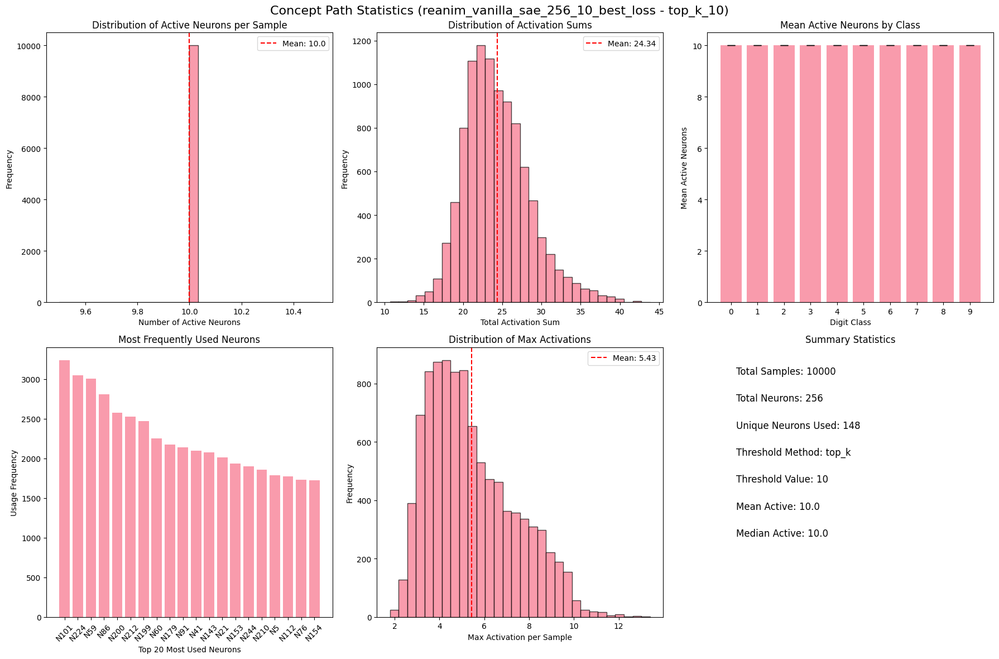

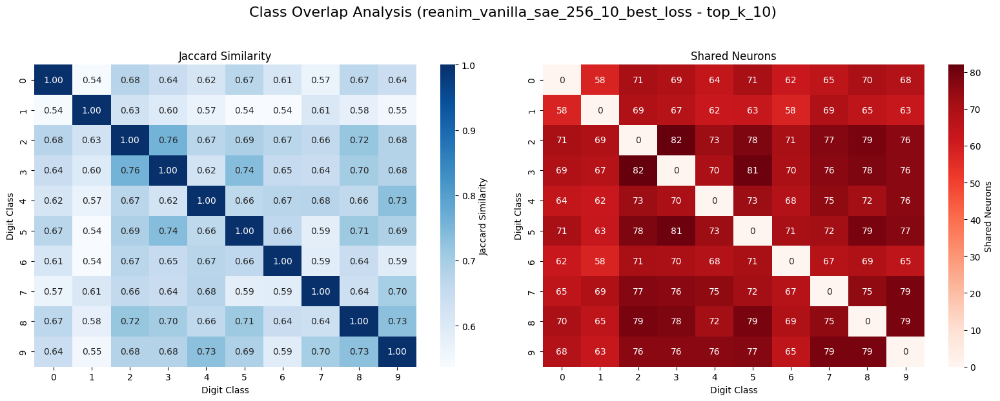

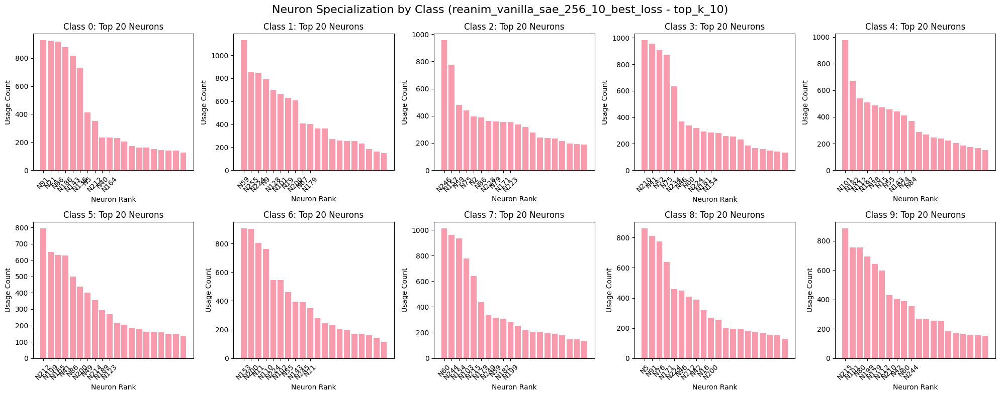


--- Analyzing config: top_k_20 ---


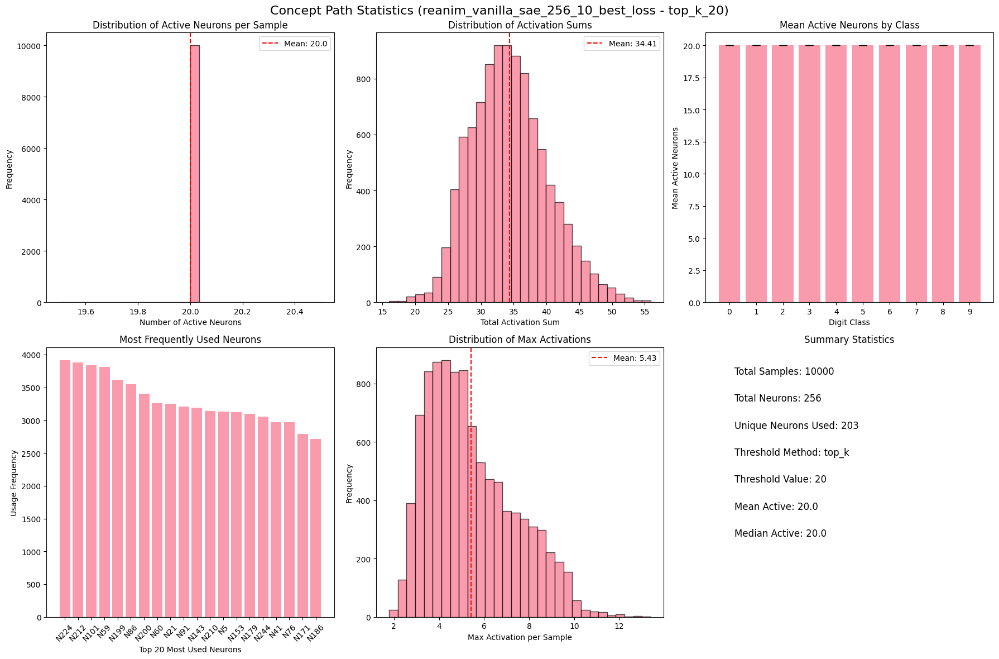

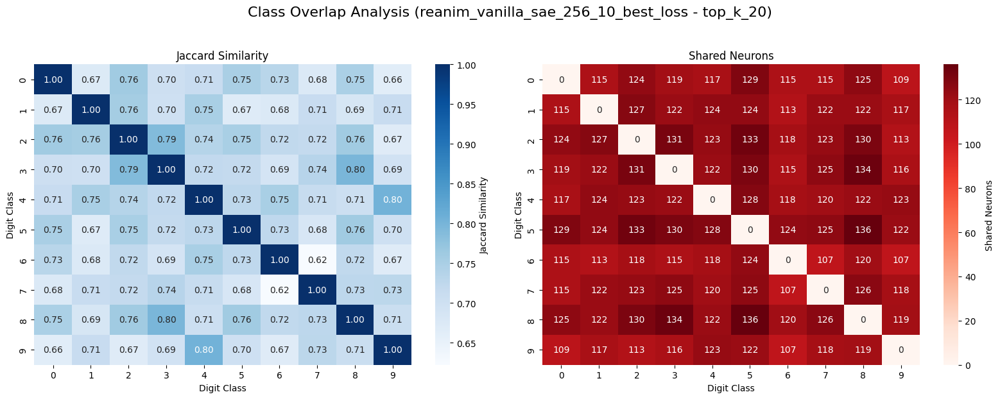

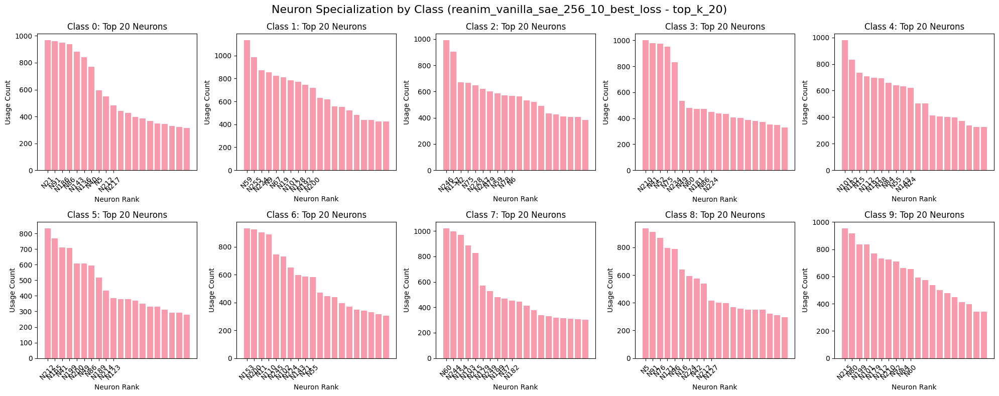


--- Analyzing config: percentile_90 ---


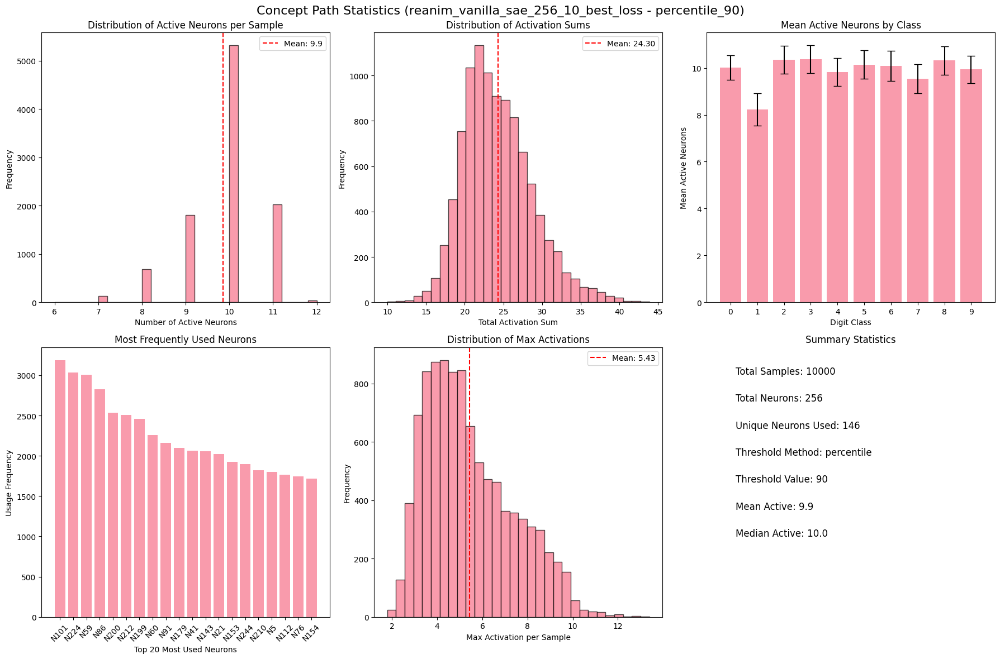

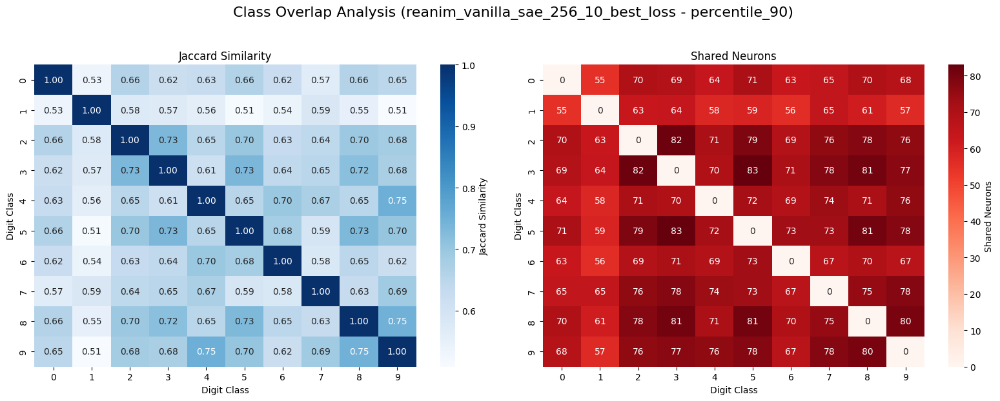

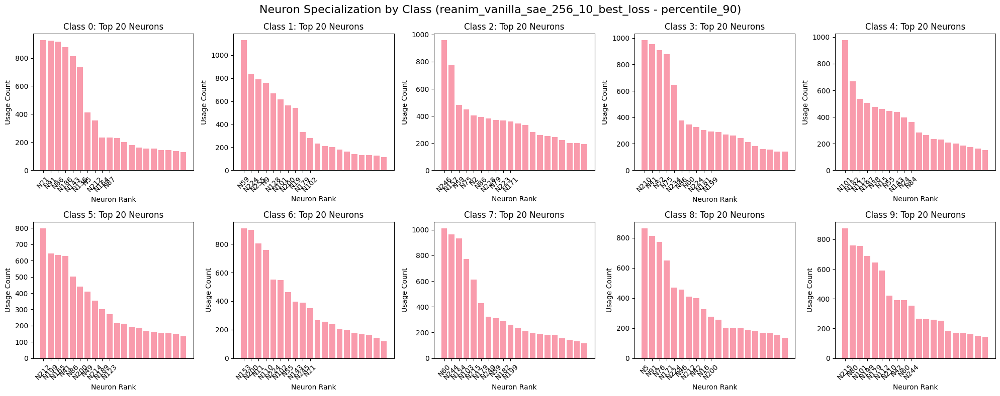


--- Analyzing config: std_threshold_1.5 ---


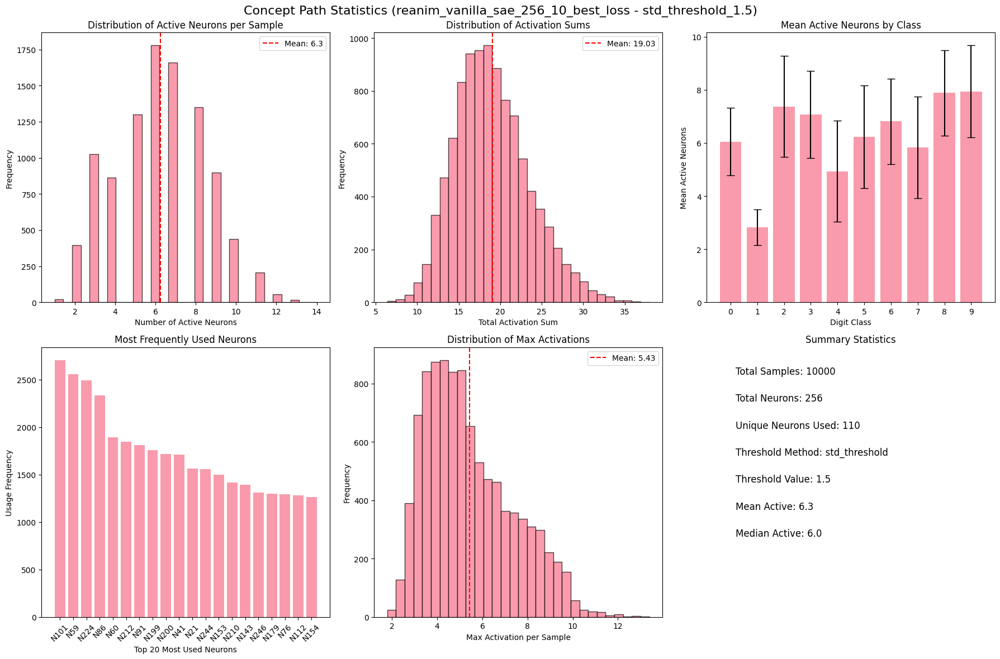

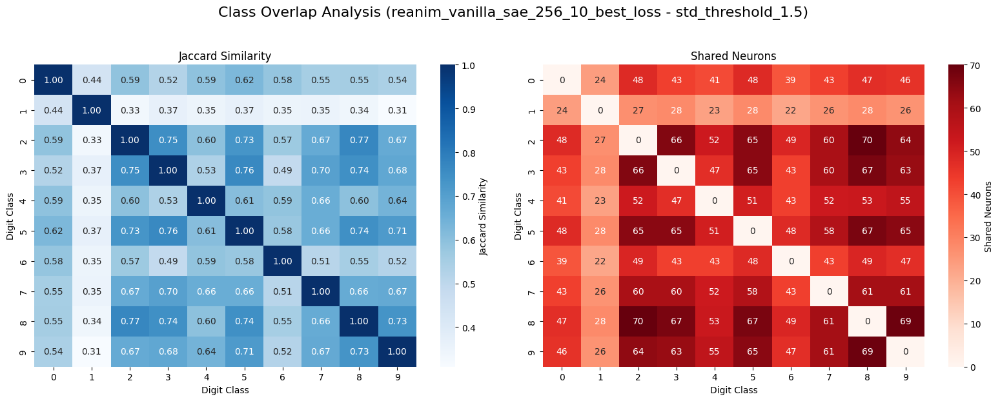

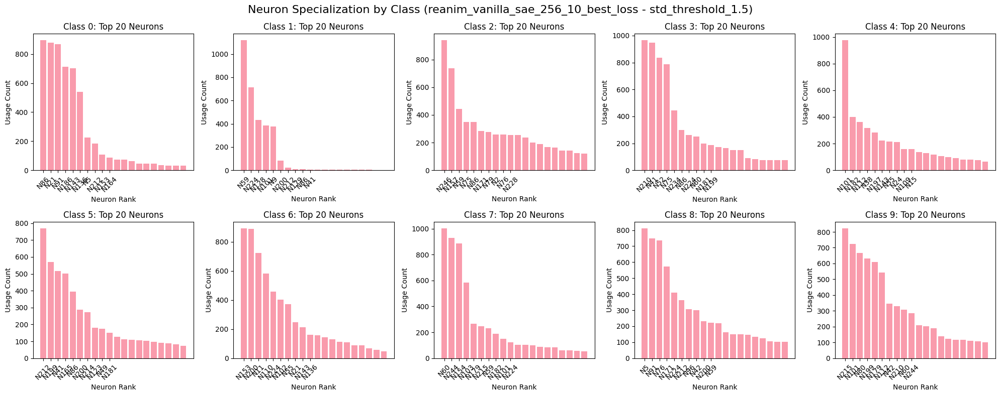


--- Comparing extraction methods for reanim_vanilla_sae_256_10_best_loss ---


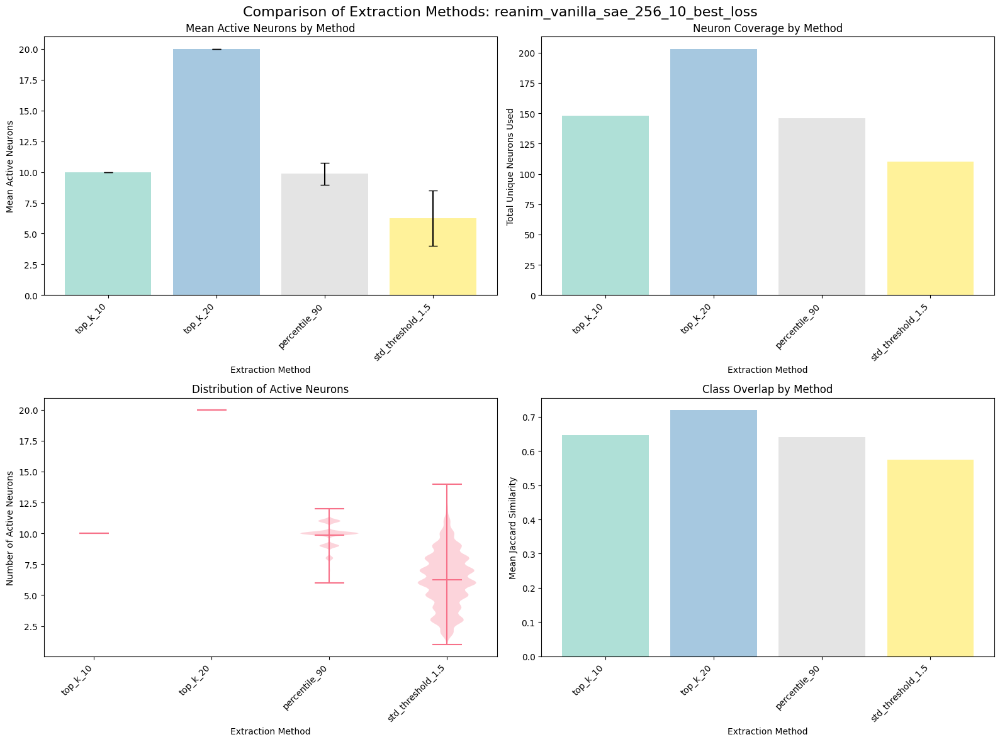


--- Summary across all SAEs (parsing parameters) ---

--- Parsed Summary DataFrame Head ---
                                   SAE    Config Training_Type  Dict_Size  \
12  reanim_vanilla_sae_256_0_best_loss  top_k_20        reanim        256   
11  reanim_vanilla_sae_256_1_best_loss  top_k_20        reanim        256   
39  reanim_vanilla_sae_256_2_best_loss  top_k_20        reanim        256   
95  reanim_vanilla_sae_256_3_best_loss  top_k_20        reanim        256   
94  reanim_vanilla_sae_256_4_best_loss  top_k_20        reanim        256   

    Penalty  Mean_Active  Unique_Neurons  Total_Neurons  Coverage  \
12        0         20.0             187            256  0.730469   
11        1         20.0             189            256  0.738281   
39        2         20.0             184            256  0.718750   
95        3         20.0             183            256  0.714844   
94        4         20.0             189            256  0.738281   

    Mean_Shared_Neurons  Mean

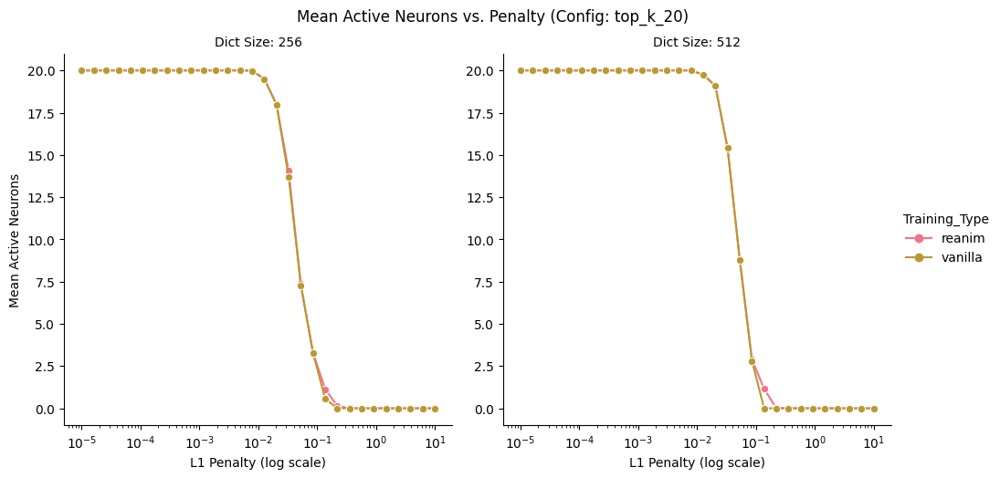


Plotting Neuron Coverage vs. Penalty...


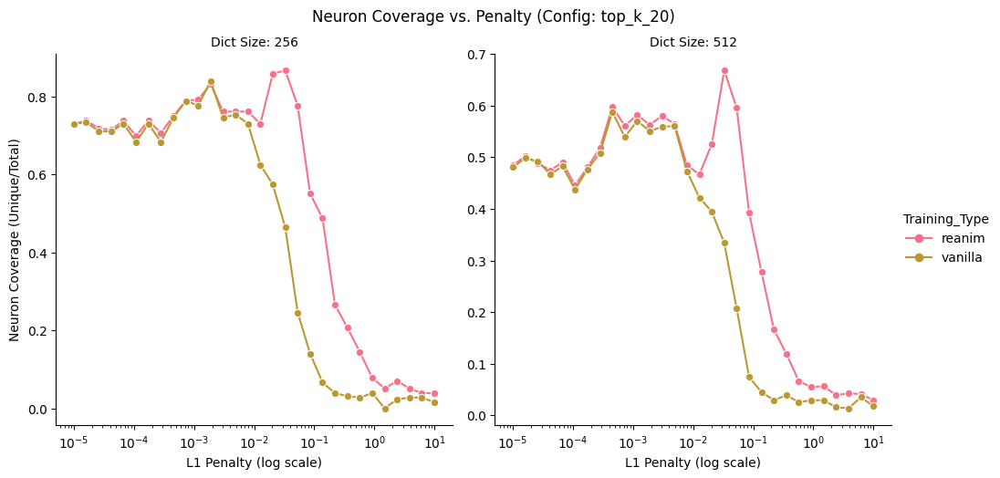


Plotting Mean Shared Neurons vs. Penalty...


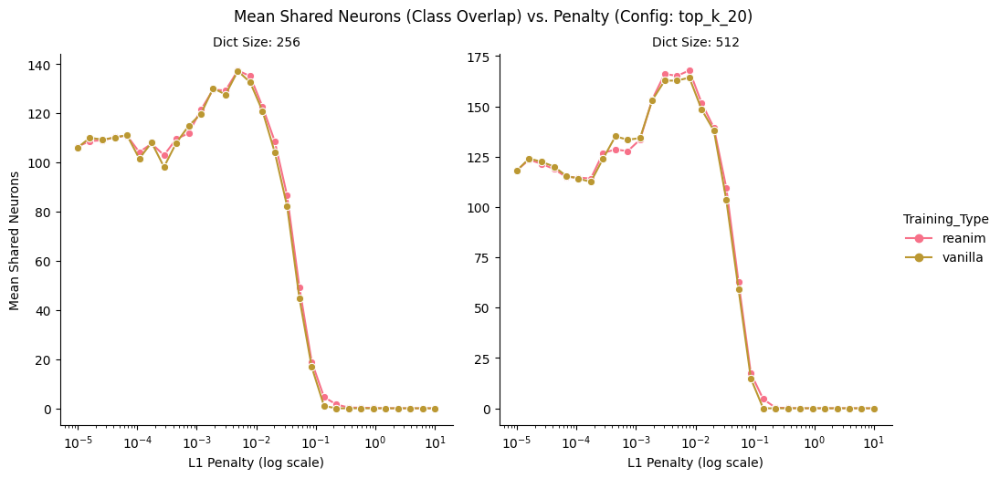


--- Class Overlap Heatmap Evolution vs. Penalty ---
Generating heatmaps for: Training=vanilla, Dict Size=512, Config=top_k_20
Found 30 SAEs. Plotting heatmaps...

Plotting for: vanilla_sae_512_0_best_loss (Penalty Index: 0, L1: 1e-05)


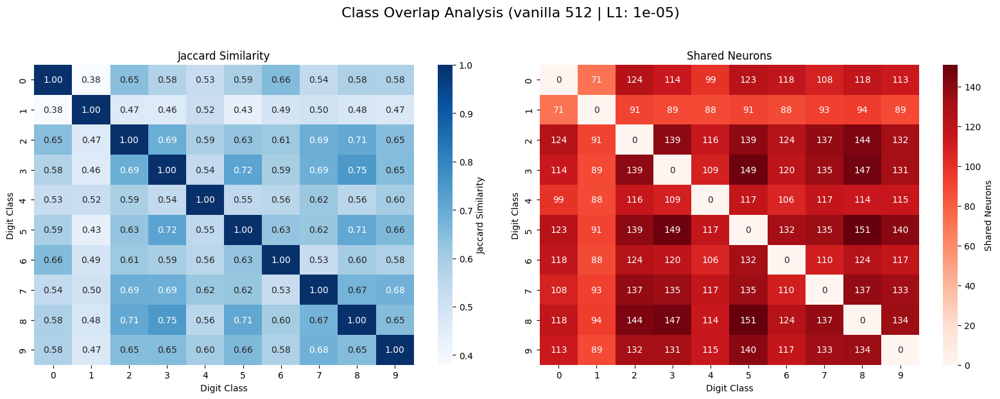


Plotting for: vanilla_sae_512_1_best_loss (Penalty Index: 1, L1: 1.6e-05)


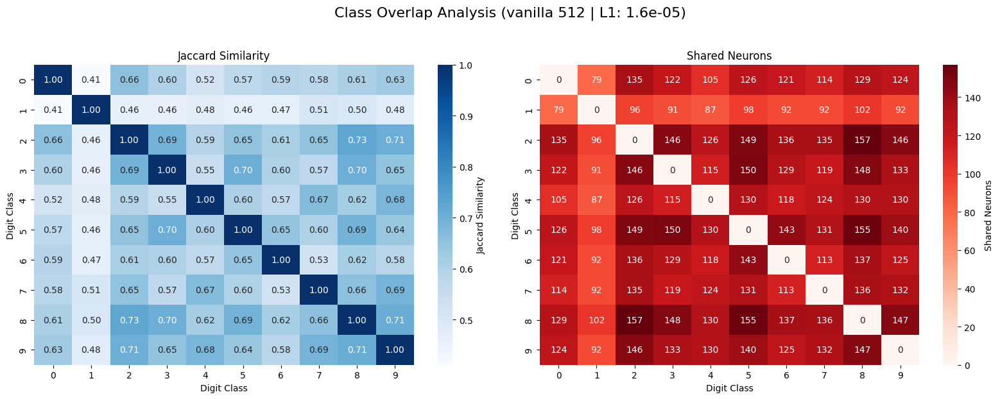


Plotting for: vanilla_sae_512_2_best_loss (Penalty Index: 2, L1: 2.6e-05)


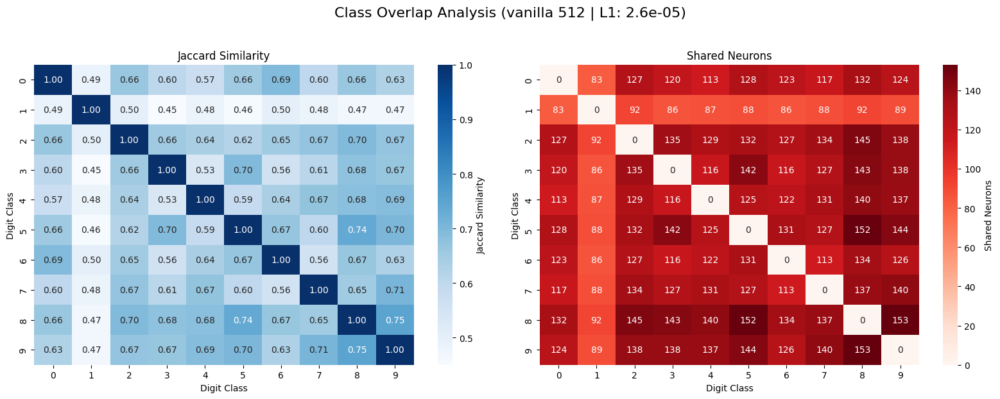


Plotting for: vanilla_sae_512_3_best_loss (Penalty Index: 3, L1: 4.2e-05)


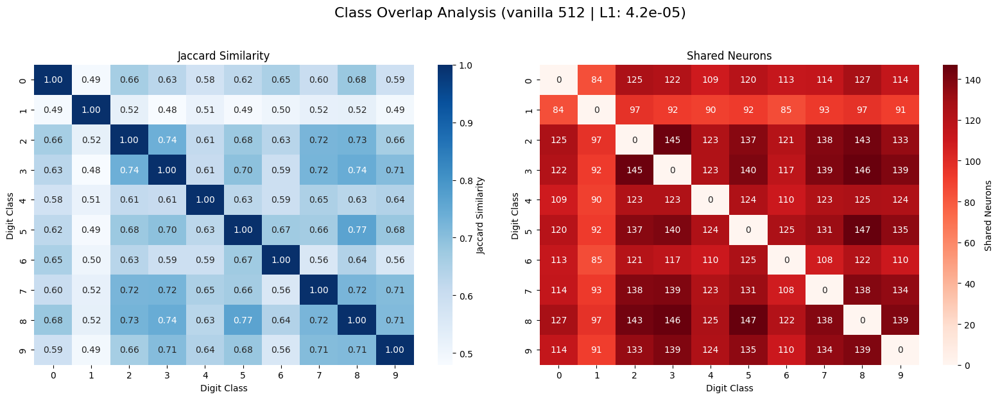


Plotting for: vanilla_sae_512_4_best_loss (Penalty Index: 4, L1: 6.7e-05)


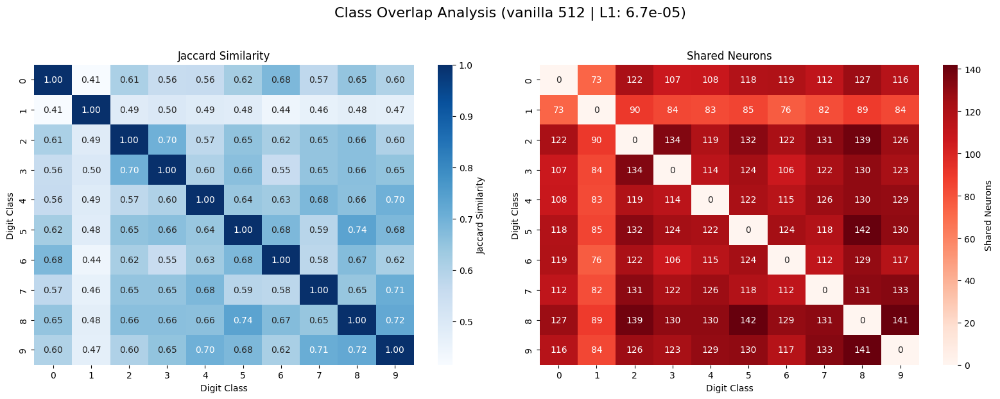


Plotting for: vanilla_sae_512_5_best_loss (Penalty Index: 5, L1: 0.000108)


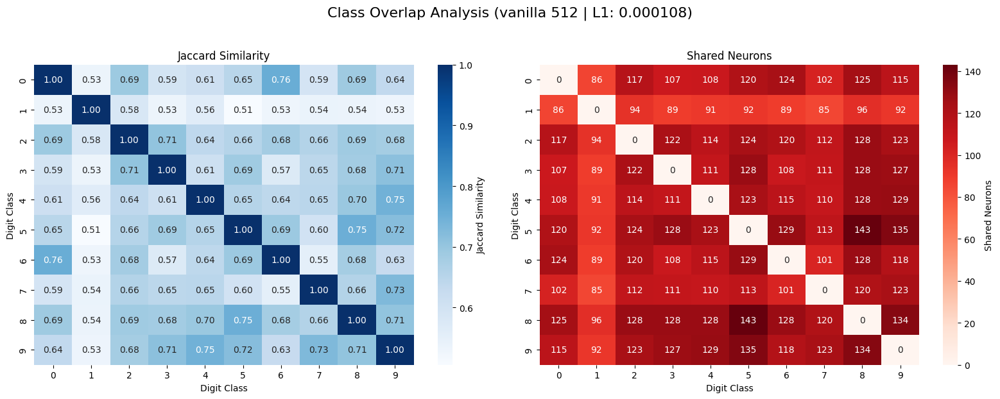


Plotting for: vanilla_sae_512_6_best_loss (Penalty Index: 6, L1: 0.000174)


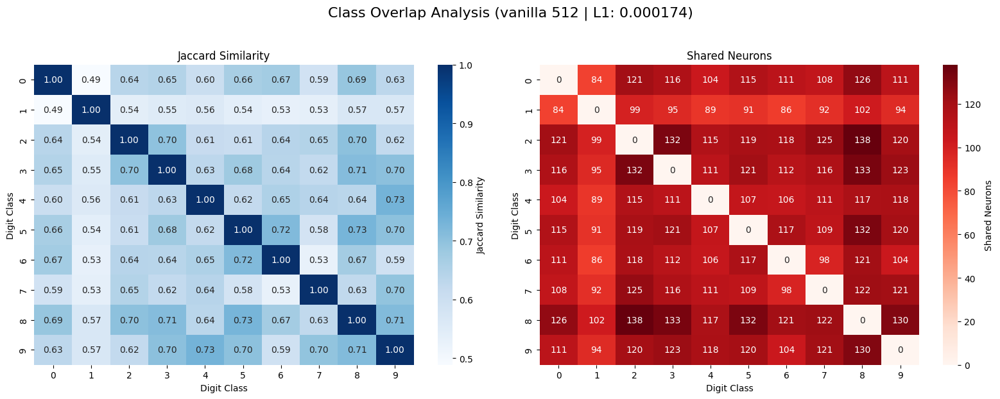


Plotting for: vanilla_sae_512_7_best_loss (Penalty Index: 7, L1: 0.000281)


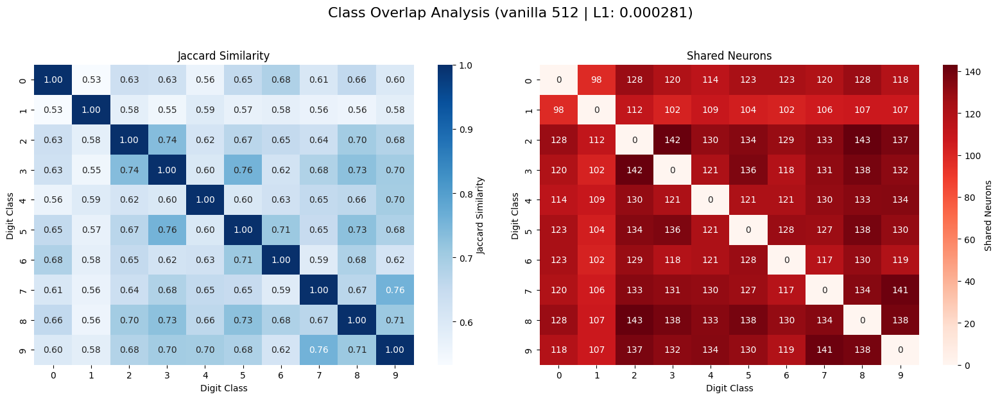


Plotting for: vanilla_sae_512_8_best_loss (Penalty Index: 8, L1: 0.000452)


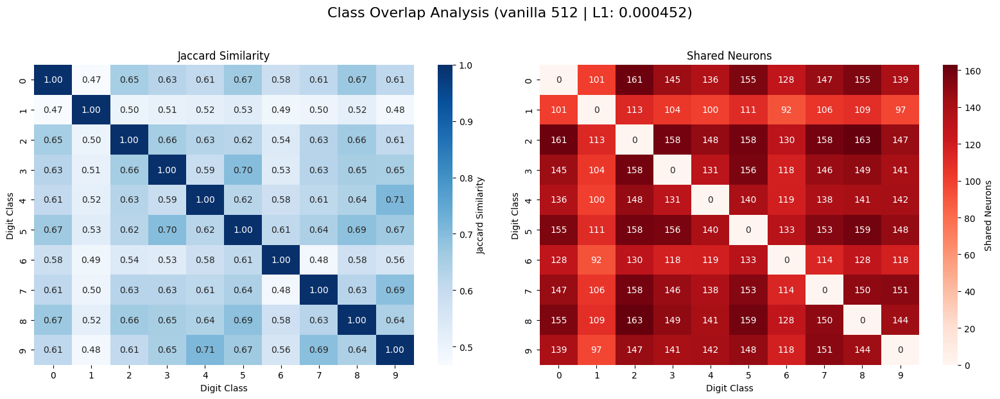


Plotting for: vanilla_sae_512_9_best_loss (Penalty Index: 9, L1: 0.000728)


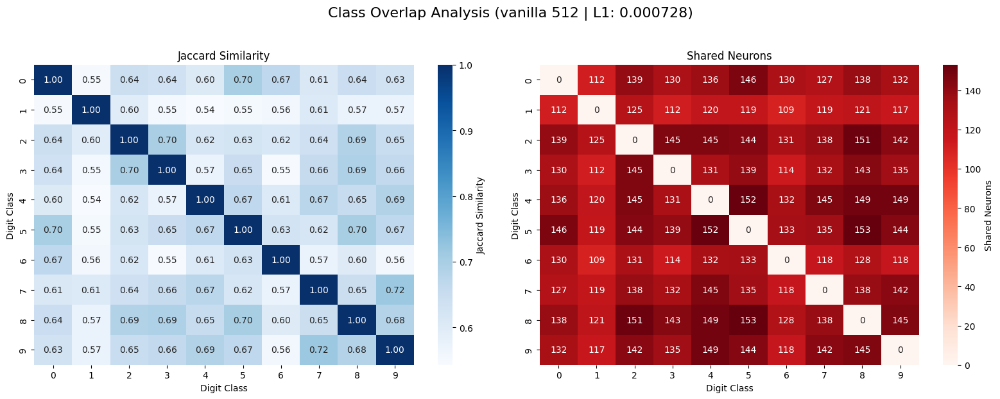


Plotting for: vanilla_sae_512_10_best_loss (Penalty Index: 10, L1: 0.001172)


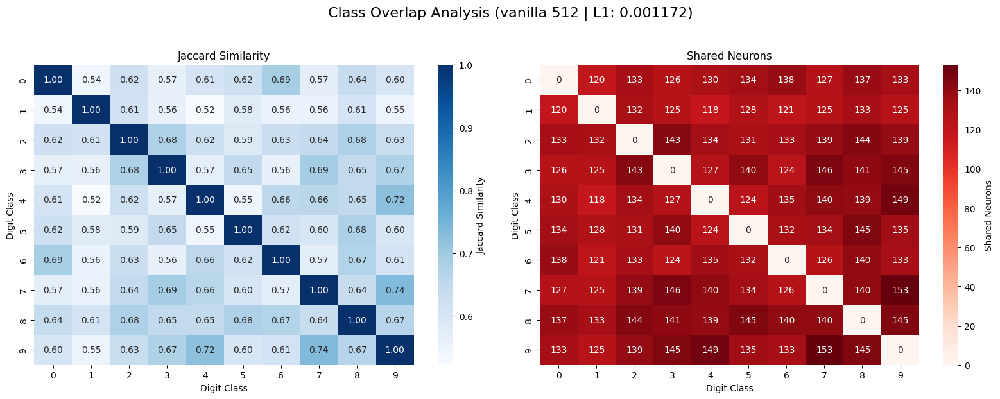


Plotting for: vanilla_sae_512_11_best_loss (Penalty Index: 11, L1: 0.001887)


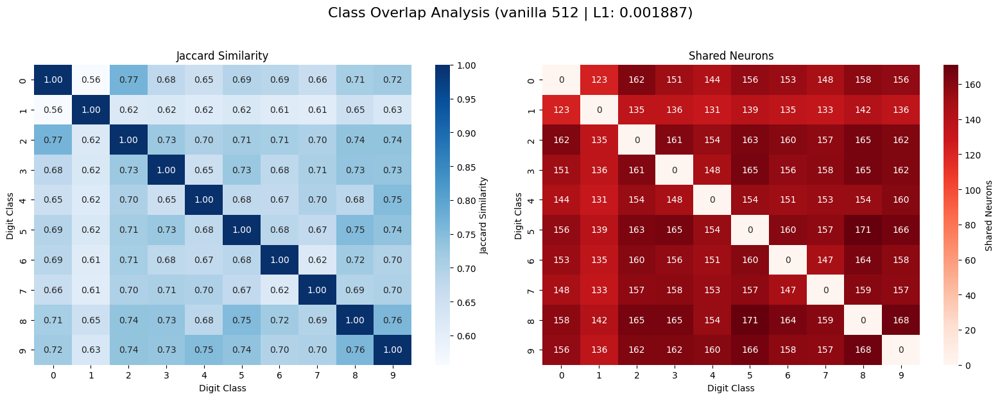


Plotting for: vanilla_sae_512_12_best_loss (Penalty Index: 12, L1: 0.003039)


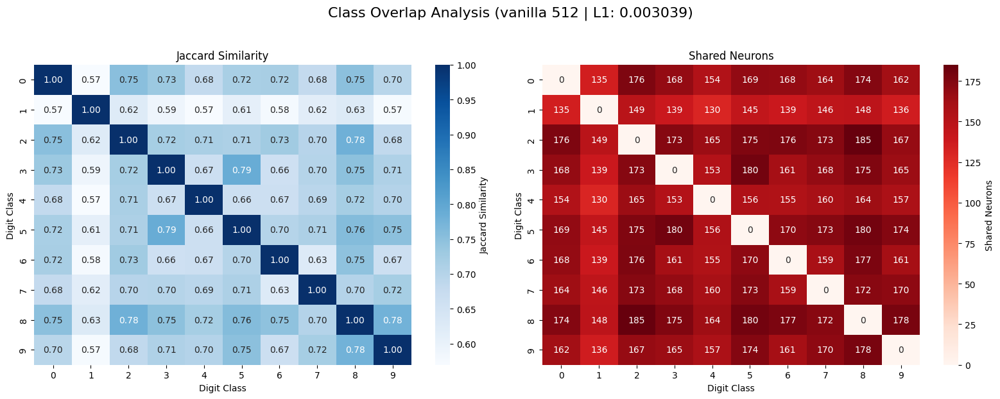


Plotting for: vanilla_sae_512_13_best_loss (Penalty Index: 13, L1: 0.004894)


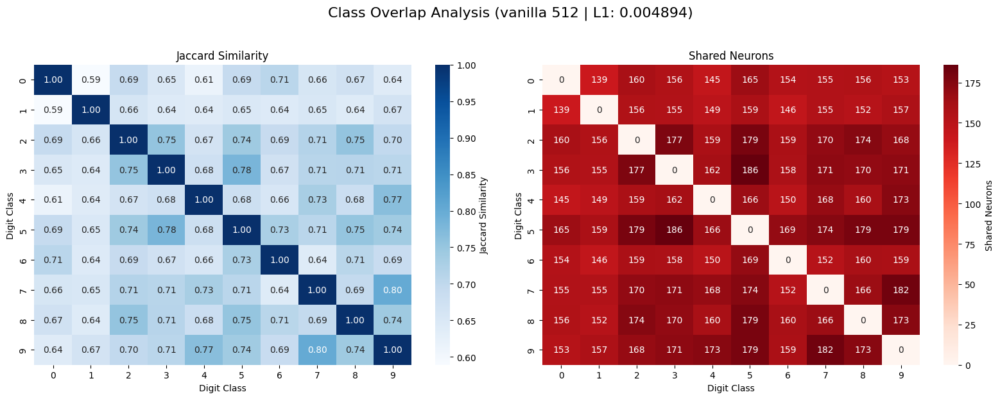


Plotting for: vanilla_sae_512_14_best_loss (Penalty Index: 14, L1: 0.00788)


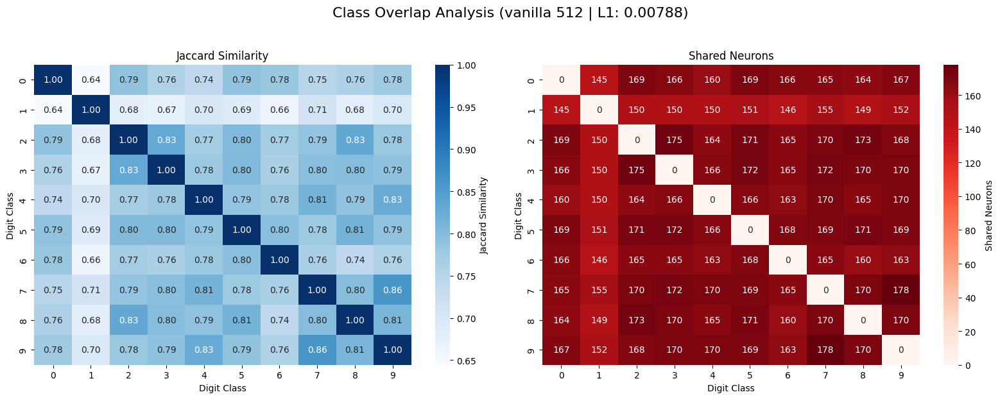


Plotting for: vanilla_sae_512_15_best_loss (Penalty Index: 15, L1: 0.01269)


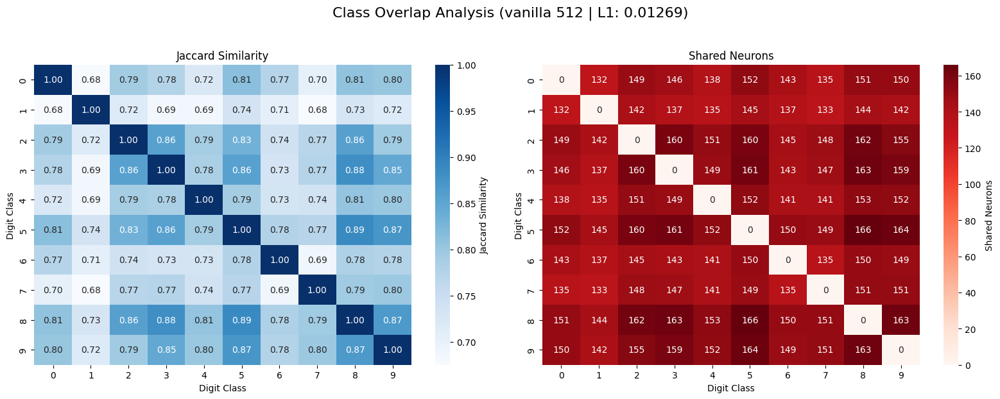


Plotting for: vanilla_sae_512_16_best_loss (Penalty Index: 16, L1: 0.020434)


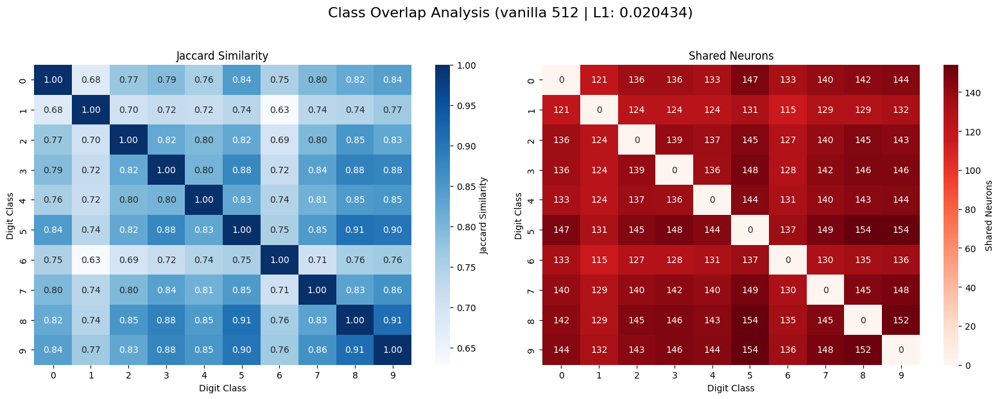


Plotting for: vanilla_sae_512_17_best_loss (Penalty Index: 17, L1: 0.032903)


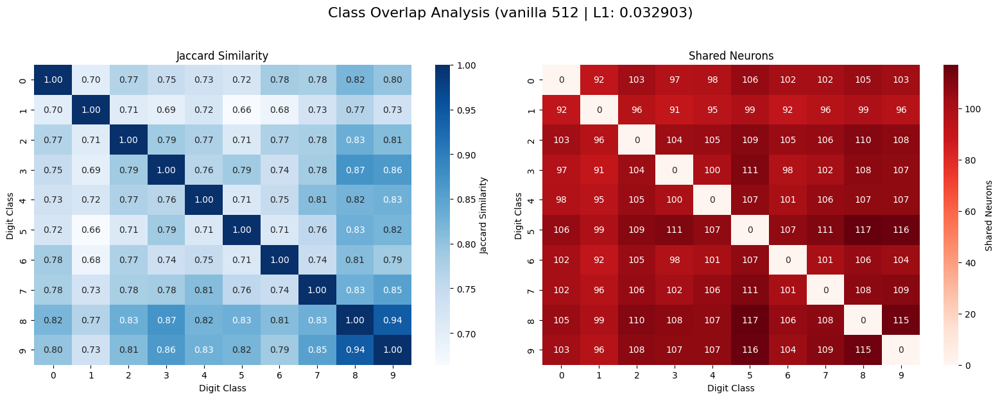


Plotting for: vanilla_sae_512_18_best_loss (Penalty Index: 18, L1: 0.052983)


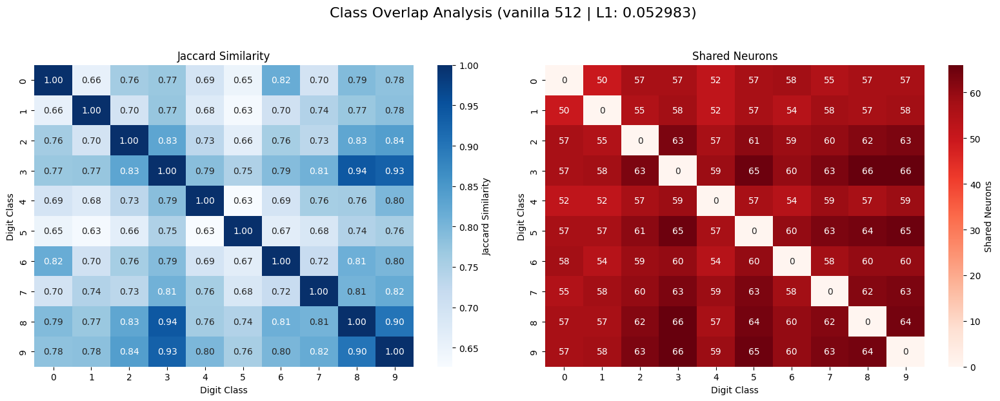


Plotting for: vanilla_sae_512_19_best_loss (Penalty Index: 19, L1: 0.085317)


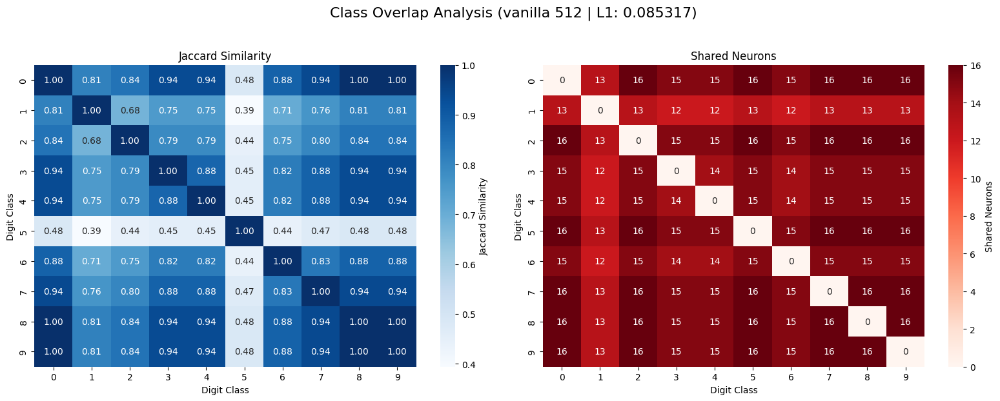


Plotting for: vanilla_sae_512_20_best_loss (Penalty Index: 20, L1: 0.137382)


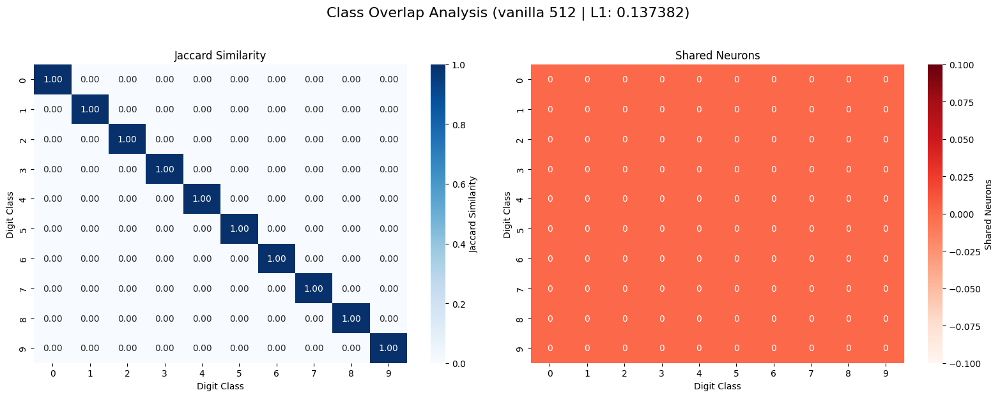


Plotting for: vanilla_sae_512_21_best_loss (Penalty Index: 21, L1: 0.221222)


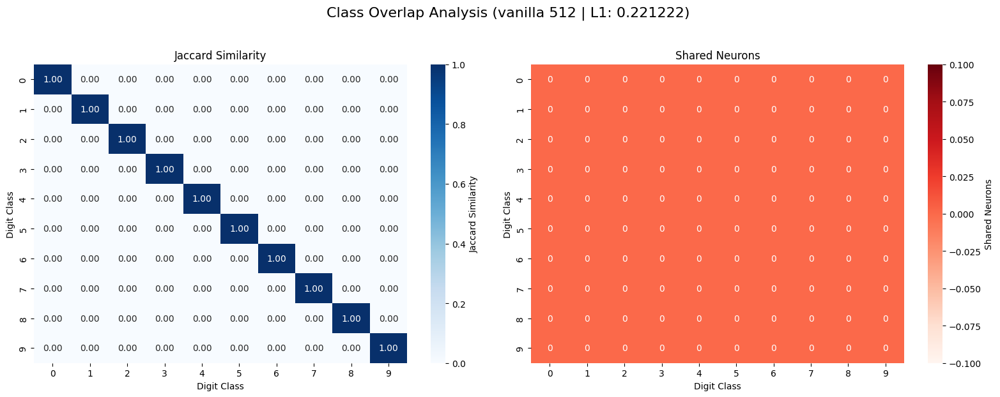


Plotting for: vanilla_sae_512_22_best_loss (Penalty Index: 22, L1: 0.356225)


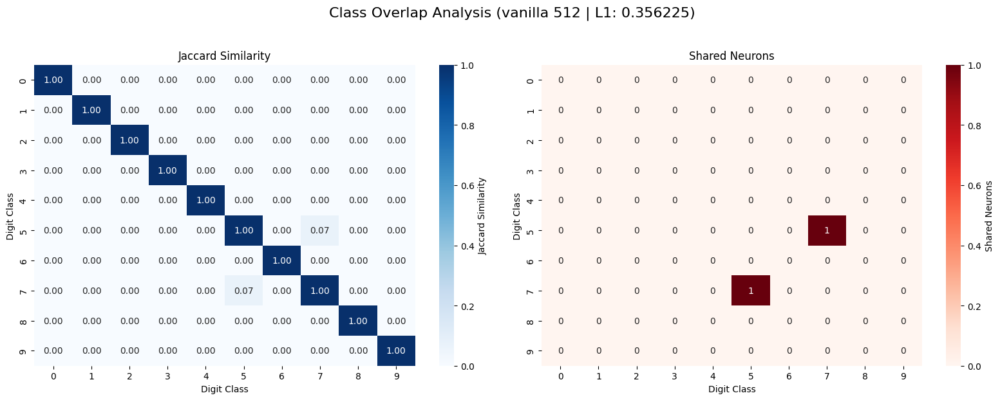


Plotting for: vanilla_sae_512_23_best_loss (Penalty Index: 23, L1: 0.573615)


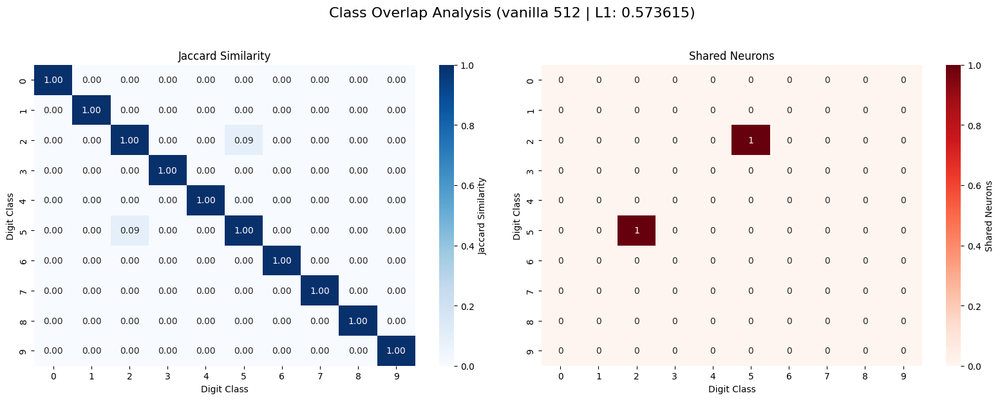


Plotting for: vanilla_sae_512_24_best_loss (Penalty Index: 24, L1: 0.923671)


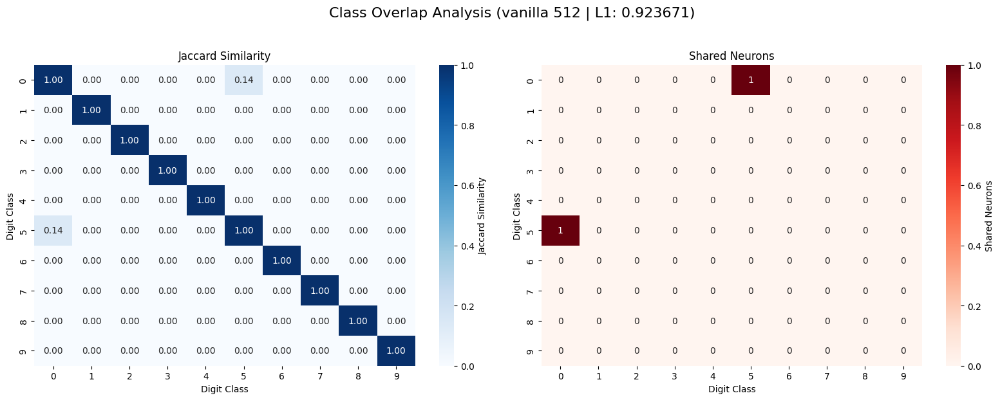


Plotting for: vanilla_sae_512_25_best_loss (Penalty Index: 25, L1: 1.487352)


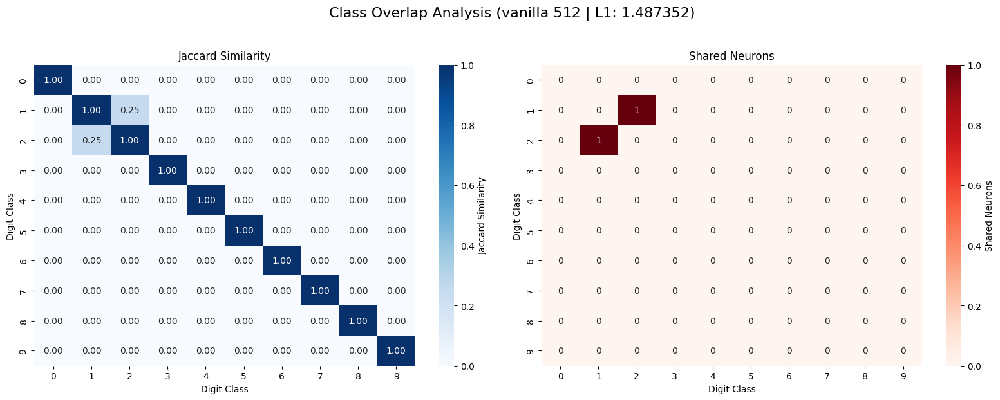


Plotting for: vanilla_sae_512_26_best_loss (Penalty Index: 26, L1: 2.395027)


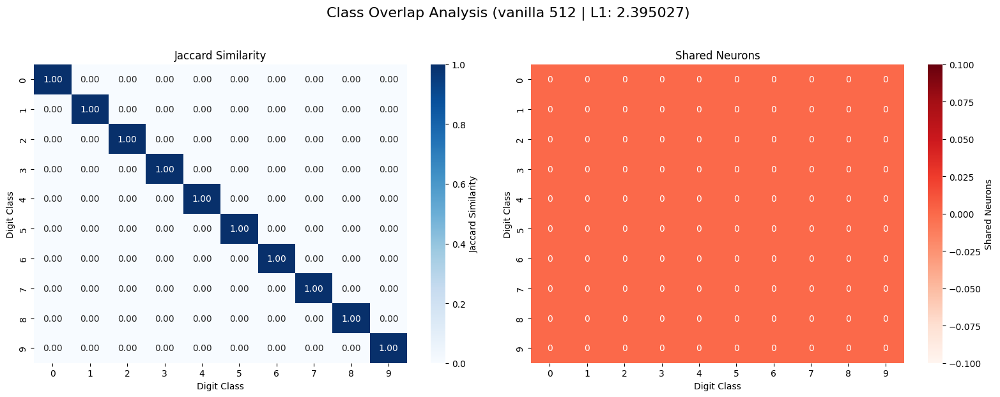


Plotting for: vanilla_sae_512_27_best_loss (Penalty Index: 27, L1: 3.85662)


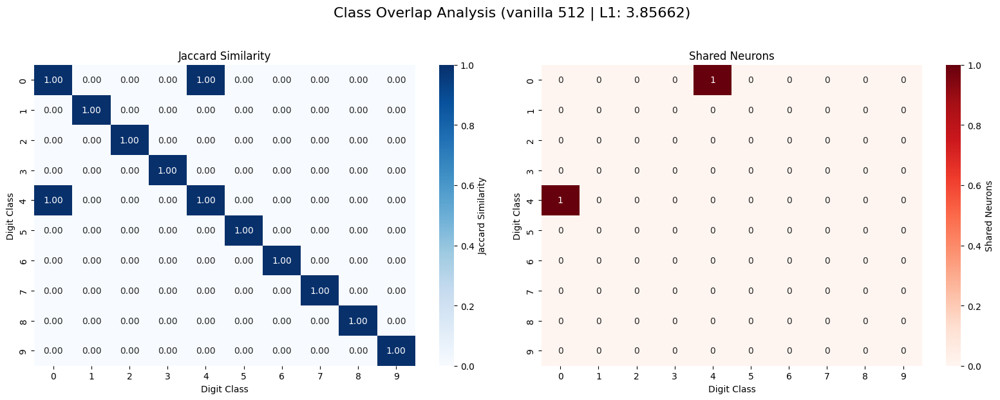


Plotting for: vanilla_sae_512_28_best_loss (Penalty Index: 28, L1: 6.210169)


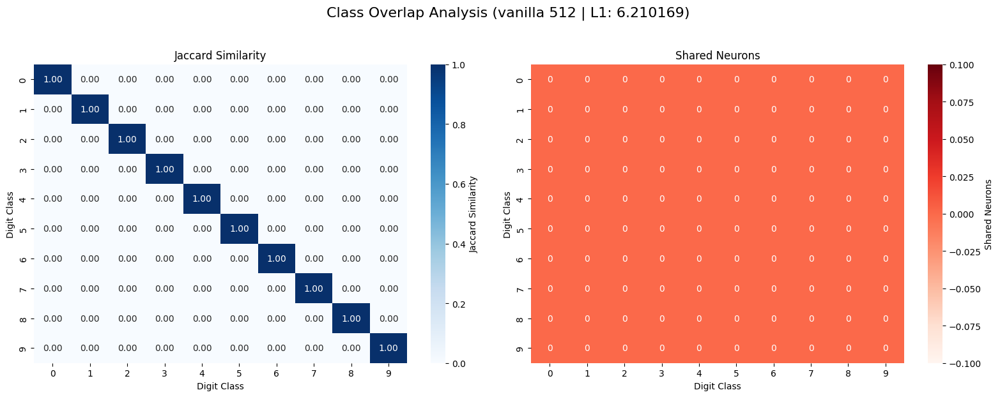


Plotting for: vanilla_sae_512_29_best_loss (Penalty Index: 29, L1: 10.0)


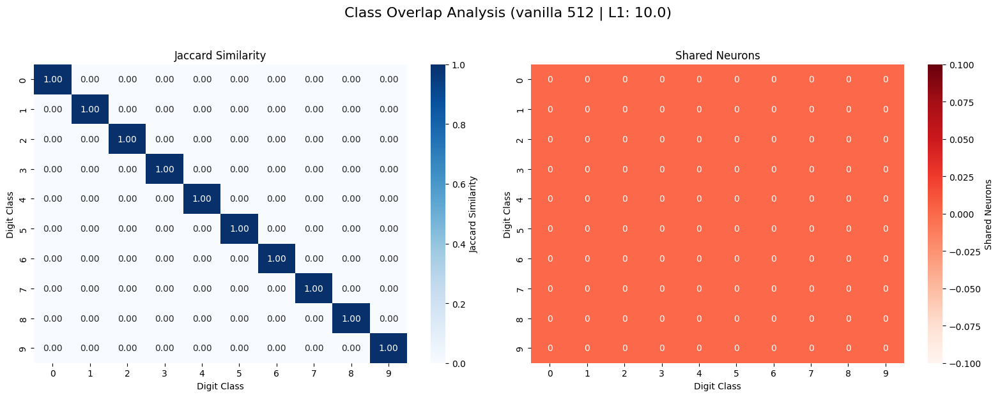


Summary Table (Config: top_k_20):
                                    SAE    Config Training_Type  Dict_Size  \
12   reanim_vanilla_sae_256_0_best_loss  top_k_20        reanim        256   
11   reanim_vanilla_sae_256_1_best_loss  top_k_20        reanim        256   
39   reanim_vanilla_sae_256_2_best_loss  top_k_20        reanim        256   
95   reanim_vanilla_sae_256_3_best_loss  top_k_20        reanim        256   
94   reanim_vanilla_sae_256_4_best_loss  top_k_20        reanim        256   
..                                  ...       ...           ...        ...   
99         vanilla_sae_512_25_best_loss  top_k_20       vanilla        512   
33         vanilla_sae_512_26_best_loss  top_k_20       vanilla        512   
1          vanilla_sae_512_27_best_loss  top_k_20       vanilla        512   
112        vanilla_sae_512_28_best_loss  top_k_20       vanilla        512   
10         vanilla_sae_512_29_best_loss  top_k_20       vanilla        512   

     Penalty  Mean_Active  U

In [18]:
# ===== CONCEPT PATHS VISUALIZATION =====
# Run this cell to visualize concept paths from your SAE analysis

import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import defaultdict, Counter
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import networkx as nx

# Set plotting style
plt.style.use('default')
sns.set_palette("husl")

concept_paths_file = '../logs/mnist_activation/Seed1/vanilla_sae/new_concept_path_results.pkl'


try:
    with open(concept_paths_file, 'rb') as f:
        all_concept_paths = pickle.load(f)
    print(f"Loaded concept paths for {len(all_concept_paths)} SAEs")
    
    # Display available SAEs and configs
    for sae_name, configs in all_concept_paths.items():
        print(f"\n{sae_name}: {list(configs.keys())}")
        
except FileNotFoundError:
    print(f"File not found: {concept_paths_file}")
    print("Please update the concept_paths_file path above")
    # Create dummy data for demonstration
    all_concept_paths = {}

# ===== HELPER FUNCTIONS =====

def plot_concept_path_statistics(concept_paths_data, title_suffix=""):
    """Plot basic statistics about concept paths."""
    
    concept_paths = concept_paths_data['concept_paths']
    summary = concept_paths_data['summary']
    
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    fig.suptitle(f'Concept Path Statistics {title_suffix}', fontsize=16)
    
    num_active = [path['num_active'] for path in concept_paths]
    axes[0, 0].hist(num_active, bins=30, alpha=0.7, edgecolor='black')
    axes[0, 0].axvline(np.mean(num_active), color='red', linestyle='--', 
                       label=f'Mean: {np.mean(num_active):.1f}')
    axes[0, 0].set_xlabel('Number of Active Neurons')
    axes[0, 0].set_ylabel('Frequency')
    axes[0, 0].set_title('Distribution of Active Neurons per Sample')
    axes[0, 0].legend()
    
    # 2. Distribution of activation sums
    activation_sums = [path['activation_sum'] for path in concept_paths]
    axes[0, 1].hist(activation_sums, bins=30, alpha=0.7, edgecolor='black')
    axes[0, 1].axvline(np.mean(activation_sums), color='red', linestyle='--',
                       label=f'Mean: {np.mean(activation_sums):.2f}')
    axes[0, 1].set_xlabel('Total Activation Sum')
    axes[0, 1].set_ylabel('Frequency')
    axes[0, 1].set_title('Distribution of Activation Sums')
    axes[0, 1].legend()
    
    # 3. Per-class statistics (if labels available)
    if 'class_statistics' in summary:
        class_stats = summary['class_statistics']
        classes = sorted(class_stats.keys())
        
        class_means = [class_stats[c]['mean_active_neurons'] for c in classes]
        class_stds = [class_stats[c]['std_active_neurons'] for c in classes]
        
        axes[0, 2].bar(classes, class_means, yerr=class_stds, capsize=5, alpha=0.7)
        axes[0, 2].set_xlabel('Digit Class')
        axes[0, 2].set_ylabel('Mean Active Neurons')
        axes[0, 2].set_title('Mean Active Neurons by Class')
        axes[0, 2].set_xticks(classes)
    
    # 4. Neuron usage frequency
    all_neurons = []
    for path in concept_paths:
        all_neurons.extend(path['active_neurons'])
    
    neuron_counts = Counter(all_neurons)
    top_neurons = dict(sorted(neuron_counts.items(), key=lambda x: x[1], reverse=True)[:20])
    
    axes[1, 0].bar(range(len(top_neurons)), list(top_neurons.values()), alpha=0.7)
    axes[1, 0].set_xlabel('Top 20 Most Used Neurons')
    axes[1, 0].set_ylabel('Usage Frequency')
    axes[1, 0].set_title('Most Frequently Used Neurons')
    axes[1, 0].set_xticks(range(len(top_neurons)))
    axes[1, 0].set_xticklabels([f'N{k}' for k in top_neurons.keys()], rotation=45)
    
    # 5. Max activation distribution
    max_activations = [path['max_activation'] for path in concept_paths]
    axes[1, 1].hist(max_activations, bins=30, alpha=0.7, edgecolor='black')
    axes[1, 1].axvline(np.mean(max_activations), color='red', linestyle='--',
                       label=f'Mean: {np.mean(max_activations):.2f}')
    axes[1, 1].set_xlabel('Max Activation per Sample')
    axes[1, 1].set_ylabel('Frequency')
    axes[1, 1].set_title('Distribution of Max Activations')
    axes[1, 1].legend()
    
    # 6. Summary text
    axes[1, 2].text(0.1, 0.9, f"Total Samples: {summary['n_samples']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.8, f"Total Neurons: {summary['n_neurons']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.7, f"Unique Neurons Used: {summary['total_unique_neurons_used']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.6, f"Threshold Method: {summary['threshold_method']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.5, f"Threshold Value: {summary['threshold_value']}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.4, f"Mean Active: {summary['mean_active_neurons']:.1f}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].text(0.1, 0.3, f"Median Active: {summary['median_active_neurons']:.1f}", transform=axes[1, 2].transAxes, fontsize=12)
    axes[1, 2].set_xlim(0, 1)
    axes[1, 2].set_ylim(0, 1)
    axes[1, 2].set_title('Summary Statistics')
    axes[1, 2].axis('off')
    
    plt.tight_layout()
    plt.show()

def plot_class_overlap_heatmap(concept_paths_data, title_suffix=""):
    """Plot heatmap of class overlaps."""
    
    if 'overlap_analysis' not in concept_paths_data:
        print(f"No overlap analysis found in concept paths data for {title_suffix}")
        return
    
    overlap_data = concept_paths_data['overlap_analysis'].get('overlap_analysis')
    if not overlap_data:
        print(f"No 'overlap_analysis' sub-key found for {title_suffix}")
        return
    
    # Extract classes from overlap keys
    classes = set()
    for key in overlap_data.keys():
        parts = key.split('_')
        try:
            classes.add(int(parts[1]))
            classes.add(int(parts[3]))
        except (IndexError, ValueError):
            print(f"Warning: Could not parse class from overlap key: {key}")
            continue
    classes = sorted(classes)
    if not classes:
        print("Warning: No valid classes found for overlap heatmap.")
        return

    # Create matrices for different overlap metrics
    jaccard_matrix = np.zeros((len(classes), len(classes)))
    shared_neurons_matrix = np.zeros((len(classes), len(classes)))
    
    for key, data in overlap_data.items():
        parts = key.split('_')
        try:
            i, j = int(parts[1]), int(parts[3])
            i_idx, j_idx = classes.index(i), classes.index(j)
            
            jaccard_matrix[i_idx, j_idx] = data['jaccard_similarity']
            jaccard_matrix[j_idx, i_idx] = data['jaccard_similarity']  # Symmetric
            
            shared_neurons_matrix[i_idx, j_idx] = data['shared_neurons']
            shared_neurons_matrix[j_idx, i_idx] = data['shared_neurons']
        except (IndexError, ValueError, KeyError):
            continue # Skip if key is malformed or data is missing
    
    # Set diagonal to 1 for Jaccard (self-similarity)
    np.fill_diagonal(jaccard_matrix, 1.0)
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))
    fig.suptitle(f'Class Overlap Analysis {title_suffix}', fontsize=16, y=1.03)
    
    # Jaccard similarity heatmap
    sns.heatmap(jaccard_matrix, 
                xticklabels=classes, yticklabels=classes,
                annot=True, fmt='.2f', cmap='Blues',
                ax=ax1, cbar_kws={'label': 'Jaccard Similarity'})
    ax1.set_title(f'Jaccard Similarity')
    ax1.set_xlabel('Digit Class')
    ax1.set_ylabel('Digit Class')
    
    # Shared neurons heatmap
    sns.heatmap(shared_neurons_matrix,
                xticklabels=classes, yticklabels=classes,
                annot=True, fmt='.0f', cmap='Reds',
                ax=ax2, cbar_kws={'label': 'Shared Neurons'})
    ax2.set_title(f'Shared Neurons')
    ax2.set_xlabel('Digit Class')
    ax2.set_ylabel('Digit Class')
    
    plt.tight_layout()
    plt.show()

def plot_neuron_class_specialization(concept_paths_data, top_n=20, title_suffix=""):
    """Plot which neurons are most specialized for each class."""
    
    concept_paths = concept_paths_data['concept_paths']
    summary = concept_paths_data['summary']
    
    if 'class_statistics' not in summary:
        print("No class statistics available")
        return
    
    # Count neuron usage per class
    class_neuron_usage = defaultdict(lambda: defaultdict(int))
    
    for path in concept_paths:
        if 'label' in path:
            label = path['label']
            for neuron_idx in path['active_neurons']:
                class_neuron_usage[label][neuron_idx] += 1
    
    # Find most specialized neurons for each class
    classes = sorted(class_neuron_usage.keys())
    n_classes = len(classes)
    
    # Adjust subplot grid if there are fewer than 10 classes (e.g., MNIST)
    n_cols = 5
    n_rows = int(np.ceil(n_classes / n_cols))
    if n_rows == 0: n_rows = 1
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 4 * n_rows))
    axes = axes.flatten()
    
    for i, class_label in enumerate(classes):
        if i >= len(axes):
            break
            
        neuron_counts = class_neuron_usage[class_label]
        
        # Get top neurons for this class
        top_neurons = sorted(neuron_counts.items(), key=lambda x: x[1], reverse=True)[:top_n]
        
        if not top_neurons:
            axes[i].text(0.5, 0.5, 'No active neurons', ha='center', va='center', transform=axes[i].transAxes)
            axes[i].set_title(f'Class {class_label}: Top {top_n} Neurons')
            continue
            
        neurons, counts = zip(*top_neurons)
        
        axes[i].bar(range(len(neurons)), counts, alpha=0.7)
        axes[i].set_title(f'Class {class_label}: Top {top_n} Neurons')
        axes[i].set_xlabel('Neuron Rank')
        axes[i].set_ylabel('Usage Count')
        axes[i].set_xticks(range(min(10, len(neurons))))
        axes[i].set_xticklabels([f'N{n}' for n in neurons[:10]], rotation=45)
    
    # Hide unused subplots
    for j in range(i + 1, len(axes)):
        axes[j].set_visible(False)
    
    fig.suptitle(f'Neuron Specialization by Class {title_suffix}', fontsize=16)
    plt.tight_layout()
    plt.show()

def compare_extraction_methods(sae_concept_paths, sae_name):
    """Compare different concept path extraction methods for the same SAE."""
    
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    fig.suptitle(f'Comparison of Extraction Methods: {sae_name}', fontsize=16)
    
    methods = list(sae_concept_paths.keys())
    if not methods:
        print("No extraction methods to compare.")
        plt.close(fig)
        return
        
    colors = plt.cm.Set3(np.linspace(0, 1, len(methods)))
    
    # 1. Mean active neurons comparison
    method_names = []
    mean_active = []
    std_active = []
    
    for method in methods:
        data = sae_concept_paths.get(method, {})
        if 'summary' not in data: continue
        summary = data['summary']
        method_names.append(method)
        mean_active.append(summary.get('mean_active_neurons', np.nan))
        std_active.append(summary.get('std_active_neurons', np.nan))
    
    if not method_names:
         print("No valid summary data for method comparison.")
         plt.close(fig)
         return

    bars = axes[0, 0].bar(range(len(method_names)), mean_active, 
                           yerr=std_active, capsize=5, alpha=0.7, color=colors)
    axes[0, 0].set_xlabel('Extraction Method')
    axes[0, 0].set_ylabel('Mean Active Neurons')
    axes[0, 0].set_title('Mean Active Neurons by Method')
    axes[0, 0].set_xticks(range(len(method_names)))
    axes[0, 0].set_xticklabels(method_names, rotation=45, ha='right')
    
    # 2. Total unique neurons used
    unique_neurons = [sae_concept_paths[method]['summary'].get('total_unique_neurons_used', np.nan)
                       for method in method_names]
    
    axes[0, 1].bar(range(len(method_names)), unique_neurons, alpha=0.7, color=colors)
    axes[0, 1].set_xlabel('Extraction Method')
    axes[0, 1].set_ylabel('Total Unique Neurons Used')
    axes[0, 1].set_title('Neuron Coverage by Method')
    axes[0, 1].set_xticks(range(len(method_names)))
    axes[0, 1].set_xticklabels(method_names, rotation=45, ha='right')
    
    # 3. Distribution of active neurons (violin plot)
    all_num_active = []
    method_labels = []
    
    for method in method_names:
        concept_paths = sae_concept_paths[method].get('concept_paths', [])
        num_active = [path['num_active'] for path in concept_paths]
        all_num_active.extend(num_active)
        method_labels.extend([method] * len(num_active))
    
    if all_num_active:
        # Create dataframe for seaborn
        df = pd.DataFrame({'Method': method_labels, 'Active_Neurons': all_num_active})
        
        # Use matplotlib for violin plot
        method_data = [df[df['Method'] == method]['Active_Neurons'].values for method in method_names]
        
        parts = axes[1, 0].violinplot(method_data, positions=range(len(method_names)), showmeans=True)
        axes[1, 0].set_xlabel('Extraction Method')
        axes[1, 0].set_ylabel('Number of Active Neurons')
        axes[1, 0].set_title('Distribution of Active Neurons')
        axes[1, 0].set_xticks(range(len(method_names)))
        axes[1, 0].set_xticklabels(method_names, rotation=45, ha='right')
    else:
        axes[1, 0].text(0.5, 0.5, 'No activation data available', 
                          ha='center', va='center', transform=axes[1, 0].transAxes)
        axes[1, 0].set_title('Distribution of Active Neurons')

    
    # 4. Mean overlap between classes (if available)
    mean_overlaps = []
    for method in method_names:
        overlap_data = sae_concept_paths[method].get('overlap_analysis', {})
        summary = overlap_data.get('summary', {})
        mean_overlaps.append(summary.get('mean_jaccard', 0))
    
    if any(overlap > 0 for overlap in mean_overlaps):
        axes[1, 1].bar(range(len(method_names)), mean_overlaps, alpha=0.7, color=colors)
        axes[1, 1].set_xlabel('Extraction Method')
        axes[1, 1].set_ylabel('Mean Jaccard Similarity')
        axes[1, 1].set_title('Class Overlap by Method')
        axes[1, 1].set_xticks(range(len(method_names)))
        axes[1, 1].set_xticklabels(method_names, rotation=45, ha='right')
    else:
        axes[1, 1].text(0.5, 0.5, 'No overlap data available', 
                          ha='center', va='center', transform=axes[1, 1].transAxes)
        axes[1, 1].set_title('Class Overlap by Method')
    
    plt.tight_layout()
    plt.show()

# ===== MAIN VISUALIZATION CODE =====

if all_concept_paths:
    print("=== CONCEPT PATHS VISUALIZATION ===\n")
    
    # Select which SAE and config to visualize
    sae_names = list(all_concept_paths.keys())
    print("Available SAEs:")
    for i, name in enumerate(sae_names):
        print(f"{i}: {name}")
    
    # Visualize the first SAE (change index as needed)
    selected_sae_idx = 0
    if sae_names:
        selected_sae = sae_names[selected_sae_idx]
        
        print(f"\nVisualizing: {selected_sae}")
        
        # Get available configs for this SAE
        configs = list(all_concept_paths[selected_sae].keys())
        print(f"Available configs: {configs}")
        
        # Visualize each config
        for config in configs: 
            print(f"\n--- Analyzing config: {config} ---")
            concept_paths_data = all_concept_paths[selected_sae].get(config)
            if not concept_paths_data:
                print(f"No data for config {config}, skipping.")
                continue
            
            # Basic statistics
            plot_concept_path_statistics(concept_paths_data, f"({selected_sae} - {config})")
            
            # Class overlap heatmap
            plot_class_overlap_heatmap(concept_paths_data, f"({selected_sae} - {config})")
            
            # Neuron specialization
            plot_neuron_class_specialization(concept_paths_data, title_suffix=f"({selected_sae} - {config})")
        
        # Compare different extraction methods for the same SAE
        print(f"\n--- Comparing extraction methods for {selected_sae} ---")
        compare_extraction_methods(all_concept_paths[selected_sae], selected_sae)
    else:
        print("No SAEs found in the data.")

    # ===== NEW SUMMARY SECTION =====
    print("\n--- Summary across all SAEs (parsing parameters) ---")
    
    summary_data = []
    config_to_use = 'top_k_20' # Default config to use for comparison
    
    for sae_name, configs in all_concept_paths.items():
        # Try to get a consistent config, e.g., 'top_k_10', fallback to first
        current_config_to_use = None
        if config_to_use in configs:
            current_config_to_use = config_to_use
        elif configs:
            current_config_to_use = list(configs.keys())[0]
            if sae_name == sae_names[0]: # Set config_to_use based on first SAE if default not found
                config_to_use = current_config_to_use
        
        if not current_config_to_use:
            print(f"Warning: No configs found for {sae_name}. Skipping.")
            continue

        if current_config_to_use != config_to_use:
             print(f"Warning: Config '{config_to_use}' not found for {sae_name}. Using '{current_config_to_use}' instead.")
            
        summary = configs[current_config_to_use].get('summary')
        if not summary:
            print(f"Warning: No summary found for {sae_name} config {current_config_to_use}. Skipping.")
            continue
            
        # Get overlap summary if it exists
        overlap_summary = configs[current_config_to_use].get('overlap_analysis', {}).get('summary', {})
        mean_shared_neurons = overlap_summary.get('mean_shared_neurons', np.nan)
        mean_jaccard = overlap_summary.get('mean_jaccard', np.nan)


        # Parse parameters from sae_name
        training_type = None
        dict_size = None
        penalty = None
        parts = sae_name.split('_')

        try:
            if sae_name.startswith('reanim_vanilla_sae_'):
                # e.g., reanim_vanilla_sae_256_10_best_loss
                training_type = 'reanim'
                dict_size = int(parts[3])
                penalty = int(parts[4])
            elif sae_name.startswith('vanilla_sae_'):
                # e.g., vanilla_sae_512_27_best_loss
                training_type = 'vanilla'
                dict_size = int(parts[2])
                penalty = int(parts[3])
            else:
                print(f"Warning: Unrecognized SAE name format: {sae_name}. Skipping.")
                continue
        except (IndexError, ValueError) as e:
            print(f"Warning: Could not parse {sae_name}: {e}. Skipping.")
            continue

        summary_data.append({
            'SAE': sae_name,
            'Config': current_config_to_use,
            'Training_Type': training_type,
            'Dict_Size': dict_size,
            'Penalty': penalty,
            'Mean_Active': summary.get('mean_active_neurons', np.nan),
            'Unique_Neurons': summary.get('total_unique_neurons_used', np.nan),
            'Total_Neurons': summary.get('n_neurons', np.nan),
            'Coverage': (summary.get('total_unique_neurons_used', np.nan) / 
                         summary.get('n_neurons', 1)), # Avoid divide by zero
            'Mean_Shared_Neurons': mean_shared_neurons,
            'Mean_Jaccard': mean_jaccard
        })
    
    if summary_data:
        summary_df = pd.DataFrame(summary_data)
        summary_df = summary_df.dropna(subset=['Training_Type', 'Dict_Size', 'Penalty', 'Mean_Active', 'Coverage'])
        summary_df = summary_df.sort_values(by=['Training_Type', 'Dict_Size', 'Penalty'])
        
        # --- NEW: Map Penalty Index to L1 Logspace Value ---
        l1_pen_map = [round(val, 6) for val in np.logspace(-5, 1, num=30)]
        summary_df['L1_Penalty'] = summary_df['Penalty'].apply(lambda x: l1_pen_map[int(x)] if int(x) < len(l1_pen_map) else np.nan)
        # ---------------------------------------------------
        
        print("\n--- Parsed Summary DataFrame Head ---")
        print(summary_df.head())
        
        # Determine the config name to display in titles
        config_title_name = config_to_use if all(summary_df['Config'] == config_to_use) else "top_k_10 or first available"


        # Plot 1: Mean Active Neurons vs. Penalty
        print("\nPlotting Mean Active Neurons vs. Penalty...")
        g1 = sns.relplot(
            data=summary_df,
            x='L1_Penalty',
            y='Mean_Active',
            hue='Training_Type',
            col='Dict_Size',
            kind='line',
            marker='o',
            facet_kws={'sharey': False}
        )
        g1.fig.suptitle(f'Mean Active Neurons vs. Penalty (Config: {config_title_name})', y=1.03)
        g1.set_axis_labels("L1 Penalty (log scale)", "Mean Active Neurons")
        g1.set(xscale="log")
        g1.set_titles("Dict Size: {col_name}")
        plt.show()

        # Plot 2: Neuron Coverage vs. Penalty
        print("\nPlotting Neuron Coverage vs. Penalty...")
        g2 = sns.relplot(
            data=summary_df,
            x='L1_Penalty',
            y='Coverage',
            hue='Training_Type',
            col='Dict_Size',
            kind='line',
            marker='o',
            facet_kws={'sharey': False}
        )
        g2.fig.suptitle(f'Neuron Coverage vs. Penalty (Config: {config_title_name})', y=1.03)
        g2.set_axis_labels("L1 Penalty (log scale)", "Neuron Coverage (Unique/Total)")
        g2.set(xscale="log")
        g2.set_titles("Dict Size: {col_name}")
        plt.show()
        
        # Plot 3: Mean Shared Neurons vs. Penalty
        if 'Mean_Shared_Neurons' in summary_df.columns and not summary_df['Mean_Shared_Neurons'].isnull().all():
            print("\nPlotting Mean Shared Neurons vs. Penalty...")
            g3 = sns.relplot(
                data=summary_df,
                x='L1_Penalty',
                y='Mean_Shared_Neurons',
                hue='Training_Type',
                col='Dict_Size',
                kind='line',
                marker='o',
                facet_kws={'sharey': False}
            )
            g3.fig.suptitle(f'Mean Shared Neurons (Class Overlap) vs. Penalty (Config: {config_title_name})', y=1.03)
            g3.set_axis_labels("L1 Penalty (log scale)", "Mean Shared Neurons")
            g3.set(xscale="log")
            g3.set_titles("Dict Size: {col_name}")
            plt.show()
        else:
            print("\nSkipping 'Mean Shared Neurons' plot as no data was found.")

        # ===== NEW SECTION: HEATMAP EVOLUTION =====
        print("\n--- Class Overlap Heatmap Evolution vs. Penalty ---")
        
        # --- (You can change these values) ---
        target_training = 'vanilla'
        target_dict_size = 512
        # -----------------------------------

        print(f"Generating heatmaps for: Training={target_training}, Dict Size={target_dict_size}, Config={config_title_name}")

        # Filter the DataFrame
        df_filtered = summary_df[
            (summary_df['Training_Type'] == target_training) &
            (summary_df['Dict_Size'] == target_dict_size)
        ].sort_values('Penalty') # Sort by index is correct

        if df_filtered.empty:
            print("No SAEs found for this configuration.")
        else:
            print(f"Found {len(df_filtered)} SAEs. Plotting heatmaps...")
            
            for index, row in df_filtered.iterrows():
                sae_name = row['SAE']
                penalty_index = row['Penalty'] # Get index
                l1_value = row['L1_Penalty'] # Get mapped value
                target_config = row['Config'] # Get the specific config used for this row
                
                print(f"\nPlotting for: {sae_name} (Penalty Index: {penalty_index}, L1: {l1_value})")
                
                # Get the data for this specific SAE and config
                concept_paths_data = all_concept_paths.get(sae_name, {}).get(target_config)
                
                if not concept_paths_data:
                    print(f"No concept_paths_data found for {sae_name} with config {target_config}. Skipping.")
                    continue
                    
                # Call the existing plotting function
                # This will create a new figure and plt.show() it
                plot_class_overlap_heatmap(
                    concept_paths_data, 
                    title_suffix=f"({target_training} {target_dict_size} | L1: {l1_value})"
                )
        
        print(f"\nSummary Table (Config: {config_title_name}):")
        print(summary_df.round(3))
    else:
        print("No summary data to plot after parsing.")

else:
    print("No concept paths data loaded. Please check the file path and run the cell again.")


Loading concept paths data...
✓ Loaded concept paths for 120 SAEs

✓ Extracted data from 120 SAEs
  Penalty range: 0.000010 to 10.000000
  Mean shared neurons range: 0.0 to 110.3

✓ Figure saved: penalty_vs_mean_shared_neurons.png


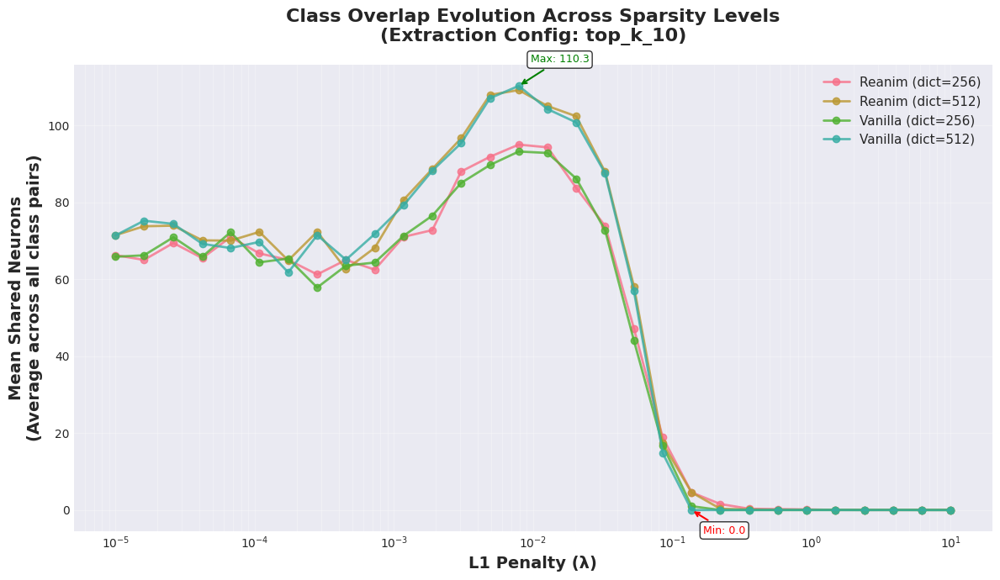

✓ Figure saved: penalty_vs_mean_jaccard.png


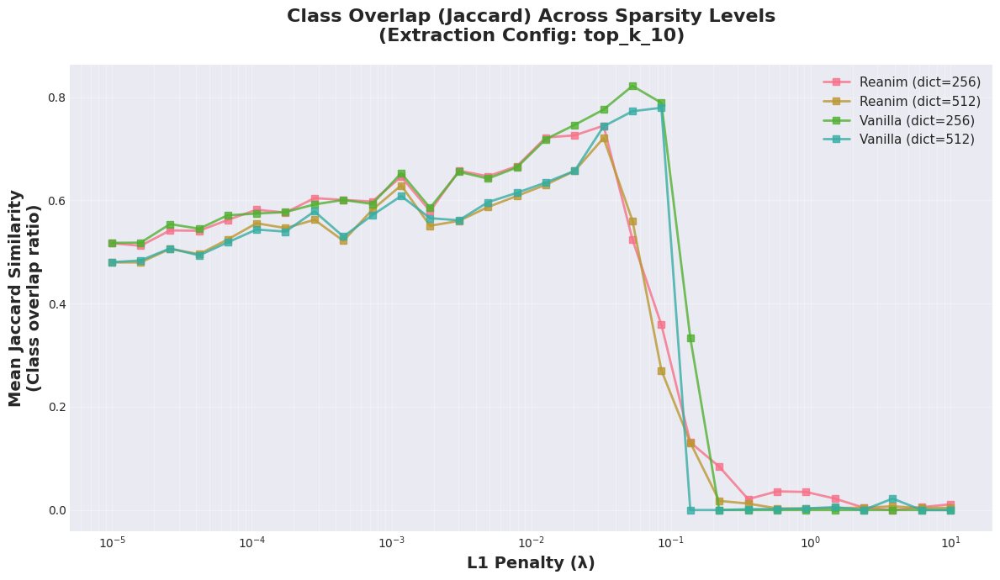


SUMMARY TABLE
training_type  dict_size  l1_penalty  mean_shared_neurons  mean_jaccard  unique_neurons  mean_active
       reanim        256    0.000010            66.311111      0.516892             165      10.0000
      vanilla        512    0.000010            71.444444      0.480310             215      10.0000
      vanilla        256    0.000010            65.888889      0.517710             167      10.0000
       reanim        512    0.000010            71.511111      0.479848             216      10.0000
      vanilla        512    0.000016            75.266667      0.483632             216      10.0000
      vanilla        256    0.000016            66.266667      0.518128             167      10.0000
       reanim        512    0.000016            73.822222      0.479778             214      10.0000
       reanim        256    0.000016            65.066667      0.512112             168      10.0000
      vanilla        256    0.000026            70.955556      0.554104     

In [1]:
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Set style
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")

# ============================================================================
# CONFIGURATION
# ============================================================================

concept_paths_file = '../logs/mnist_activation/Seed1/vanilla_sae/new_concept_path_results.pkl'

# Which config to use for extraction (you have: top_k_10, top_k_20, percentile_90, std_threshold_1.5)
CONFIG_TO_USE = 'top_k_10'

# L1 penalty mapping (your 30 logarithmically-spaced values)
L1_PENALTY_MAP = [round(val, 6) for val in np.logspace(-5, 1, num=30)]

# ============================================================================
# LOAD DATA
# ============================================================================

print("Loading concept paths data...")
try:
    with open(concept_paths_file, 'rb') as f:
        all_concept_paths = pickle.load(f)
    print(f"✓ Loaded concept paths for {len(all_concept_paths)} SAEs")
except FileNotFoundError:
    print(f"✗ File not found: {concept_paths_file}")
    exit()

# ============================================================================
# EXTRACT DATA
# ============================================================================

data_rows = []

for sae_name, configs in all_concept_paths.items():
    
    # Get the specified config
    if CONFIG_TO_USE not in configs:
        print(f"Warning: Config '{CONFIG_TO_USE}' not found in {sae_name}, skipping")
        continue
    
    concept_data = configs[CONFIG_TO_USE]
    
    # Extract metrics
    summary = concept_data.get('summary', {})
    overlap_analysis = concept_data.get('overlap_analysis', {})
    overlap_summary = overlap_analysis.get('summary', {})
    
    # Parse penalty index from SAE name
    # Expecting format like: "vanilla_sae_256_10_best_loss" or "reanim_vanilla_sae_256_10_best_loss"
    parts = sae_name.split('_')
    
    try:
        if 'reanim' in sae_name:
            # Format: reanim_vanilla_sae_256_10_best_loss
            dict_size = int(parts[3])
            penalty_index = int(parts[4])
            training_type = 'reanim'
        else:
            # Format: vanilla_sae_256_10_best_loss
            dict_size = int(parts[2])
            penalty_index = int(parts[3])
            training_type = 'vanilla'
    except (IndexError, ValueError) as e:
        print(f"Warning: Could not parse {sae_name}: {e}")
        continue
    
    # Map penalty index to actual L1 value
    if penalty_index >= len(L1_PENALTY_MAP):
        print(f"Warning: Penalty index {penalty_index} out of range for {sae_name}")
        continue
    
    l1_penalty = L1_PENALTY_MAP[penalty_index]
    
    # Extract mean shared neurons (this is what you want on y-axis)
    mean_shared_neurons = overlap_summary.get('mean_shared_neurons', np.nan)
    mean_jaccard = overlap_summary.get('mean_jaccard', np.nan)
    
    # Also get other useful metrics
    unique_neurons = summary.get('total_unique_neurons_used', np.nan)
    mean_active = summary.get('mean_active_neurons', np.nan)
    
    data_rows.append({
        'sae_name': sae_name,
        'training_type': training_type,
        'dict_size': dict_size,
        'penalty_index': penalty_index,
        'l1_penalty': l1_penalty,
        'mean_shared_neurons': mean_shared_neurons,
        'mean_jaccard': mean_jaccard,
        'unique_neurons': unique_neurons,
        'mean_active': mean_active
    })

# Create DataFrame
df = pd.DataFrame(data_rows)

# Remove rows with NaN in critical columns
df = df.dropna(subset=['l1_penalty', 'mean_shared_neurons'])

# Sort by penalty
df = df.sort_values('l1_penalty')

print(f"\n✓ Extracted data from {len(df)} SAEs")
print(f"  Penalty range: {df['l1_penalty'].min():.6f} to {df['l1_penalty'].max():.6f}")
print(f"  Mean shared neurons range: {df['mean_shared_neurons'].min():.1f} to {df['mean_shared_neurons'].max():.1f}")

# ============================================================================
# PLOT: PENALTY vs MEAN SHARED NEURONS
# ============================================================================

fig, ax = plt.subplots(figsize=(12, 7))

# Group by training type and dict size for different lines
for (training, dict_size), group in df.groupby(['training_type', 'dict_size']):
    group = group.sort_values('l1_penalty')
    
    label = f"{training.capitalize()} (dict={dict_size})"
    
    ax.plot(group['l1_penalty'], 
            group['mean_shared_neurons'],
            marker='o', 
            markersize=6,
            linewidth=2,
            label=label,
            alpha=0.8)

ax.set_xlabel('L1 Penalty (λ)', fontsize=14, fontweight='bold')
ax.set_ylabel('Mean Shared Neurons\n(Average across all class pairs)', fontsize=14, fontweight='bold')
ax.set_title(f'Class Overlap Evolution Across Sparsity Levels\n(Extraction Config: {CONFIG_TO_USE})', 
             fontsize=16, fontweight='bold', pad=20)

# Use log scale for x-axis (penalties are logarithmically spaced)
ax.set_xscale('log')

# Grid
ax.grid(True, alpha=0.3, which='both')

# Legend
ax.legend(loc='best', fontsize=11, framealpha=0.9)

# Annotations
if len(df) > 0:
    # Mark lowest and highest points
    min_row = df.loc[df['mean_shared_neurons'].idxmin()]
    max_row = df.loc[df['mean_shared_neurons'].idxmax()]
    
    ax.annotate(f'Min: {min_row["mean_shared_neurons"]:.1f}',
                xy=(min_row['l1_penalty'], min_row['mean_shared_neurons']),
                xytext=(10, -20), textcoords='offset points',
                fontsize=9, color='red',
                bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8),
                arrowprops=dict(arrowstyle='->', color='red', lw=1.5))
    
    ax.annotate(f'Max: {max_row["mean_shared_neurons"]:.1f}',
                xy=(max_row['l1_penalty'], max_row['mean_shared_neurons']),
                xytext=(10, 20), textcoords='offset points',
                fontsize=9, color='green',
                bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8),
                arrowprops=dict(arrowstyle='->', color='green', lw=1.5))

plt.tight_layout()
plt.savefig('penalty_vs_mean_shared_neurons.png', dpi=300, bbox_inches='tight')
print("\n✓ Figure saved: penalty_vs_mean_shared_neurons.png")
plt.show()

# ============================================================================
# OPTIONAL: ALSO PLOT MEAN JACCARD (Similar metric)
# ============================================================================

fig, ax = plt.subplots(figsize=(12, 7))

for (training, dict_size), group in df.groupby(['training_type', 'dict_size']):
    group = group.sort_values('l1_penalty')
    
    label = f"{training.capitalize()} (dict={dict_size})"
    
    ax.plot(group['l1_penalty'], 
            group['mean_jaccard'],
            marker='s', 
            markersize=6,
            linewidth=2,
            label=label,
            alpha=0.8)

ax.set_xlabel('L1 Penalty (λ)', fontsize=14, fontweight='bold')
ax.set_ylabel('Mean Jaccard Similarity\n(Class overlap ratio)', fontsize=14, fontweight='bold')
ax.set_title(f'Class Overlap (Jaccard) Across Sparsity Levels\n(Extraction Config: {CONFIG_TO_USE})', 
             fontsize=16, fontweight='bold', pad=20)

ax.set_xscale('log')
ax.grid(True, alpha=0.3, which='both')
ax.legend(loc='best', fontsize=11, framealpha=0.9)

plt.tight_layout()
plt.savefig('penalty_vs_mean_jaccard.png', dpi=300, bbox_inches='tight')
print("✓ Figure saved: penalty_vs_mean_jaccard.png")
plt.show()

# ============================================================================
# PRINT SUMMARY TABLE
# ============================================================================

print("\n" + "="*80)
print("SUMMARY TABLE")
print("="*80)

summary_table = df[['training_type', 'dict_size', 'l1_penalty', 
                     'mean_shared_neurons', 'mean_jaccard', 
                     'unique_neurons', 'mean_active']]

print(summary_table.to_string(index=False))

# ============================================================================
# INTERPRETATION GUIDE
# ============================================================================

print("\n" + "="*80)
print("INTERPRETATION GUIDE")
print("="*80)
print("""
What does "Mean Shared Neurons" tell you?

- This is the average number of neurons shared between each pair of classes
- Computed from your overlap_analysis: mean_shared_neurons

Expected Pattern:
├─ LOW sparsity (λ < 0.01): LOW shared neurons (~10-20)
│  → Each class uses mostly separate neurons (inefficient, under-sparse)
│
├─ OPTIMAL sparsity (λ ∈ [0.01, 0.12]): MODERATE shared neurons (~30-50)
│  → Healthy feature sharing across classes (efficient)
│
└─ HIGH sparsity (λ > 0.12): HIGH shared neurons (~80-120)
   → Forced into same few neurons (collapsed, over-sparse)

IMPORTANT: Interpret alongside "unique_neurons":
- High shared + High unique = Optimal (sharing but distinct)
- High shared + Low unique = Collapse (everyone uses same small set)
- Low shared + High unique = Under-sparse (wasteful separation)
""")

print("\n✓ Analysis complete!")

Loading concept paths data...
✓ Loaded concept paths for 80 SAEs

✓ Extracted data from 24 SAEs
  Penalty range: 0.000026 to 1.487352
  Mean shared neurons range: 14.1 to 74.1

✓ Figure saved: penalty_vs_mean_shared_neurons.png


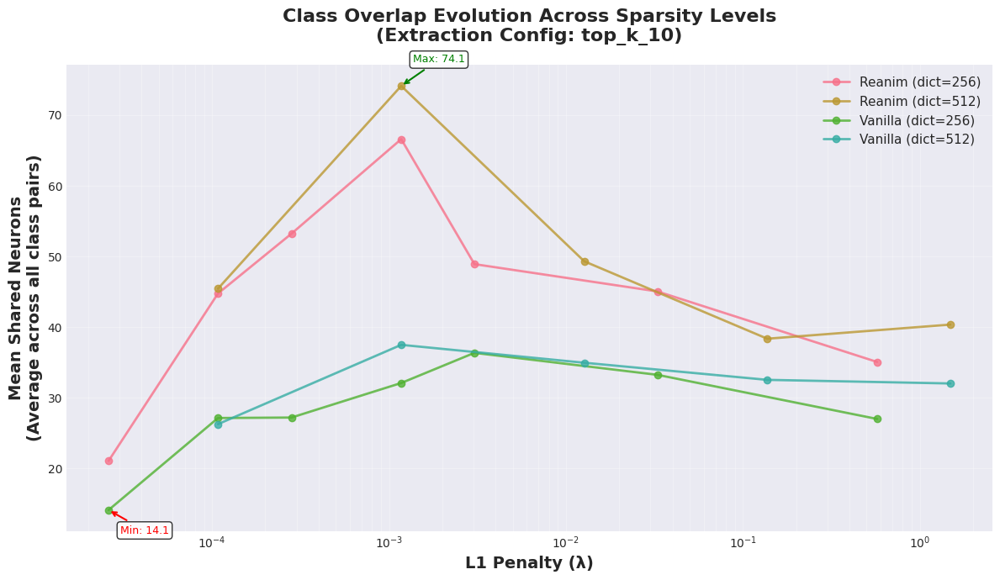

✓ Figure saved: penalty_vs_mean_jaccard.png


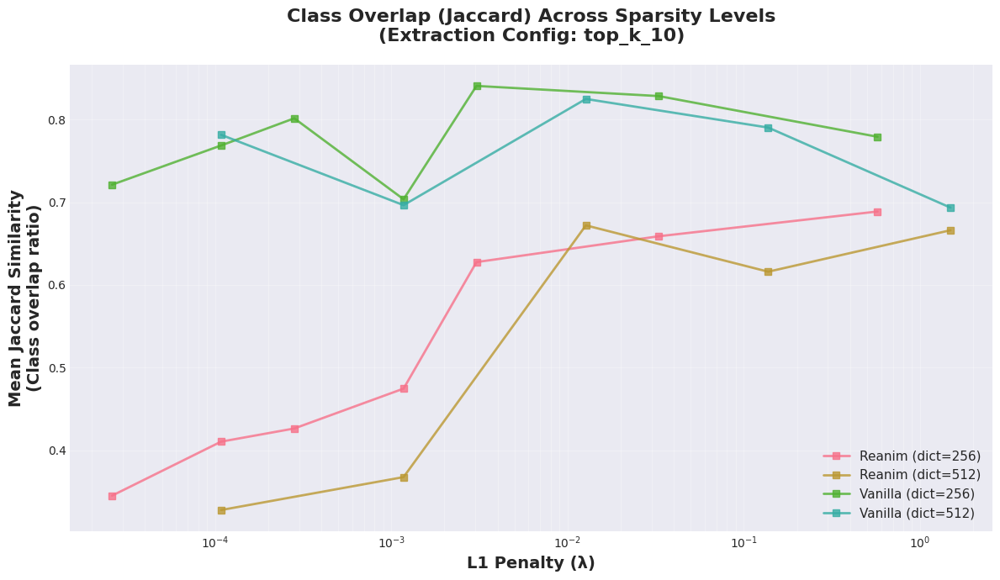


SUMMARY TABLE
training_type  dict_size  l1_penalty  mean_shared_neurons  mean_jaccard  unique_neurons  mean_active
       reanim        256    0.000026            21.066667      0.345068             145          2.0
      vanilla        256    0.000026            14.111111      0.721248              26          2.0
      vanilla        256    0.000108            27.133333      0.768653              50          5.0
       reanim        512    0.000108            45.444444      0.327667             318          5.0
      vanilla        512    0.000108            26.266667      0.781575              47          5.0
       reanim        256    0.000108            44.755556      0.410381             203          5.0
       reanim        256    0.000281            53.222222      0.426307             219          7.0
      vanilla        256    0.000281            27.200000      0.801521              46          7.0
      vanilla        256    0.001172            32.088889      0.703600     

In [2]:
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Set style
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")

# ============================================================================
# CONFIGURATION
# ============================================================================

concept_paths_file = '../logs/mnist_activation/Seed1/topk_sae/new_concept_path_results.pkl'

# Which config to use for extraction (you have: top_k_10, top_k_20, percentile_90, std_threshold_1.5)
CONFIG_TO_USE = 'top_k_10'

# L1 penalty mapping (your 30 logarithmically-spaced values)
L1_PENALTY_MAP = [round(val, 6) for val in np.logspace(-5, 1, num=30)]

# ============================================================================
# LOAD DATA
# ============================================================================

print("Loading concept paths data...")
try:
    with open(concept_paths_file, 'rb') as f:
        all_concept_paths = pickle.load(f)
    print(f"✓ Loaded concept paths for {len(all_concept_paths)} SAEs")
except FileNotFoundError:
    print(f"✗ File not found: {concept_paths_file}")
    exit()

# ============================================================================
# EXTRACT DATA
# ============================================================================

data_rows = []

for sae_name, configs in all_concept_paths.items():
    
    # Get the specified config
    if CONFIG_TO_USE not in configs:
        print(f"Warning: Config '{CONFIG_TO_USE}' not found in {sae_name}, skipping")
        continue
    
    concept_data = configs[CONFIG_TO_USE]
    
    # Extract metrics
    summary = concept_data.get('summary', {})
    overlap_analysis = concept_data.get('overlap_analysis', {})
    overlap_summary = overlap_analysis.get('summary', {})
    
    # Parse penalty index from SAE name
    # Expecting format like: "vanilla_sae_256_10_best_loss" or "reanim_vanilla_sae_256_10_best_loss"
    parts = sae_name.split('_')
    
    try:
        if 'reanim' in sae_name:
            # Format: reanim_vanilla_sae_256_10_best_loss
            dict_size = int(parts[3])
            penalty_index = int(parts[4])
            training_type = 'reanim'
        else:
            # Format: vanilla_sae_256_10_best_loss
            dict_size = int(parts[2])
            penalty_index = int(parts[3])
            training_type = 'vanilla'
    except (IndexError, ValueError) as e:
        print(f"Warning: Could not parse {sae_name}: {e}")
        continue
    
    # Map penalty index to actual L1 value
    if penalty_index >= len(L1_PENALTY_MAP):
        print(f"Warning: Penalty index {penalty_index} out of range for {sae_name}")
        continue
    
    l1_penalty = L1_PENALTY_MAP[penalty_index]
    
    # Extract mean shared neurons (this is what you want on y-axis)
    mean_shared_neurons = overlap_summary.get('mean_shared_neurons', np.nan)
    mean_jaccard = overlap_summary.get('mean_jaccard', np.nan)
    
    # Also get other useful metrics
    unique_neurons = summary.get('total_unique_neurons_used', np.nan)
    mean_active = summary.get('mean_active_neurons', np.nan)
    
    data_rows.append({
        'sae_name': sae_name,
        'training_type': training_type,
        'dict_size': dict_size,
        'penalty_index': penalty_index,
        'l1_penalty': l1_penalty,
        'mean_shared_neurons': mean_shared_neurons,
        'mean_jaccard': mean_jaccard,
        'unique_neurons': unique_neurons,
        'mean_active': mean_active
    })

# Create DataFrame
df = pd.DataFrame(data_rows)

# Remove rows with NaN in critical columns
df = df.dropna(subset=['l1_penalty', 'mean_shared_neurons'])

# Sort by penalty
df = df.sort_values('l1_penalty')

print(f"\n✓ Extracted data from {len(df)} SAEs")
print(f"  Penalty range: {df['l1_penalty'].min():.6f} to {df['l1_penalty'].max():.6f}")
print(f"  Mean shared neurons range: {df['mean_shared_neurons'].min():.1f} to {df['mean_shared_neurons'].max():.1f}")

# ============================================================================
# PLOT: PENALTY vs MEAN SHARED NEURONS
# ============================================================================

fig, ax = plt.subplots(figsize=(12, 7))

# Group by training type and dict size for different lines
for (training, dict_size), group in df.groupby(['training_type', 'dict_size']):
    group = group.sort_values('l1_penalty')
    
    label = f"{training.capitalize()} (dict={dict_size})"
    
    ax.plot(group['l1_penalty'], 
            group['mean_shared_neurons'],
            marker='o', 
            markersize=6,
            linewidth=2,
            label=label,
            alpha=0.8)

ax.set_xlabel('L1 Penalty (λ)', fontsize=14, fontweight='bold')
ax.set_ylabel('Mean Shared Neurons\n(Average across all class pairs)', fontsize=14, fontweight='bold')
ax.set_title(f'Class Overlap Evolution Across Sparsity Levels\n(Extraction Config: {CONFIG_TO_USE})', 
             fontsize=16, fontweight='bold', pad=20)

# Use log scale for x-axis (penalties are logarithmically spaced)
ax.set_xscale('log')

# Grid
ax.grid(True, alpha=0.3, which='both')

# Legend
ax.legend(loc='best', fontsize=11, framealpha=0.9)

# Annotations
if len(df) > 0:
    # Mark lowest and highest points
    min_row = df.loc[df['mean_shared_neurons'].idxmin()]
    max_row = df.loc[df['mean_shared_neurons'].idxmax()]
    
    ax.annotate(f'Min: {min_row["mean_shared_neurons"]:.1f}',
                xy=(min_row['l1_penalty'], min_row['mean_shared_neurons']),
                xytext=(10, -20), textcoords='offset points',
                fontsize=9, color='red',
                bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8),
                arrowprops=dict(arrowstyle='->', color='red', lw=1.5))
    
    ax.annotate(f'Max: {max_row["mean_shared_neurons"]:.1f}',
                xy=(max_row['l1_penalty'], max_row['mean_shared_neurons']),
                xytext=(10, 20), textcoords='offset points',
                fontsize=9, color='green',
                bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8),
                arrowprops=dict(arrowstyle='->', color='green', lw=1.5))

plt.tight_layout()
plt.savefig('penalty_vs_mean_shared_neurons.png', dpi=300, bbox_inches='tight')
print("\n✓ Figure saved: penalty_vs_mean_shared_neurons.png")
plt.show()

# ============================================================================
# OPTIONAL: ALSO PLOT MEAN JACCARD (Similar metric)
# ============================================================================

fig, ax = plt.subplots(figsize=(12, 7))

for (training, dict_size), group in df.groupby(['training_type', 'dict_size']):
    group = group.sort_values('l1_penalty')
    
    label = f"{training.capitalize()} (dict={dict_size})"
    
    ax.plot(group['l1_penalty'], 
            group['mean_jaccard'],
            marker='s', 
            markersize=6,
            linewidth=2,
            label=label,
            alpha=0.8)

ax.set_xlabel('L1 Penalty (λ)', fontsize=14, fontweight='bold')
ax.set_ylabel('Mean Jaccard Similarity\n(Class overlap ratio)', fontsize=14, fontweight='bold')
ax.set_title(f'Class Overlap (Jaccard) Across Sparsity Levels\n(Extraction Config: {CONFIG_TO_USE})', 
             fontsize=16, fontweight='bold', pad=20)

ax.set_xscale('log')
ax.grid(True, alpha=0.3, which='both')
ax.legend(loc='best', fontsize=11, framealpha=0.9)

plt.tight_layout()
plt.savefig('penalty_vs_mean_jaccard.png', dpi=300, bbox_inches='tight')
print("✓ Figure saved: penalty_vs_mean_jaccard.png")
plt.show()

# ============================================================================
# PRINT SUMMARY TABLE
# ============================================================================

print("\n" + "="*80)
print("SUMMARY TABLE")
print("="*80)

summary_table = df[['training_type', 'dict_size', 'l1_penalty', 
                     'mean_shared_neurons', 'mean_jaccard', 
                     'unique_neurons', 'mean_active']]

print(summary_table.to_string(index=False))

# ============================================================================
# INTERPRETATION GUIDE
# ============================================================================

print("\n" + "="*80)
print("INTERPRETATION GUIDE")
print("="*80)
print("""
What does "Mean Shared Neurons" tell you?

- This is the average number of neurons shared between each pair of classes
- Computed from your overlap_analysis: mean_shared_neurons

Expected Pattern:
├─ LOW sparsity (λ < 0.01): LOW shared neurons (~10-20)
│  → Each class uses mostly separate neurons (inefficient, under-sparse)
│
├─ OPTIMAL sparsity (λ ∈ [0.01, 0.12]): MODERATE shared neurons (~30-50)
│  → Healthy feature sharing across classes (efficient)
│
└─ HIGH sparsity (λ > 0.12): HIGH shared neurons (~80-120)
   → Forced into same few neurons (collapsed, over-sparse)

IMPORTANT: Interpret alongside "unique_neurons":
- High shared + High unique = Optimal (sharing but distinct)
- High shared + Low unique = Collapse (everyone uses same small set)
- Low shared + High unique = Under-sparse (wasteful separation)
""")

print("\n✓ Analysis complete!")

Loading concept paths data...
✓ Loaded concept paths for 120 SAEs

✓ Extracted data from 120 SAEs
  Penalty range: 0.000010 to 10.000000
  Mean shared neurons range: 0.0 to 66.7

✓ Figure saved: penalty_vs_mean_shared_neurons.png


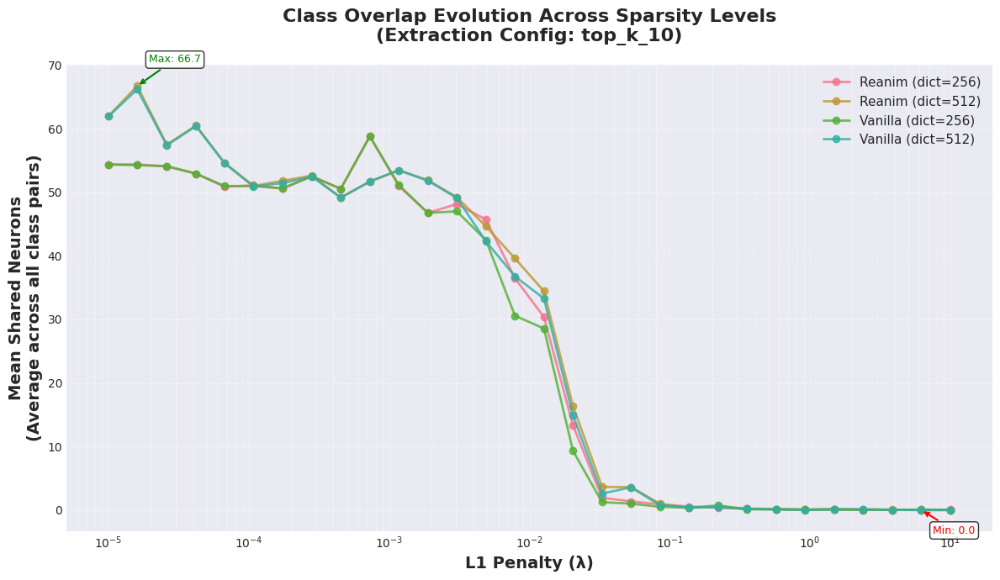

✓ Figure saved: penalty_vs_mean_jaccard.png


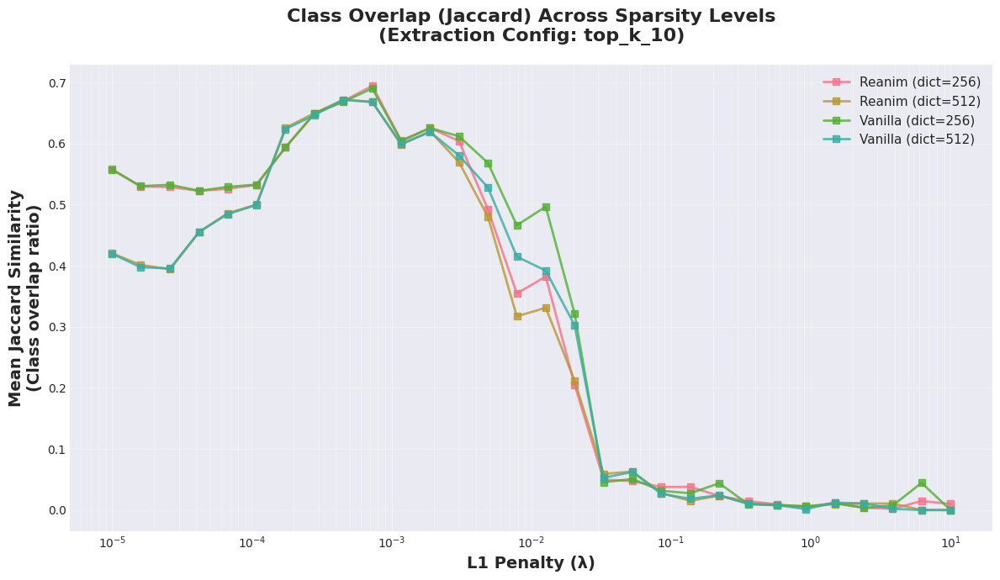


SUMMARY TABLE
training_type  dict_size  l1_penalty  mean_shared_neurons  mean_jaccard  unique_neurons  mean_active
       reanim        256    0.000010            54.355556      0.558048             125      10.0000
      vanilla        512    0.000010            61.955556      0.419609             220      10.0000
      vanilla        256    0.000010            54.377778      0.557228             125      10.0000
       reanim        512    0.000010            61.977778      0.420509             219      10.0000
      vanilla        512    0.000016            66.200000      0.397609             249      10.0000
      vanilla        256    0.000016            54.266667      0.530292             138      10.0000
       reanim        512    0.000016            66.733333      0.401356             248      10.0000
       reanim        256    0.000016            54.377778      0.529800             138      10.0000
      vanilla        256    0.000026            54.111111      0.532691     

In [3]:
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Set style
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")

# ============================================================================
# CONFIGURATION
# ============================================================================

concept_paths_file = '../logs/cifar10expt5/Seed1/vanilla_sae/new_concept_path_results.pkl'

# Which config to use for extraction (you have: top_k_10, top_k_20, percentile_90, std_threshold_1.5)
CONFIG_TO_USE = 'top_k_10'

# L1 penalty mapping (your 30 logarithmically-spaced values)
L1_PENALTY_MAP = [round(val, 6) for val in np.logspace(-5, 1, num=30)]

# ============================================================================
# LOAD DATA
# ============================================================================

print("Loading concept paths data...")
try:
    with open(concept_paths_file, 'rb') as f:
        all_concept_paths = pickle.load(f)
    print(f"✓ Loaded concept paths for {len(all_concept_paths)} SAEs")
except FileNotFoundError:
    print(f"✗ File not found: {concept_paths_file}")
    exit()

# ============================================================================
# EXTRACT DATA
# ============================================================================

data_rows = []

for sae_name, configs in all_concept_paths.items():
    
    # Get the specified config
    if CONFIG_TO_USE not in configs:
        print(f"Warning: Config '{CONFIG_TO_USE}' not found in {sae_name}, skipping")
        continue
    
    concept_data = configs[CONFIG_TO_USE]
    
    # Extract metrics
    summary = concept_data.get('summary', {})
    overlap_analysis = concept_data.get('overlap_analysis', {})
    overlap_summary = overlap_analysis.get('summary', {})
    
    # Parse penalty index from SAE name
    # Expecting format like: "vanilla_sae_256_10_best_loss" or "reanim_vanilla_sae_256_10_best_loss"
    parts = sae_name.split('_')
    
    try:
        if 'reanim' in sae_name:
            # Format: reanim_vanilla_sae_256_10_best_loss
            dict_size = int(parts[3])
            penalty_index = int(parts[4])
            training_type = 'reanim'
        else:
            # Format: vanilla_sae_256_10_best_loss
            dict_size = int(parts[2])
            penalty_index = int(parts[3])
            training_type = 'vanilla'
    except (IndexError, ValueError) as e:
        print(f"Warning: Could not parse {sae_name}: {e}")
        continue
    
    # Map penalty index to actual L1 value
    if penalty_index >= len(L1_PENALTY_MAP):
        print(f"Warning: Penalty index {penalty_index} out of range for {sae_name}")
        continue
    
    l1_penalty = L1_PENALTY_MAP[penalty_index]
    
    # Extract mean shared neurons (this is what you want on y-axis)
    mean_shared_neurons = overlap_summary.get('mean_shared_neurons', np.nan)
    mean_jaccard = overlap_summary.get('mean_jaccard', np.nan)
    
    # Also get other useful metrics
    unique_neurons = summary.get('total_unique_neurons_used', np.nan)
    mean_active = summary.get('mean_active_neurons', np.nan)
    
    data_rows.append({
        'sae_name': sae_name,
        'training_type': training_type,
        'dict_size': dict_size,
        'penalty_index': penalty_index,
        'l1_penalty': l1_penalty,
        'mean_shared_neurons': mean_shared_neurons,
        'mean_jaccard': mean_jaccard,
        'unique_neurons': unique_neurons,
        'mean_active': mean_active
    })

# Create DataFrame
df = pd.DataFrame(data_rows)

# Remove rows with NaN in critical columns
df = df.dropna(subset=['l1_penalty', 'mean_shared_neurons'])

# Sort by penalty
df = df.sort_values('l1_penalty')

print(f"\n✓ Extracted data from {len(df)} SAEs")
print(f"  Penalty range: {df['l1_penalty'].min():.6f} to {df['l1_penalty'].max():.6f}")
print(f"  Mean shared neurons range: {df['mean_shared_neurons'].min():.1f} to {df['mean_shared_neurons'].max():.1f}")

# ============================================================================
# PLOT: PENALTY vs MEAN SHARED NEURONS
# ============================================================================

fig, ax = plt.subplots(figsize=(12, 7))

# Group by training type and dict size for different lines
for (training, dict_size), group in df.groupby(['training_type', 'dict_size']):
    group = group.sort_values('l1_penalty')
    
    label = f"{training.capitalize()} (dict={dict_size})"
    
    ax.plot(group['l1_penalty'], 
            group['mean_shared_neurons'],
            marker='o', 
            markersize=6,
            linewidth=2,
            label=label,
            alpha=0.8)

ax.set_xlabel('L1 Penalty (λ)', fontsize=14, fontweight='bold')
ax.set_ylabel('Mean Shared Neurons\n(Average across all class pairs)', fontsize=14, fontweight='bold')
ax.set_title(f'Class Overlap Evolution Across Sparsity Levels\n(Extraction Config: {CONFIG_TO_USE})', 
             fontsize=16, fontweight='bold', pad=20)

# Use log scale for x-axis (penalties are logarithmically spaced)
ax.set_xscale('log')

# Grid
ax.grid(True, alpha=0.3, which='both')

# Legend
ax.legend(loc='best', fontsize=11, framealpha=0.9)

# Annotations
if len(df) > 0:
    # Mark lowest and highest points
    min_row = df.loc[df['mean_shared_neurons'].idxmin()]
    max_row = df.loc[df['mean_shared_neurons'].idxmax()]
    
    ax.annotate(f'Min: {min_row["mean_shared_neurons"]:.1f}',
                xy=(min_row['l1_penalty'], min_row['mean_shared_neurons']),
                xytext=(10, -20), textcoords='offset points',
                fontsize=9, color='red',
                bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8),
                arrowprops=dict(arrowstyle='->', color='red', lw=1.5))
    
    ax.annotate(f'Max: {max_row["mean_shared_neurons"]:.1f}',
                xy=(max_row['l1_penalty'], max_row['mean_shared_neurons']),
                xytext=(10, 20), textcoords='offset points',
                fontsize=9, color='green',
                bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8),
                arrowprops=dict(arrowstyle='->', color='green', lw=1.5))

plt.tight_layout()
plt.savefig('penalty_vs_mean_shared_neurons.png', dpi=300, bbox_inches='tight')
print("\n✓ Figure saved: penalty_vs_mean_shared_neurons.png")
plt.show()

# ============================================================================
# OPTIONAL: ALSO PLOT MEAN JACCARD (Similar metric)
# ============================================================================

fig, ax = plt.subplots(figsize=(12, 7))

for (training, dict_size), group in df.groupby(['training_type', 'dict_size']):
    group = group.sort_values('l1_penalty')
    
    label = f"{training.capitalize()} (dict={dict_size})"
    
    ax.plot(group['l1_penalty'], 
            group['mean_jaccard'],
            marker='s', 
            markersize=6,
            linewidth=2,
            label=label,
            alpha=0.8)

ax.set_xlabel('L1 Penalty (λ)', fontsize=14, fontweight='bold')
ax.set_ylabel('Mean Jaccard Similarity\n(Class overlap ratio)', fontsize=14, fontweight='bold')
ax.set_title(f'Class Overlap (Jaccard) Across Sparsity Levels\n(Extraction Config: {CONFIG_TO_USE})', 
             fontsize=16, fontweight='bold', pad=20)

ax.set_xscale('log')
ax.grid(True, alpha=0.3, which='both')
ax.legend(loc='best', fontsize=11, framealpha=0.9)

plt.tight_layout()
plt.savefig('penalty_vs_mean_jaccard.png', dpi=300, bbox_inches='tight')
print("✓ Figure saved: penalty_vs_mean_jaccard.png")
plt.show()

# ============================================================================
# PRINT SUMMARY TABLE
# ============================================================================

print("\n" + "="*80)
print("SUMMARY TABLE")
print("="*80)

summary_table = df[['training_type', 'dict_size', 'l1_penalty', 
                     'mean_shared_neurons', 'mean_jaccard', 
                     'unique_neurons', 'mean_active']]

print(summary_table.to_string(index=False))

# ============================================================================
# INTERPRETATION GUIDE
# ============================================================================

print("\n" + "="*80)
print("INTERPRETATION GUIDE")
print("="*80)
print("""
What does "Mean Shared Neurons" tell you?

- This is the average number of neurons shared between each pair of classes
- Computed from your overlap_analysis: mean_shared_neurons

Expected Pattern:
├─ LOW sparsity (λ < 0.01): LOW shared neurons (~10-20)
│  → Each class uses mostly separate neurons (inefficient, under-sparse)
│
├─ OPTIMAL sparsity (λ ∈ [0.01, 0.12]): MODERATE shared neurons (~30-50)
│  → Healthy feature sharing across classes (efficient)
│
└─ HIGH sparsity (λ > 0.12): HIGH shared neurons (~80-120)
   → Forced into same few neurons (collapsed, over-sparse)

IMPORTANT: Interpret alongside "unique_neurons":
- High shared + High unique = Optimal (sharing but distinct)
- High shared + Low unique = Collapse (everyone uses same small set)
- Low shared + High unique = Under-sparse (wasteful separation)
""")

print("\n✓ Analysis complete!")

Loading concept paths data...
✓ Loaded concept paths for 80 SAEs

✓ Extracted data from 24 SAEs
  Penalty range: 0.000026 to 1.487352
  Mean shared neurons range: 15.7 to 67.0

✓ Figure saved: penalty_vs_mean_shared_neurons.png


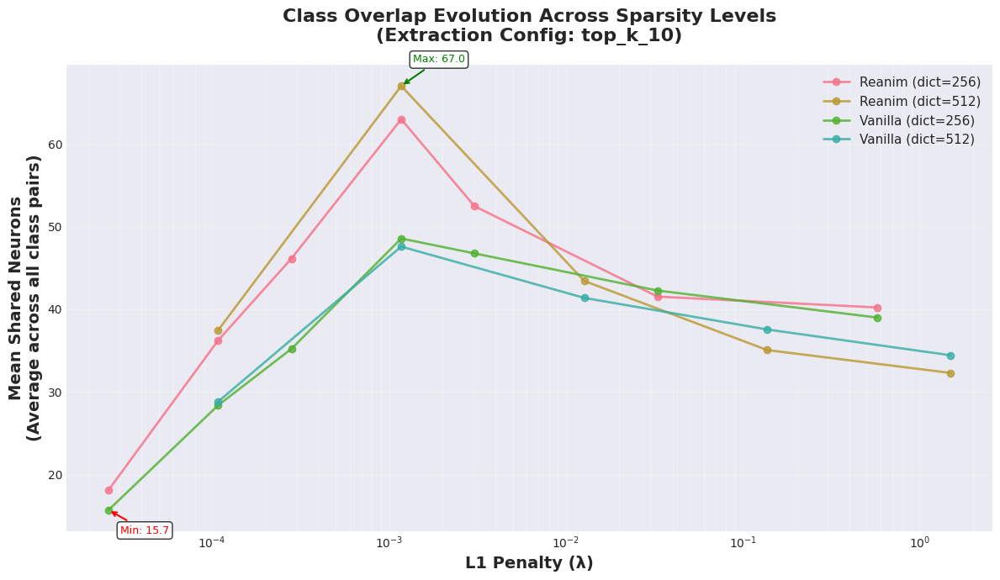

✓ Figure saved: penalty_vs_mean_jaccard.png


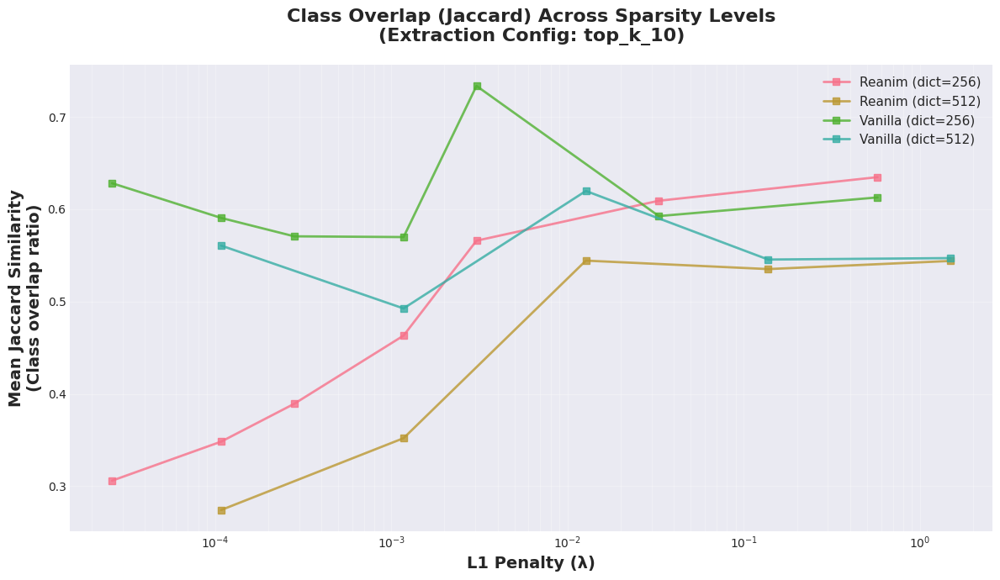


SUMMARY TABLE
training_type  dict_size  l1_penalty  mean_shared_neurons  mean_jaccard  unique_neurons  mean_active
       reanim        256    0.000026            18.155556      0.306013             151          2.0
      vanilla        256    0.000026            15.733333      0.628203              39          2.0
      vanilla        256    0.000108            28.377778      0.590627              82          5.0
       reanim        512    0.000108            37.444444      0.274197             338          5.0
      vanilla        512    0.000108            28.822222      0.560675              95          5.0
       reanim        256    0.000108            36.222222      0.348247             202          5.0
       reanim        256    0.000281            46.133333      0.389297             214          7.0
      vanilla        256    0.000281            35.222222      0.570672             107          7.0
      vanilla        256    0.001172            48.555556      0.569869     

In [4]:
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Set style
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")

# ============================================================================
# CONFIGURATION
# ============================================================================

concept_paths_file = '../logs/cifar10expt5/Seed1/topk_sae/new_concept_path_results.pkl'

# Which config to use for extraction (you have: top_k_10, top_k_20, percentile_90, std_threshold_1.5)
CONFIG_TO_USE = 'top_k_10'

# L1 penalty mapping (your 30 logarithmically-spaced values)
L1_PENALTY_MAP = [round(val, 6) for val in np.logspace(-5, 1, num=30)]

# ============================================================================
# LOAD DATA
# ============================================================================

print("Loading concept paths data...")
try:
    with open(concept_paths_file, 'rb') as f:
        all_concept_paths = pickle.load(f)
    print(f"✓ Loaded concept paths for {len(all_concept_paths)} SAEs")
except FileNotFoundError:
    print(f"✗ File not found: {concept_paths_file}")
    exit()

# ============================================================================
# EXTRACT DATA
# ============================================================================

data_rows = []

for sae_name, configs in all_concept_paths.items():
    
    # Get the specified config
    if CONFIG_TO_USE not in configs:
        print(f"Warning: Config '{CONFIG_TO_USE}' not found in {sae_name}, skipping")
        continue
    
    concept_data = configs[CONFIG_TO_USE]
    
    # Extract metrics
    summary = concept_data.get('summary', {})
    overlap_analysis = concept_data.get('overlap_analysis', {})
    overlap_summary = overlap_analysis.get('summary', {})
    
    # Parse penalty index from SAE name
    # Expecting format like: "vanilla_sae_256_10_best_loss" or "reanim_vanilla_sae_256_10_best_loss"
    parts = sae_name.split('_')
    
    try:
        if 'reanim' in sae_name:
            # Format: reanim_vanilla_sae_256_10_best_loss
            dict_size = int(parts[3])
            penalty_index = int(parts[4])
            training_type = 'reanim'
        else:
            # Format: vanilla_sae_256_10_best_loss
            dict_size = int(parts[2])
            penalty_index = int(parts[3])
            training_type = 'vanilla'
    except (IndexError, ValueError) as e:
        print(f"Warning: Could not parse {sae_name}: {e}")
        continue
    
    # Map penalty index to actual L1 value
    if penalty_index >= len(L1_PENALTY_MAP):
        print(f"Warning: Penalty index {penalty_index} out of range for {sae_name}")
        continue
    
    l1_penalty = L1_PENALTY_MAP[penalty_index]
    
    # Extract mean shared neurons (this is what you want on y-axis)
    mean_shared_neurons = overlap_summary.get('mean_shared_neurons', np.nan)
    mean_jaccard = overlap_summary.get('mean_jaccard', np.nan)
    
    # Also get other useful metrics
    unique_neurons = summary.get('total_unique_neurons_used', np.nan)
    mean_active = summary.get('mean_active_neurons', np.nan)
    
    data_rows.append({
        'sae_name': sae_name,
        'training_type': training_type,
        'dict_size': dict_size,
        'penalty_index': penalty_index,
        'l1_penalty': l1_penalty,
        'mean_shared_neurons': mean_shared_neurons,
        'mean_jaccard': mean_jaccard,
        'unique_neurons': unique_neurons,
        'mean_active': mean_active
    })

# Create DataFrame
df = pd.DataFrame(data_rows)

# Remove rows with NaN in critical columns
df = df.dropna(subset=['l1_penalty', 'mean_shared_neurons'])

# Sort by penalty
df = df.sort_values('l1_penalty')

print(f"\n✓ Extracted data from {len(df)} SAEs")
print(f"  Penalty range: {df['l1_penalty'].min():.6f} to {df['l1_penalty'].max():.6f}")
print(f"  Mean shared neurons range: {df['mean_shared_neurons'].min():.1f} to {df['mean_shared_neurons'].max():.1f}")

# ============================================================================
# PLOT: PENALTY vs MEAN SHARED NEURONS
# ============================================================================

fig, ax = plt.subplots(figsize=(12, 7))

# Group by training type and dict size for different lines
for (training, dict_size), group in df.groupby(['training_type', 'dict_size']):
    group = group.sort_values('l1_penalty')
    
    label = f"{training.capitalize()} (dict={dict_size})"
    
    ax.plot(group['l1_penalty'], 
            group['mean_shared_neurons'],
            marker='o', 
            markersize=6,
            linewidth=2,
            label=label,
            alpha=0.8)

ax.set_xlabel('L1 Penalty (λ)', fontsize=14, fontweight='bold')
ax.set_ylabel('Mean Shared Neurons\n(Average across all class pairs)', fontsize=14, fontweight='bold')
ax.set_title(f'Class Overlap Evolution Across Sparsity Levels\n(Extraction Config: {CONFIG_TO_USE})', 
             fontsize=16, fontweight='bold', pad=20)

# Use log scale for x-axis (penalties are logarithmically spaced)
ax.set_xscale('log')

# Grid
ax.grid(True, alpha=0.3, which='both')

# Legend
ax.legend(loc='best', fontsize=11, framealpha=0.9)

# Annotations
if len(df) > 0:
    # Mark lowest and highest points
    min_row = df.loc[df['mean_shared_neurons'].idxmin()]
    max_row = df.loc[df['mean_shared_neurons'].idxmax()]
    
    ax.annotate(f'Min: {min_row["mean_shared_neurons"]:.1f}',
                xy=(min_row['l1_penalty'], min_row['mean_shared_neurons']),
                xytext=(10, -20), textcoords='offset points',
                fontsize=9, color='red',
                bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8),
                arrowprops=dict(arrowstyle='->', color='red', lw=1.5))
    
    ax.annotate(f'Max: {max_row["mean_shared_neurons"]:.1f}',
                xy=(max_row['l1_penalty'], max_row['mean_shared_neurons']),
                xytext=(10, 20), textcoords='offset points',
                fontsize=9, color='green',
                bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8),
                arrowprops=dict(arrowstyle='->', color='green', lw=1.5))

plt.tight_layout()
plt.savefig('penalty_vs_mean_shared_neurons.png', dpi=300, bbox_inches='tight')
print("\n✓ Figure saved: penalty_vs_mean_shared_neurons.png")
plt.show()

# ============================================================================
# OPTIONAL: ALSO PLOT MEAN JACCARD (Similar metric)
# ============================================================================

fig, ax = plt.subplots(figsize=(12, 7))

for (training, dict_size), group in df.groupby(['training_type', 'dict_size']):
    group = group.sort_values('l1_penalty')
    
    label = f"{training.capitalize()} (dict={dict_size})"
    
    ax.plot(group['l1_penalty'], 
            group['mean_jaccard'],
            marker='s', 
            markersize=6,
            linewidth=2,
            label=label,
            alpha=0.8)

ax.set_xlabel('L1 Penalty (λ)', fontsize=14, fontweight='bold')
ax.set_ylabel('Mean Jaccard Similarity\n(Class overlap ratio)', fontsize=14, fontweight='bold')
ax.set_title(f'Class Overlap (Jaccard) Across Sparsity Levels\n(Extraction Config: {CONFIG_TO_USE})', 
             fontsize=16, fontweight='bold', pad=20)

ax.set_xscale('log')
ax.grid(True, alpha=0.3, which='both')
ax.legend(loc='best', fontsize=11, framealpha=0.9)

plt.tight_layout()
plt.savefig('penalty_vs_mean_jaccard.png', dpi=300, bbox_inches='tight')
print("✓ Figure saved: penalty_vs_mean_jaccard.png")
plt.show()

# ============================================================================
# PRINT SUMMARY TABLE
# ============================================================================

print("\n" + "="*80)
print("SUMMARY TABLE")
print("="*80)

summary_table = df[['training_type', 'dict_size', 'l1_penalty', 
                     'mean_shared_neurons', 'mean_jaccard', 
                     'unique_neurons', 'mean_active']]

print(summary_table.to_string(index=False))

# ============================================================================
# INTERPRETATION GUIDE
# ============================================================================

print("\n" + "="*80)
print("INTERPRETATION GUIDE")
print("="*80)
print("""
What does "Mean Shared Neurons" tell you?

- This is the average number of neurons shared between each pair of classes
- Computed from your overlap_analysis: mean_shared_neurons

Expected Pattern:
├─ LOW sparsity (λ < 0.01): LOW shared neurons (~10-20)
│  → Each class uses mostly separate neurons (inefficient, under-sparse)
│
├─ OPTIMAL sparsity (λ ∈ [0.01, 0.12]): MODERATE shared neurons (~30-50)
│  → Healthy feature sharing across classes (efficient)
│
└─ HIGH sparsity (λ > 0.12): HIGH shared neurons (~80-120)
   → Forced into same few neurons (collapsed, over-sparse)

IMPORTANT: Interpret alongside "unique_neurons":
- High shared + High unique = Optimal (sharing but distinct)
- High shared + Low unique = Collapse (everyone uses same small set)
- Low shared + High unique = Under-sparse (wasteful separation)
""")

print("\n✓ Analysis complete!")

In [5]:
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import os

def plot_aggregated_class_overlap(concept_path_files: list, 
                                config_to_use: str, 
                                l1_penalty_map: list, 
                                save_path_base: str = 'penalty_vs_overlap_dual_axis_aggregated'):
    """
    Loads concept path data from multiple runs for different SAE types, 
    aggregates the results, and plots metrics against the relevant x-axis 
    (L1 Penalty or Top-K Ratio).

    Generates a separate, dual-axis plot for each SAE type found (e.g., 'l1', 'topk').

    Args:
        concept_path_files (list): A list of file paths to the .pkl files 
                                   (e.g., ['run1.pkl', 'run2.pkl']).
        config_to_use (str): The extraction config to use (e.g., 'top_k_10').
        l1_penalty_map (list): The list of L1 penalty values to map indices to 
                               (required for L1 SAEs).
        save_path_base (str, optional): The base file name to save plots. 
                                        SAE type and extension will be added
                                        (e.g., 'my_plot' -> 'my_plot_l1.png').
    
    Returns:
        dict: A dictionary where keys are SAE types (e.g., 'l1', 'topk') and
              values are the aggregated DataFrames for that type.
    """
    
    # Set plot style
    plt.style.use('seaborn-v0_8-darkgrid')
    sns.set_palette("husl")

    all_data_rows = []

    # ============================================================================
    # EXTRACT DATA FROM ALL RUNS
    # ============================================================================
    for run_idx, file_path in enumerate(concept_path_files):
        try:
            with open(file_path, 'rb') as f:
                all_concept_paths = pickle.load(f)
        except FileNotFoundError:
            warnings.warn(f"File not found: {file_path}. Skipping run {run_idx}.")
            continue
        except Exception as e:
            warnings.warn(f"Could not load {file_path}: {e}. Skipping run {run_idx}.")
            continue

        for sae_name, configs in all_concept_paths.items():
            if config_to_use not in configs:
                warnings.warn(f"Config '{config_to_use}' not found in {sae_name} "
                              f"for run {run_idx}, skipping SAE.")
                continue
            
            concept_data = configs[config_to_use]
            
            summary = concept_data.get('summary', {})
            overlap_analysis = concept_data.get('overlap_analysis', {})
            overlap_summary = overlap_analysis.get('summary', {})
            
            parts = sae_name.split('_')
            
            # --- Dynamic SAE Type Detection ---
            sae_type = None
            x_value = np.nan
            training_type = None
            dict_size = None

            try:
                if 'topk' in sae_name:
                    # e.g., topk_sae_512_k_100_best_loss
                    sae_type = 'topk'
                    training_type = 'topk'
                    dict_size = int(parts[2])
                    k_value = int(parts[4])
                    x_value = k_value / dict_size  # This is the Top-K Ratio
                
                elif 'reanim' in sae_name:
                    # e.g., reanim_vanilla_sae_256_10_best_loss
                    sae_type = 'l1'
                    training_type = 'reanim'
                    dict_size = int(parts[3])
                    penalty_index = int(parts[4])
                    if penalty_index >= len(l1_penalty_map):
                        warnings.warn(f"L1 penalty index {penalty_index} out of "
                                      f"range for {sae_name} in run {run_idx}")
                        continue
                    x_value = l1_penalty_map[penalty_index]
                
                elif 'vanilla' in sae_name:
                    # e.g., vanilla_sae_256_10_best_loss
                    sae_type = 'l1'
                    training_type = 'vanilla'
                    dict_size = int(parts[2])
                    penalty_index = int(parts[3])
                    if penalty_index >= len(l1_penalty_map):
                        warnings.warn(f"L1 penalty index {penalty_index} out of "
                                      f"range for {sae_name} in run {run_idx}")
                        continue
                    x_value = l1_penalty_map[penalty_index]
                
                else:
                    warnings.warn(f"Unrecognized SAE name format: {sae_name}. Skipping.")
                    continue
            
            except (IndexError, ValueError, TypeError) as e:
                warnings.warn(f"Could not parse {sae_name} in run {run_idx}: {e}")
                continue
            # --- End Detection ---

            all_data_rows.append({
                'run_id': run_idx,
                'sae_name': sae_name,
                'sae_type': sae_type,
                'training_type': training_type,
                'dict_size': dict_size,
                'x_value': x_value,
                'mean_shared_neurons': overlap_summary.get('mean_shared_neurons', np.nan),
                'mean_jaccard': overlap_summary.get('mean_jaccard', np.nan),
                'unique_neurons': summary.get('total_unique_neurons_used', np.nan),
                'mean_active': summary.get('mean_active_neurons', np.nan)
            })

    if not all_data_rows:
        warnings.warn("No valid data extracted from any files. Aborting plot.")
        return {}

    # Create DataFrame and drop missing values
    df = pd.DataFrame(all_data_rows)
    df = df.dropna(subset=['x_value', 'mean_shared_neurons', 'mean_jaccard'])

    if df.empty:
        warnings.warn("Data was extracted but contained NaNs in critical columns. "
                      "Aborting plot.")
        return {}

    # ============================================================================
    # AGGREGATE AND PLOT PER SAE TYPE
    # ============================================================================
    
    all_agg_dfs = {}

    for sae_type, type_df in df.groupby('sae_type'):
        
        # Aggregate data for this SAE type
        agg_df = type_df.groupby(['training_type', 'dict_size', 'x_value']).agg(
            shared_neurons_mean=('mean_shared_neurons', 'mean'),
            shared_neurons_std=('mean_shared_neurons', 'std'),
            jaccard_mean=('mean_jaccard', 'mean'),
            jaccard_std=('mean_jaccard', 'std')
        ).reset_index()

        agg_df = agg_df.fillna({'shared_neurons_std': 0, 'jaccard_std': 0})
        all_agg_dfs[sae_type] = agg_df

        # --- Setup Plot ---
        fig, ax1 = plt.subplots(figsize=(12, 7))
        ax2 = ax1.twinx() 

        palette = sns.color_palette("husl", len(agg_df.groupby(['training_type', 'dict_size'])))
        color_idx = 0
        lines_1, labels_1, lines_2, labels_2 = [], [], [], []

        for (training, dict_size), group in agg_df.groupby(['training_type', 'dict_size']):
            group = group.sort_values('x_value')
            color = palette[color_idx]
            label_base = f"{training.capitalize()} (dict={dict_size})"

            # --- Plot Mean Shared Neurons (ax1) ---
            line1, = ax1.plot(group['x_value'], 
                              group['shared_neurons_mean'],
                              marker='o', markersize=6, linewidth=2,
                              label=f"{label_base} - Shared Neurons",
                              alpha=0.8, color=color, linestyle='-')
            ax1.fill_between(group['x_value'],
                             group['shared_neurons_mean'] - group['shared_neurons_std'],
                             group['shared_neurons_mean'] + group['shared_neurons_std'],
                             color=color, alpha=0.15)
            lines_1.append(line1)
            labels_1.append(f"{label_base} - Shared Neurons")

            # --- Plot Mean Jaccard (ax2) ---
            line2, = ax2.plot(group['x_value'], 
                              group['jaccard_mean'],
                              marker='s', markersize=6, linewidth=2,
                              label=f"{label_base} - Jaccard",
                              alpha=0.8, color=color, linestyle='--')
            ax2.fill_between(group['x_value'],
                             group['jaccard_mean'] - group['jaccard_std'],
                             group['jaccard_mean'] + group['jaccard_std'],
                             color=color, alpha=0.15)
            lines_2.append(line2)
            labels_2.append(f"{label_base} - Jaccard")
            
            color_idx += 1

        # --- Dynamic Formatting ---
        if sae_type == 'l1':
            x_label = 'L1 Penalty (λ)'
            is_log_scale = True
        elif sae_type == 'topk':
            x_label = 'Top-K Ratio (k / dict_size)'
            is_log_scale = False
        else:
            x_label = 'X Value'
            is_log_scale = False

        ax1.set_xlabel(x_label, fontsize=14, fontweight='bold')
        if is_log_scale:
            ax1.set_xscale('log')

        ax1.set_ylabel('Mean Shared Neurons', fontsize=14, fontweight='bold', color='tab:blue')
        ax1.tick_params(axis='y', labelcolor='tab:blue')
        ax2.set_ylabel('Mean Jaccard Similarity', fontsize=14, fontweight='bold', color='tab:red')
        ax2.tick_params(axis='y', labelcolor='tab:red')
        
        ax1.set_title(f'Aggregated Class Overlap vs. Sparsity ({sae_type.upper()})\n'
                      f'(N={len(concept_path_files)} Runs, Config: {config_to_use})', 
                      fontsize=16, fontweight='bold', pad=20)
        ax1.grid(True, alpha=0.3, which='both')
        fig.align_ylabels([ax1, ax2])

        # --- Combined Legend ---
        handles = lines_1 + lines_2
        labels = labels_1 + labels_2
        ax1.legend(handles, labels, 
                   loc='upper center', 
                   bbox_to_anchor=(0.5, -0.12), 
                   ncol=max(1, len(agg_df.groupby(['training_type', 'dict_size']))),
                   fontsize=11, 
                   frameon=True,
                   columnspacing=1.5)

        fig.tight_layout()
        fig.subplots_adjust(bottom=0.25) 
        
        # --- Save and Show ---
        if save_path_base:
            try:
                base, ext = os.path.splitext(save_path_base)
                if not ext:
                    ext = '.png' # default to png
                type_save_path = f"{base}_{sae_type}{ext}"

                save_dir = os.path.dirname(type_save_path)
                if save_dir and not os.path.exists(save_dir):
                    os.makedirs(save_dir)
                plt.savefig(type_save_path, dpi=300, bbox_inches='tight')
                print(f"✓ Plot saved to {type_save_path}") # Added print for feedback
            except Exception as e:
                warnings.warn(f"Failed to save plot to {type_save_path}: {e}")
                
        plt.show()

    return all_agg_dfs



✓ Plot saved to class_overlap_aggregated_l1.png


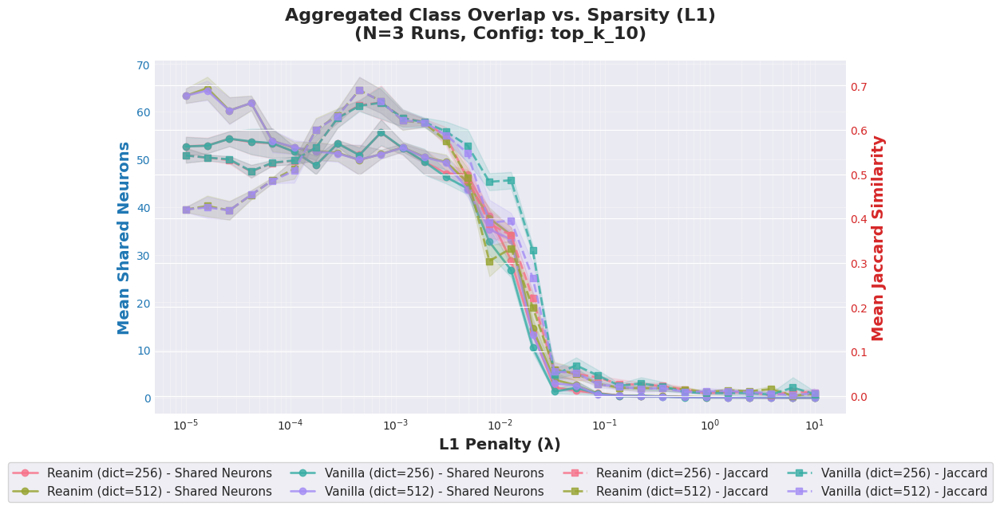

In [7]:

L1_PENALTY_MAP = [round(val, 6) for val in np.logspace(-5, 1, num=30)]

CONFIG_TO_USE = 'top_k_10'

paths_to_runs = [
    '../logs/cifar10expt5/Seed1/vanilla_sae/new_concept_path_results.pkl',
    '../logs/cifar10expt5/Seed2/vanilla_sae/new_concept_path_results.pkl',
    '../logs/cifar10expt5/Seed3/vanilla_sae/new_concept_path_results.pkl'
]

# 4. Define a base name for saving the plot(s)
SAVE_FILE_BASE = 'class_overlap_aggregated'

aggregated_data_dict = plot_aggregated_class_overlap(
    concept_path_files=paths_to_runs,
    config_to_use=CONFIG_TO_USE,
    l1_penalty_map=L1_PENALTY_MAP,
    save_path_base=SAVE_FILE_BASE
)
    
    

In [10]:
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import os

def plot_aggregated_class_overlap(concept_path_files: list, 
                                config_to_use: str, 
                                l1_penalty_map: list, 
                                save_path_base: str = 'penalty_vs_overlap_dual_axis_aggregated'):
    """
    Loads concept path data from multiple runs for different SAE types, 
    aggregates the results, and plots metrics against the relevant x-axis 
    (L1 Penalty or Top-K Ratio).

    Generates a separate, dual-axis plot for each SAE type found (e.g., 'l1', 'topk').

    Args:
        concept_path_files (list): A list of file paths to the .pkl files 
                                   (e.g., ['run1.pkl', 'run2.pkl']).
        config_to_use (str): The extraction config to use (e.g., 'top_k_10').
        l1_penalty_map (list): The list of L1 penalty values to map indices to 
                               (required for L1 SAEs).
        save_path_base (str, optional): The base file name to save plots. 
                                        SAE type and extension will be added
                                        (e.g., 'my_plot' -> 'my_plot_l1.png').
    
    Returns:
        dict: A dictionary where keys are SAE types (e.g., 'l1', 'topk') and
              values are the aggregated DataFrames for that type.
    """
    
    # Set plot style
    plt.style.use('seaborn-v0_8-darkgrid')
    sns.set_palette("husl")

    all_data_rows = []

    # ============================================================================
    # EXTRACT DATA FROM ALL RUNS
    # ============================================================================
    for run_idx, file_path in enumerate(concept_path_files):
        try:
            with open(file_path, 'rb') as f:
                all_concept_paths = pickle.load(f)
        except FileNotFoundError:
            warnings.warn(f"File not found: {file_path}. Skipping run {run_idx}.")
            continue
        except Exception as e:
            warnings.warn(f"Could not load {file_path}: {e}. Skipping run {run_idx}.")
            continue

        for sae_name, configs in all_concept_paths.items():
            if config_to_use not in configs:
                warnings.warn(f"Config '{config_to_use}' not found in {sae_name} "
                              f"for run {run_idx}, skipping SAE.")
                continue
            
            concept_data = configs[config_to_use]
            
            summary = concept_data.get('summary', {})
            overlap_analysis = concept_data.get('overlap_analysis', {})
            overlap_summary = overlap_analysis.get('summary', {})
            
            parts = sae_name.split('_')
            
            # --- Dynamic SAE Type Detection (FIXED) ---
            sae_type = None
            x_value = np.nan
            training_type = None
            dict_size = None

            try:
                # Check for most specific names first
                if sae_name.startswith('reanim_topk_sae'):
                    # e.g., reanim_topk_sae_256_140_best_loss
                    # parts: ['reanim', 'topk', 'sae', '256', '140', 'best', 'loss']
                    sae_type = 'topk'
                    training_type = 'reanim_topk'
                    dict_size = int(parts[3])
                    k_value = int(parts[4])
                    x_value = k_value / dict_size  # Top-K Ratio

                elif sae_name.startswith('topk_sae'):
                    # e.g., topk_sae_512_230_best_loss
                    # parts: ['topk', 'sae', '512', '230', 'best', 'loss']
                    sae_type = 'topk'
                    training_type = 'topk'
                    dict_size = int(parts[2])
                    k_value = int(parts[3])
                    x_value = k_value / dict_size  # Top-K Ratio

                elif sae_name.startswith('reanim_vanilla_sae'):
                    # e.g., reanim_vanilla_sae_256_10_best_loss
                    # parts: ['reanim', 'vanilla', 'sae', '256', '10', 'best', 'loss']
                    sae_type = 'l1'
                    training_type = 'reanim'
                    dict_size = int(parts[3])
                    penalty_index = int(parts[4])
                    if penalty_index >= len(l1_penalty_map):
                        warnings.warn(f"L1 penalty index {penalty_index} out of "
                                      f"range for {sae_name} in run {run_idx}")
                        continue
                    x_value = l1_penalty_map[penalty_index]
                
                elif sae_name.startswith('vanilla_sae'):
                    # e.g., vanilla_sae_256_10_best_loss
                    # parts: ['vanilla', 'sae', '256', '10', 'best', 'loss']
                    sae_type = 'l1'
                    training_type = 'vanilla'
                    dict_size = int(parts[2])
                    penalty_index = int(parts[3])
                    if penalty_index >= len(l1_penalty_map):
                        warnings.warn(f"L1 penalty index {penalty_index} out of "
                                      f"range for {sae_name} in run {run_idx}")
                        continue
                    x_value = l1_penalty_map[penalty_index]
                
                else:
                    warnings.warn(f"Unrecognized SAE name format: {sae_name}. Skipping.")
                    continue
            
            except (IndexError, ValueError, TypeError, ZeroDivisionError) as e:
                warnings.warn(f"Could not parse {sae_name} in run {run_idx}: {e}")
                continue
            # --- End Detection ---

            all_data_rows.append({
                'run_id': run_idx,
                'sae_name': sae_name,
                'sae_type': sae_type,
                'training_type': training_type,
                'dict_size': dict_size,
                'x_value': x_value,
                'mean_shared_neurons': overlap_summary.get('mean_shared_neurons', np.nan),
                'mean_jaccard': overlap_summary.get('mean_jaccard', np.nan),
                'unique_neurons': summary.get('total_unique_neurons_used', np.nan),
                'mean_active': summary.get('mean_active_neurons', np.nan)
            })

    if not all_data_rows:
        warnings.warn("No valid data extracted from any files. Aborting plot.")
        return {}

    # Create DataFrame and drop missing values
    df = pd.DataFrame(all_data_rows)
    df = df.dropna(subset=['x_value', 'mean_shared_neurons', 'mean_jaccard'])

    if df.empty:
        warnings.warn("Data was extracted but contained NaNs in critical columns. "
                      "Aborting plot.")
        return {}

    # ============================================================================
    # AGGREGATE AND PLOT PER SAE TYPE
    # ============================================================================
    
    all_agg_dfs = {}

    for sae_type, type_df in df.groupby('sae_type'):
        
        # Aggregate data for this SAE type
        agg_df = type_df.groupby(['training_type', 'dict_size', 'x_value']).agg(
            shared_neurons_mean=('mean_shared_neurons', 'mean'),
            shared_neurons_std=('mean_shared_neurons', 'std'),
            jaccard_mean=('mean_jaccard', 'mean'),
            jaccard_std=('mean_jaccard', 'std')
        ).reset_index()

        agg_df = agg_df.fillna({'shared_neurons_std': 0, 'jaccard_std': 0})
        all_agg_dfs[sae_type] = agg_df.sort_values(by='x_value') # Sort by x-axis

        # --- Setup Plot ---
        fig, ax1 = plt.subplots(figsize=(12, 7))
        ax2 = ax1.twinx() 

        palette = sns.color_palette("husl", len(agg_df.groupby(['training_type', 'dict_size'])))
        color_idx = 0
        lines_1, labels_1, lines_2, labels_2 = [], [], [], []

        for (training, dict_size), group in agg_df.groupby(['training_type', 'dict_size']):
            group = group.sort_values('x_value') # Ensure lines are drawn correctly
            color = palette[color_idx]
            
            # Capitalize training type for legend
            label_base = f"{training.replace('_', ' ').capitalize()} (dict={dict_size})"

            # --- Plot Mean Shared Neurons (ax1) ---
            line1, = ax1.plot(group['x_value'], 
                              group['shared_neurons_mean'],
                              marker='o', markersize=6, linewidth=2,
                              label=f"{label_base} - Shared Neurons",
                              alpha=0.8, color=color, linestyle='-')
            ax1.fill_between(group['x_value'],
                             group['shared_neurons_mean'] - group['shared_neurons_std'],
                             group['shared_neurons_mean'] + group['shared_neurons_std'],
                             color=color, alpha=0.15)
            lines_1.append(line1)
            labels_1.append(f"{label_base} - Shared Neurons")

            # --- Plot Mean Jaccard (ax2) ---
            line2, = ax2.plot(group['x_value'], 
                              group['jaccard_mean'],
                              marker='s', markersize=6, linewidth=2,
                              label=f"{label_base} - Jaccard",
                              alpha=0.8, color=color, linestyle='--')
            ax2.fill_between(group['x_value'],
                             group['jaccard_mean'] - group['jaccard_std'],
                             group['jaccard_mean'] + group['jaccard_std'],
                             color=color, alpha=0.15)
            lines_2.append(line2)
            labels_2.append(f"{label_base} - Jaccard")
            
            color_idx += 1

        # --- Dynamic Formatting ---
        if sae_type == 'l1':
            x_label = 'L1 Penalty (λ)'
            is_log_scale = True
        elif sae_type == 'topk':
            x_label = 'Top-K Ratio (k / dict_size)'
            is_log_scale = False # Top-K ratio is usually linear
        else:
            x_label = 'X Value'
            is_log_scale = False

        ax1.set_xlabel(x_label, fontsize=14, fontweight='bold')
        if is_log_scale:
            ax1.set_xscale('log')

        ax1.set_ylabel('Mean Shared Neurons', fontsize=14, fontweight='bold', color='tab:blue')
        ax1.tick_params(axis='y', labelcolor='tab:blue')
        ax2.set_ylabel('Mean Jaccard Similarity', fontsize=14, fontweight='bold', color='tab:red')
        ax2.tick_params(axis='y', labelcolor='tab:red')
        
        ax1.set_title(f'Aggregated Class Overlap vs. Sparsity ({sae_type.upper()})\n'
                      f'(N={len(concept_path_files)} Runs, Config: {config_to_use})', 
                      fontsize=16, fontweight='bold', pad=20)
        ax1.grid(True, alpha=0.3, which='both')
        fig.align_ylabels([ax1, ax2])

        # --- Combined Legend ---
        handles = lines_1 + lines_2
        labels = labels_1 + labels_2
        
        # Dynamically set number of columns in legend
        num_variants = len(agg_df.groupby(['training_type', 'dict_size']))
        legend_cols = max(1, min(num_variants, 3)) # Aim for 1-3 columns
        
        ax1.legend(handles, labels, 
                   loc='upper center', 
                   bbox_to_anchor=(0.5, -0.12), 
                   ncol=legend_cols,
                   fontsize=11, 
                   frameon=True,
                   columnspacing=1.5)

        fig.tight_layout()
        fig.subplots_adjust(bottom=0.25) # Adjust bottom margin for legend
        
        # --- Save and Show ---
        if save_path_base:
            try:
                base, ext = os.path.splitext(save_path_base)
                if not ext:
                    ext = '.png' # default to png
                type_save_path = f"{base}_{sae_type}{ext}"

                save_dir = os.path.dirname(type_save_path)
                if save_dir and not os.path.exists(save_dir):
                    os.makedirs(save_dir)
                plt.savefig(type_save_path, dpi=300, bbox_inches='tight')
                print(f"✓ Plot saved to {type_save_path}") # Added print for feedback
            except Exception as e:
                warnings.warn(f"Failed to save plot to {type_save_path}: {e}")
                
        plt.show()

    return all_agg_dfs

Aggregating data from 3 runs...
✓ Plot saved to class_overlap_aggregated_topk.png


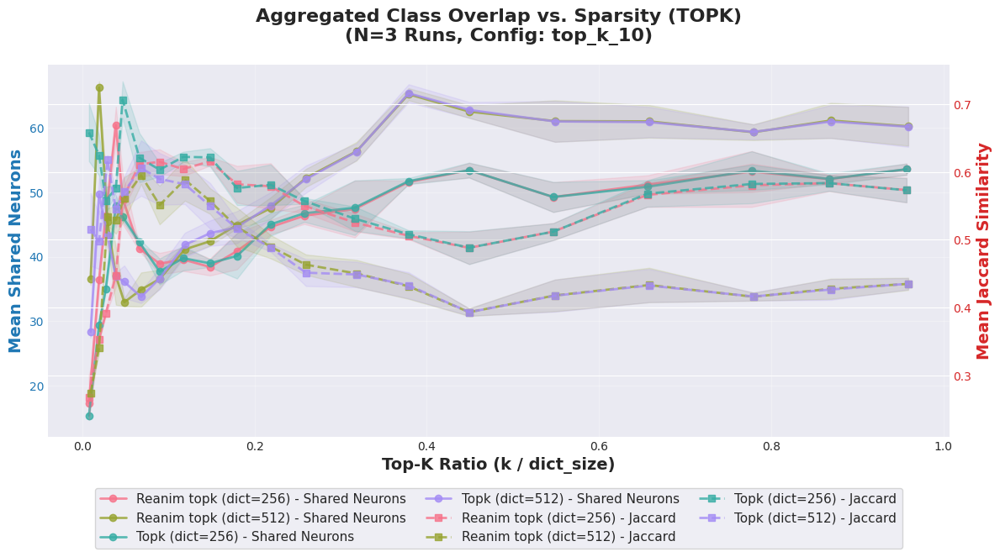

In [11]:
CONFIG_TO_USE = 'top_k_10'


paths_to_runs = [
    # Example L1 SAEs
    '../logs/cifar10expt5/Seed1/topk_sae/new_concept_path_results.pkl',
    '../logs/cifar10expt5/Seed2/topk_sae/new_concept_path_results.pkl',
    '../logs/cifar10expt5/Seed3/topk_sae/new_concept_path_results.pkl',

]

SAVE_FILE_BASE = 'class_overlap_aggregated'

print(f"Aggregating data from {len(paths_to_runs)} runs...")

aggregated_data_dict = plot_aggregated_class_overlap(
    concept_path_files=paths_to_runs,
    config_to_use=CONFIG_TO_USE,
    l1_penalty_map=L1_PENALTY_MAP,
    save_path_base=SAVE_FILE_BASE
)


In [ ]:
CONFIG_TO_USE = 'top_k_10'


paths_to_runs = [
    # Example L1 SAEs
    '../logs/cifar10expt5/Seed1/topk_sae/new_concept_path_results.pkl',
    '../logs/cifar10expt5/Seed2/topk_sae/new_concept_path_results.pkl',
    '../logs/cifar10expt5/Seed3/topk_sae/new_concept_path_results.pkl',

]

SAVE_FILE_BASE = 'class_overlap_aggregated'

print(f"Aggregating data from {len(paths_to_runs)} runs...")

aggregated_data_dict = plot_aggregated_class_overlap(
    concept_path_files=paths_to_runs,
    config_to_use=CONFIG_TO_USE,
    l1_penalty_map=L1_PENALTY_MAP,
    save_path_base=SAVE_FILE_BASE
)


Aggregating data from 3 runs...
✓ Plot saved to class_overlap_aggregated_topk.png


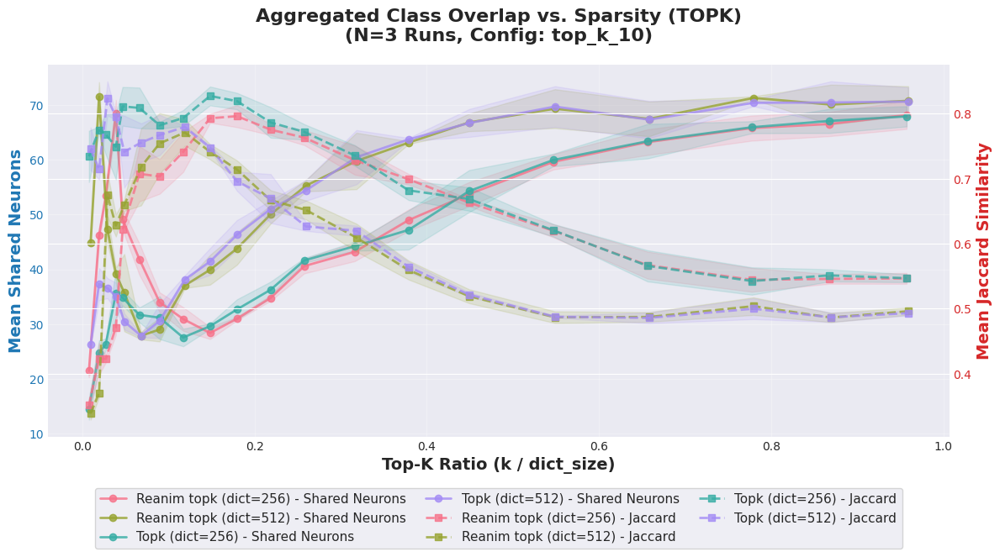

In [12]:
CONFIG_TO_USE = 'top_k_10'


paths_to_runs = [
    # Example L1 SAEs
    '../logs/mnist_activation/Seed1/topk_sae/new_concept_path_results.pkl',
    '../logs/mnist_activation/Seed2/topk_sae/new_concept_path_results.pkl',
    '../logs/mnist_activation/Seed3/topk_sae/new_concept_path_results.pkl',

]

SAVE_FILE_BASE = 'class_overlap_aggregated'

print(f"Aggregating data from {len(paths_to_runs)} runs...")

aggregated_data_dict = plot_aggregated_class_overlap(
    concept_path_files=paths_to_runs,
    config_to_use=CONFIG_TO_USE,
    l1_penalty_map=L1_PENALTY_MAP,
    save_path_base=SAVE_FILE_BASE
)


✓ Plot saved to class_overlap_aggregated_l1.png


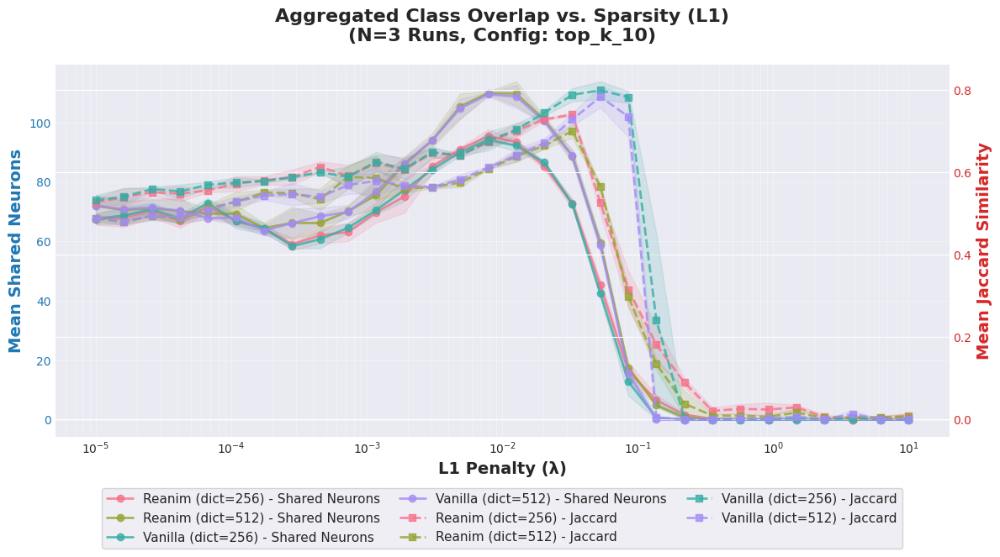

In [13]:
L1_PENALTY_MAP = [round(val, 6) for val in np.logspace(-5, 1, num=30)]

CONFIG_TO_USE = 'top_k_10'

paths_to_runs = [
    '../logs/mnist_activation/Seed1/vanilla_sae/new_concept_path_results.pkl',
    '../logs/mnist_activation/Seed2/vanilla_sae/new_concept_path_results.pkl',
    '../logs/mnist_activation/Seed3/vanilla_sae/new_concept_path_results.pkl'
]

# 4. Define a base name for saving the plot(s)
SAVE_FILE_BASE = 'class_overlap_aggregated'

aggregated_data_dict = plot_aggregated_class_overlap(
    concept_path_files=paths_to_runs,
    config_to_use=CONFIG_TO_USE,
    l1_penalty_map=L1_PENALTY_MAP,
    save_path_base=SAVE_FILE_BASE
)
    
    

✓ Plot saved to class_overlap_aggregated_l1.png


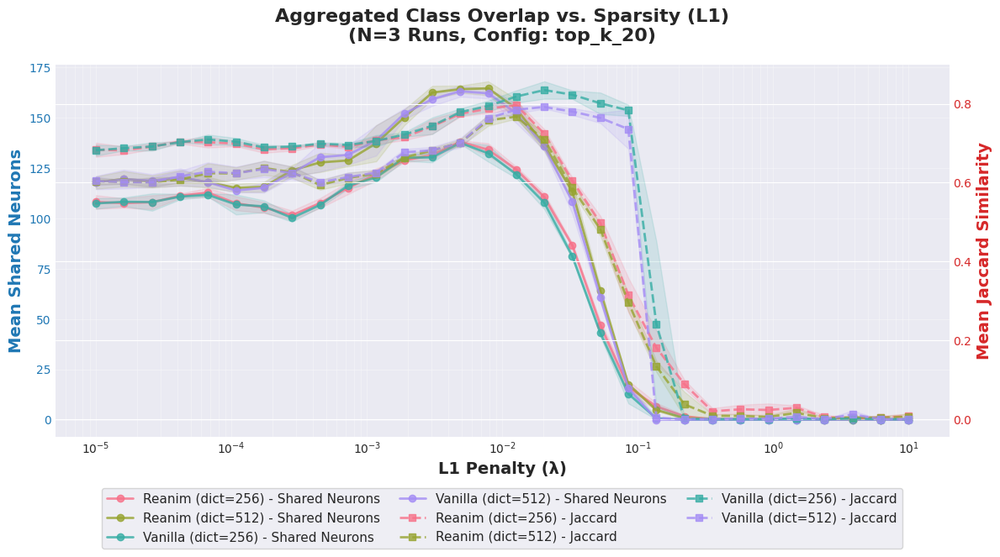

In [14]:
L1_PENALTY_MAP = [round(val, 6) for val in np.logspace(-5, 1, num=30)]

CONFIG_TO_USE = 'top_k_20'

paths_to_runs = [
    '../logs/mnist_activation/Seed1/vanilla_sae/new_concept_path_results.pkl',
    '../logs/mnist_activation/Seed2/vanilla_sae/new_concept_path_results.pkl',
    '../logs/mnist_activation/Seed3/vanilla_sae/new_concept_path_results.pkl'
]

# 4. Define a base name for saving the plot(s)
SAVE_FILE_BASE = 'class_overlap_aggregated'

aggregated_data_dict = plot_aggregated_class_overlap(
    concept_path_files=paths_to_runs,
    config_to_use=CONFIG_TO_USE,
    l1_penalty_map=L1_PENALTY_MAP,
    save_path_base=SAVE_FILE_BASE
)
    

✓ Plot saved to class_overlap_aggregated_l1.png


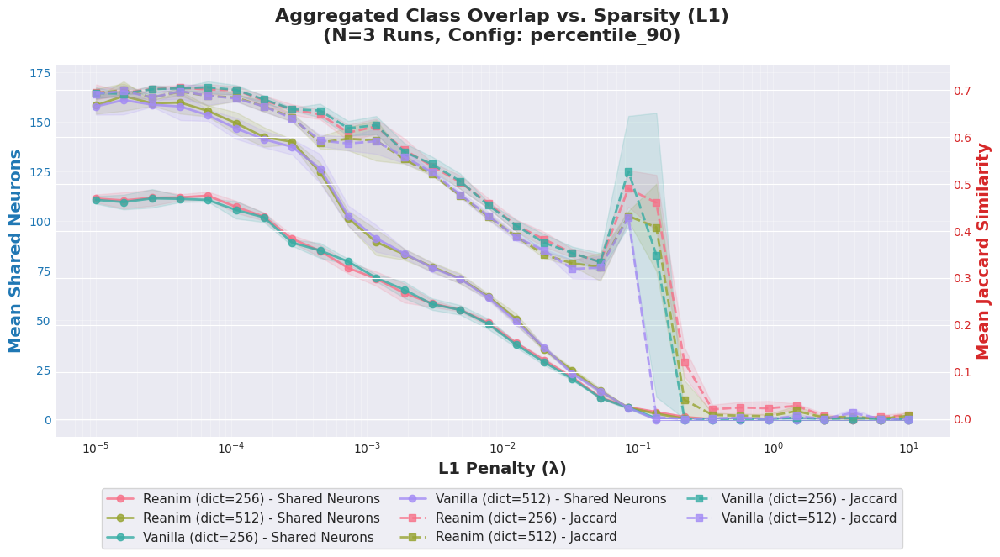

In [15]:
L1_PENALTY_MAP = [round(val, 6) for val in np.logspace(-5, 1, num=30)]

CONFIG_TO_USE = 'percentile_90'

paths_to_runs = [
    '../logs/mnist_activation/Seed1/vanilla_sae/new_concept_path_results.pkl',
    '../logs/mnist_activation/Seed2/vanilla_sae/new_concept_path_results.pkl',
    '../logs/mnist_activation/Seed3/vanilla_sae/new_concept_path_results.pkl'
]

# 4. Define a base name for saving the plot(s)
SAVE_FILE_BASE = 'class_overlap_aggregated'

aggregated_data_dict = plot_aggregated_class_overlap(
    concept_path_files=paths_to_runs,
    config_to_use=CONFIG_TO_USE,
    l1_penalty_map=L1_PENALTY_MAP,
    save_path_base=SAVE_FILE_BASE
)
    

✓ Plot saved to class_overlap_aggregated_l1.png


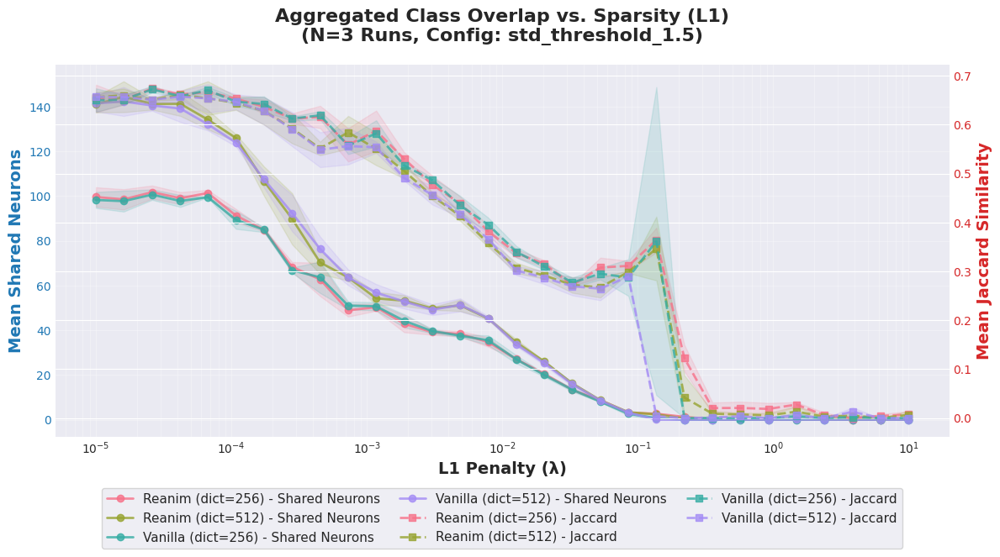

In [16]:
L1_PENALTY_MAP = [round(val, 6) for val in np.logspace(-5, 1, num=30)]

CONFIG_TO_USE = 'std_threshold_1.5'

paths_to_runs = [
    '../logs/mnist_activation/Seed1/vanilla_sae/new_concept_path_results.pkl',
    '../logs/mnist_activation/Seed2/vanilla_sae/new_concept_path_results.pkl',
    '../logs/mnist_activation/Seed3/vanilla_sae/new_concept_path_results.pkl'
]

# 4. Define a base name for saving the plot(s)
SAVE_FILE_BASE = 'class_overlap_aggregated'

aggregated_data_dict = plot_aggregated_class_overlap(
    concept_path_files=paths_to_runs,
    config_to_use=CONFIG_TO_USE,
    l1_penalty_map=L1_PENALTY_MAP,
    save_path_base=SAVE_FILE_BASE
)